#### Importing Library

In [147]:
import pandas as pd
import numpy as np
import geopandas as gpd
import folium
import matplotlib.pyplot as plt
import matplotlib.lines as mlines
import re
import folium
import seaborn as sns
# import dtreeviz 
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from scipy import stats
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import LabelEncoder, MinMaxScaler, StandardScaler
from sklearn.tree import DecisionTreeClassifier
from sklearn.tree import plot_tree
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.model_selection import train_test_split
from shapely.geometry import Point
from shapely import wkt
from shapely.geometry import LineString, MultiLineString, Point
from matplotlib.lines import Line2D
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import AdaBoostClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score

### Constant

In [2]:
area_interval = 100 #meters

#### Traffic Cameras - may not useful

In [3]:
# # Load the JSON data from the given URL
# url = "Traffic_Cameras_20240306.csv"
# data_traffic_cameras = pd.read_csv(url)

# data_traffic_cameras['geometry'] = data_traffic_cameras['Point'].apply(wkt.loads)
# data_traffic_cameras = gpd.GeoDataFrame(data_traffic_cameras, geometry='geometry')
# data_traffic_cameras.set_crs(epsg=4326, inplace=True)
# data_traffic_cameras = data_traffic_cameras.to_crs(epsg=32612)

# # Display the first few rows of the GeoDataFrame to verify
# display(data_traffic_cameras.head())
# display(data_traffic_cameras.info())

# fig, ax = plt.subplots(figsize=(20, 20))

# # Plot road network
# data_traffic_cameras.plot(ax=ax, color='red', linewidth=1, label='Traffic Cameras Network')

# plt.legend()
# plt.show()

#### Neighbourhood Speed Limit  - may not useful

,SEGMENT_ID,BUILT_STATUS,FULL_NAME,SPEED_LIMIT,CTP_CLASS,MULTILINESTRING,geometry
0,100019,Built,DEERVIEW WY SE,40.0,Residential Street,"MULTILINESTRING ((-114.0223844 50.9308032, -11...","MULTILINESTRING ((287625.389 5646480.682, 2875..."
1,100020,Built,DEERVIEW WY SE,40.0,Residential Street,"MULTILINESTRING ((-114.0228964 50.9307993, -11...","MULTILINESTRING ((287589.401 5646481.723, 2875..."
2,100022,Built,DEERVIEW CO SE,40.0,Residential Street,"MULTILINESTRING ((-114.0224186 50.929966, -114...","MULTILINESTRING ((287619.171 5646387.709, 2875..."
3,100023,Built,DEERVIEW CO SE,40.0,Residential Street,"MULTILINESTRING ((-114.0229359 50.9299765, -11...","MULTILINESTRING ((287582.876 5646390.366, 2875..."
4,100025,Built,DEERVIEW WY SE,40.0,Residential Street,"MULTILINESTRING ((-114.0222637 50.9288754, -11...","MULTILINESTRING ((287625.083 5646266.020, 2876..."


<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 73038 entries, 0 to 73037
Data columns (total 7 columns):
 #   Column           Non-Null Count  Dtype   
---  ------           --------------  -----   
 0   SEGMENT_ID       73038 non-null  int64   
 1   BUILT_STATUS     73038 non-null  object  
 2   FULL_NAME        73026 non-null  object  
 3   SPEED_LIMIT      54432 non-null  float64 
 4   CTP_CLASS        73038 non-null  object  
 5   MULTILINESTRING  73038 non-null  object  
 6   geometry         73038 non-null  geometry
dtypes: float64(1), geometry(1), int64(1), object(4)
memory usage: 3.9+ MB


None

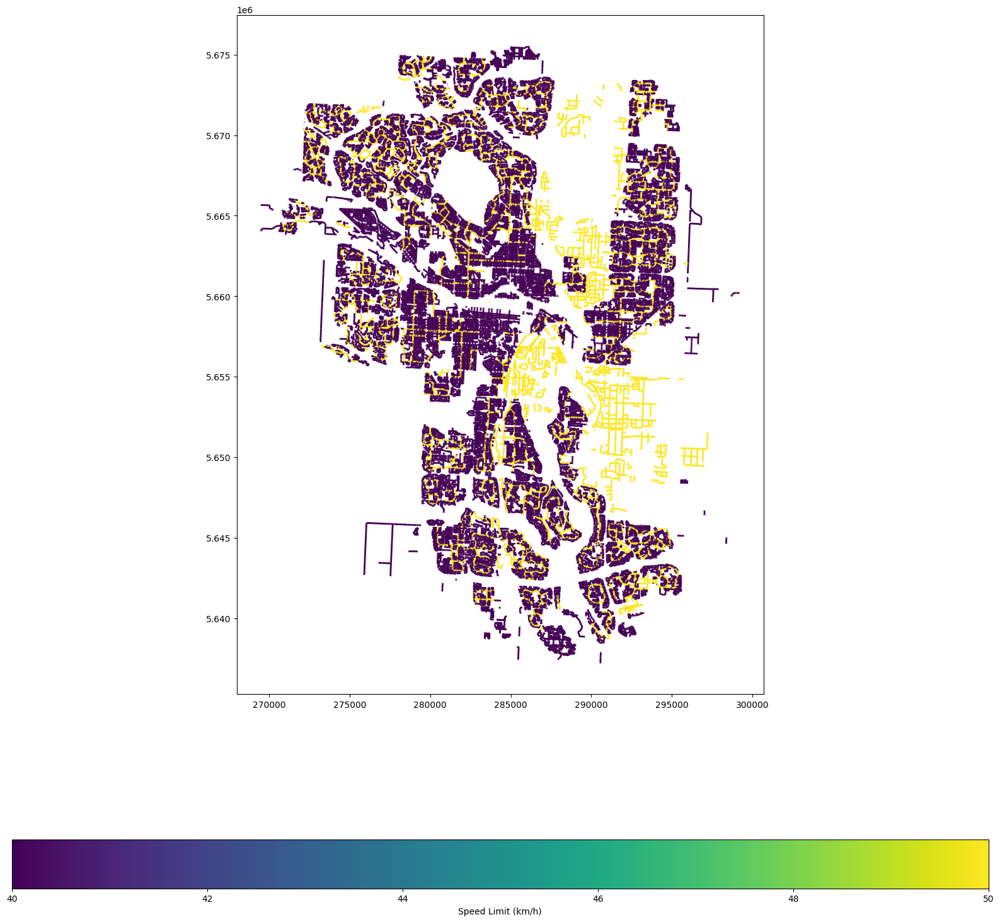

In [4]:
# Load the JSON data from the given URL
url = "Neighbourhood_Speed_Limits_20240306.csv"
data_neighbourhood_speed_limits = pd.read_csv(url)

data_neighbourhood_speed_limits['geometry'] = data_neighbourhood_speed_limits['MULTILINESTRING'].apply(wkt.loads)
data_neighbourhood_speed_limits = gpd.GeoDataFrame(data_neighbourhood_speed_limits, geometry='geometry')
data_neighbourhood_speed_limits.set_crs(epsg=4326, inplace=True)
data_neighbourhood_speed_limits = data_neighbourhood_speed_limits.to_crs(epsg=32612)

data_neighbourhood_speed_limits['SPEED_LIMIT'] = pd.to_numeric(data_neighbourhood_speed_limits['SPEED_LIMIT'].str.replace(' km/h', ''), errors='coerce')

# Display the first few rows of the DataFrame to verify
display(data_neighbourhood_speed_limits.head())
display(data_neighbourhood_speed_limits.info())

fig, ax = plt.subplots(figsize=(20, 20))

# Plot road network
data_neighbourhood_speed_limits.plot(
    ax=ax,
    column='SPEED_LIMIT',  # Specify the column based on which to vary colors
    linewidth=2,
    legend=True,  # Add a legend
    cmap='viridis',  # Specify a colormap
    legend_kwds={
        'label': "Speed Limit (km/h)",
        'orientation': "horizontal"
    }
)

plt.show()

#### Road Speed Limit

,BOUND,CREATED_DT,DISTANCE,SPEED,STREET_NAME,MODIFIED_ATTRIBUTE_DT,multiline,geometry
0,N/S,NaN,4.18,60,TWELVE MILE COULEE RD,2012/08/20,"MULTILINESTRING ((-114.2574093 51.1368709, -11...","MULTILINESTRING ((272128.074 5670091.791, 2721..."
1,N,NaN,2.21,80,SHAGANAPPI TR,2012/07/16,"MULTILINESTRING ((-114.1304016 51.1291707, -11...","MULTILINESTRING ((280974.523 5668849.787, 2809..."
2,S,NaN,0.11,60,14 ST,NaN,"MULTILINESTRING ((-114.0948669 50.9495108, -11...","MULTILINESTRING ((282620.562 5648771.642, 2826..."
3,E,NaN,1.85,60,JOHN LAURIE BV,NaN,"MULTILINESTRING ((-114.1778708 51.1241752, -11...","MULTILINESTRING ((277629.947 5668436.901, 2776..."
4,W,NaN,1.55,60,JOHN LAURIE BV,NaN,"MULTILINESTRING ((-114.1814003 51.123805, -114...","MULTILINESTRING ((277381.245 5668406.425, 2773..."


<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 3485 entries, 0 to 3484
Data columns (total 8 columns):
 #   Column                 Non-Null Count  Dtype   
---  ------                 --------------  -----   
 0   BOUND                  3229 non-null   object  
 1   CREATED_DT             3230 non-null   object  
 2   DISTANCE               438 non-null    float64 
 3   SPEED                  3485 non-null   int64   
 4   STREET_NAME            3418 non-null   object  
 5   MODIFIED_ATTRIBUTE_DT  3394 non-null   object  
 6   multiline              3485 non-null   object  
 7   geometry               3485 non-null   geometry
dtypes: float64(1), geometry(1), int64(1), object(5)
memory usage: 217.9+ KB


None

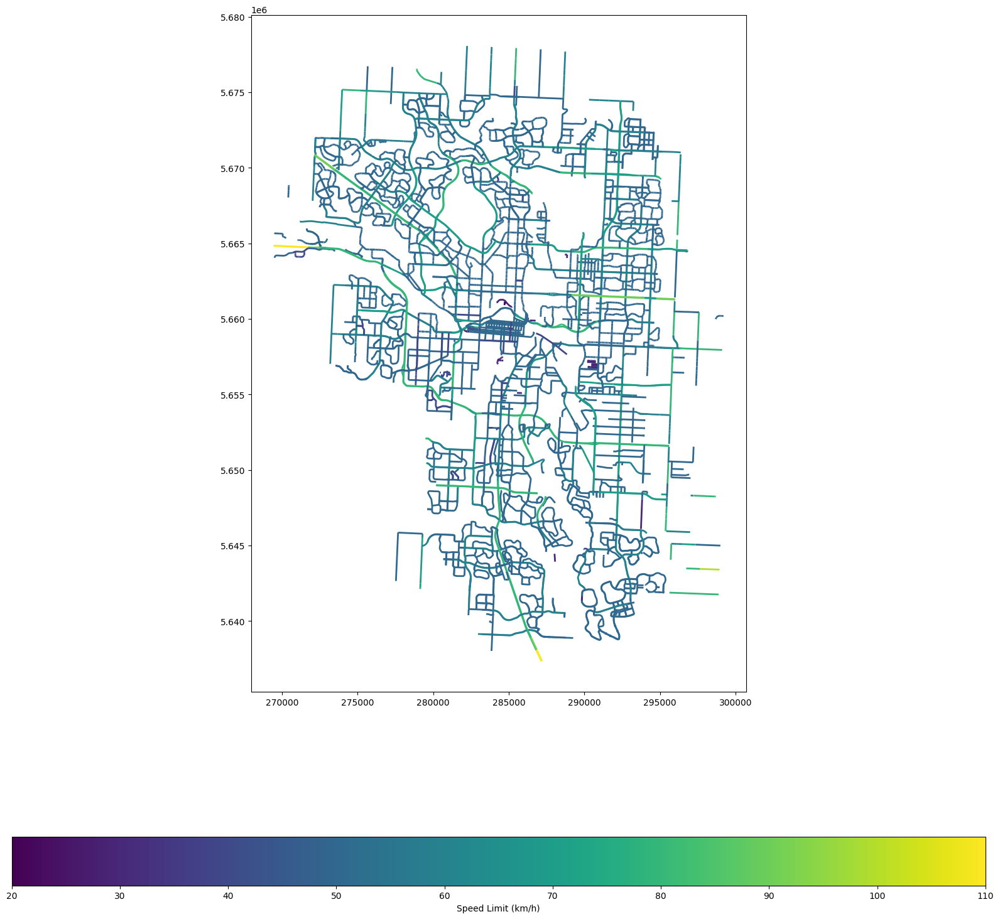

In [6]:
# Load the JSON data from the given URL
url = "Speed_Limits_20240308.csv"
data_speed_limits = pd.read_csv(url)

data_speed_limits['geometry'] = data_speed_limits['multiline'].apply(wkt.loads)
data_speed_limits = gpd.GeoDataFrame(data_speed_limits, geometry='geometry')
data_speed_limits.set_crs(epsg=4326, inplace=True)
data_speed_limits = data_speed_limits.to_crs(epsg=32612)

# Display the first few rows of the DataFrame to verify
display(data_speed_limits.head())
display(data_speed_limits.info())

fig, ax = plt.subplots(figsize=(20, 20))

# Plot road network
data_speed_limits.plot(
    ax=ax,
    column='SPEED',  # Specify the column based on which to vary colors
    linewidth=2,
    legend=True,  # Add a legend
    cmap='viridis',  # Specify a colormap
    legend_kwds={
        'label': "Speed Limit (km/h)",
        'orientation': "horizontal"
    }
)

plt.show()

### All Speed limit

,geometry,SPEED_LIMIT
0,"MULTILINESTRING ((287625.389 5646480.682, 2875...",40.0
1,"MULTILINESTRING ((287589.401 5646481.723, 2875...",40.0
2,"MULTILINESTRING ((287619.171 5646387.709, 2875...",40.0
3,"MULTILINESTRING ((287582.876 5646390.366, 2875...",40.0
4,"MULTILINESTRING ((287625.083 5646266.020, 2876...",40.0


<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 76523 entries, 0 to 76522
Data columns (total 2 columns):
 #   Column       Non-Null Count  Dtype   
---  ------       --------------  -----   
 0   geometry     76523 non-null  geometry
 1   SPEED_LIMIT  57917 non-null  float64 
dtypes: float64(1), geometry(1)
memory usage: 1.2 MB


None

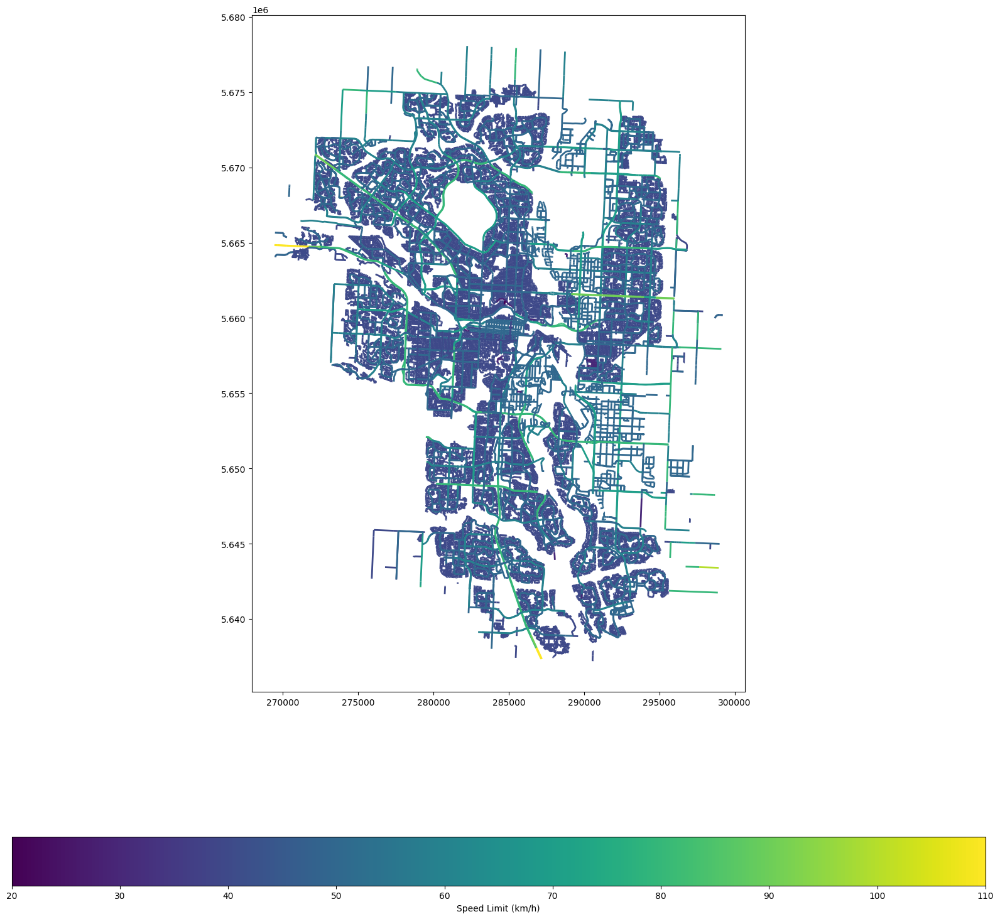

In [8]:
# For data_neighbourhood_speed_limits, the column is already named 'SPEED_LIMIT'
# For data_speed_limits, rename 'SPEED' to 'SPEED_LIMIT'
data_speed_limits.rename(columns={'SPEED': 'SPEED_LIMIT'}, inplace=True)

# If there are additional columns in either DataFrame you wish to retain, rename or drop them accordingly
# Concatenate the two GeoDataFrames
all_speed_limits = pd.concat([data_neighbourhood_speed_limits[['geometry', 'SPEED_LIMIT']],
                              data_speed_limits[['geometry', 'SPEED_LIMIT']]],
                             ignore_index=True)

# Verify the concatenated DataFrame
display(all_speed_limits.head())
display(all_speed_limits.info())
fig, ax = plt.subplots(figsize=(20, 20))

# Plot the combined speed limits
all_speed_limits.plot(
    ax=ax,
    column='SPEED_LIMIT',  # Color by speed limit
    linewidth=2,
    legend=True,
    cmap='viridis',  # Choose a colormap that suits your needs
    legend_kwds={
        'label': "Speed Limit (km/h)",
        'orientation': "horizontal"
    }
)

plt.show()


In [9]:
# Sampling 1/100 records randomly
sampled_df = all_speed_limits.sample(n=int(len(all_speed_limits)/100), random_state=1)  # Fixed random state for reproducibility

# Save the sampled data to a CSV file
sampled_file_path = 'all_speed_limits.csv'
sampled_df.to_csv(sampled_file_path, index=False)

# Return the path to the saved CSV file for download
sampled_file_path

'all_speed_limits.csv'

### Traffic Incidents

,INCIDENT INFO,DESCRIPTION,START_DT,MODIFIED_DT,QUADRANT,Longitude,Latitude,Count,id,Point,geometry
0,Westbound 16 Avenue at Deerfoot Trail NE,Stalled vehicle. Partially blocking the right...,2022/06/21 07:31:40 AM,2022/06/21 07:33:16 AM,NE,-114.026687,51.067485,1,2022-06-21T07:31:4051.067485129276236-114.0266...,POINT (-114.02668672232672 51.067485129276236),POINT (287947.519 5661688.224)
1,11 Avenue and 4 Street SW,Traffic incident. Blocking multiple lanes,2022/06/21 04:02:11 AM,2022/06/21 04:12:38 AM,SW,-114.071481,51.042624,1,2022-06-21T04:02:1151.04262449261462-114.07148...,POINT (-114.07148057660925 51.04262449261462),POINT (284694.505 5659054.445)
2,68 Street and Memorial Drive E,Traffic incident.,2022/06/20 11:53:08 PM,2022/06/20 11:55:42 PM,NE,-113.935553,51.052474,1,2022-06-20T23:53:0851.0524735056658-113.935553...,POINT (-113.935553325751 51.0524735056658),POINT (294264.652 5659760.710)
3,Eastbound 16 Avenue and 36 Street NE,Traffic incident. Blocking the left shoulder,2022/06/20 04:43:21 PM,2022/06/20 05:17:05 PM,NE,-113.989219,51.067086,1,2022-06-20T16:43:2151.06708565896752-113.98921...,POINT (-113.98921905311566 51.06708565896752),POINT (290570.231 5661536.535)
4,Barlow Trail and 61 Avenue SE,Traffic incident.,2022/06/20 04:42:12 PM,2022/06/20 05:28:21 PM,SE,-113.985727,50.998727,1,2022-06-20T16:42:1250.99872748477766-113.98572...,POINT (-113.98572655353505 50.99872748477766),POINT (290506.687 5653927.027)


<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 45861 entries, 0 to 45860
Data columns (total 11 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   INCIDENT INFO  45861 non-null  object  
 1   DESCRIPTION    45859 non-null  object  
 2   START_DT       45861 non-null  object  
 3   MODIFIED_DT    31804 non-null  object  
 4   QUADRANT       31802 non-null  object  
 5   Longitude      45861 non-null  float64 
 6   Latitude       45861 non-null  float64 
 7   Count          45861 non-null  int64   
 8   id             45861 non-null  object  
 9   Point          45861 non-null  object  
 10  geometry       45861 non-null  geometry
dtypes: float64(2), geometry(1), int64(1), object(7)
memory usage: 3.8+ MB


None

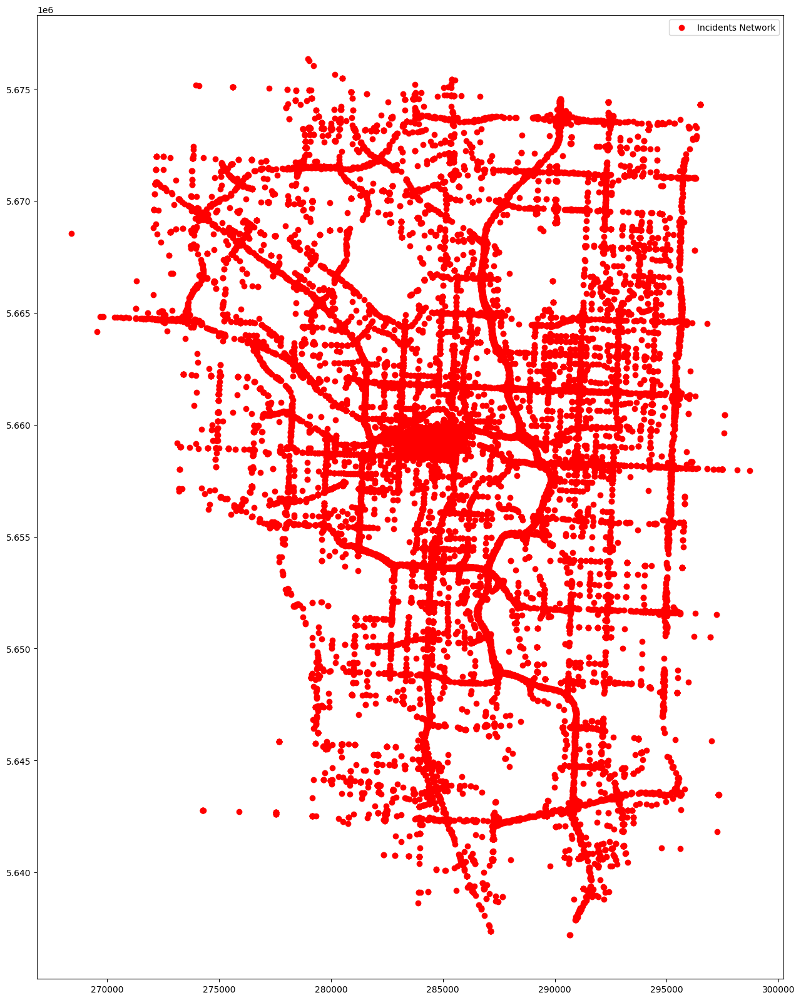

In [10]:

# Load the JSON data from the given URL
url = "Traffic_Incidents_20240306.csv"
data_incidents = pd.read_csv(url)

data_incidents['geometry'] = data_incidents['Point'].apply(wkt.loads)
data_incidents = gpd.GeoDataFrame(data_incidents, geometry='geometry')
data_incidents.set_crs(epsg=4326, inplace=True)
data_incidents = data_incidents.to_crs(epsg=32612)

# Display the first few rows of the DataFrame to verify
display(data_incidents.head())
display(data_incidents.info())

fig, ax = plt.subplots(figsize=(20, 20))

# Plot road network
data_incidents.plot(ax=ax, color='red', linewidth=1, label='Incidents Network')

plt.legend()
plt.show()

### Traffic Signal Signs

,INSTDATE,SIGN_CODE,SIGN_DSCRN,SIGN_SIZE,SIGN_TYPE,SUPPORT_TYPE,POINT,geometry
6,2017/10/26,11-250,KRMS,600x750,Flat Sheet,Pedestal,POINT (-114.1969592 51.1542101),POINT (276439.761 5671833.766)
7,2020/12/02,11-250,KRMS,600x750,Flat Sheet,Pedestal,POINT (-114.2109842 51.0594918),POINT (274999.449 5661346.785)
9,2021/01/18,14-320,TAC Pedestrian Crosswalk,900x1200,Other,Arm,POINT (-114.0758307 51.1115973),POINT (284710.187 5666734.990)
10,2013/09/24,14-308,Pedestrian Crosswalk,600x750,Flat Sheet,Trunk,POINT (-114.1022882 51.0576832),POINT (282605.945 5660819.075)
11,2018/07/23,11-647,Turn Control - Thru + Left,900x900,Flat Sheet,Arm,POINT (-114.0317578 51.0474608),POINT (287500.600 5659476.697)


<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 4675 entries, 6 to 5215
Data columns (total 8 columns):
 #   Column        Non-Null Count  Dtype   
---  ------        --------------  -----   
 0   INSTDATE      4675 non-null   object  
 1   SIGN_CODE     4675 non-null   object  
 2   SIGN_DSCRN    4675 non-null   object  
 3   SIGN_SIZE     4675 non-null   object  
 4   SIGN_TYPE     4675 non-null   object  
 5   SUPPORT_TYPE  4675 non-null   object  
 6   POINT         4675 non-null   object  
 7   geometry      4675 non-null   geometry
dtypes: geometry(1), object(7)
memory usage: 328.7+ KB


None

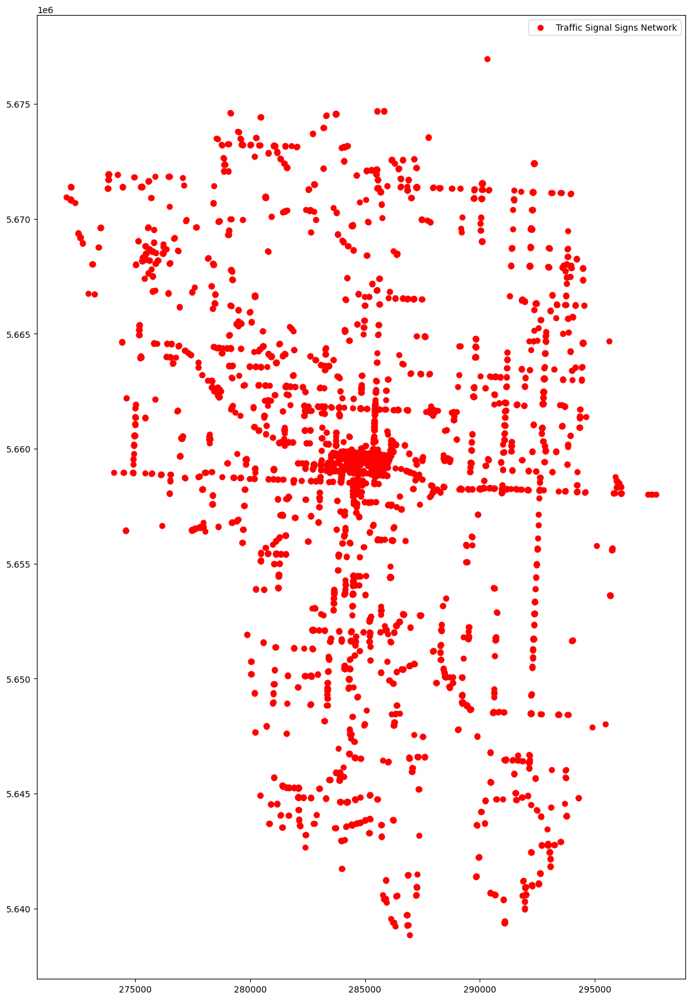

In [12]:
url = "Traffic_Signal_Signs_20240309.csv"
temp = pd.read_csv(url)

data_sign=temp[['INSTDATE','SIGN_CODE','SIGN_DSCRN','SIGN_SIZE','SIGN_TYPE','SUPPORT_TYPE','POINT']]
data_sign=data_sign.dropna()
data_sign['geometry'] = data_sign['POINT'].apply(wkt.loads)
data_sign = gpd.GeoDataFrame(data_sign, geometry='geometry')
data_sign.set_crs(epsg=4326, inplace=True)
data_sign = data_sign.to_crs(epsg=32612)

display(data_sign.head())
display(data_sign.info())

fig, ax = plt.subplots(figsize=(20, 20))

# Plot road network
data_sign.plot(ax=ax, color='red', linewidth=1, label='Traffic Signal Signs Network')

plt.legend()
plt.show()

### Crosswalk

,CROSSWALK_TYPE,CROSSWALK_COMP,POINT,geometry
0,RSM,PARKING STALLS,POINT (-114.08130604284372 51.06727641297475),POINT (284120.635 5661823.806)
1,RSM,STOP LINE,POINT (-114.14111928809288 51.1831099606199),POINT (280481.098 5674878.256)
2,RSM,STOP LINE,POINT (-114.13499902937271 51.18319156789337),POINT (280909.112 5674869.061)
3,MULTIWAY STOP,STOP LINE,POINT (-114.08128908263517 50.98601632264809),POINT (283743.760 5652790.011)
4,SIGNALIZED,RIGHT TURN,POINT (-114.14117612481596 51.06009319728565),POINT (279892.864 5661202.565)


<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 4030 entries, 0 to 4048
Data columns (total 4 columns):
 #   Column          Non-Null Count  Dtype   
---  ------          --------------  -----   
 0   CROSSWALK_TYPE  4030 non-null   object  
 1   CROSSWALK_COMP  4030 non-null   object  
 2   POINT           4030 non-null   object  
 3   geometry        4030 non-null   geometry
dtypes: geometry(1), object(3)
memory usage: 157.4+ KB


None

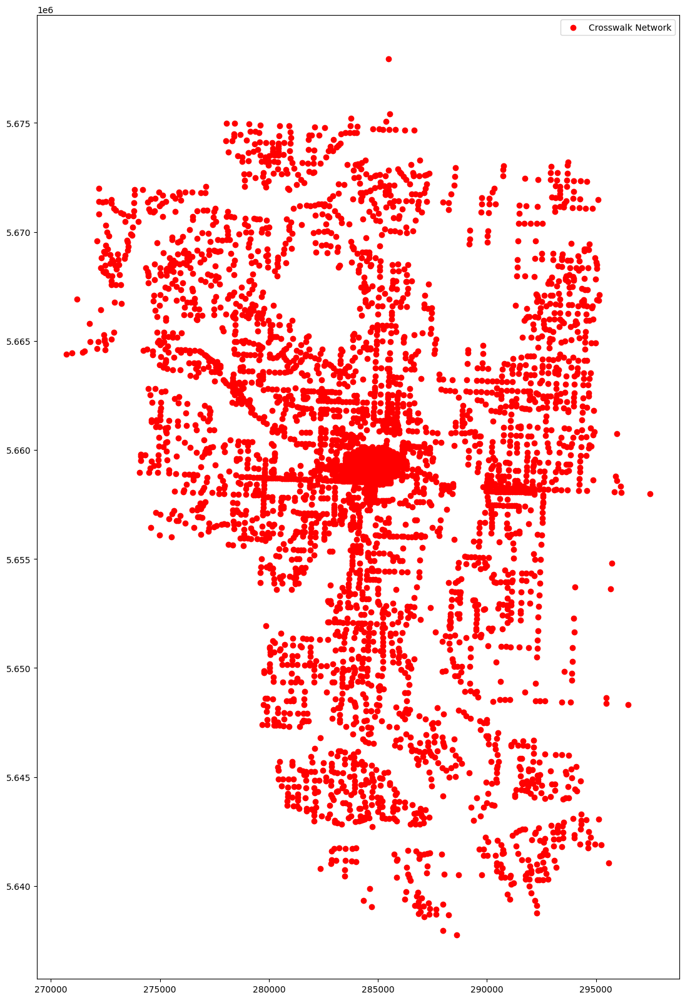

In [14]:
url = "Crosswalks_20240309.csv"
temp = pd.read_csv(url)

data_crosswalk=temp[['CROSSWALK_TYPE','CROSSWALK_COMP','POINT']]
data_crosswalk = data_crosswalk.dropna(subset=['CROSSWALK_TYPE', 'CROSSWALK_COMP'])

data_crosswalk['geometry'] = data_crosswalk['POINT'].apply(wkt.loads)
data_crosswalk = gpd.GeoDataFrame(data_crosswalk, geometry='geometry')
data_crosswalk.set_crs(epsg=4326, inplace=True)
data_crosswalk = data_crosswalk.to_crs(epsg=32612)

display(data_crosswalk.head())
display(data_crosswalk.info())

fig, ax = plt.subplots(figsize=(20, 20))

# Plot road network
data_crosswalk.plot(ax=ax, color='red', linewidth=1, label='Crosswalk Network')

plt.legend()
plt.show()

### Divide the road to piece (defined by the constant set before)

,geometry,SPEED_LIMIT
0,"POLYGON ((287725.389 5646480.682, 287724.907 5...",40.0
1,"POLYGON ((287689.401 5646481.723, 287688.919 5...",40.0
2,"POLYGON ((287689.401 5646481.723, 287688.919 5...",40.0
3,"POLYGON ((287679.238 5646481.873, 287678.757 5...",40.0
4,"POLYGON ((287719.171 5646387.709, 287718.689 5...",40.0
...,...,...
225775,"POLYGON ((294449.080 5661355.582, 294448.599 5...",70.0
225776,"POLYGON ((294349.193 5661360.331, 294348.712 5...",70.0
225777,"POLYGON ((294249.306 5661365.081, 294248.825 5...",70.0
225778,"POLYGON ((294149.419 5661369.830, 294148.937 5...",70.0


<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 225780 entries, 0 to 225779
Data columns (total 2 columns):
 #   Column       Non-Null Count   Dtype   
---  ------       --------------   -----   
 0   geometry     225780 non-null  geometry
 1   SPEED_LIMIT  171464 non-null  float64 
dtypes: float64(1), geometry(1)
memory usage: 3.4 MB


None

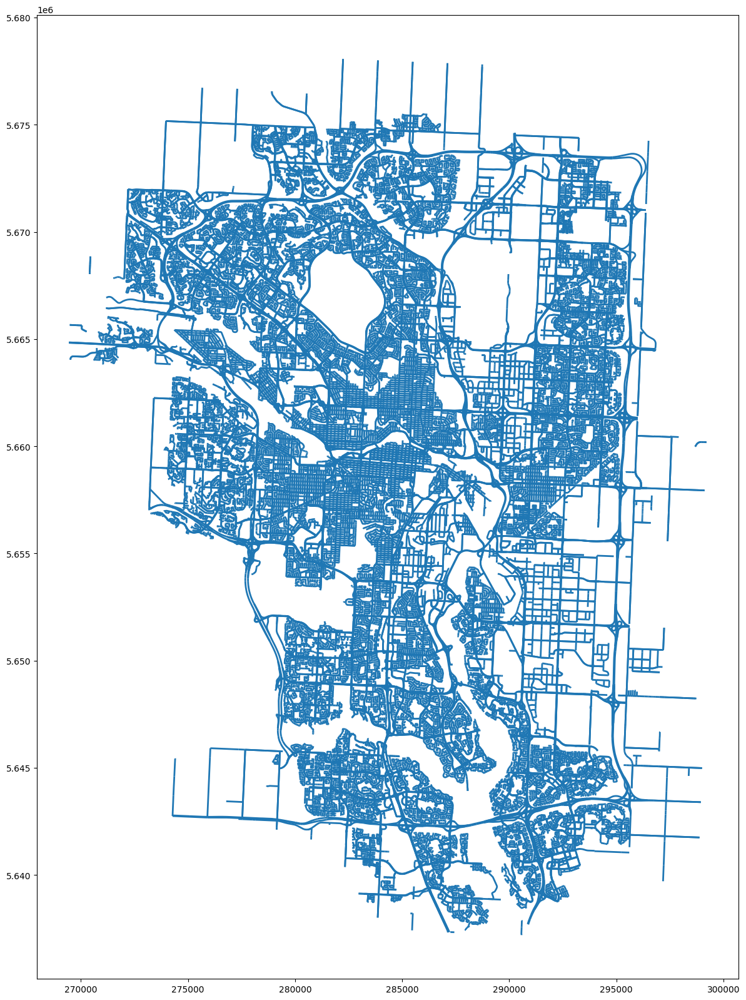

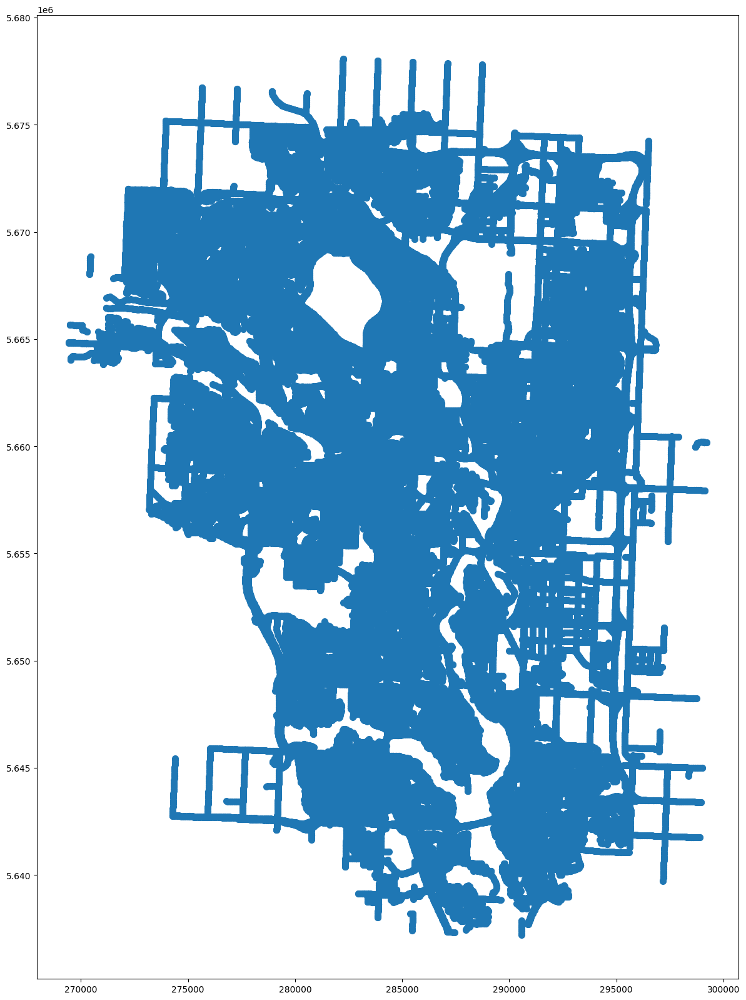

In [20]:
base_dataframe = all_speed_limits.copy()
base_dataframe.set_crs(epsg=32612, inplace=True)

# Function to generate points along a line at specified intervals
def generate_points_along_line(line, interval, speed_limit):
    length = line.length
    distances = np.arange(0, length + interval, interval)  # Ensure covering the entire line
    points = [line.interpolate(distance) for distance in distances]
    speed_limits = [speed_limit for _ in distances]
    return points, speed_limits

# List to collect points
points_list = []
speed_limits_list = []

# Iterate over each geometry in the GeoDataFrame
for index, row in base_dataframe.iterrows():
    geom = row.geometry
    speed_limit = row.SPEED_LIMIT
    if isinstance(geom, LineString):
        points, speed_limits = generate_points_along_line(geom, area_interval, speed_limit)
        points_list.extend(points)
        speed_limits_list.extend(speed_limits)
    elif isinstance(geom, MultiLineString):
        for line in geom.geoms:  # Correctly iterate over LineStrings in a MultiLineString
            points, speed_limits = generate_points_along_line(line, area_interval, speed_limit)
            points_list.extend(points)
            speed_limits_list.extend(speed_limits)

# Convert the list of points to a GeoDataFrame
points_gdf = gpd.GeoDataFrame({'geometry': points_list, 'SPEED_LIMIT': speed_limits_list})
points_gdf.set_crs(epsg=32612, inplace=True)

points_gdf_buffered = points_gdf.copy()
points_gdf_buffered['geometry'] = points_gdf_buffered.buffer(area_interval)
points_gdf_buffered.set_crs(epsg=32612, inplace=True)

# Display the first few rows to verify
display(points_gdf_buffered)
display(points_gdf_buffered.info())


fig, ax = plt.subplots(figsize=(20, 20))

# Plot road network
base_dataframe.plot(
    ax=ax,
    linewidth=2
)

plt.show()

fig, ax = plt.subplots(figsize=(20, 20))

# Plot road network
points_gdf.plot(
    ax=ax,
    linewidth=2
)

plt.show()


## Merge the data to one dataframe

### Function for merging Dataframe


In [21]:
def mergeDFwithLineDF(base_df, line_df, column_name_to_match):
    # Ensure both GeoDataFrames are in the same CRS
    base_df_temp = base_df.copy()
    base_df_temp.set_crs(epsg=32612, inplace=True)
    display(base_df_temp.head())

    line_df_temp = line_df.copy()
    line_df_temp.set_crs(epsg=32612, inplace=True)
    display(line_df_temp.head())

    # Step 1: Perform the spatial join as before
    joined = gpd.sjoin(base_df_temp, line_df_temp[['geometry', column_name_to_match]], how='left', predicate = 'intersects')
    # joined = gpd.sjoin_nearest(points_gdf_to_merge, data_speed_limits_to_merge[['geometry', column_name_to_match]], how='left', max_distance=area_interval)
    display(joined.head())

    # Step 2: Calculate the mean SPEED_LIMIT for each point in points_with_camera_speed
    # Assuming points_with_camera_speed has a unique index we can group by
    joined = joined.groupby(joined.index)[column_name_to_match].mean()

    # Step 3: Merge this mean SPEED_LIMIT back onto points_with_camera_speed
    # Ensure points_with_camera_speed has a proper index; reset it if needed
    new_col_name = column_name_to_match
    joined.reset_index(drop=True, inplace=True)

    base_df_temp = base_df_temp.merge(joined, how='left', left_index=True, right_index=True)

    # Now points_with_camera_speed should have the same number of rows as originally, with mean SPEED_LIMIT added
    display(base_df_temp.head())
    display(base_df_temp.info())
    return base_df_temp


In [22]:
def mergeDFwithPointDF(base_df, point_df, column_name_to_count):
    # Ensure both GeoDataFrames are in the same CRS
    base_df_temp = base_df.copy()
    base_df_temp.set_crs(epsg=32612, inplace=True)
    display(base_df_temp.head())

    point_df_temp = point_df.copy()
    point_df_temp.set_crs(epsg=32612, inplace=True)
    display(point_df_temp.head())

    
    # Step 1: Perform the spatial join as before
    joined = gpd.sjoin(base_df_temp, point_df_temp[['geometry']], how='inner', predicate = 'intersects')
    # display(joined)

    joined['temp_count'] = 1  # You might not need this if column_name_to_count exists and is meaningful
    aggregation = joined.groupby(joined.index).size()

    base_df_temp[column_name_to_count] = 0
    # Merge the aggregated values back to the base_df
    base_df_temp.loc[aggregation.index, column_name_to_count] = aggregation.values


    # Now points_with_camera_speed should have the same number of rows as originally, with mean SPEED_LIMIT added
    display(base_df_temp.head())
    display(base_df_temp.info())
    return base_df_temp



In [23]:

# Creating a sample base dataframe (LineString geometries simulating roads)
base_data = {
    'road_id': [1, 2, 3, 4],
    'geometry': [LineString([(0, 0), (1, 1)]), LineString([(2, 2), (3, 3)]), LineString([(4, 4), (5, 5)]), LineString([(40, 40), (50, 50)])]
}
base_df = gpd.GeoDataFrame(base_data, geometry='geometry')
base_df.set_crs(epsg=32612, inplace=True)

# Creating a sample point dataframe (Point geometries simulating incidents or features)
point_data = {
    'point_id': [1, 2, 3, 4, 5],
    'geometry': [Point(0.5, 0.5), Point(2.5, 2.5), Point(3, 3), Point(10, 10), Point(4.5, 4.5)]
}
point_df = gpd.GeoDataFrame(point_data, geometry='geometry')
point_df.set_crs(epsg=32612, inplace=True)

# Test the function
merged_df = mergeDFwithPointDF(base_df, point_df, 'Incidents_Count')

# Displaying the merged GeoDataFrame
display(merged_df)

,road_id,geometry
0,1,"LINESTRING (0.000 0.000, 1.000 1.000)"
1,2,"LINESTRING (2.000 2.000, 3.000 3.000)"
2,3,"LINESTRING (4.000 4.000, 5.000 5.000)"
3,4,"LINESTRING (40.000 40.000, 50.000 50.000)"


,point_id,geometry
0,1,POINT (0.500 0.500)
1,2,POINT (2.500 2.500)
2,3,POINT (3.000 3.000)
3,4,POINT (10.000 10.000)
4,5,POINT (4.500 4.500)


,road_id,geometry,Incidents_Count
0,1,"LINESTRING (0.000 0.000, 1.000 1.000)",1
1,2,"LINESTRING (2.000 2.000, 3.000 3.000)",2
2,3,"LINESTRING (4.000 4.000, 5.000 5.000)",1
3,4,"LINESTRING (40.000 40.000, 50.000 50.000)",0


<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 4 entries, 0 to 3
Data columns (total 3 columns):
 #   Column           Non-Null Count  Dtype   
---  ------           --------------  -----   
 0   road_id          4 non-null      int64   
 1   geometry         4 non-null      geometry
 2   Incidents_Count  4 non-null      int64   
dtypes: geometry(1), int64(2)
memory usage: 228.0 bytes


None

,road_id,geometry,Incidents_Count
0,1,"LINESTRING (0.000 0.000, 1.000 1.000)",1
1,2,"LINESTRING (2.000 2.000, 3.000 3.000)",2
2,3,"LINESTRING (4.000 4.000, 5.000 5.000)",1
3,4,"LINESTRING (40.000 40.000, 50.000 50.000)",0


### Map the point with speed limit

In [24]:
# # Ensure both GeoDataFrames are in the same CRS
# df_with_speed = mergeDFwithLineDF(points_gdf_buffered, all_speed_limits, 'SPEED_LIMIT')

# display(df_with_speed.info())
# # Count the number of NA values in each column
# na_counts = df_with_speed.isna().sum()

# # Display the counts
# print(f"na_counts {na_counts}")

# na_rows = df_with_speed[df_with_speed['SPEED_LIMIT'].isna()]

# # Display these rows
# print(f"na_rows {na_rows}")

# # Identifying matched (where mean_SPEED_LIMIT is not NaN) and unmatched points
# matched_points = df_with_speed.dropna(subset=['SPEED_LIMIT'])
# unmatched_points = df_with_speed[df_with_speed['SPEED_LIMIT'].isna()]

# fig, ax = plt.subplots(figsize=(20, 20))

# # Plot road network
# points_gdf_buffered.plot(ax=ax, color='gray', linewidth=1, label='Road Network')

# # Plot matched points
# matched_points.plot(ax=ax, color='green', markersize=5, label='Matched Points')

# # Plot unmatched points
# unmatched_points.plot(ax=ax, color='red', markersize=5, label='Unmatched Points')

# plt.legend()
# plt.show()


# df_with_speed = df_with_speed.dropna(subset=['SPEED_LIMIT'])
# # Display these rows
# print(df_with_speed.info())


### Merge the points with number of incidents

,geometry,SPEED_LIMIT
0,"POLYGON ((287725.389 5646480.682, 287724.907 5...",40.0
1,"POLYGON ((287689.401 5646481.723, 287688.919 5...",40.0
2,"POLYGON ((287689.401 5646481.723, 287688.919 5...",40.0
3,"POLYGON ((287679.238 5646481.873, 287678.757 5...",40.0
4,"POLYGON ((287719.171 5646387.709, 287718.689 5...",40.0


,INCIDENT INFO,DESCRIPTION,START_DT,MODIFIED_DT,QUADRANT,Longitude,Latitude,Count,id,Point,geometry
0,Westbound 16 Avenue at Deerfoot Trail NE,Stalled vehicle. Partially blocking the right...,2022/06/21 07:31:40 AM,2022/06/21 07:33:16 AM,NE,-114.026687,51.067485,1,2022-06-21T07:31:4051.067485129276236-114.0266...,POINT (-114.02668672232672 51.067485129276236),POINT (287947.519 5661688.224)
1,11 Avenue and 4 Street SW,Traffic incident. Blocking multiple lanes,2022/06/21 04:02:11 AM,2022/06/21 04:12:38 AM,SW,-114.071481,51.042624,1,2022-06-21T04:02:1151.04262449261462-114.07148...,POINT (-114.07148057660925 51.04262449261462),POINT (284694.505 5659054.445)
2,68 Street and Memorial Drive E,Traffic incident.,2022/06/20 11:53:08 PM,2022/06/20 11:55:42 PM,NE,-113.935553,51.052474,1,2022-06-20T23:53:0851.0524735056658-113.935553...,POINT (-113.935553325751 51.0524735056658),POINT (294264.652 5659760.710)
3,Eastbound 16 Avenue and 36 Street NE,Traffic incident. Blocking the left shoulder,2022/06/20 04:43:21 PM,2022/06/20 05:17:05 PM,NE,-113.989219,51.067086,1,2022-06-20T16:43:2151.06708565896752-113.98921...,POINT (-113.98921905311566 51.06708565896752),POINT (290570.231 5661536.535)
4,Barlow Trail and 61 Avenue SE,Traffic incident.,2022/06/20 04:42:12 PM,2022/06/20 05:28:21 PM,SE,-113.985727,50.998727,1,2022-06-20T16:42:1250.99872748477766-113.98572...,POINT (-113.98572655353505 50.99872748477766),POINT (290506.687 5653927.027)


,geometry,SPEED_LIMIT,Indcidents
0,"POLYGON ((287725.389 5646480.682, 287724.907 5...",40.0,1
1,"POLYGON ((287689.401 5646481.723, 287688.919 5...",40.0,1
2,"POLYGON ((287689.401 5646481.723, 287688.919 5...",40.0,1
3,"POLYGON ((287679.238 5646481.873, 287678.757 5...",40.0,1
4,"POLYGON ((287719.171 5646387.709, 287718.689 5...",40.0,0


<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 225780 entries, 0 to 225779
Data columns (total 3 columns):
 #   Column       Non-Null Count   Dtype   
---  ------       --------------   -----   
 0   geometry     225780 non-null  geometry
 1   SPEED_LIMIT  171464 non-null  float64 
 2   Indcidents   225780 non-null  int64   
dtypes: float64(1), geometry(1), int64(1)
memory usage: 5.2 MB


None

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 225780 entries, 0 to 225779
Data columns (total 3 columns):
 #   Column       Non-Null Count   Dtype   
---  ------       --------------   -----   
 0   geometry     225780 non-null  geometry
 1   SPEED_LIMIT  171464 non-null  float64 
 2   Indcidents   225780 non-null  int64   
dtypes: float64(1), geometry(1), int64(1)
memory usage: 5.2 MB


None

na_counts geometry           0
SPEED_LIMIT    54316
Indcidents         0
dtype: int64
na_rows Empty GeoDataFrame
Columns: [geometry, SPEED_LIMIT, Indcidents]
Index: []


C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\3219616374.py:29: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  unmatched_points.plot(ax=ax, color='red', markersize=5, label='Unmatched Points')
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\3219616374.py:31: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  plt.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


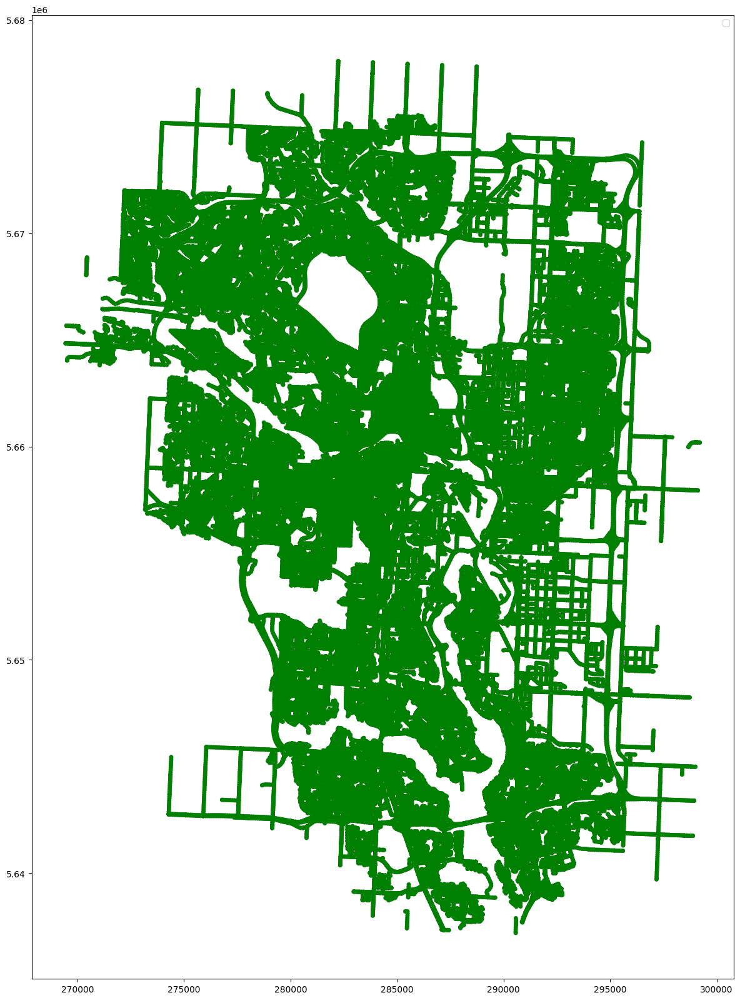

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 171464 entries, 0 to 225779
Data columns (total 3 columns):
 #   Column       Non-Null Count   Dtype   
---  ------       --------------   -----   
 0   geometry     171464 non-null  geometry
 1   SPEED_LIMIT  171464 non-null  float64 
 2   Indcidents   171464 non-null  int64   
dtypes: float64(1), geometry(1), int64(1)
memory usage: 5.2 MB
None


In [25]:

# Ensure both GeoDataFrames are in the same CRS
df_with_speed_incidents = mergeDFwithPointDF(points_gdf_buffered, data_incidents, 'Indcidents')

display(df_with_speed_incidents.info())
# Count the number of NA values in each column
na_counts = df_with_speed_incidents.isna().sum()

# Display the counts
print(f"na_counts {na_counts}")

na_rows = df_with_speed_incidents[df_with_speed_incidents['Indcidents'].isna()]

# Display these rows
print(f"na_rows {na_rows}")

# Identifying matched (where mean_SPEED_LIMIT is not NaN) and unmatched points
matched_points = df_with_speed_incidents.dropna(subset=['Indcidents'])
unmatched_points = df_with_speed_incidents[df_with_speed_incidents['Indcidents'].isna()]

fig, ax = plt.subplots(figsize=(20, 20))

# Plot road network
points_gdf_buffered.plot(ax=ax, color='gray', linewidth=1, label='Road Network')

# Plot matched points
matched_points.plot(ax=ax, color='green', markersize=5, label='Matched Points')

# Plot unmatched points
unmatched_points.plot(ax=ax, color='red', markersize=5, label='Unmatched Points')

plt.legend()
plt.show()

df_with_speed_incidents = df_with_speed_incidents.dropna(subset=['SPEED_LIMIT', 'Indcidents'])
print(df_with_speed_incidents.info())


### Merge the points with number of Traffic Signal Signs

In [26]:

# # Ensure both GeoDataFrames are in the same CRS
# df_with_speed_incidents_sign = mergeDFwithPointDF(df_with_speed_incidents, data_sign, 'Sign')

# display(df_with_speed_incidents_sign.info())
# # Count the number of NA values in each column
# na_counts = df_with_speed_incidents_sign.isna().sum()

# # Display the counts
# print(f"na_counts {na_counts}")

# na_rows = df_with_speed_incidents_sign[df_with_speed_incidents_sign['Sign'].isna()]

# # Display these rows
# print(f"na_rows {na_rows}")

# # Identifying matched (where mean_SPEED_LIMIT is not NaN) and unmatched points
# matched_points = df_with_speed_incidents_sign.dropna(subset=['Sign'])
# unmatched_points = df_with_speed_incidents_sign[df_with_speed_incidents_sign['Sign'].isna()]

# fig, ax = plt.subplots(figsize=(20, 20))

# # Plot road network
# points_gdf_buffered.plot(ax=ax, color='gray', linewidth=1, label='Road Network')

# # Plot matched points
# matched_points.plot(ax=ax, color='green', markersize=5, label='Matched Points')

# # Plot unmatched points
# unmatched_points.plot(ax=ax, color='red', markersize=5, label='Unmatched Points')

# plt.legend()
# plt.show()

# df_with_speed_incidents_sign = df_with_speed_incidents_sign.dropna(subset=['SPEED_LIMIT', 'Indcidents', 'Sign'])
# print(df_with_speed_incidents_sign.info())


In [27]:
def extract_size(sign_size):
    # Handle various delimiters and remove non-numeric characters
    sign_size = re.sub(r'[^\d.x]', '', sign_size.lower())  # Remove everything except numbers, 'x', and '.'
    
    # Extract numbers (width and height)
    numbers = re.findall(r'\d+', sign_size)
    
    # Calculate area if two dimensions are found
    if len(numbers) == 2:
        width, height = map(int, numbers)
        return width * height  # Return the calculated area
    elif len(numbers) == 1:
        # If only one dimension is provided, assume a square sign
        dimension = int(numbers[0])
        return dimension * dimension
    return None  # Return None if the proper dimensions couldn't be extracted

# Apply the function to the 'SIGN_SIZE' column to create a new 'Area' column
data_sign['Area'] = data_sign['SIGN_SIZE'].apply(extract_size)

# Drop rows where area could not be calculated
data_sign = data_sign.dropna(subset=['Area'])

# Define size thresholds based on quantiles
small_threshold = data_sign['Area'].quantile(0.33)
large_threshold = data_sign['Area'].quantile(0.67)

# Function to categorize sizes
def categorize_size(area):
    if area < small_threshold:
        return 'Small'
    elif area < large_threshold:
        return 'Medium'
    else:
        return 'Large'

# Apply the categorization function
data_sign['Size_Category'] = data_sign['Area'].apply(categorize_size)


# Display updated DataFrame information
display(data_sign.head())
display(data_sign.info())


C:\Users\lidou\AppData\Roaming\Python\Python311\site-packages\geopandas\geodataframe.py:1525: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


,INSTDATE,SIGN_CODE,SIGN_DSCRN,SIGN_SIZE,SIGN_TYPE,SUPPORT_TYPE,POINT,geometry,Area,Size_Category
6,2017/10/26,11-250,KRMS,600x750,Flat Sheet,Pedestal,POINT (-114.1969592 51.1542101),POINT (276439.761 5671833.766),450000.0,Medium
7,2020/12/02,11-250,KRMS,600x750,Flat Sheet,Pedestal,POINT (-114.2109842 51.0594918),POINT (274999.449 5661346.785),450000.0,Medium
9,2021/01/18,14-320,TAC Pedestrian Crosswalk,900x1200,Other,Arm,POINT (-114.0758307 51.1115973),POINT (284710.187 5666734.990),1080000.0,Large
10,2013/09/24,14-308,Pedestrian Crosswalk,600x750,Flat Sheet,Trunk,POINT (-114.1022882 51.0576832),POINT (282605.945 5660819.075),450000.0,Medium
11,2018/07/23,11-647,Turn Control - Thru + Left,900x900,Flat Sheet,Arm,POINT (-114.0317578 51.0474608),POINT (287500.600 5659476.697),810000.0,Large


<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 4670 entries, 6 to 5215
Data columns (total 10 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   INSTDATE       4670 non-null   object  
 1   SIGN_CODE      4670 non-null   object  
 2   SIGN_DSCRN     4670 non-null   object  
 3   SIGN_SIZE      4670 non-null   object  
 4   SIGN_TYPE      4670 non-null   object  
 5   SUPPORT_TYPE   4670 non-null   object  
 6   POINT          4670 non-null   object  
 7   geometry       4670 non-null   geometry
 8   Area           4670 non-null   float64 
 9   Size_Category  4670 non-null   object  
dtypes: float64(1), geometry(1), object(8)
memory usage: 401.3+ KB


None

In [28]:
def mergeDFwithComplexPointDF_sign(base_df, point_df, sign_type_col, sign_size_col):
    # Ensure both GeoDataFrames are in the same CRS
    base_df_temp = base_df.copy()
    base_df_temp.set_crs(epsg=32612, inplace=True)
    display(base_df_temp.head())

    point_df_temp = point_df.copy()
    point_df_temp.set_crs(epsg=32612, inplace=True)
    display(point_df_temp.head())
    
    point_df_temp[sign_type_col] = point_df_temp[sign_type_col].fillna(0).astype(str)
    point_df_temp[sign_size_col] = point_df_temp[sign_size_col].fillna(0).astype(str)
    
    # Perform the spatial join
    joined = gpd.sjoin(base_df_temp, point_df_temp, how='left', predicate='intersects')

    # Initialize columns in base_df for sign types and sizes counts
    unique_sign_types = point_df_temp[sign_type_col].unique().astype(str)
    unique_sign_sizes = point_df_temp[sign_size_col].unique().astype(str)
    
    
    for sign_type in unique_sign_types:
        type_col_name = f"{sign_type_col}_{sign_type.replace('nan', 'unknown').replace(' ', '_')}"
        base_df_temp[type_col_name] = 0
    for sign_size in unique_sign_sizes:
        size_col_name = f"{sign_size_col}_{sign_size.replace('nan', 'unknown').replace(' ', '_')}"
        base_df_temp[size_col_name] = 0
    
    # Count occurrences for each sign type and size
    for index, group in joined.groupby(joined.index):
        for sign_type in group[sign_type_col].unique():
            type_col_name = f"{sign_type_col}_{str(sign_type).replace('nan', 'unknown').replace(' ', '_')}"
            base_df_temp.loc[index, type_col_name] = len(group[group[sign_type_col] == sign_type])
        for sign_size in group[sign_size_col].unique():
            size_col_name = f"{sign_size_col}_{str(sign_size).replace('nan', 'unknown').replace(' ', '_')}"
            base_df_temp.loc[index, size_col_name] = len(group[group[sign_size_col] == sign_size])
    
    return base_df_temp


# Call the function
df_with_speed_incidents_sign_complex = mergeDFwithComplexPointDF_sign(
    df_with_speed_incidents, data_sign, 'SIGN_TYPE', 'Size_Category'
)

df_with_speed_incidents_sign_complex = df_with_speed_incidents_sign_complex.drop(['SIGN_TYPE_unknown', 'Size_Category_unknown'], axis=1)

# Display the results
display(df_with_speed_incidents_sign_complex.head())
display(df_with_speed_incidents_sign_complex.info())


,geometry,SPEED_LIMIT,Indcidents
0,"POLYGON ((287725.389 5646480.682, 287724.907 5...",40.0,1
1,"POLYGON ((287689.401 5646481.723, 287688.919 5...",40.0,1
2,"POLYGON ((287689.401 5646481.723, 287688.919 5...",40.0,1
3,"POLYGON ((287679.238 5646481.873, 287678.757 5...",40.0,1
4,"POLYGON ((287719.171 5646387.709, 287718.689 5...",40.0,0


,INSTDATE,SIGN_CODE,SIGN_DSCRN,SIGN_SIZE,SIGN_TYPE,SUPPORT_TYPE,POINT,geometry,Area,Size_Category
6,2017/10/26,11-250,KRMS,600x750,Flat Sheet,Pedestal,POINT (-114.1969592 51.1542101),POINT (276439.761 5671833.766),450000.0,Medium
7,2020/12/02,11-250,KRMS,600x750,Flat Sheet,Pedestal,POINT (-114.2109842 51.0594918),POINT (274999.449 5661346.785),450000.0,Medium
9,2021/01/18,14-320,TAC Pedestrian Crosswalk,900x1200,Other,Arm,POINT (-114.0758307 51.1115973),POINT (284710.187 5666734.990),1080000.0,Large
10,2013/09/24,14-308,Pedestrian Crosswalk,600x750,Flat Sheet,Trunk,POINT (-114.1022882 51.0576832),POINT (282605.945 5660819.075),450000.0,Medium
11,2018/07/23,11-647,Turn Control - Thru + Left,900x900,Flat Sheet,Arm,POINT (-114.0317578 51.0474608),POINT (287500.600 5659476.697),810000.0,Large


,geometry,SPEED_LIMIT,Indcidents,SIGN_TYPE_Flat_Sheet,SIGN_TYPE_Other,SIGN_TYPE_Varicom,SIGN_TYPE_LED,SIGN_TYPE_Internally_illuminated,Size_Category_Medium,Size_Category_Large,Size_Category_Small
0,"POLYGON ((287725.389 5646480.682, 287724.907 5...",40.0,1,1,0,0,0,0,1,0,0
1,"POLYGON ((287689.401 5646481.723, 287688.919 5...",40.0,1,1,0,0,0,0,1,0,0
2,"POLYGON ((287689.401 5646481.723, 287688.919 5...",40.0,1,1,0,0,0,0,1,0,0
3,"POLYGON ((287679.238 5646481.873, 287678.757 5...",40.0,1,1,0,0,0,0,1,0,0
4,"POLYGON ((287719.171 5646387.709, 287718.689 5...",40.0,0,0,0,0,0,0,0,0,0


<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 171464 entries, 0 to 225779
Data columns (total 11 columns):
 #   Column                            Non-Null Count   Dtype   
---  ------                            --------------   -----   
 0   geometry                          171464 non-null  geometry
 1   SPEED_LIMIT                       171464 non-null  float64 
 2   Indcidents                        171464 non-null  int64   
 3   SIGN_TYPE_Flat_Sheet              171464 non-null  int64   
 4   SIGN_TYPE_Other                   171464 non-null  int64   
 5   SIGN_TYPE_Varicom                 171464 non-null  int64   
 6   SIGN_TYPE_LED                     171464 non-null  int64   
 7   SIGN_TYPE_Internally_illuminated  171464 non-null  int64   
 8   Size_Category_Medium              171464 non-null  int64   
 9   Size_Category_Large               171464 non-null  int64   
 10  Size_Category_Small               171464 non-null  int64   
dtypes: float64(1), geometry(1), int64(9)

None

### Merge the points with number of Crosswalk

In [30]:
def mergeDFwithComplexPointDF_crosswalk(base_df, point_df, crosswalk_type_col):
    # Ensure both GeoDataFrames are in the same CRS
    base_df_temp = base_df.copy()
    base_df_temp.set_crs(epsg=32612, inplace=True)
    display(base_df_temp.head())

    point_df_temp = point_df.copy()
    point_df_temp.set_crs(epsg=32612, inplace=True)
    display(point_df_temp.head())

    point_df_temp[crosswalk_type_col] = point_df_temp[crosswalk_type_col].replace('SIGNAL', 'SIGNALIZED')
    point_df_temp[crosswalk_type_col] = point_df_temp[crosswalk_type_col].replace('MIDBLOCK', 'MID_BLOCK')
    
    point_df_temp[crosswalk_type_col] = point_df_temp[crosswalk_type_col].fillna(0).astype(str)
    
    # Perform the spatial join
    joined = gpd.sjoin(base_df_temp, point_df_temp, how='left', predicate='intersects')

    # Initialize columns in base_df for sign types and sizes counts
    unique_sign_types = point_df_temp[crosswalk_type_col].unique().astype(str)
    
    
    for sign_type in unique_sign_types:
        type_col_name = f"{crosswalk_type_col}_{sign_type.replace('nan', 'unknown').replace(' ', '_')}"
        base_df_temp[type_col_name] = 0
    
    # Count occurrences for each sign type and size
    for index, group in joined.groupby(joined.index):
        for sign_type in group[crosswalk_type_col].unique():
            type_col_name = f"{crosswalk_type_col}_{str(sign_type).replace('nan', 'unknown').replace(' ', '_')}"
            base_df_temp.loc[index, type_col_name] = len(group[group[crosswalk_type_col] == sign_type])
    
    return base_df_temp


# Call the function
df_with_speed_incidents_sign_crosswalk_complex = mergeDFwithComplexPointDF_crosswalk(
    df_with_speed_incidents_sign_complex, data_crosswalk, 'CROSSWALK_TYPE'
)

df_with_speed_incidents_sign_crosswalk_complex = df_with_speed_incidents_sign_crosswalk_complex.drop(['CROSSWALK_TYPE_unknown'], axis=1)

# Display the results
display(df_with_speed_incidents_sign_crosswalk_complex.head())
display(df_with_speed_incidents_sign_crosswalk_complex.info())


,geometry,SPEED_LIMIT,Indcidents,SIGN_TYPE_Flat_Sheet,SIGN_TYPE_Other,SIGN_TYPE_Varicom,SIGN_TYPE_LED,SIGN_TYPE_Internally_illuminated,Size_Category_Medium,Size_Category_Large,Size_Category_Small
0,"POLYGON ((287725.389 5646480.682, 287724.907 5...",40.0,1,1,0,0,0,0,1,0,0
1,"POLYGON ((287689.401 5646481.723, 287688.919 5...",40.0,1,1,0,0,0,0,1,0,0
2,"POLYGON ((287689.401 5646481.723, 287688.919 5...",40.0,1,1,0,0,0,0,1,0,0
3,"POLYGON ((287679.238 5646481.873, 287678.757 5...",40.0,1,1,0,0,0,0,1,0,0
4,"POLYGON ((287719.171 5646387.709, 287718.689 5...",40.0,0,0,0,0,0,0,0,0,0


,CROSSWALK_TYPE,CROSSWALK_COMP,POINT,geometry
0,RSM,PARKING STALLS,POINT (-114.08130604284372 51.06727641297475),POINT (284120.635 5661823.806)
1,RSM,STOP LINE,POINT (-114.14111928809288 51.1831099606199),POINT (280481.098 5674878.256)
2,RSM,STOP LINE,POINT (-114.13499902937271 51.18319156789337),POINT (280909.112 5674869.061)
3,MULTIWAY STOP,STOP LINE,POINT (-114.08128908263517 50.98601632264809),POINT (283743.760 5652790.011)
4,SIGNALIZED,RIGHT TURN,POINT (-114.14117612481596 51.06009319728565),POINT (279892.864 5661202.565)


,geometry,SPEED_LIMIT,Indcidents,SIGN_TYPE_Flat_Sheet,SIGN_TYPE_Other,SIGN_TYPE_Varicom,SIGN_TYPE_LED,SIGN_TYPE_Internally_illuminated,Size_Category_Medium,Size_Category_Large,...,CROSSWALK_TYPE_ELDERLY_PEDESTRIAN,CROSSWALK_TYPE_ELDERLY,CROSSWALK_TYPE_RRXING,CROSSWALK_TYPE_PENDING_WO,CROSSWALK_TYPE_STOP,CROSSWALK_TYPE_SPEED_TABLE,CROSSWALK_TYPE_TRAFFIC_CIRCLE,CROSSWALK_TYPE_OSM,CROSSWALK_TYPE_CIRCLE,CROSSWALK_TYPE_SPECIAL
0,"POLYGON ((287725.389 5646480.682, 287724.907 5...",40.0,1,1,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
1,"POLYGON ((287689.401 5646481.723, 287688.919 5...",40.0,1,1,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
2,"POLYGON ((287689.401 5646481.723, 287688.919 5...",40.0,1,1,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
3,"POLYGON ((287679.238 5646481.873, 287678.757 5...",40.0,1,1,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
4,"POLYGON ((287719.171 5646387.709, 287718.689 5...",40.0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 171464 entries, 0 to 225779
Data columns (total 31 columns):
 #   Column                             Non-Null Count   Dtype   
---  ------                             --------------   -----   
 0   geometry                           171464 non-null  geometry
 1   SPEED_LIMIT                        171464 non-null  float64 
 2   Indcidents                         171464 non-null  int64   
 3   SIGN_TYPE_Flat_Sheet               171464 non-null  int64   
 4   SIGN_TYPE_Other                    171464 non-null  int64   
 5   SIGN_TYPE_Varicom                  171464 non-null  int64   
 6   SIGN_TYPE_LED                      171464 non-null  int64   
 7   SIGN_TYPE_Internally_illuminated   171464 non-null  int64   
 8   Size_Category_Medium               171464 non-null  int64   
 9   Size_Category_Large                171464 non-null  int64   
 10  Size_Category_Small                171464 non-null  int64   
 11  CROSSWALK_TYPE_RSM     

None

### Plotting the distribution of the incidents

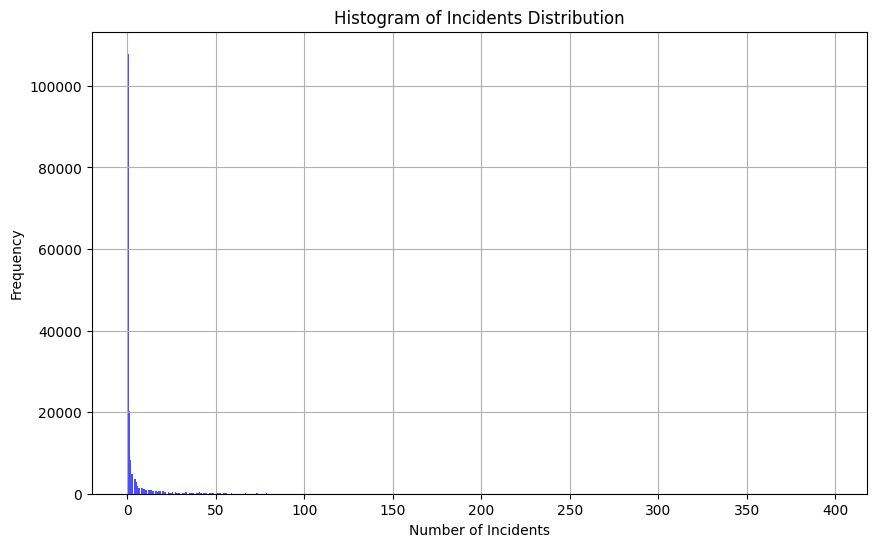

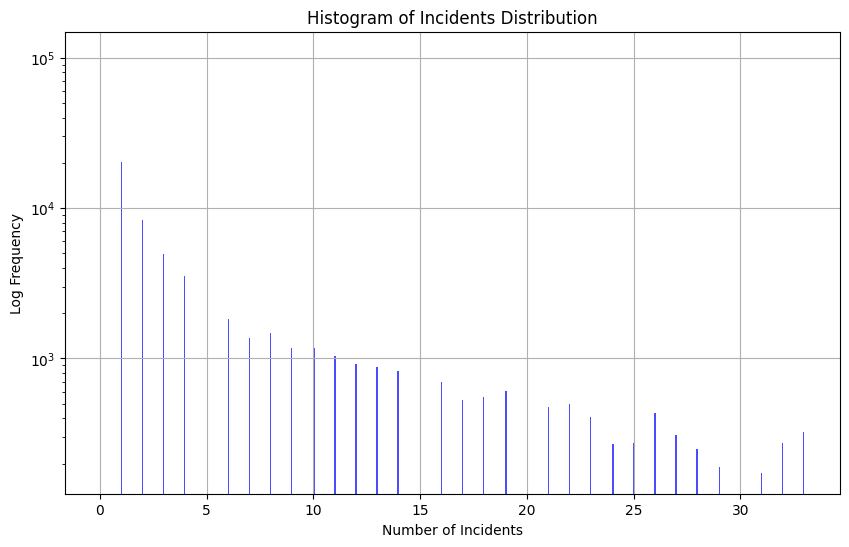

,Number of Incidents,Frequency
0,0,107881
1,1,20190
2,2,8300
3,3,4920
4,4,3529
...,...,...
174,166,1
175,275,1
176,250,1
177,184,1


In [31]:
# Calculate the interquartile range (IQR)
Q1 = df_with_speed_incidents_sign_crosswalk_complex['Indcidents'].quantile(0.25)
Q3 = df_with_speed_incidents_sign_crosswalk_complex['Indcidents'].quantile(0.95)
IQR = Q3 - Q1

# Calculate the number of observations
n = df_with_speed_incidents_sign_crosswalk_complex['Indcidents'].count()

# Calculate the bin width using the Freedman-Diaconis rule
bin_width = 2 * (IQR / (n ** (1/3)))

# Calculate the total number of bins
bin_number = (df_with_speed_incidents_sign_crosswalk_complex['Indcidents'].max() - df_with_speed_incidents_sign_crosswalk_complex['Indcidents'].min()) / bin_width

# Now plot the histogram with the optimized bin width
plt.figure(figsize=(10, 6))
plt.hist(df_with_speed_incidents_sign_crosswalk_complex['Indcidents'], bins=int(bin_number), color='blue', alpha=0.7)
plt.title('Histogram of Incidents Distribution')
plt.xlabel('Number of Incidents')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

# Plot with limited x-axis range and log scale for y-axis
plt.figure(figsize=(10, 6))
plt.hist(df_with_speed_incidents_sign_crosswalk_complex['Indcidents'], bins=int(bin_number), color='blue', alpha=0.7, range=(0, Q3 * 1.5))
plt.yscale('log')  # Set y-axis to log scale
plt.title('Histogram of Incidents Distribution')
plt.xlabel('Number of Incidents')
plt.ylabel('Log Frequency')
plt.grid(True)
plt.show()


# Create a DataFrame to count the occurrences of 'Indcidents'
histogram_df = df_with_speed_incidents_sign_crosswalk_complex['Indcidents'].value_counts().reset_index()
histogram_df.columns = ['Number of Incidents', 'Frequency']

# Display the histogram DataFrame
display(histogram_df)

### Function to plot the prediction map

In [160]:
def drawPredictionMap(original, X_test, y_pred, y_test, title):

    X_test_plot = X_test.copy()
    
    # Add predictions and true values to the original dataframe
    X_test_plot['predicted'] = y_pred
    X_test_plot['true'] = y_test
    
    # Merge predictions back with the original dataframe using the index
    results = X_test_plot.assign(Predicted_Labels=y_pred)
    merged_results = results.merge(original[['index', 'geometry']], on='index', how='left')
    
    # Filter correctly and incorrectly classified instances
    correct = merged_results[merged_results['true'] == merged_results['predicted']]
    incorrect_t_b_p = merged_results[merged_results['true'] > merged_results['predicted']]
    incorrect_p_b_t = merged_results[merged_results['true'] < merged_results['predicted']]
    
    correct = gpd.GeoDataFrame(correct, geometry='geometry')
    incorrect_t_b_p = gpd.GeoDataFrame(incorrect_t_b_p, geometry='geometry')
    incorrect_p_b_t = gpd.GeoDataFrame(incorrect_p_b_t, geometry='geometry')
    
    # Plotting using Geopandas or another suitable library
    fig, ax = plt.subplots(figsize=(10, 10))
    
    # Plot each geodataframe with its respective color
    correct.plot(ax=ax, color='green')
    incorrect_t_b_p.plot(ax=ax, color='yellow')
    incorrect_p_b_t.plot(ax=ax, color='red')
    
    # Create custom legend handles
    correct_legend = mlines.Line2D([], [], color='green', marker='o', linestyle='None', markersize=10, label='Correct Predictions')
    incorrect_t_b_p_legend = mlines.Line2D([], [], color='yellow', marker='o', linestyle='None', markersize=10, label='Incorrect - True > Predicted')
    incorrect_p_b_t_legend = mlines.Line2D([], [], color='red', marker='o', linestyle='None', markersize=10, label='Incorrect - Predicted > True')
    
    # Add title, legend, and axis labels
    plt.title(f'Geographic Distribution of Decision Tree Predictions - {title}')
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    
    # Add the custom legend handles to the legend
    plt.legend(handles=[correct_legend, incorrect_t_b_p_legend, incorrect_p_b_t_legend], loc='upper left', bbox_to_anchor=(1,1))
    
    # Optionally, if you need to adjust layout to make space for the legend, uncomment the following line:
    # plt.tight_layout(rect=[0, 0, 0.85, 1])
    
    plt.show()
    
    
    # Plotting using Geopandas or another suitable library
    fig, ax = plt.subplots(figsize=(10, 10))
    
    # Plot incorrect predictions
    incorrect_p_b_t.plot(ax=ax, color='red', label='Incorrect Predictions')
    
    # Add title, legend, and axis labels
    plt.title(f'Potential Accident location - {title}')
    plt.legend()
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.tight_layout()
    plt.show()

### Data mining by Classification

In [161]:

df_with_speed_incidents_sign_crosswalk = df_with_speed_incidents_sign_crosswalk_complex.copy()
df_with_speed_incidents_sign_crosswalk.set_crs(epsg=32612, inplace=True)
df_with_speed_incidents_sign_crosswalk['index'] = df_with_speed_incidents_sign_crosswalk.index


# incidents_bins = [0, 15, 30, 45, 60, 75, 90, 105, 120, 135, 150, 165, 180, 195, 210, 225, 240, 255, 270, 285, 300, 315, 330, 345, 360, 375, np.inf]
#incidents_bins = [-1, 0, 50, 100, 150, 200, 250, 300, 350, np.inf]
incidents_bins = [-1, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, np.inf]

label_encoder = LabelEncoder()
incidents_labels = label_encoder.fit_transform(pd.cut(df_with_speed_incidents_sign_crosswalk['Indcidents'], bins=incidents_bins))
bins = pd.cut(df_with_speed_incidents_sign_crosswalk['Indcidents'], bins=incidents_bins)
df_with_speed_incidents_sign_crosswalk['Indcidents_bin'] = bins.cat.codes

display(df_with_speed_incidents_sign_crosswalk)

# Drop the unrelated column and also the Y related column 
X = df_with_speed_incidents_sign_crosswalk.drop(['geometry', 'Indcidents', 'Indcidents_bin'], axis=1)
X['index'] = df_with_speed_incidents_sign_crosswalk.index

y = df_with_speed_incidents_sign_crosswalk['Indcidents_bin']

# Split the data into training and testing sets
# Adjust the test_size as 0.25 for a 75-25 split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=100)

# print the train and test sets shapes
print(f'The shape of the training set is {X_train.shape}')
print(f'The shape of the testing set is {X_test.shape}')

# print the train and test sets shapes
print(f'The shape of the training set is {X_train.shape}')
print(f'The shape of the testing set is {X_test.shape}')

,geometry,SPEED_LIMIT,Indcidents,SIGN_TYPE_Flat_Sheet,SIGN_TYPE_Other,SIGN_TYPE_Varicom,SIGN_TYPE_LED,SIGN_TYPE_Internally_illuminated,Size_Category_Medium,Size_Category_Large,...,CROSSWALK_TYPE_RRXING,CROSSWALK_TYPE_PENDING_WO,CROSSWALK_TYPE_STOP,CROSSWALK_TYPE_SPEED_TABLE,CROSSWALK_TYPE_TRAFFIC_CIRCLE,CROSSWALK_TYPE_OSM,CROSSWALK_TYPE_CIRCLE,CROSSWALK_TYPE_SPECIAL,index,Indcidents_bin
0,"POLYGON ((287725.389 5646480.682, 287724.907 5...",40.0,1,1,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,1
1,"POLYGON ((287689.401 5646481.723, 287688.919 5...",40.0,1,1,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,1,1
2,"POLYGON ((287689.401 5646481.723, 287688.919 5...",40.0,1,1,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,2,1
3,"POLYGON ((287679.238 5646481.873, 287678.757 5...",40.0,1,1,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,3,1
4,"POLYGON ((287719.171 5646387.709, 287718.689 5...",40.0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,4,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
225775,"POLYGON ((294449.080 5661355.582, 294448.599 5...",70.0,46,7,0,0,0,0,2,5,...,0,0,0,0,0,0,0,0,225775,16
225776,"POLYGON ((294349.193 5661360.331, 294348.712 5...",70.0,55,2,0,0,0,0,0,2,...,0,0,0,0,0,0,0,0,225776,16
225777,"POLYGON ((294249.306 5661365.081, 294248.825 5...",70.0,40,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,225777,16
225778,"POLYGON ((294149.419 5661369.830, 294148.937 5...",70.0,31,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,225778,16


The shape of the training set is (128598, 30)
The shape of the testing set is (42866, 30)
The shape of the training set is (128598, 30)
The shape of the testing set is (42866, 30)


{'criterion': 'gini', 'max_depth': 7, 'max_leaf_nodes': 25, 'min_samples_split': 2}
Accuracy: 0.6809
Precision: 0.1167
Recall: 0.1087
F1 Score: 0.0892
ROC AUC: 0.6320



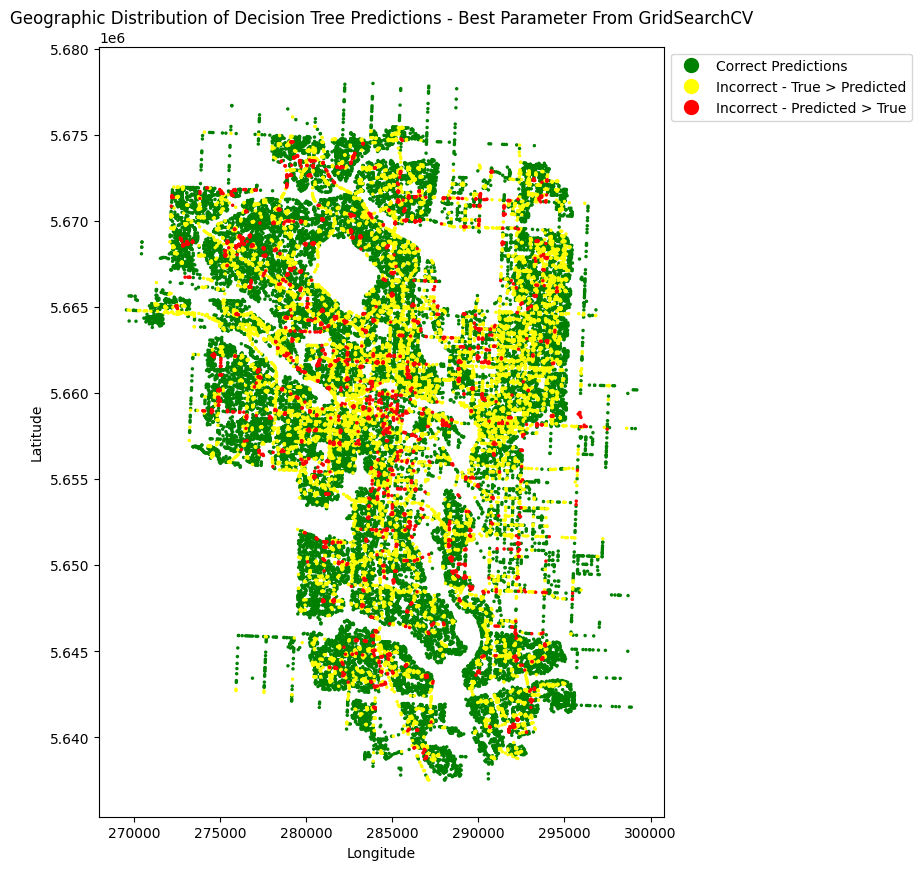

C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\1706777193.py:57: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  plt.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


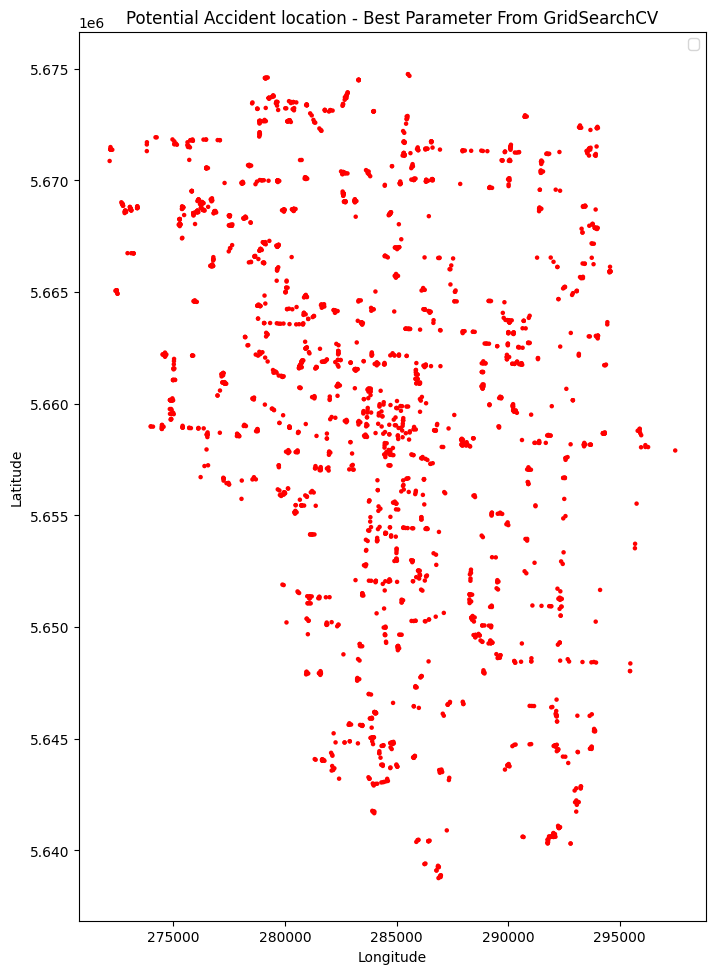

In [162]:
# Initialize the Decision Tree Classifier
dt_classifier = DecisionTreeClassifier(random_state=42)

# setup parameter space
parameters = {'criterion':['gini','entropy'],
              'max_depth':np.arange(1,21).tolist()[0::2],
              'min_samples_split':np.arange(2,11).tolist()[0::2],
              'max_leaf_nodes':np.arange(3,26).tolist()[0::2]}

# create an instance of the grid search object
g1 = GridSearchCV(DecisionTreeClassifier(), parameters, cv=5, n_jobs=-1)

# conduct grid search over the parameter space
g1.fit(X_train.drop('index', axis=1),y_train)
cls_params1 = g1.best_params_
print(cls_params1)

# Fit the classifier to the training data
model = g1.best_estimator_
model.fit(X_train.drop('index', axis=1), y_train)

# Predict on the test set
model_predictions = model.predict(X_test.drop('index', axis=1))

model_accuracy = accuracy_score(y_test, model_predictions)
model_precision = precision_score(y_test, model_predictions, average='macro', zero_division=0)
model_recall = recall_score(y_test, model_predictions, average='macro')
model_f1 = f1_score(y_test, model_predictions, average='macro')
model_proba = model.predict_proba(X_test.drop('index', axis=1))
model_roc_auc = roc_auc_score(y_test, model_proba, multi_class='ovo', average='macro') 

print(f'Accuracy: {model_accuracy:.4f}')
print(f'Precision: {model_precision:.4f}')
print(f'Recall: {model_recall:.4f}')
print(f'F1 Score: {model_f1:.4f}')
print(f'ROC AUC: {model_roc_auc:.4f}')
print('')

# Assuming `model` is your trained decision tree and X_test, y_test are defined
drawPredictionMap(df_with_speed_incidents_sign_crosswalk, X_test, model_predictions, y_test, "Best Parameter From GridSearchCV")

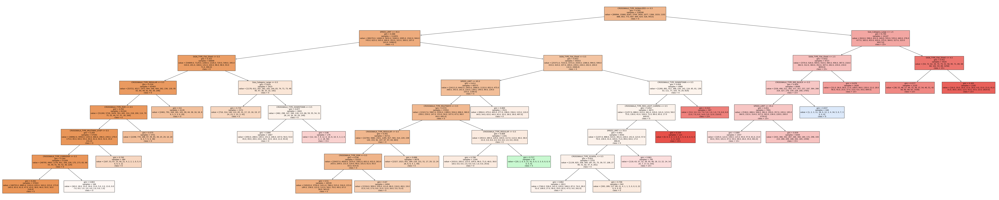

In [52]:
# Define feature names
# feature_names = ['SPEED_LIMIT', 'Sign', 'Crosswalk']
feature_names = ['SPEED_LIMIT', 'SIGN_TYPE_Flat_Sheet', 'SIGN_TYPE_Other', 'SIGN_TYPE_Varicom', 'SIGN_TYPE_LED', 'SIGN_TYPE_Internally_illuminated', 'Size_Category_Medium', 'Size_Category_Large', 'Size_Category_Small', 'CROSSWALK_TYPE_RSM', 'CROSSWALK_TYPE_MULTIWAY_STOP', 'CROSSWALK_TYPE_SIGNALIZED', 'CROSSWALK_TYPE_REGULAR', 'CROSSWALK_TYPE_MID_BLOCK', 'CROSSWALK_TYPE_SCHOOL', 'CROSSWALK_TYPE_DOWNTOWN', 'CROSSWALK_TYPE_MULTIWAYS', 'CROSSWALK_TYPE_CORRIDOR', 'CROSSWALK_TYPE_RED_LIGHT_CAMERA', 'CROSSWALK_TYPE_ELDERLY_PEDESTRIAN', 'CROSSWALK_TYPE_ELDERLY', 'CROSSWALK_TYPE_RRXING', 'CROSSWALK_TYPE_PENDING_WO', 'CROSSWALK_TYPE_STOP', 'CROSSWALK_TYPE_SPEED_TABLE', 'CROSSWALK_TYPE_TRAFFIC_CIRCLE', 'CROSSWALK_TYPE_OSM', 'CROSSWALK_TYPE_CIRCLE', 'CROSSWALK_TYPE_SPECIAL']
# Define class names
# class_names = ['0', '1-50', '51-100', '101-150', '151-200', '201-250', '251-300', '301-350', '350+']
class_names = ['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '15+']

# Plot the decision tree
plt.figure(figsize=(100,20))  # Set figure size (width, height) in inches
plot_tree(model, feature_names=feature_names, class_names=class_names, filled=True, fontsize=10)
plt.savefig('decision_tree_high_res.png', format='png', dpi=300)  # Save to file with high DPI
plt.show()


# viz = dtreeviz.model(model, 
#                X_train,  # Your features matrix (numpy array or pandas dataframe)
#                y_train,  # Your target vector (numpy array, pandas series, or list)
#                target_name='target',  # Name of the target variable
#                feature_names=feature_names, 
#                class_names=class_names)
# # viz.save("decision_tree.svg")  # Saves to an SVG file that you can zoom in on
# viz.view()  # Opens the tree visualization in your default web browser

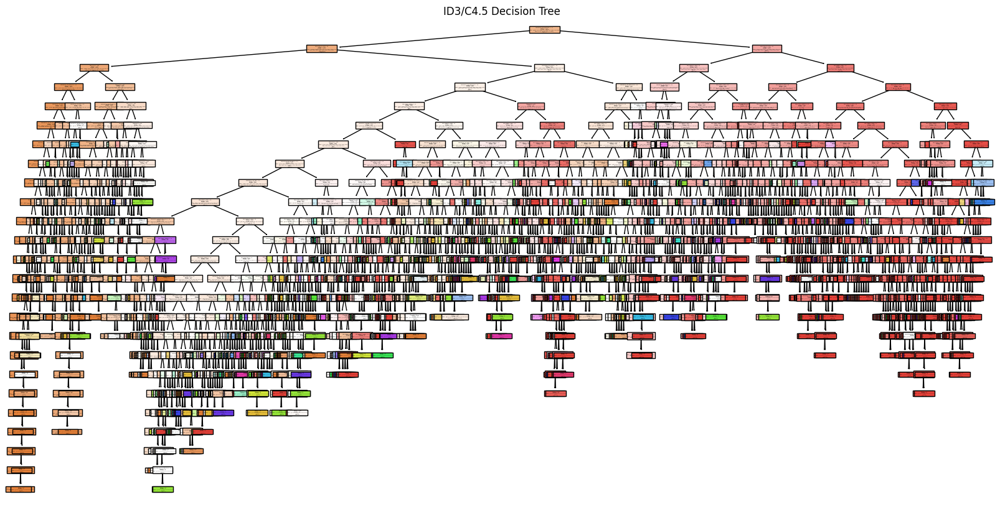

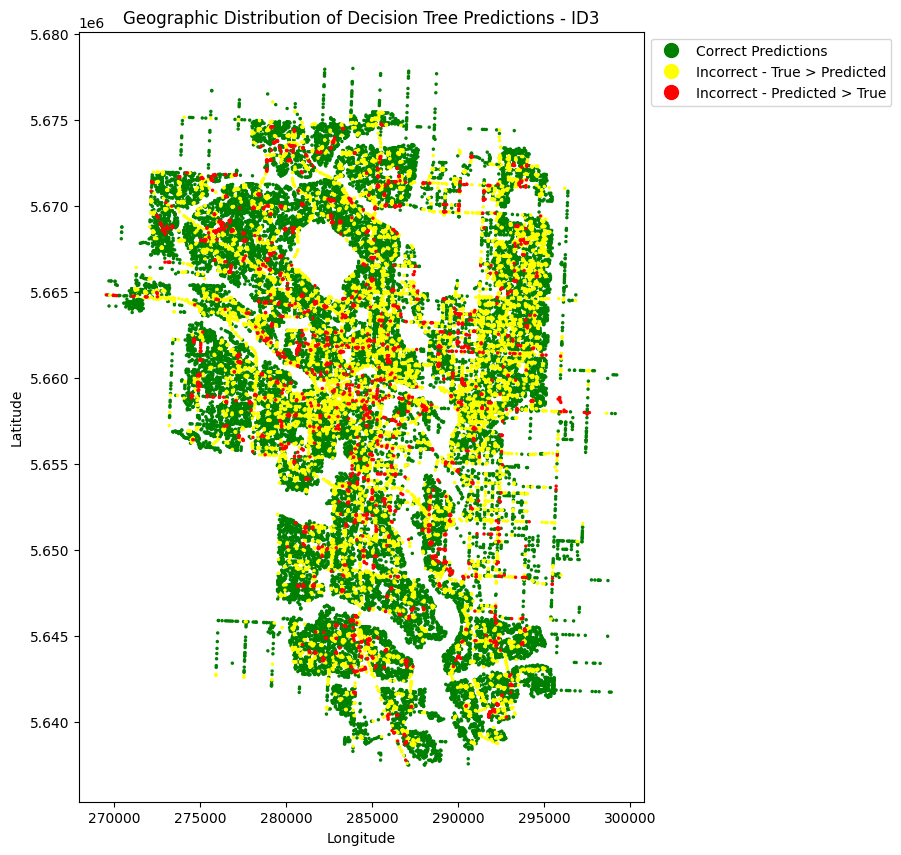

C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\1706777193.py:57: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  plt.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


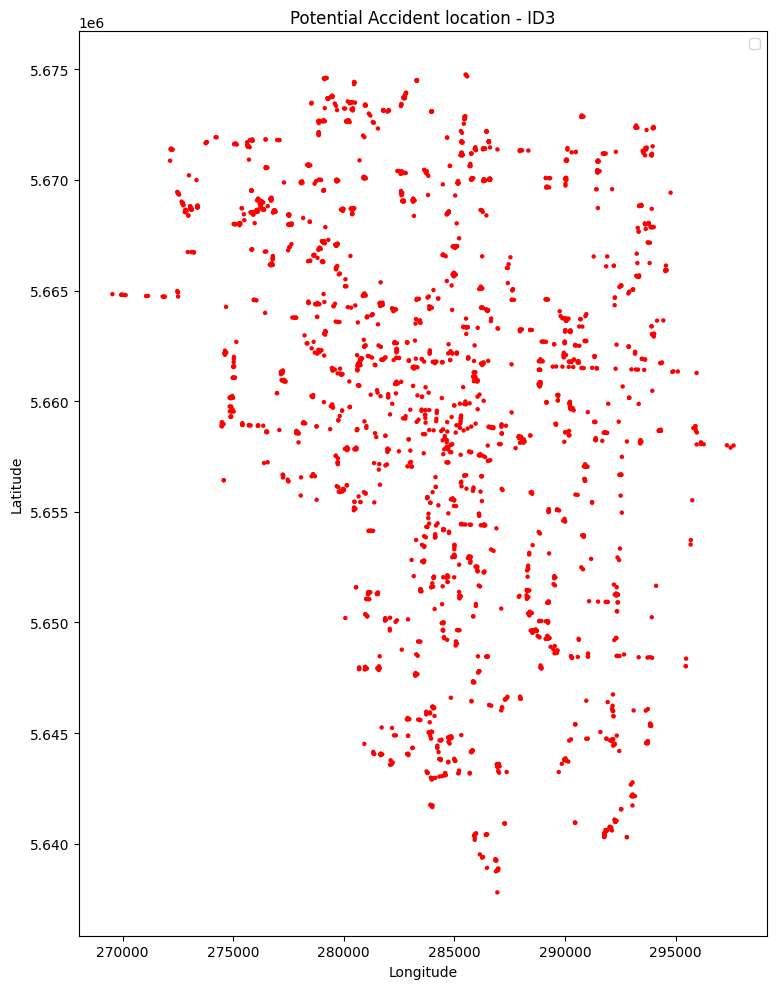

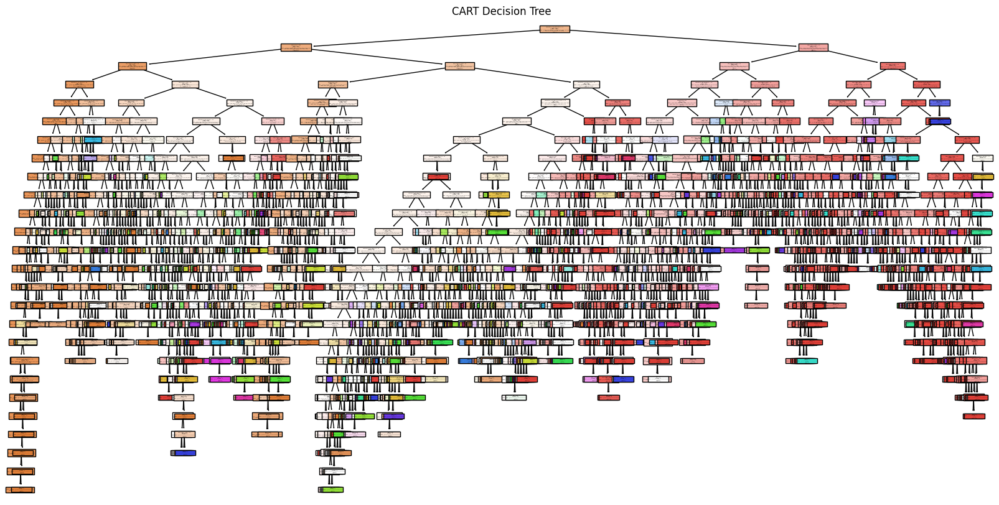

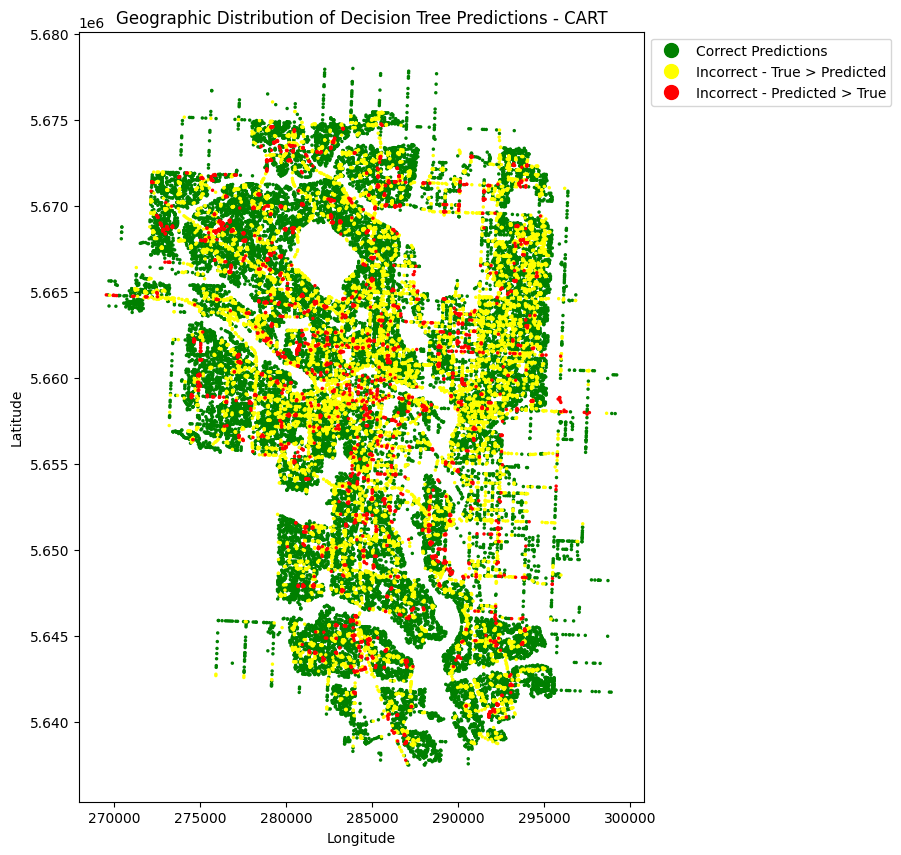

C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\1706777193.py:57: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  plt.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


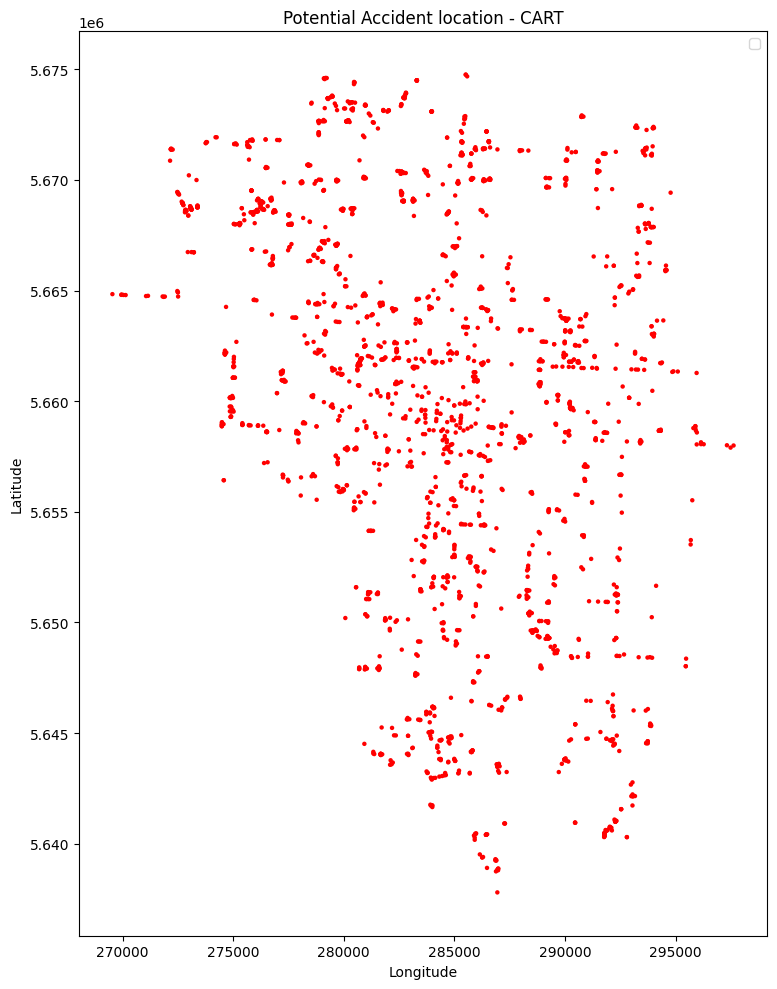

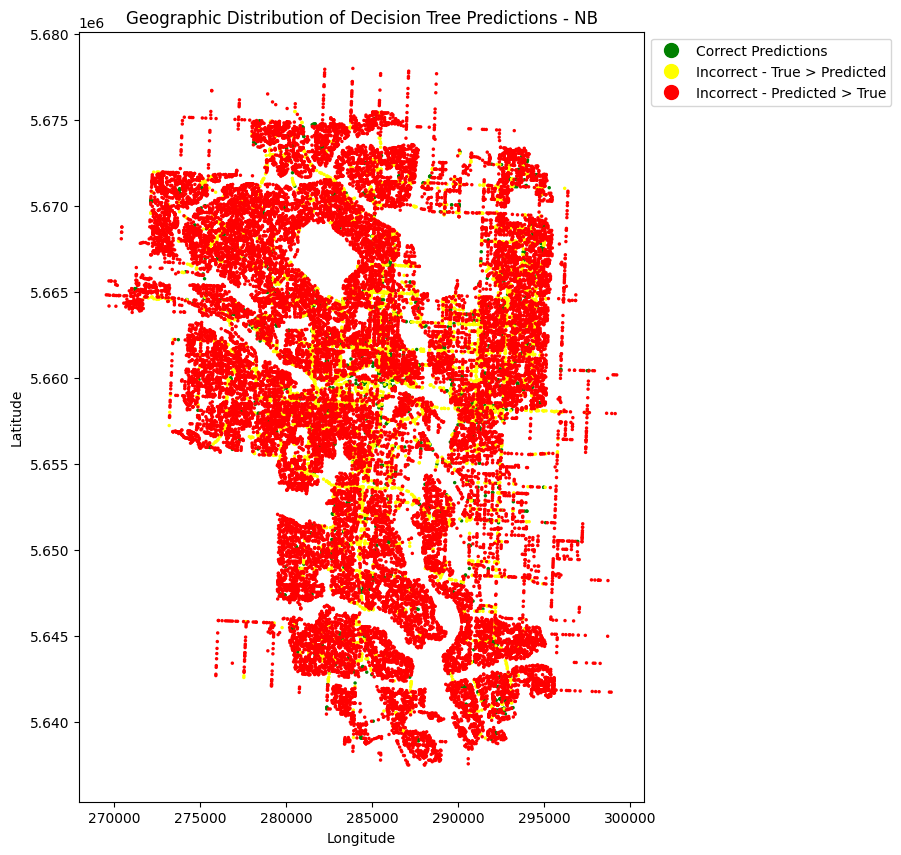

C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\1706777193.py:57: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  plt.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


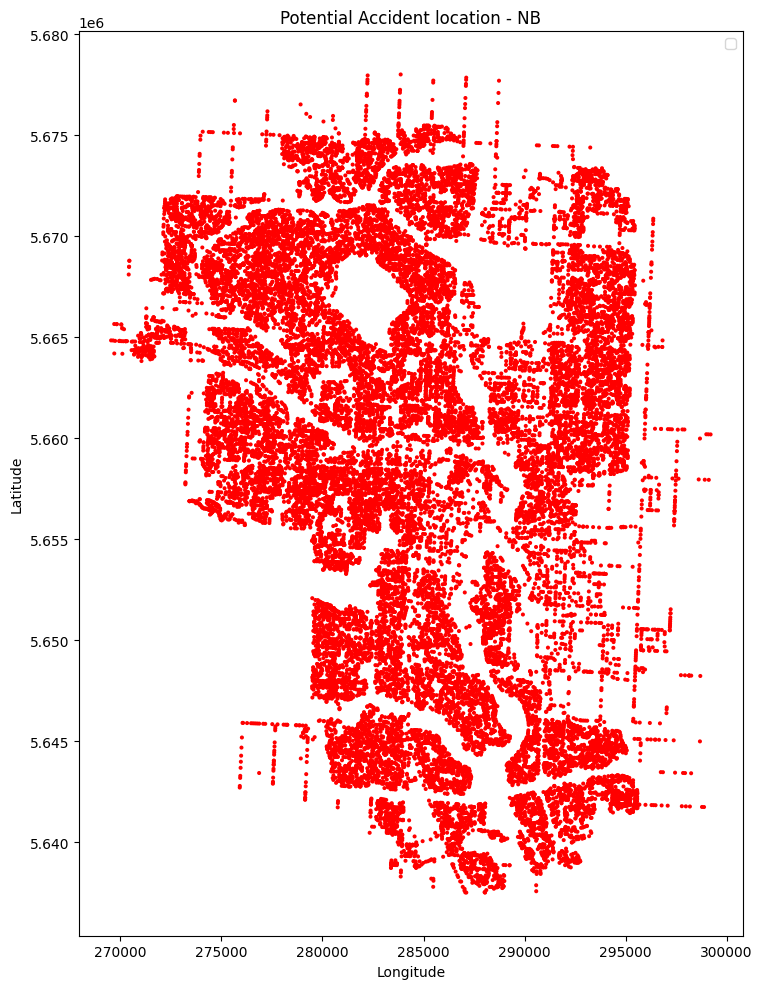

C:\Users\lidou\AppData\Roaming\Python\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:519: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


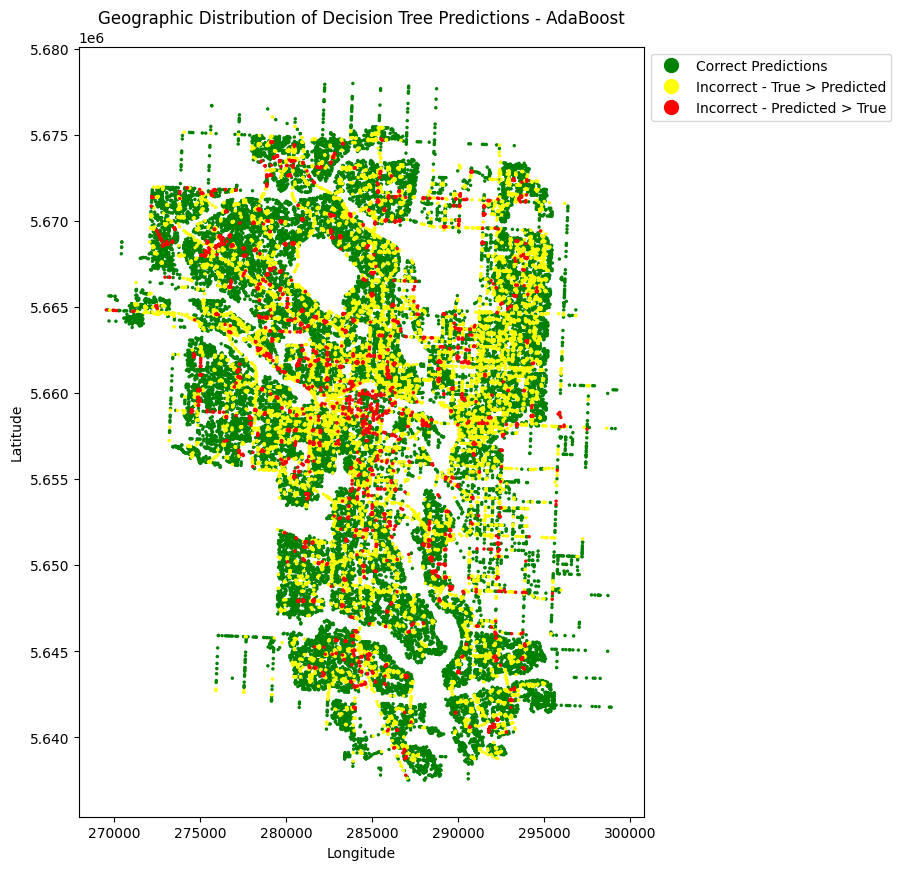

C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\1706777193.py:57: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  plt.legend()
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


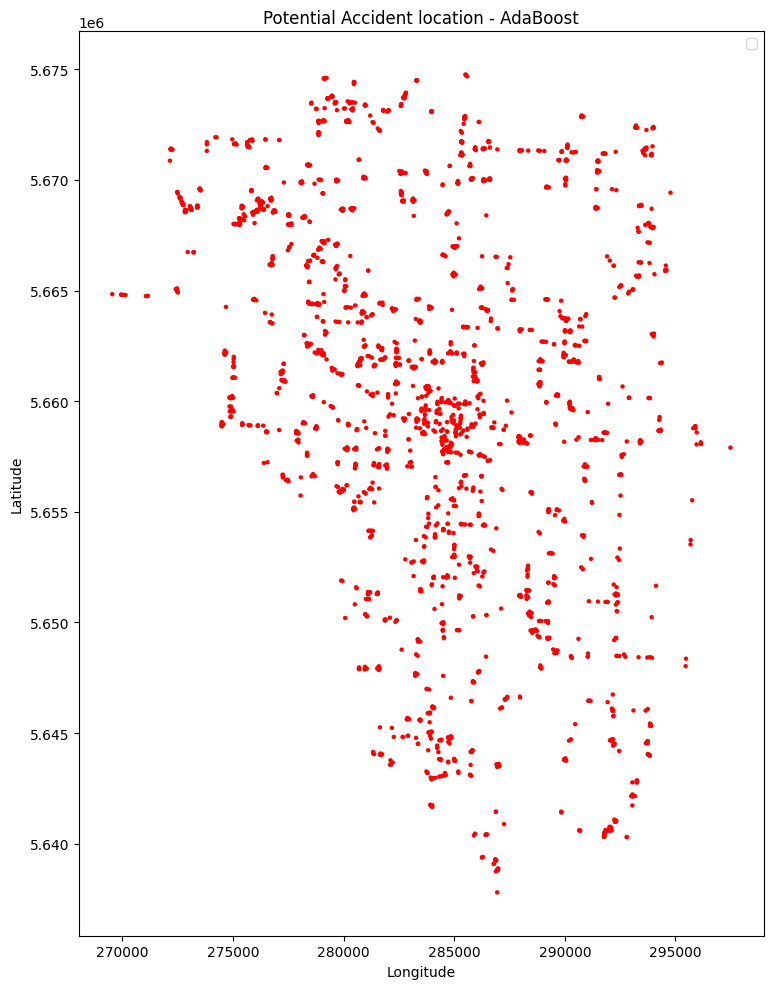

In [163]:

# collect the evaluation metrics for ID3/C4.5
id3_accuracy = None
id3_precision = None
id3_recall = None
id3_f1 = None
id3_roc_auc = None

# collect the evaluation metrics for CART
CART_accuracy = None
CART_precision = None
CART_recall = None
CART_f1 = None
CART_roc_auc = None

# collect the evaluation metrics for Naive Bayes
NB_accuracy = None
NB_precision = None
NB_recall = None
NB_f1 = None
NB_roc_auc = None

# collect the evaluation metrics for AdaBoost
AdaBoost_accuracy = None
AdaBoost_precision = None
AdaBoost_recall = None
AdaBoost_f1 = None
AdaBoost_roc_auc = None


# Initialize the Decision Tree Classifier with 'entropy' for ID3/C4.5 (Using Decision Trees with 'entropy'):
id3_classifier = DecisionTreeClassifier(criterion='entropy', random_state=42)
id3_classifier.fit(X_train.drop('index', axis=1), y_train)

# Predict on the test set
id3_predictions = id3_classifier.predict(X_test.drop('index', axis=1))

id3_accuracy = accuracy_score(y_test, id3_predictions)
id3_precision = precision_score(y_test, id3_predictions, average='macro', zero_division=0)
id3_recall = recall_score(y_test, id3_predictions, average='macro')
id3_f1 = f1_score(y_test, id3_predictions, average='macro')

id3_proba = id3_classifier.predict_proba(X_test.drop('index', axis=1))
id3_roc_auc = roc_auc_score(y_test, id3_proba, multi_class='ovo', average='macro') 

# ID3/C4.5 Decision Tree
plt.figure(figsize=(20, 10))
plot_tree(id3_classifier, feature_names=feature_names, class_names=class_names, filled=True)
plt.title('ID3/C4.5 Decision Tree')
plt.savefig('ID3_decision_tree.png')
plt.show()

drawPredictionMap(df_with_speed_incidents_sign_crosswalk, X_test, id3_predictions, y_test, "ID3")

# Initialize the Decision Tree Classifier with 'gini' for CART (Using Decision Trees with 'gini'):
CART_classifier = DecisionTreeClassifier(criterion='gini', random_state=42)
CART_classifier.fit(X_train.drop('index', axis=1), y_train)

# Predict on the test set
CART_predictions = CART_classifier.predict(X_test.drop('index', axis=1))

CART_accuracy = accuracy_score(y_test, CART_predictions)
CART_precision = precision_score(y_test, CART_predictions, average='macro', zero_division=0)
CART_recall = recall_score(y_test, CART_predictions, average='macro')
CART_f1 = f1_score(y_test, CART_predictions, average='macro')
CART_proba = CART_classifier.predict_proba(X_test.drop('index', axis=1))
CART_roc_auc = roc_auc_score(y_test, CART_proba, multi_class='ovo', average='macro') 

# CART Decision Tree
plt.figure(figsize=(20, 10))
plot_tree(CART_classifier, feature_names=feature_names, class_names=class_names, filled=True)
plt.title('CART Decision Tree')
plt.savefig('CART_decision_tree.png')
plt.show()

drawPredictionMap(df_with_speed_incidents_sign_crosswalk, X_test, CART_predictions, y_test, "CART")

# Initialize the Naive Bayes Classifier
NB_classifier = GaussianNB()  # Use MultinomialNB if your features are discrete or counts
NB_classifier.fit(X_train.drop('index', axis=1), y_train)

# Predict on the test set
NB_predictions = NB_classifier.predict(X_test.drop('index', axis=1))

NB_accuracy = accuracy_score(y_test, NB_predictions)
NB_precision = precision_score(y_test, NB_predictions, average='macro', zero_division=0)
NB_recall = recall_score(y_test, NB_predictions, average='macro')
NB_f1 = f1_score(y_test, NB_predictions, average='macro')
NB_proba = NB_classifier.predict_proba(X_test.drop('index', axis=1))
NB_roc_auc = roc_auc_score(y_test, NB_proba, multi_class='ovo', average='macro') 

drawPredictionMap(df_with_speed_incidents_sign_crosswalk, X_test, NB_predictions, y_test, "NB")

# Initialize the AdaBoost Classifier
AdaBoost_classifier = AdaBoostClassifier(random_state=42)
AdaBoost_classifier.fit(X_train.drop('index', axis=1), y_train)

# Predict on the test set
AdaBoost_predictions = AdaBoost_classifier.predict(X_test.drop('index', axis=1))

AdaBoost_accuracy = accuracy_score(y_test, AdaBoost_predictions)
AdaBoost_precision = precision_score(y_test, AdaBoost_predictions, average='macro', zero_division=0)
AdaBoost_recall = recall_score(y_test, AdaBoost_predictions, average='macro')
AdaBoost_f1 = f1_score(y_test, AdaBoost_predictions, average='macro')
AdaBoost_proba = AdaBoost_classifier.predict_proba(X_test.drop('index', axis=1))
AdaBoost_roc_auc = roc_auc_score(y_test, AdaBoost_proba, multi_class='ovo', average='macro') 

drawPredictionMap(df_with_speed_incidents_sign_crosswalk, X_test, AdaBoost_predictions, y_test, "AdaBoost")

In [164]:
print(f'ID3/C4.5 Accuracy: {id3_accuracy:.4f}')
print(f'ID3/C4.5 Precision: {id3_precision:.4f}')
print(f'ID3/C4.5 Recall: {id3_recall:.4f}')
print(f'ID3/C4.5 F1 Score: {id3_f1:.4f}')
print(f'ID3/C4.5 ROC AUC: {id3_roc_auc:.4f}')
print('')
print(f'CART Accuracy: {CART_accuracy:.4f}')
print(f'CART Precision: {CART_precision:.4f}')
print(f'CART Recall: {CART_recall:.4f}')
print(f'CART F1 Score: {CART_f1:.4f}')
print(f'CART ROC AUC: {CART_roc_auc:.4f}')
print('')
print(f'Naive Bayes Accuracy: {NB_accuracy:.4f}')
print(f'Naive Bayes Precision: {NB_precision:.4f}')
print(f'Naive Bayes Recall: {NB_recall:.4f}')
print(f'Naive Bayes F1 Score: {NB_f1:.4f}')
print(f'Naive Bayes ROC AUC: {NB_roc_auc:.4f}')
print('')
print(f'AdaBoost Accuracy: {AdaBoost_accuracy:.4f}')
print(f'AdaBoost Precision: {AdaBoost_precision:.4f}')
print(f'AdaBoost Recall: {AdaBoost_recall:.4f}')
print(f'AdaBoost F1 Score: {AdaBoost_f1:.4f}')
print(f'AdaBoost ROC AUC: {AdaBoost_roc_auc:.4f}')

ID3/C4.5 Accuracy: 0.6971
ID3/C4.5 Precision: 0.4961
ID3/C4.5 Recall: 0.1793
ID3/C4.5 F1 Score: 0.2104
ID3/C4.5 ROC AUC: 0.7439

CART Accuracy: 0.6968
CART Precision: 0.4933
CART Recall: 0.1788
CART F1 Score: 0.2097
CART ROC AUC: 0.7437

Naive Bayes Accuracy: 0.0424
Naive Bayes Precision: 0.1923
Naive Bayes Recall: 0.1033
Naive Bayes F1 Score: 0.0276
Naive Bayes ROC AUC: 0.6540

AdaBoost Accuracy: 0.6818
AdaBoost Precision: 0.1329
AdaBoost Recall: 0.1086
AdaBoost F1 Score: 0.0896
AdaBoost ROC AUC: 0.6687


### Data mining by Clustering


n_clusters 2


Most common attributes for Cluster:


C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni

,Cluster,SPEED_LIMIT_mode,SPEED_LIMIT_mean,SPEED_LIMIT_median
0,0,[50.0],53.190683,50.0
1,1,[40.0],39.978775,40.0


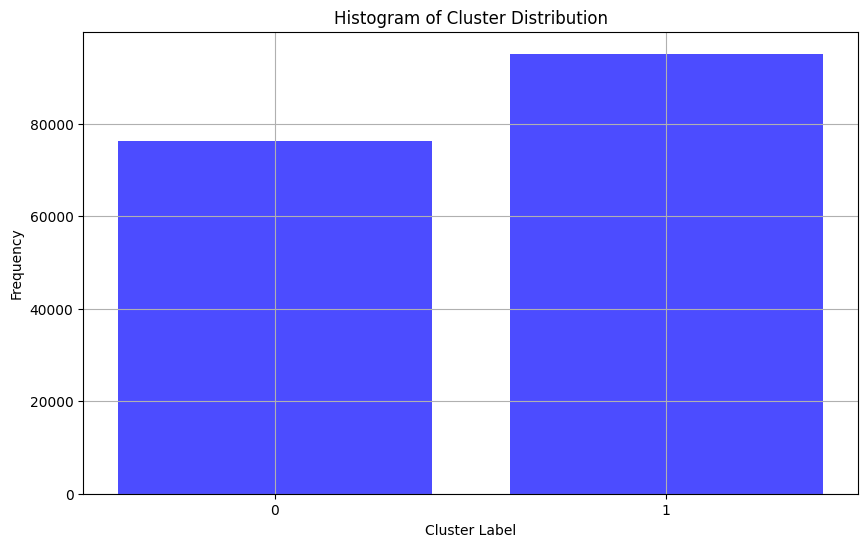

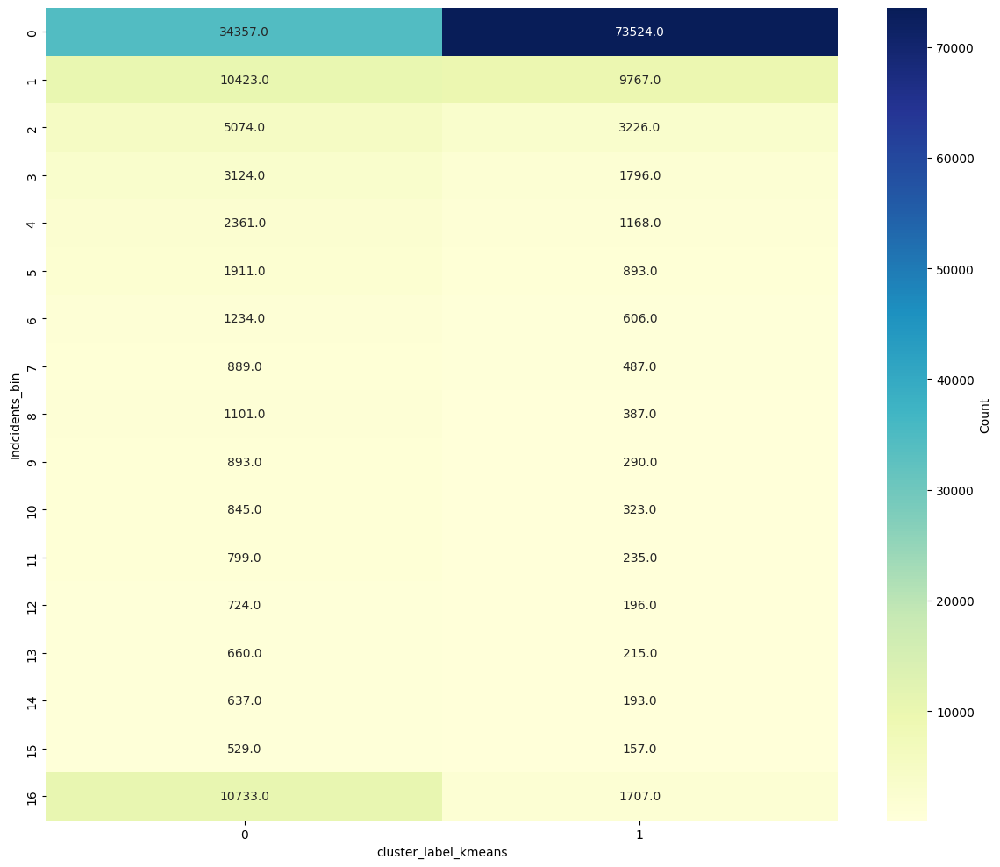

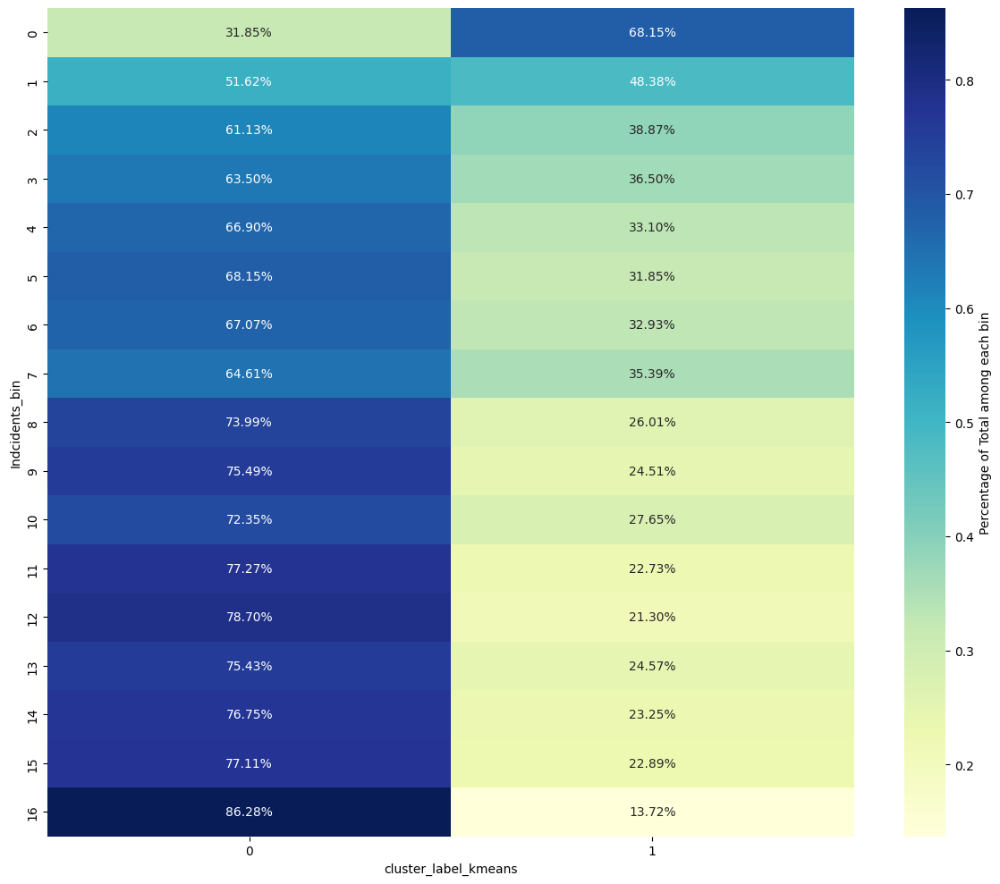

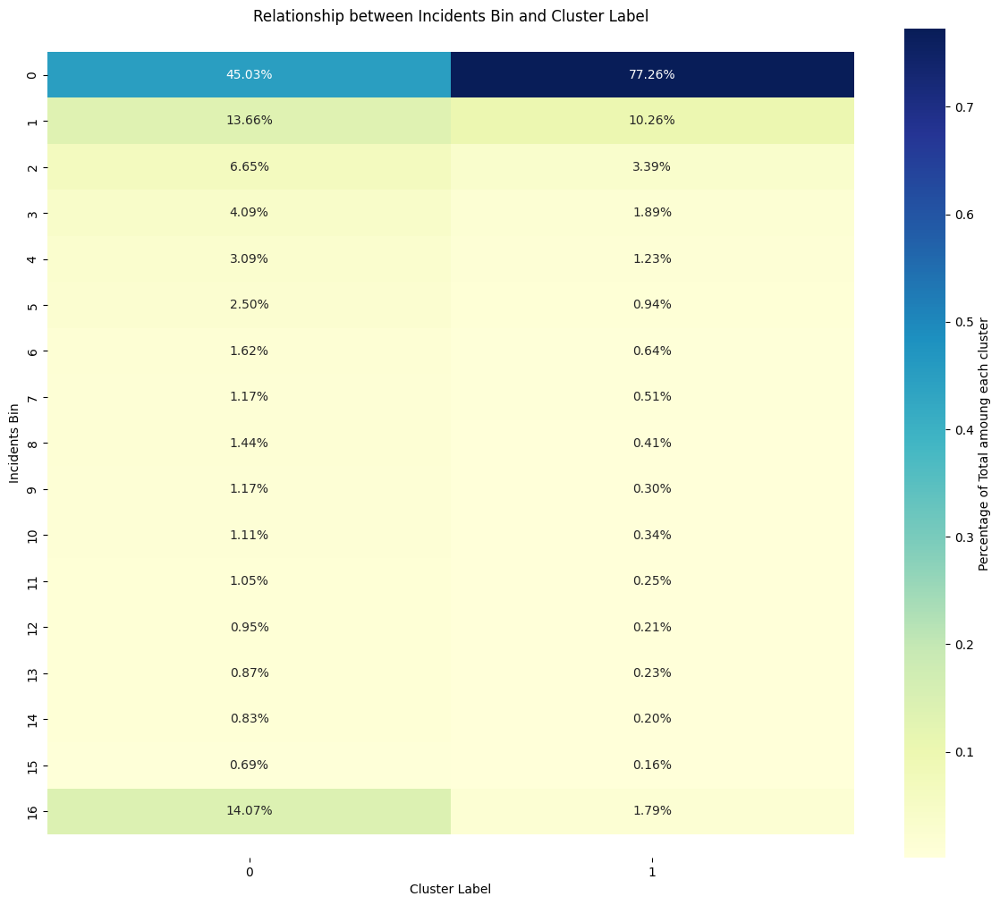

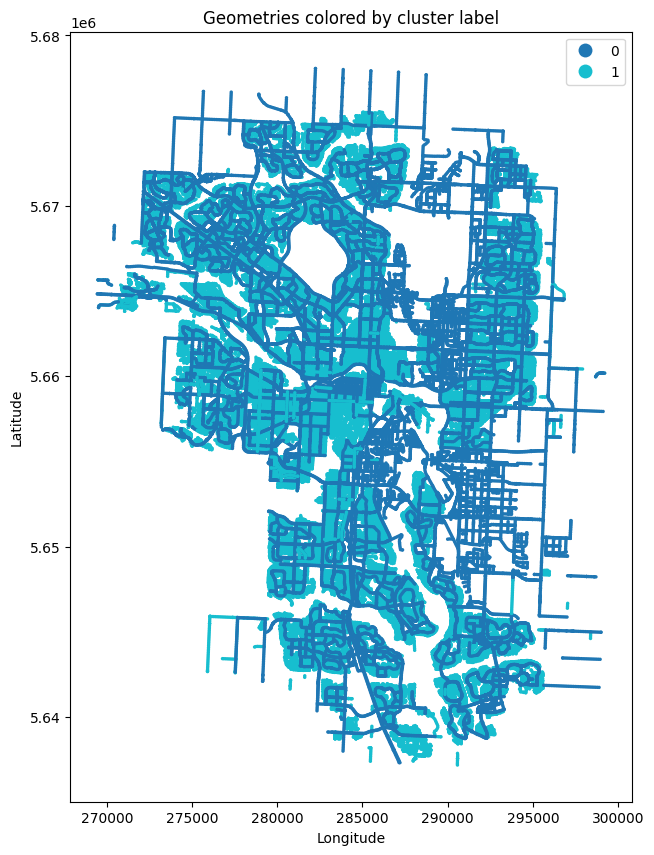


n_clusters 3



C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni


Most common attributes for Cluster:


,Cluster,SPEED_LIMIT_mode,SPEED_LIMIT_mean,SPEED_LIMIT_median
0,0,[50.0],51.194864,50.0
1,1,[40.0],39.978775,40.0
2,2,[70.0],75.778172,70.0


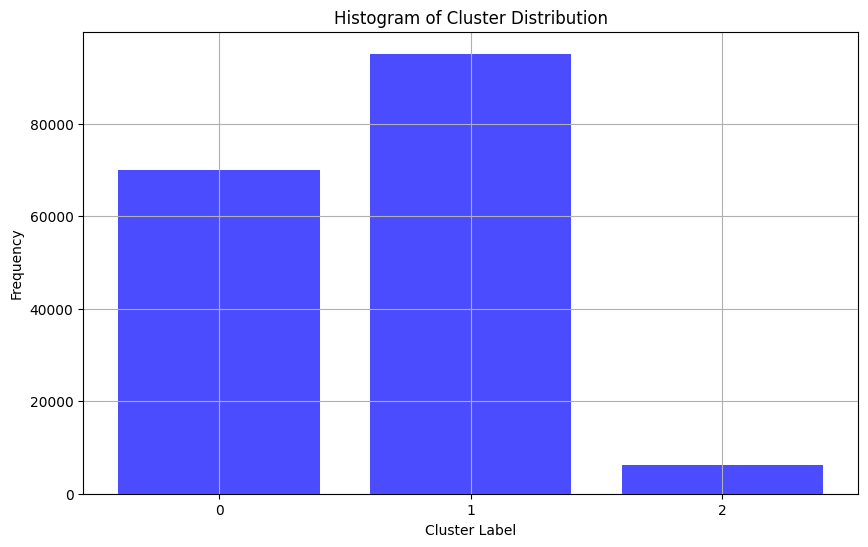

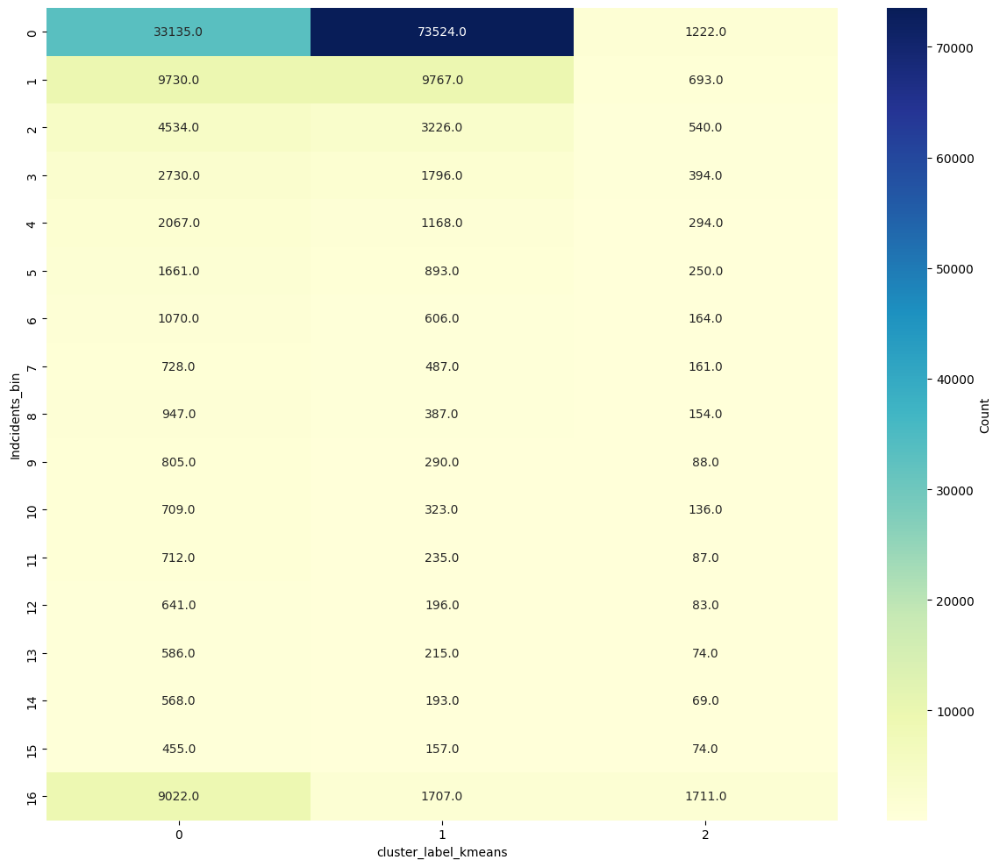

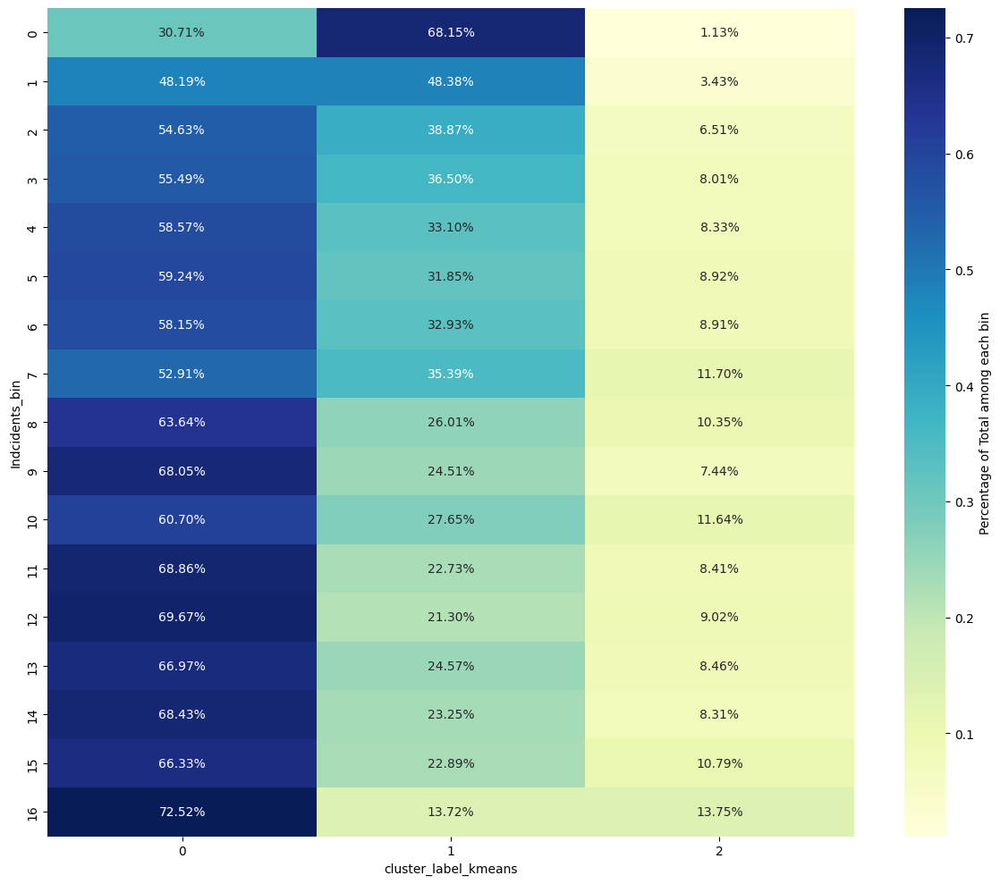

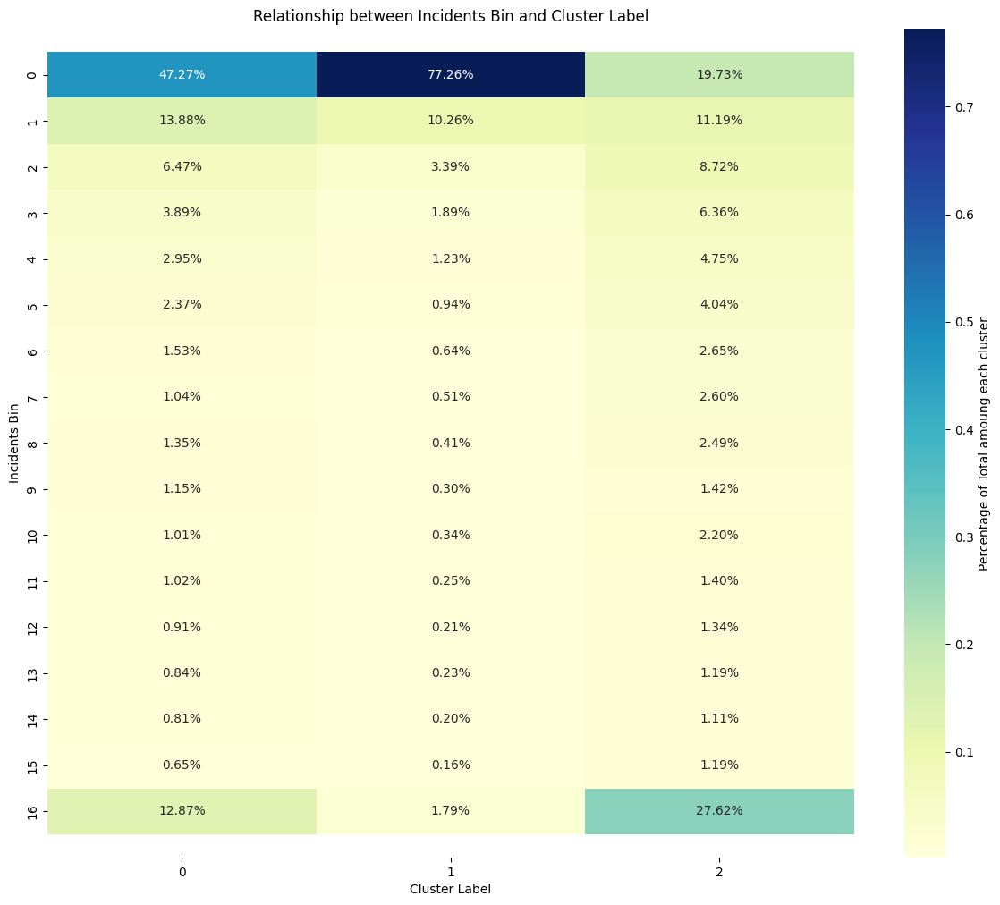

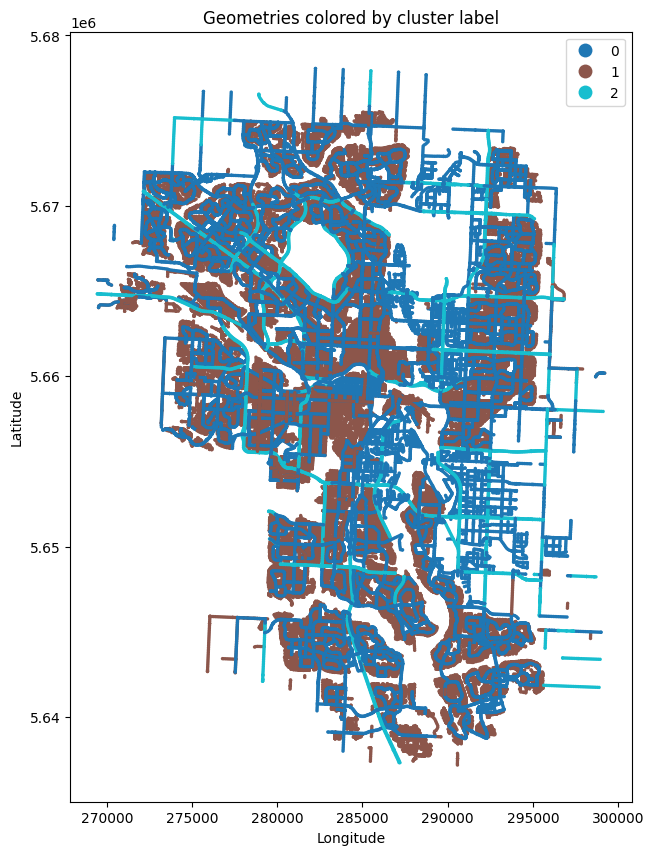


n_clusters 4


Most common attributes for Cluster:


C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni

,Cluster,SPEED_LIMIT_mode,SPEED_LIMIT_mean,SPEED_LIMIT_median
0,0,[70.0],75.778172,70.0
1,1,[40.0],39.978775,40.0
2,2,[50.0],50.000000,50.0
3,3,[60.0],60.000000,60.0


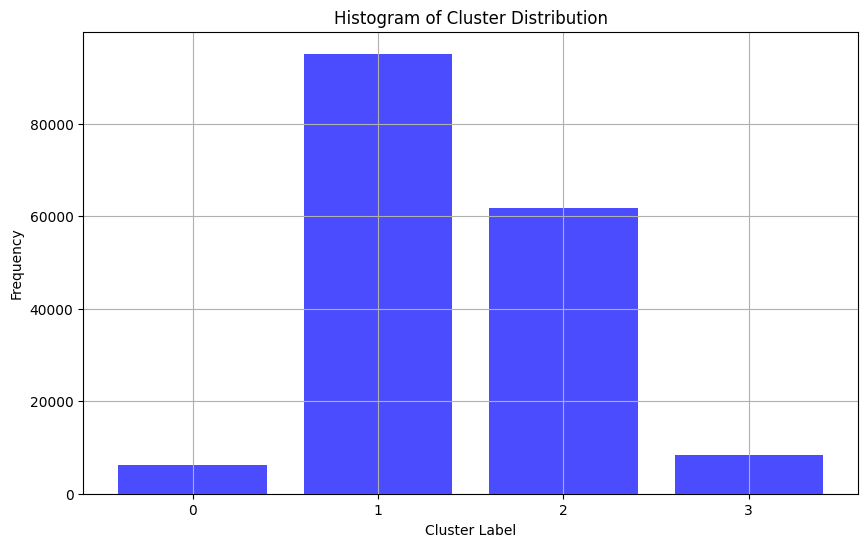

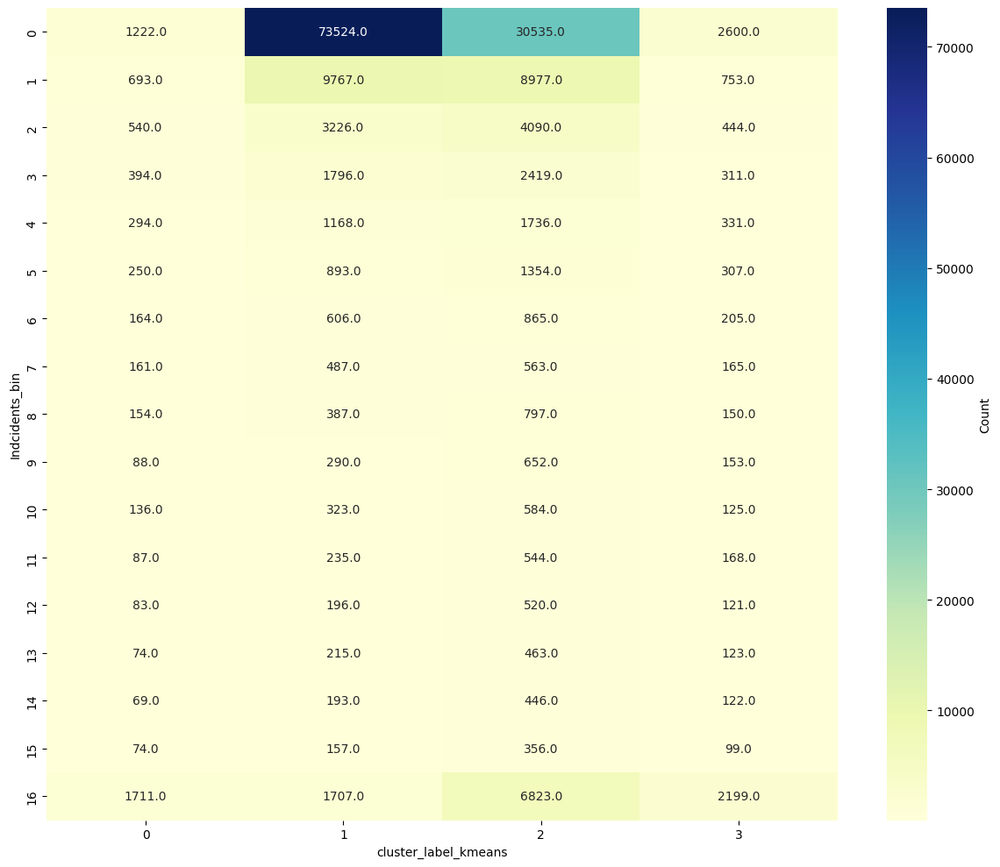

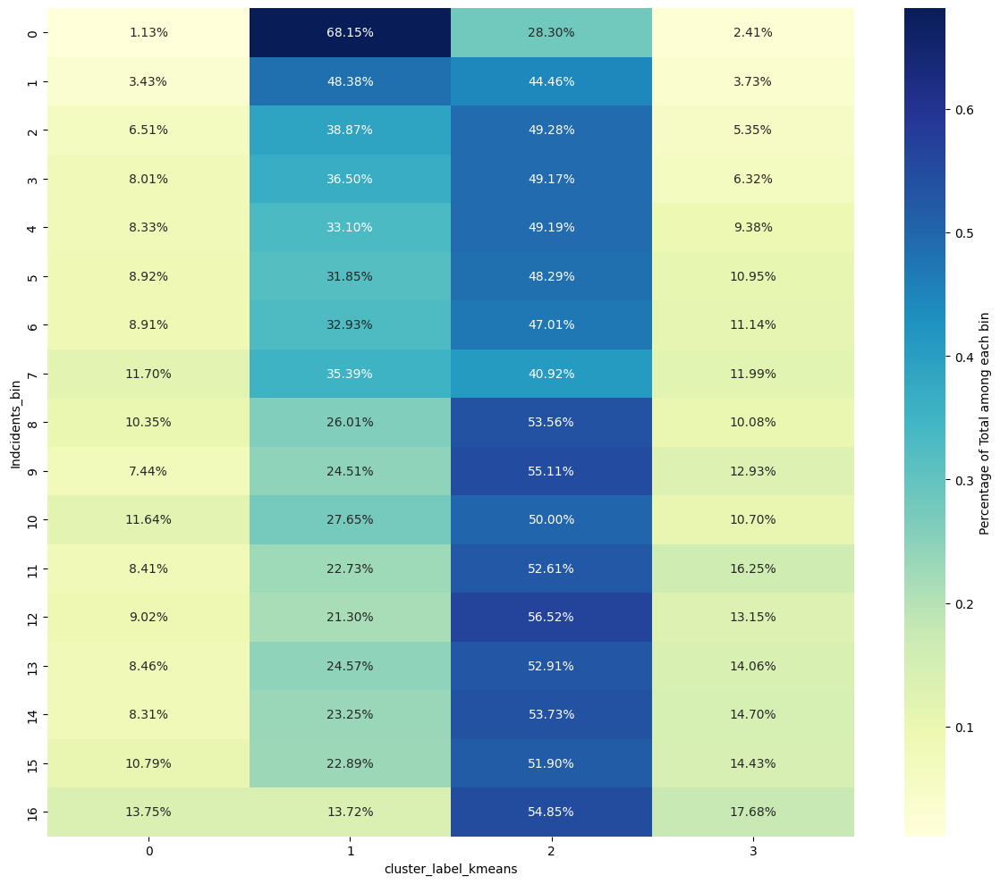

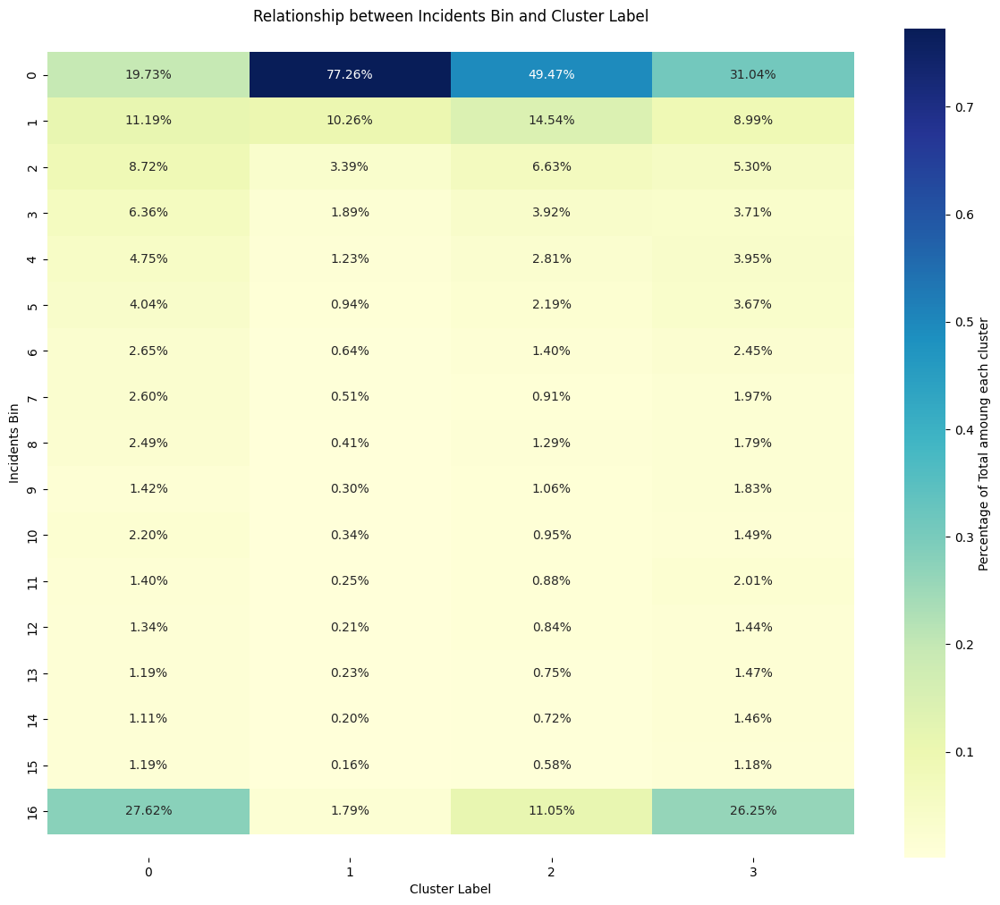

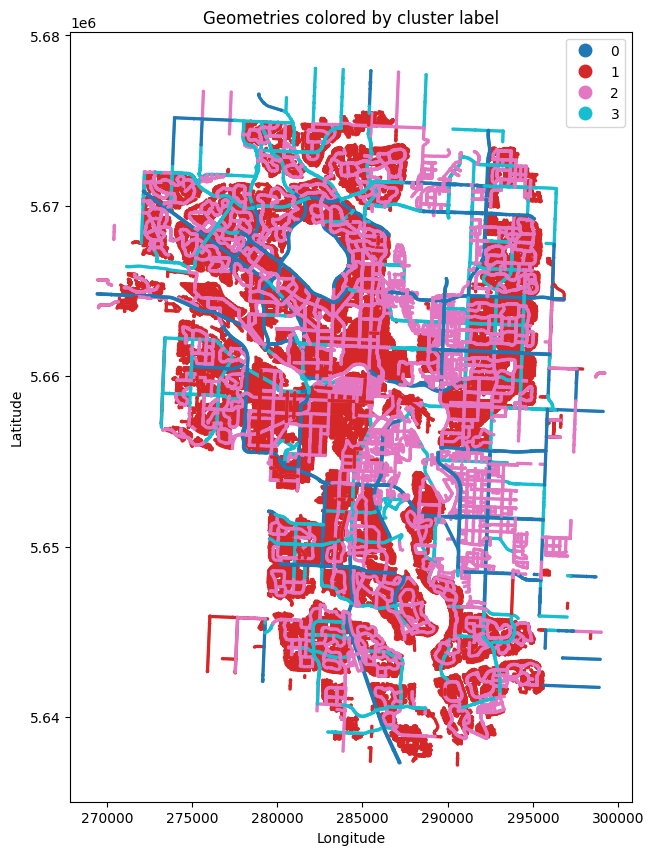


n_clusters 5


Most common attributes for Cluster:


C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni

,Cluster,SPEED_LIMIT_mode,SPEED_LIMIT_mean,SPEED_LIMIT_median,SIGN_TYPE_Flat_Sheet_mode,SIGN_TYPE_Flat_Sheet_mean,SIGN_TYPE_Flat_Sheet_median,Size_Category_Medium_mode,Size_Category_Medium_mean,Size_Category_Medium_median
0,0,[50.0],50.000000,50.0,0,0.000000,0.0,0,0.000000,0.0
1,1,[40.0],39.978769,40.0,0,0.000000,0.0,0,0.000000,0.0
2,2,[70.0],75.778172,70.0,0,0.000000,0.0,0,0.000000,0.0
3,3,[60.0],60.000000,60.0,0,0.000000,0.0,0,0.000000,0.0
4,4,[50.0],49.979077,50.0,[4],4.474462,4.0,[2],2.897231,3.0


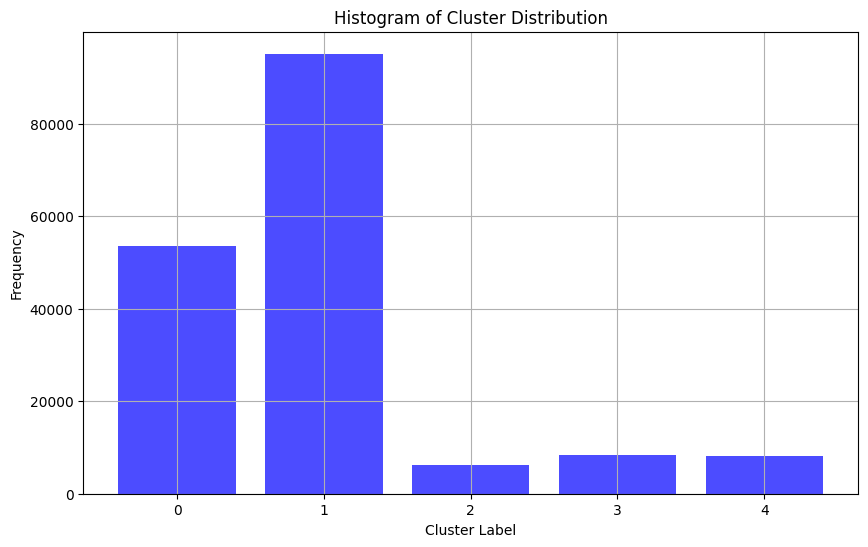

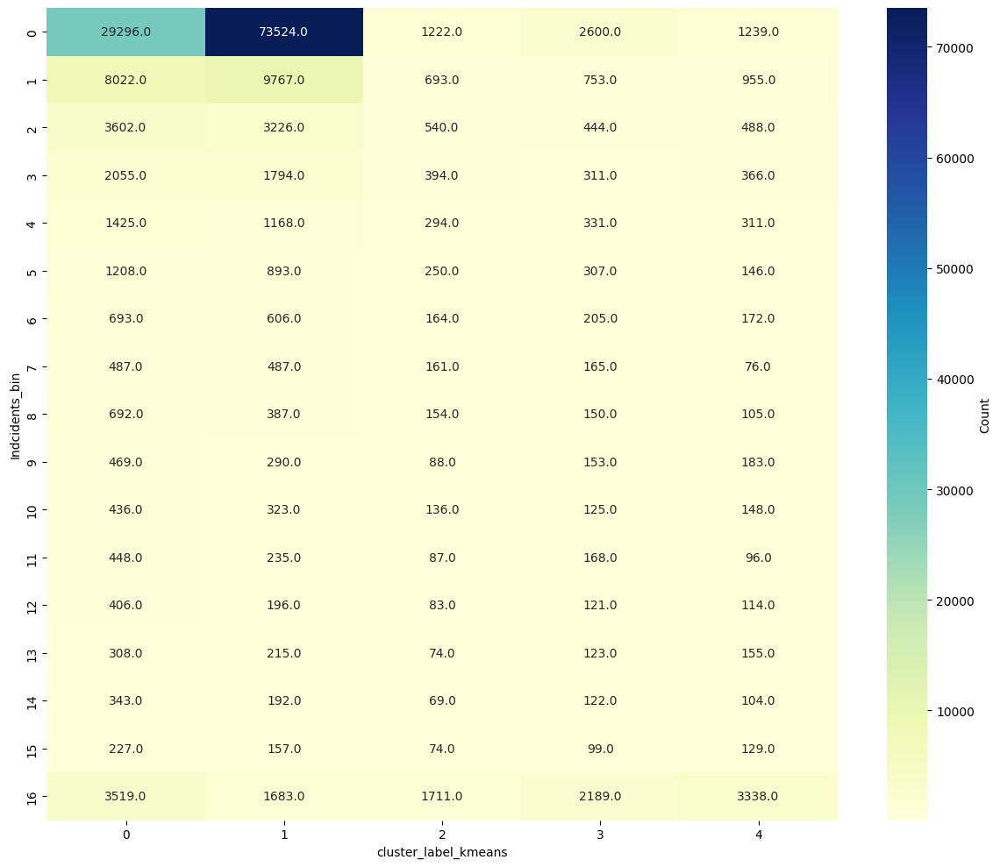

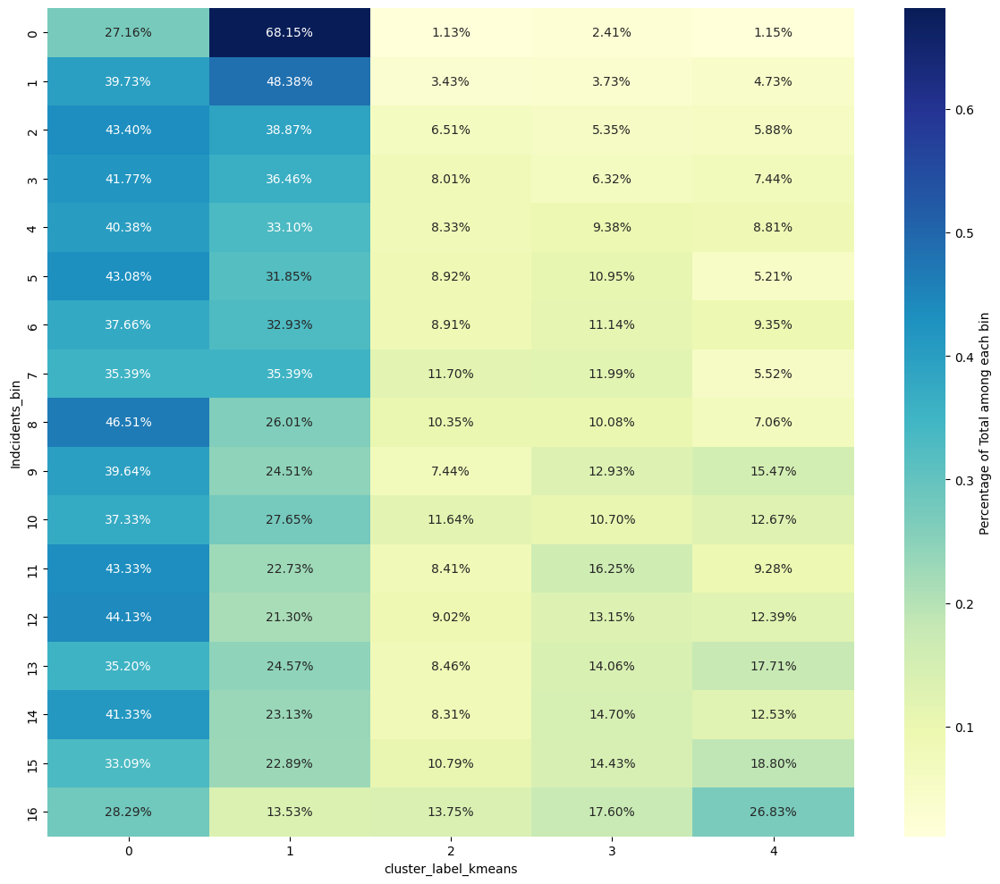

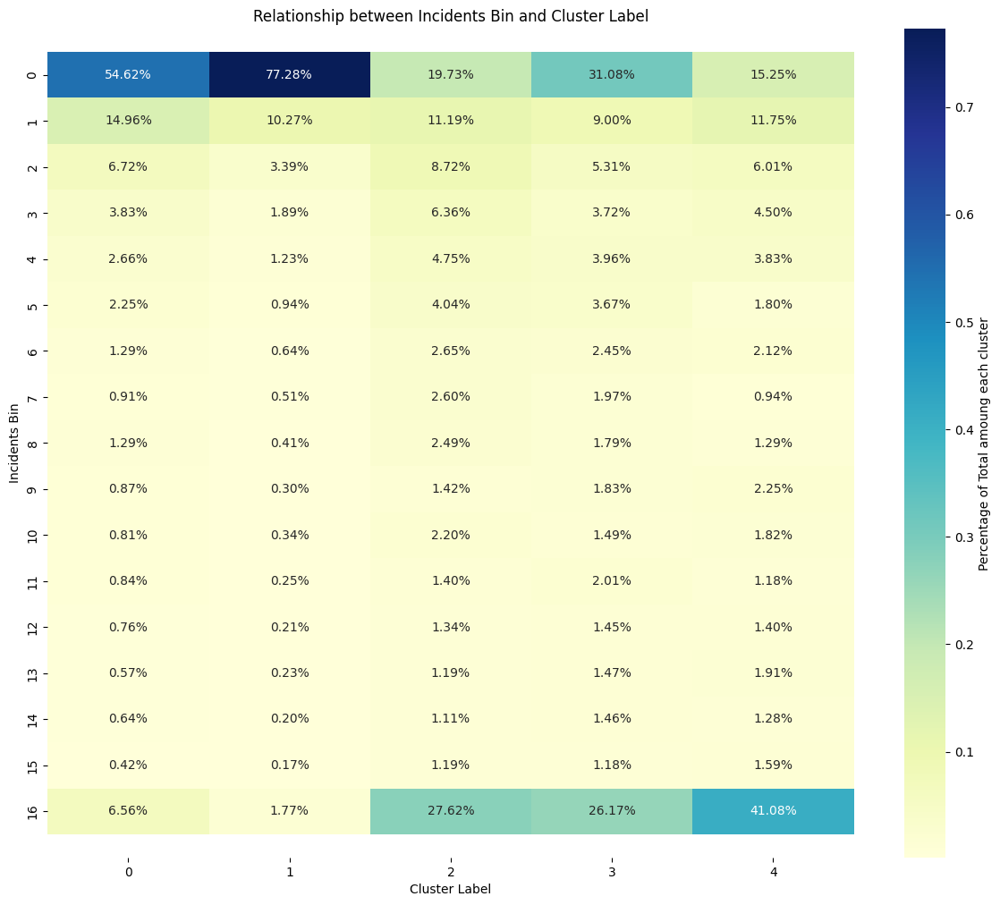

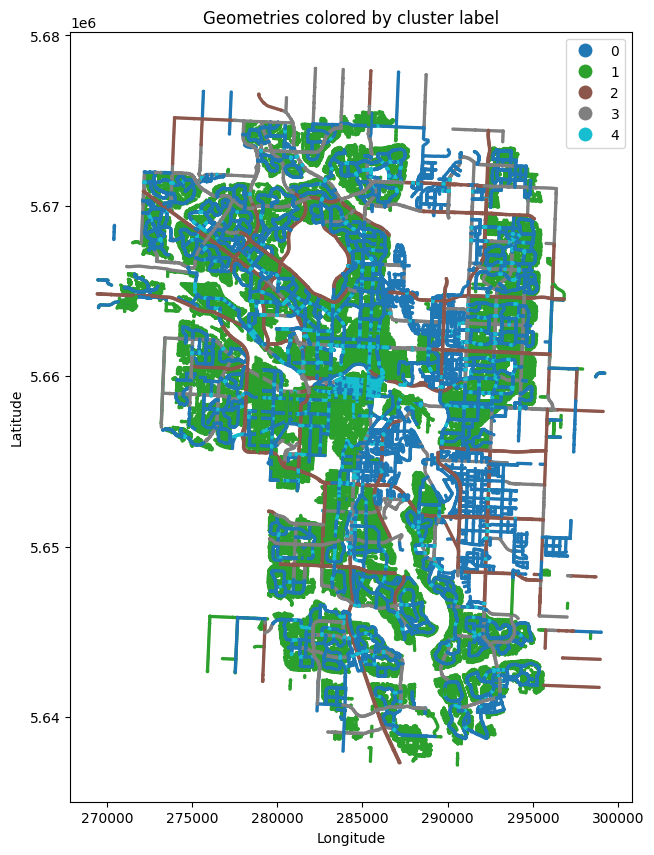


n_clusters 6


Most common attributes for Cluster:


C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni

,Cluster,SPEED_LIMIT_mode,SPEED_LIMIT_mean,SPEED_LIMIT_median,SIGN_TYPE_Flat_Sheet_mode,SIGN_TYPE_Flat_Sheet_mean,SIGN_TYPE_Flat_Sheet_median,Size_Category_Medium_mode,Size_Category_Medium_mean,Size_Category_Medium_median
0,0,[50.0],50.000000,50.0,0,0.000000,0.0,0,0.000000,0.0
1,1,[40.0],39.978769,40.0,0,0.000000,0.0,0,0.000000,0.0
2,2,[80.0],81.620130,80.0,0,0.000000,0.0,0,0.000000,0.0
3,3,[60.0],60.000000,60.0,0,0.000000,0.0,0,0.000000,0.0
4,4,[70.0],70.000000,70.0,0,0.000000,0.0,0,0.000000,0.0
5,5,[50.0],49.979077,50.0,[4],4.474462,4.0,[2],2.897231,3.0


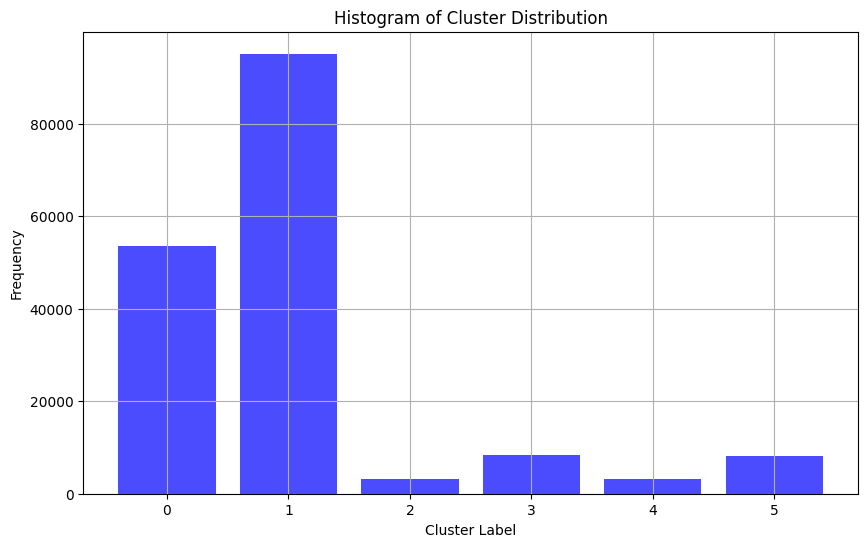

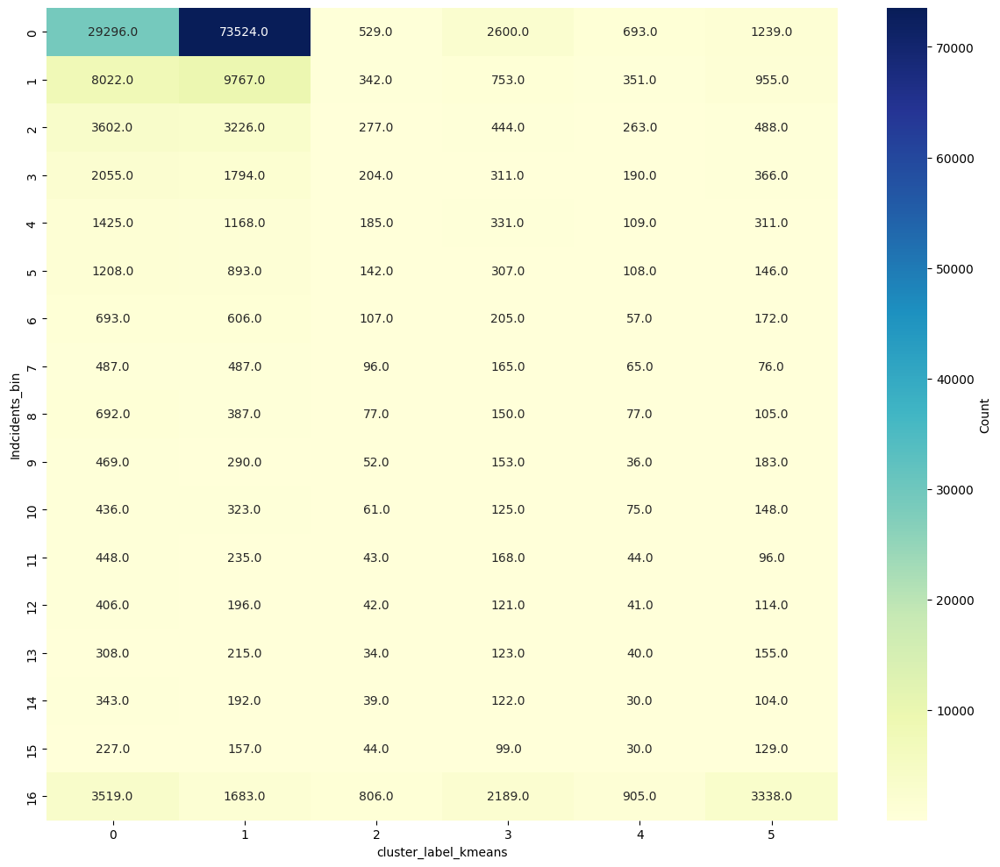

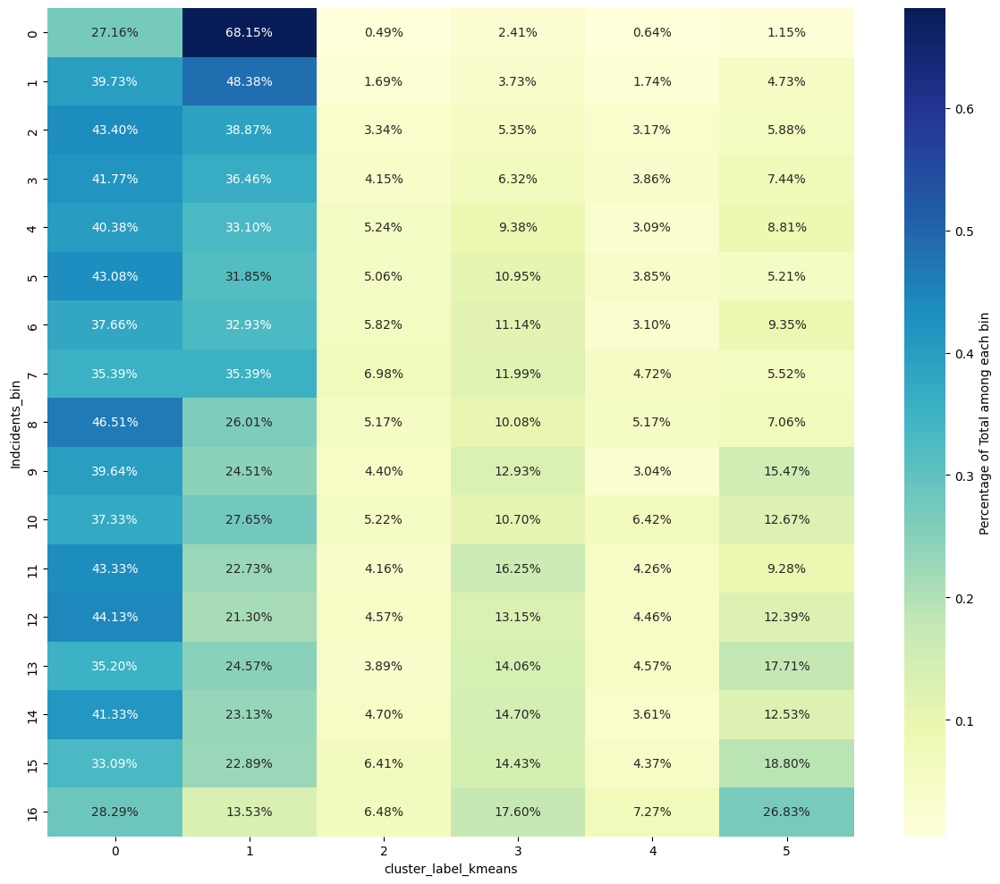

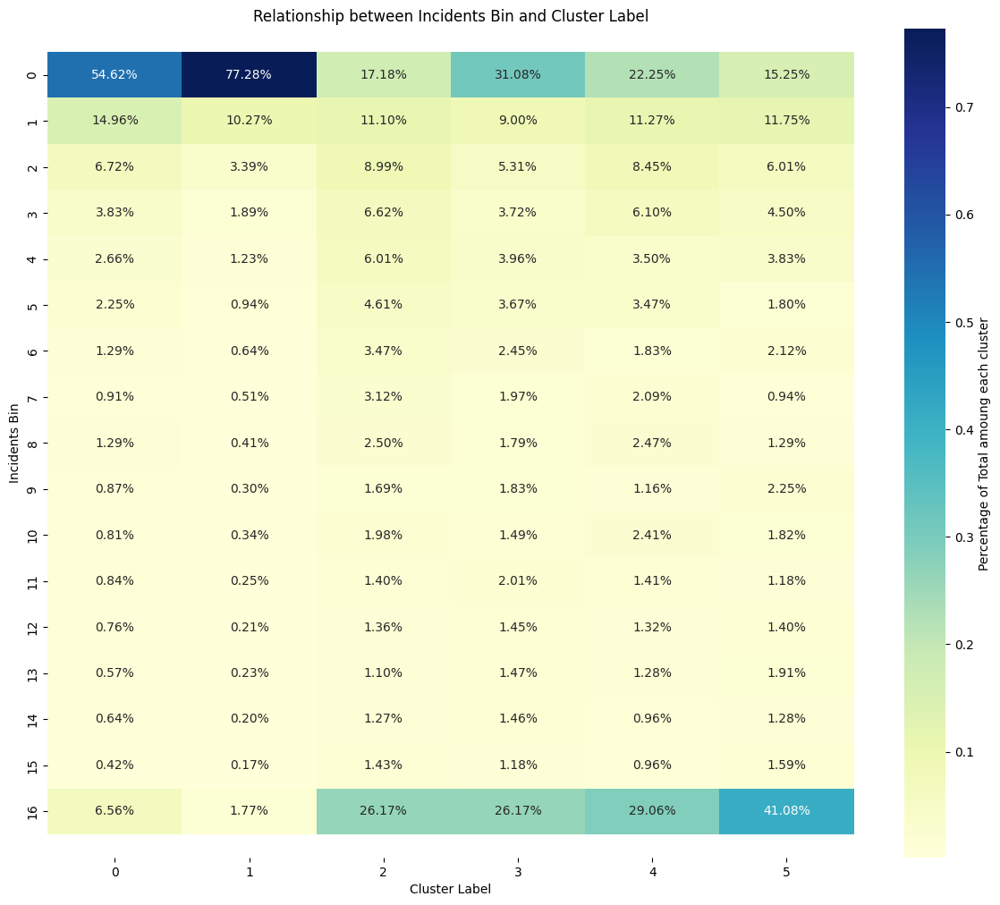

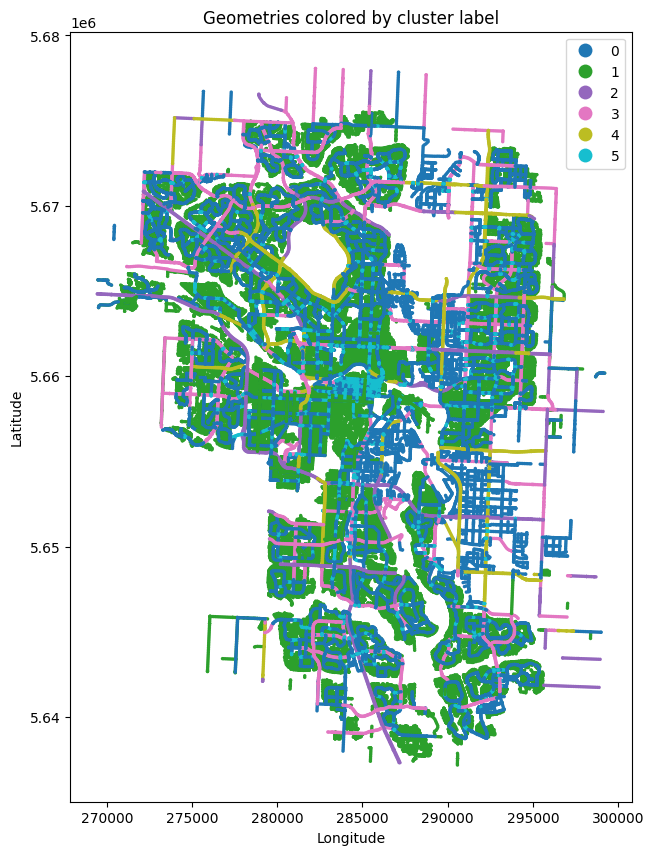


n_clusters 7


Most common attributes for Cluster:


C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni

,Cluster,SPEED_LIMIT_mode,SPEED_LIMIT_mean,SPEED_LIMIT_median,SIGN_TYPE_Flat_Sheet_mode,SIGN_TYPE_Flat_Sheet_mean,SIGN_TYPE_Flat_Sheet_median,Size_Category_Medium_mode,Size_Category_Medium_mean,Size_Category_Medium_median
0,0,[50.0],50.000000,50.0,0,0.000000,0.0,0,0.000000,0.0
1,1,[40.0],39.980627,40.0,0,0.000000,0.0,0,0.000000,0.0
2,2,[80.0],81.620130,80.0,0,0.000000,0.0,0,0.000000,0.0
3,3,[60.0],60.000000,60.0,0,0.000000,0.0,0,0.000000,0.0
4,4,[70.0],70.000000,70.0,0,0.000000,0.0,0,0.000000,0.0
5,5,[50.0],50.012349,50.0,[4],4.450976,4.0,[2],2.891455,3.0
6,6,[40.0],39.939815,40.0,[2],3.483102,3.0,[2],2.668981,2.0


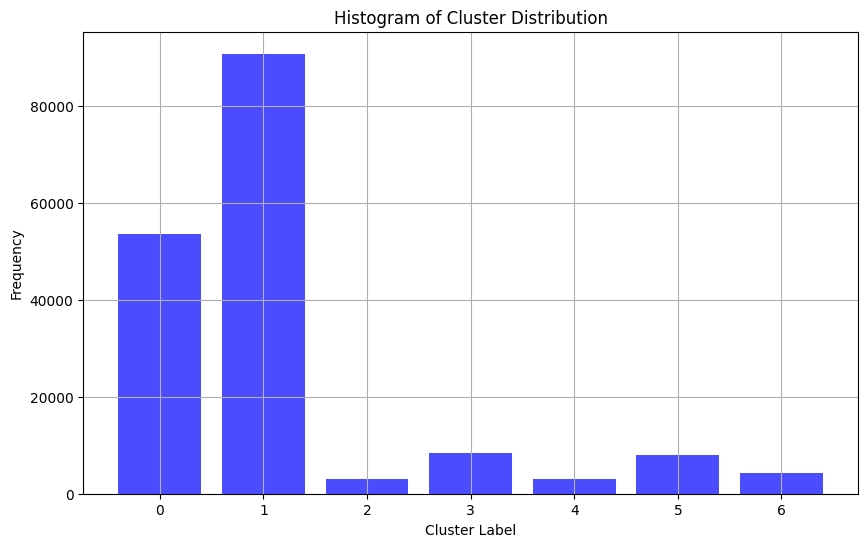

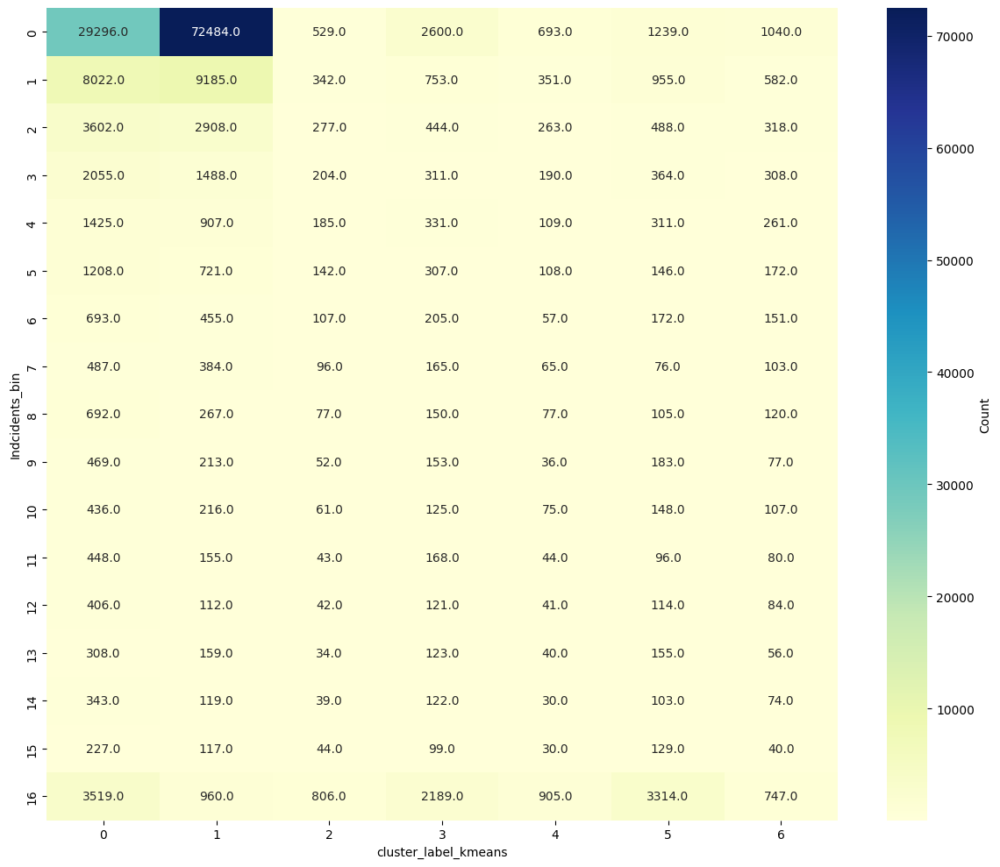

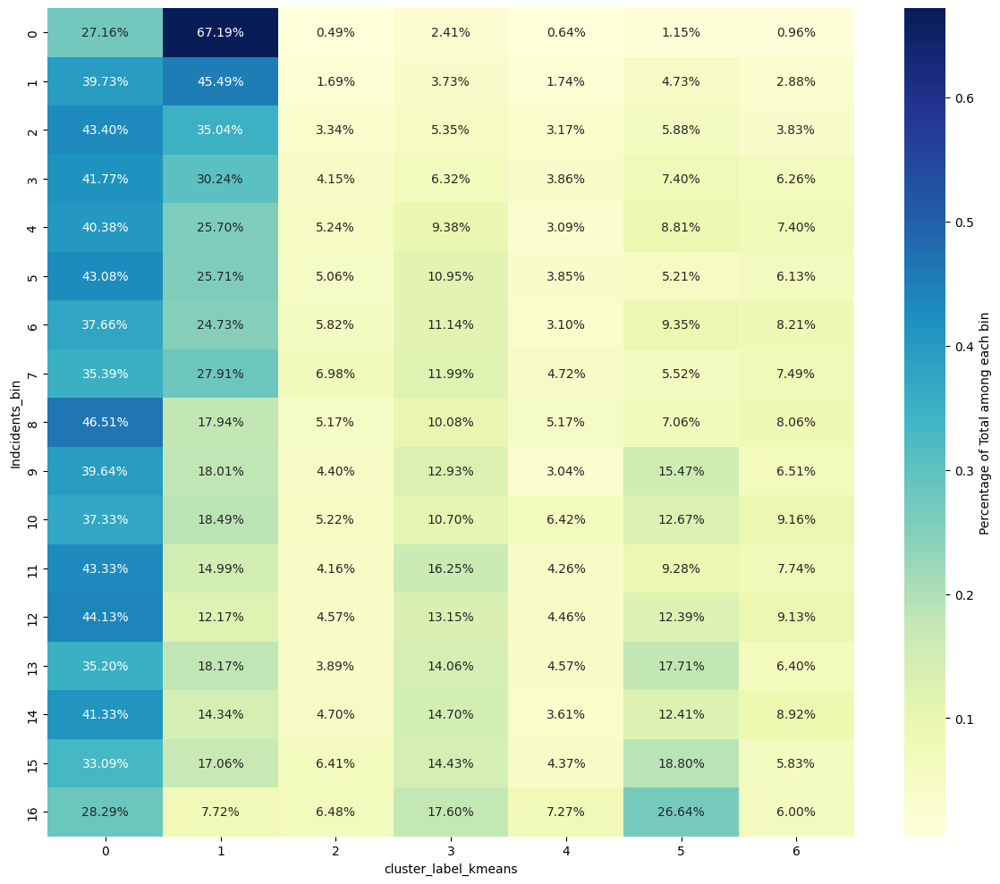

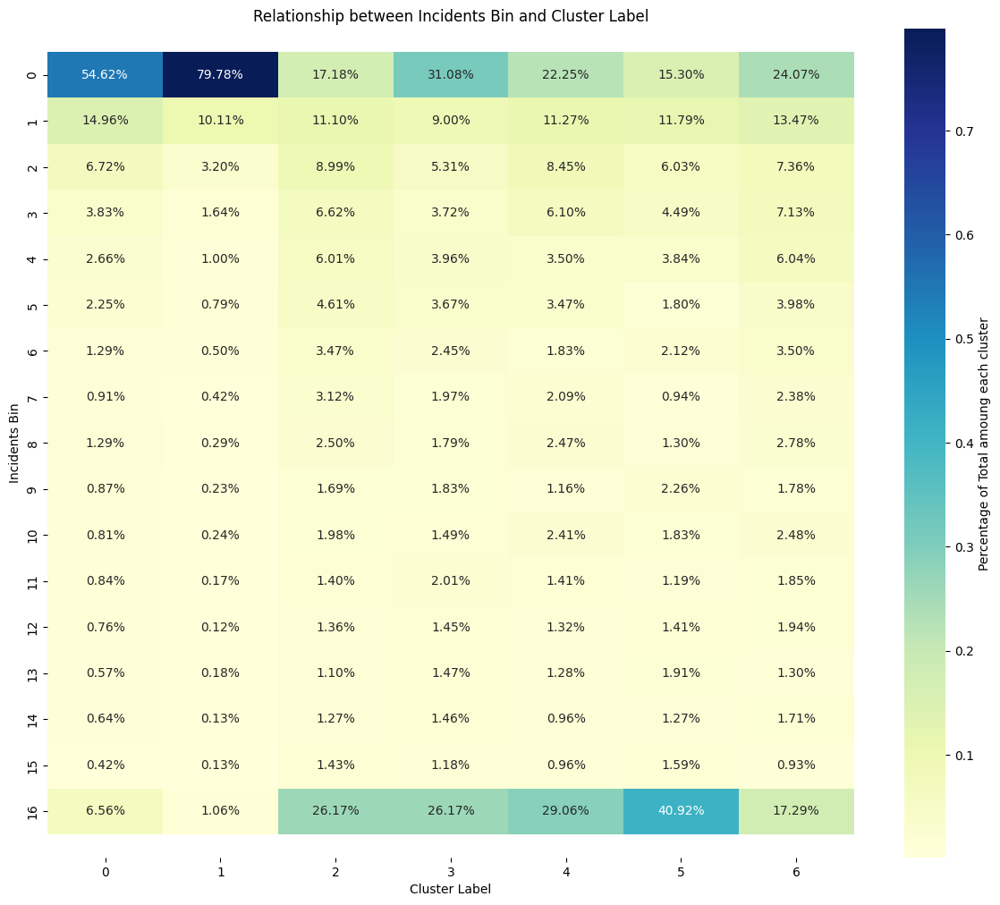

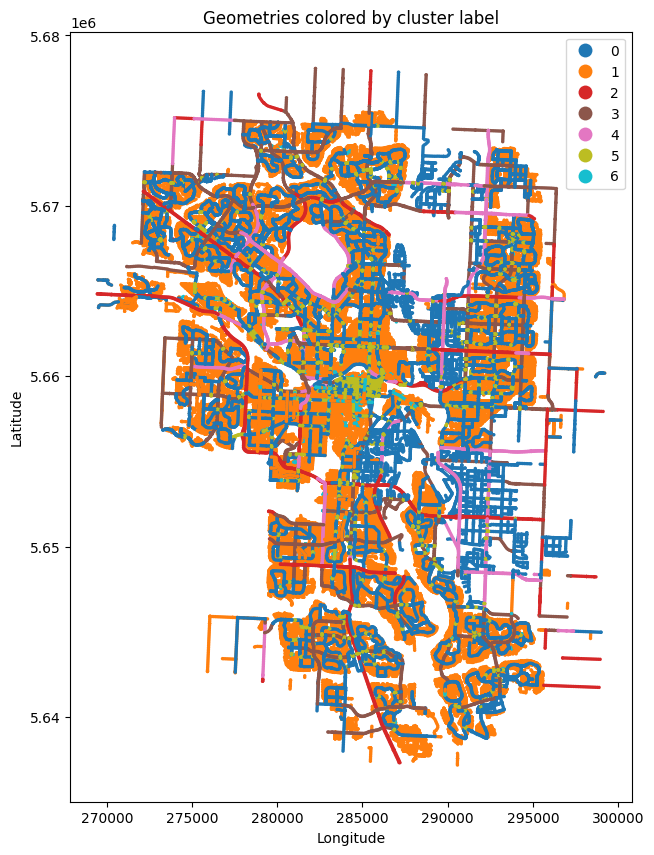


n_clusters 8



C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni


Most common attributes for Cluster:


,Cluster,SPEED_LIMIT_mode,SPEED_LIMIT_mean,SPEED_LIMIT_median,SIGN_TYPE_Flat_Sheet_mode,SIGN_TYPE_Flat_Sheet_mean,SIGN_TYPE_Flat_Sheet_median,Size_Category_Medium_mode,Size_Category_Medium_mean,Size_Category_Medium_median
0,0,[40.0],39.980627,40.0,0,0.000000,0.0,0,0.000000,0.0
1,1,[50.0],50.000000,50.0,0,0.000000,0.0,0,0.000000,0.0
2,2,[110.0],108.235294,110.0,0,0.000000,0.0,0,0.000000,0.0
3,3,[70.0],70.000000,70.0,0,0.000000,0.0,0,0.000000,0.0
4,4,[60.0],60.000000,60.0,0,0.000000,0.0,0,0.000000,0.0
5,5,[80.0],80.708529,80.0,0,0.000000,0.0,0,0.000000,0.0
6,6,[50.0],50.012349,50.0,[4],4.450976,4.0,[2],2.891455,3.0
7,7,[40.0],39.939815,40.0,[2],3.483102,3.0,[2],2.668981,2.0


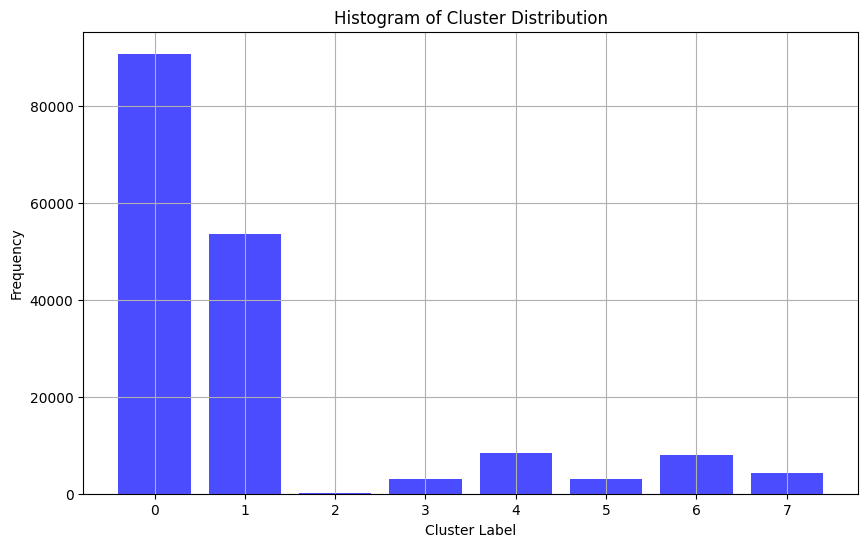

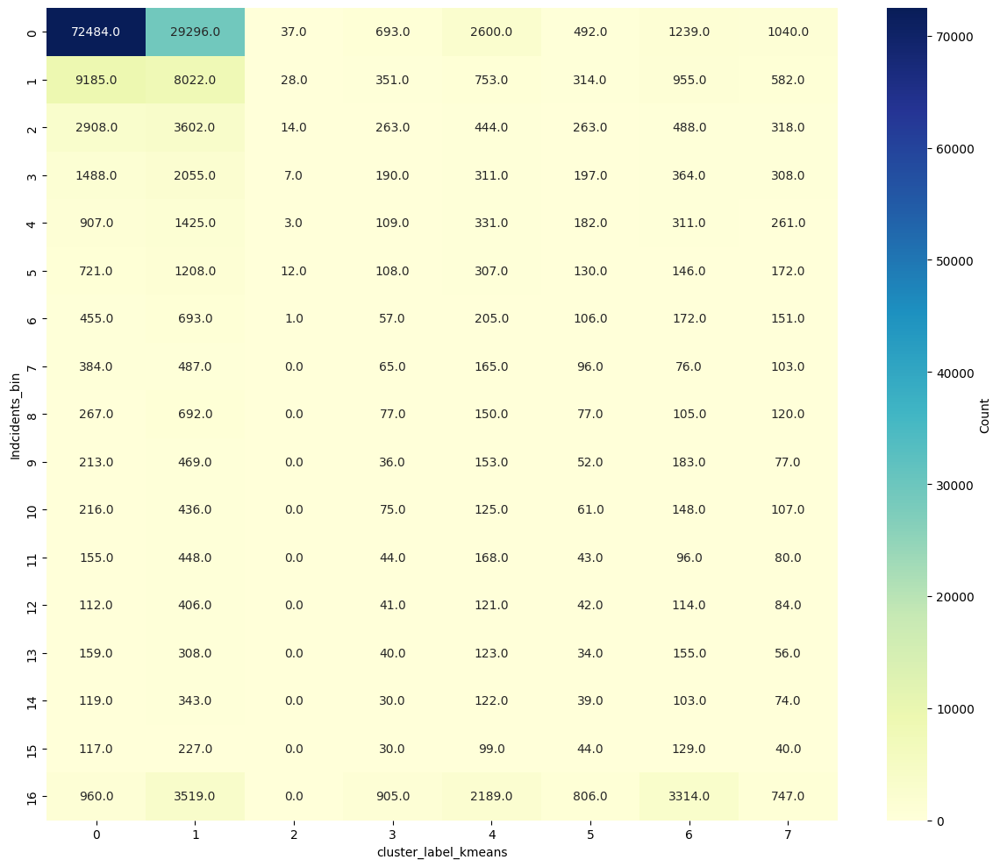

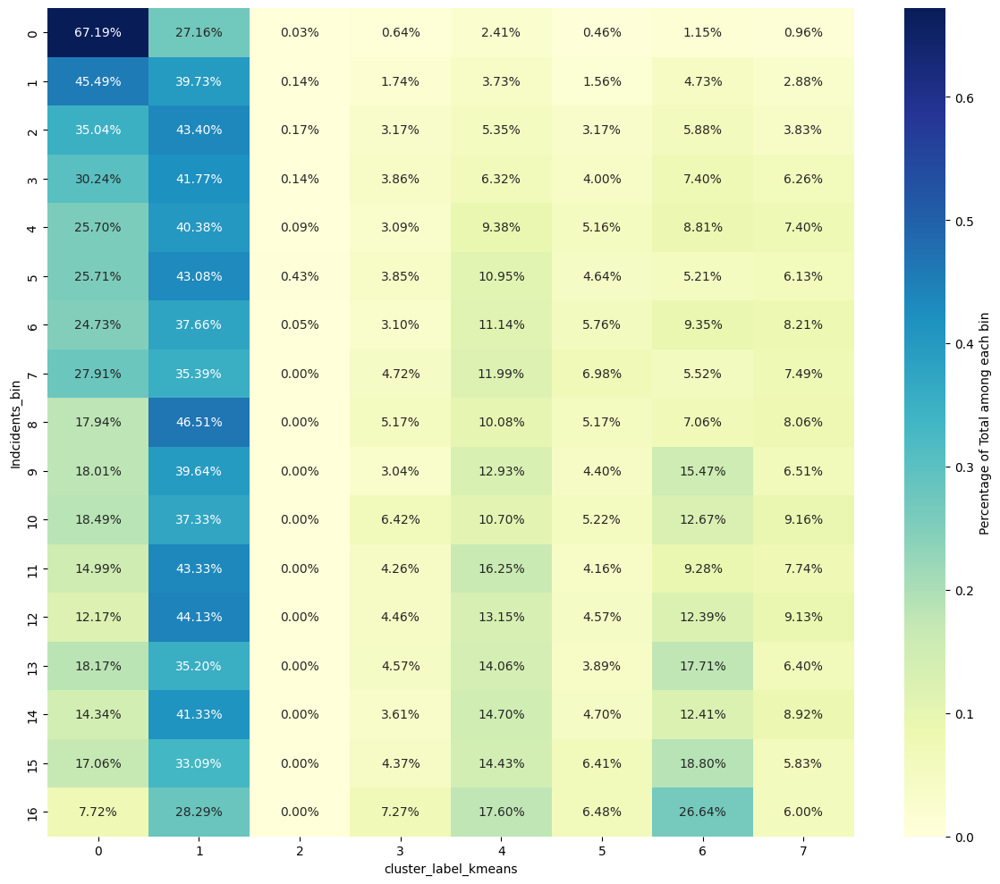

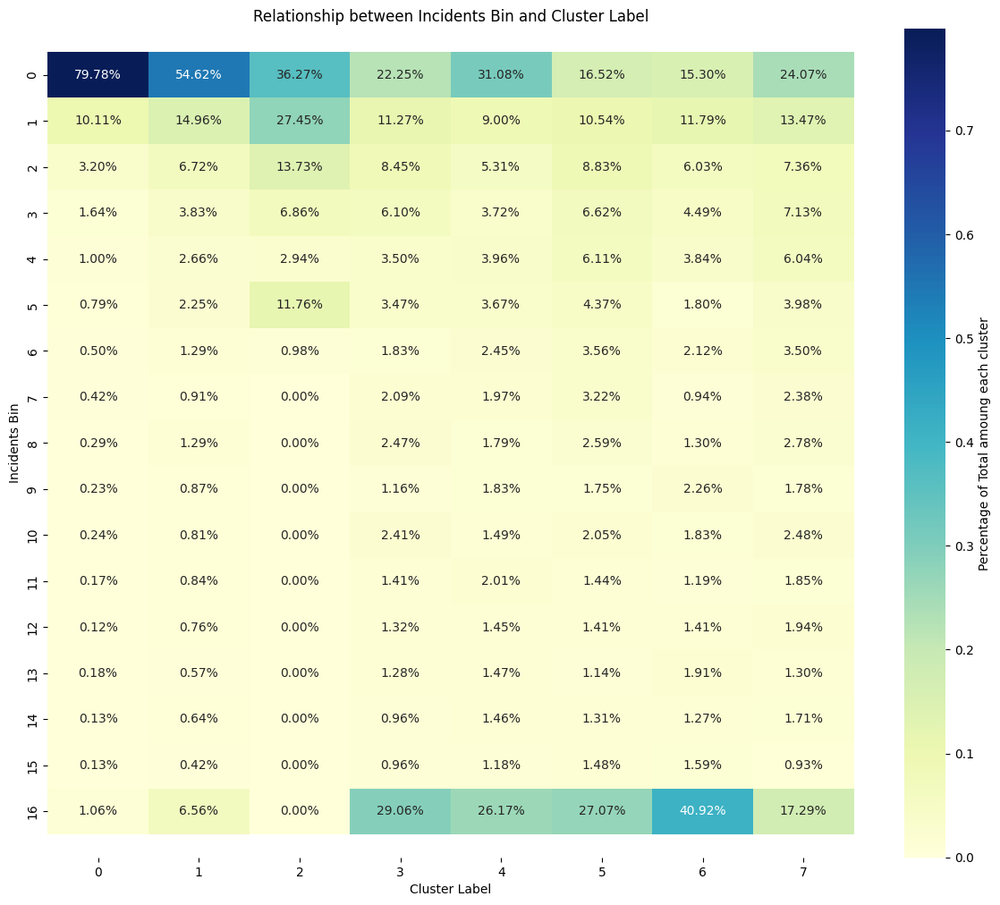

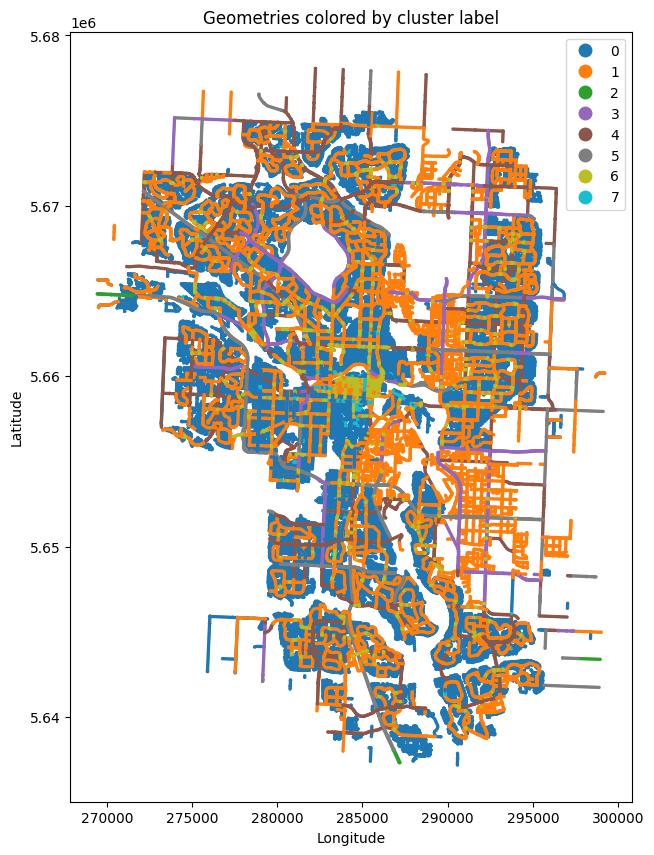


n_clusters 9



C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni


Most common attributes for Cluster:


,Cluster,SPEED_LIMIT_mode,SPEED_LIMIT_mean,SPEED_LIMIT_median,SIGN_TYPE_Flat_Sheet_mode,SIGN_TYPE_Flat_Sheet_mean,SIGN_TYPE_Flat_Sheet_median,Size_Category_Medium_mode,Size_Category_Medium_mean,Size_Category_Medium_median,CROSSWALK_TYPE_SIGNALIZED_mode,CROSSWALK_TYPE_SIGNALIZED_mean,CROSSWALK_TYPE_SIGNALIZED_median
0,0,[50.0],50.000000,50.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
1,1,[40.0],39.980627,40.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
2,2,[80.0],80.708529,80.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
3,3,[60.0],60.000000,60.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
4,4,[50.0],50.000000,50.0,[4],4.439169,4.0,[2],2.890084,3.0,0,0.000000,0.0
5,5,[70.0],70.000000,70.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
6,6,[110.0],108.235294,110.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
7,7,[40.0],39.939815,40.0,[2],3.483102,3.0,[2],2.668981,2.0,0,0.000000,0.0
8,8,[60.0],60.028818,60.0,[4],5.062824,4.0,[2],2.733141,2.0,[1],0.836311,1.0


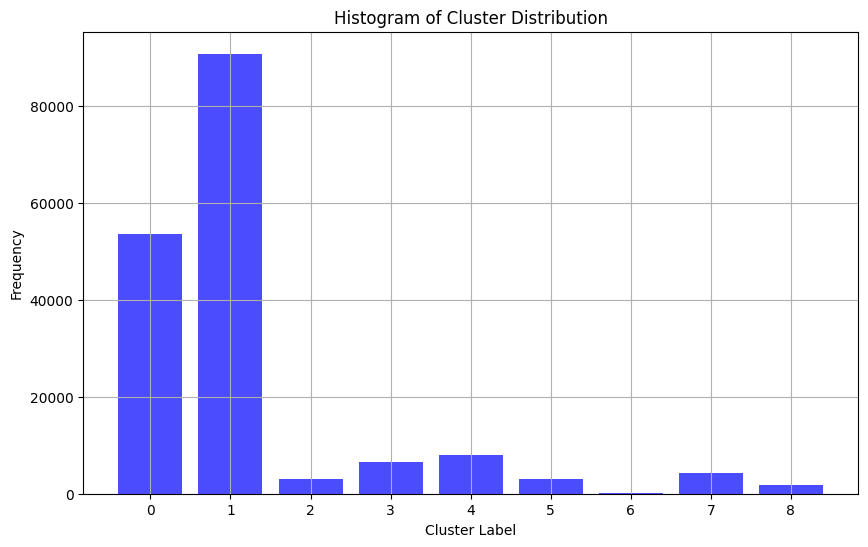

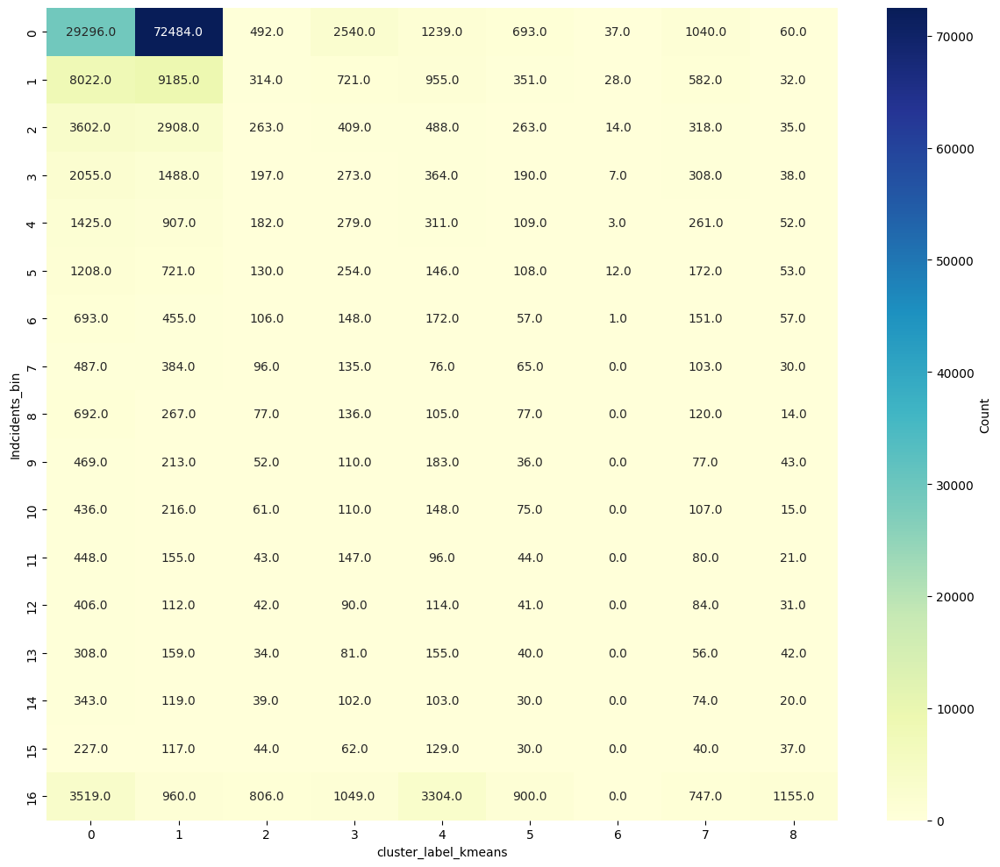

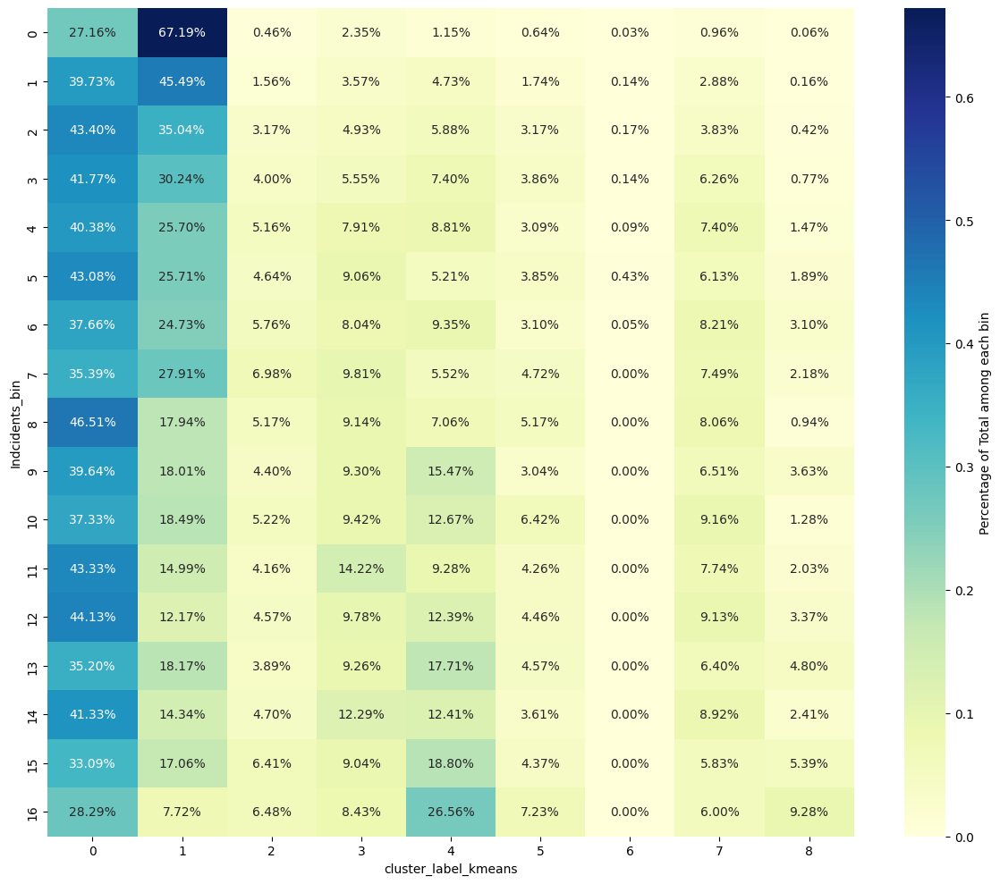

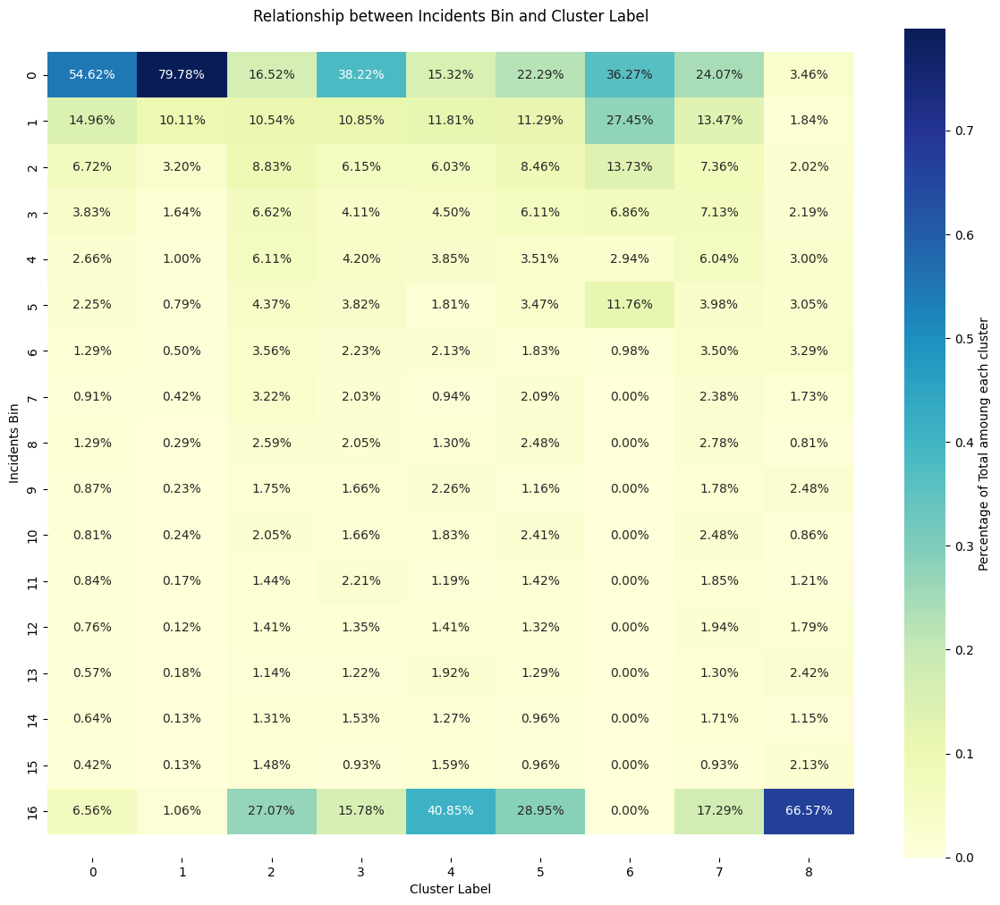

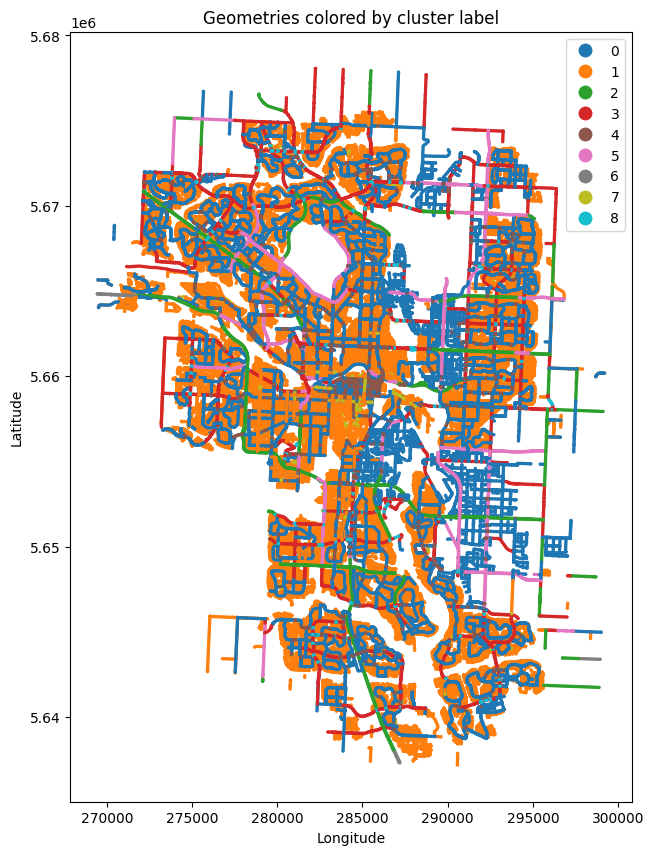


n_clusters 10



C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni


Most common attributes for Cluster:


C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni

,Cluster,SPEED_LIMIT_mode,SPEED_LIMIT_mean,SPEED_LIMIT_median,SIGN_TYPE_Flat_Sheet_mode,SIGN_TYPE_Flat_Sheet_mean,SIGN_TYPE_Flat_Sheet_median,Size_Category_Medium_mode,Size_Category_Medium_mean,Size_Category_Medium_median,CROSSWALK_TYPE_SIGNALIZED_mode,CROSSWALK_TYPE_SIGNALIZED_mean,CROSSWALK_TYPE_SIGNALIZED_median,Size_Category_Large_mode,Size_Category_Large_mean,Size_Category_Large_median
0,0,[50.0],50.000000,50.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
1,1,[40.0],39.980627,40.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
2,2,[70.0],70.000000,70.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
3,3,[60.0],60.000000,60.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
4,4,[110.0],108.235294,110.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
5,5,[80.0],80.708529,80.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
6,6,[60.0],60.028818,60.0,[4],5.062824,4.0,[2],2.733141,2.0,[1],0.836311,1.0,0,0.000000,0.0
7,7,[50.0],50.000000,50.0,[2],3.283602,3.0,[2],2.725214,2.0,0,0.000000,0.0,0,0.000000,0.0
8,8,[50.0],49.944929,50.0,[7],6.770078,7.0,[2],2.705369,2.0,[1],0.918770,1.0,[4],4.284993,4.0
9,9,[40.0],39.939647,40.0,[2],3.456592,3.0,[2],2.668059,2.0,0,0.000000,0.0,0,0.000000,0.0


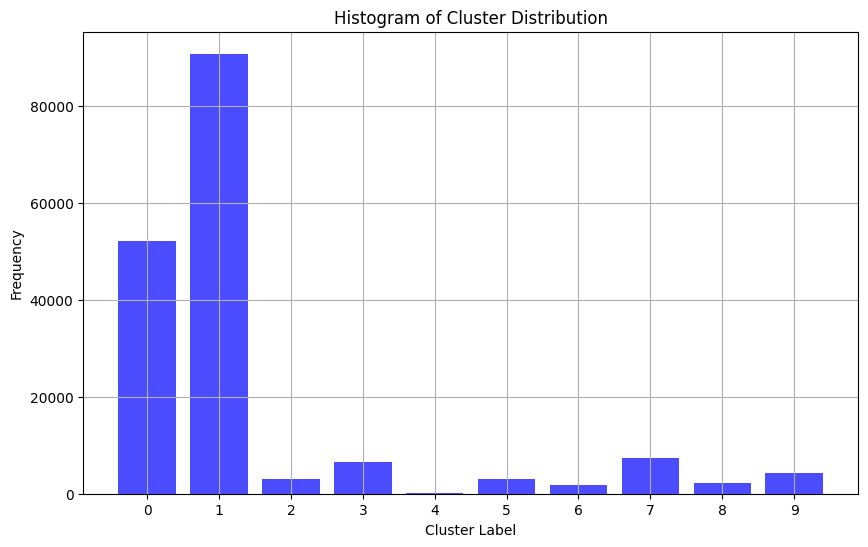

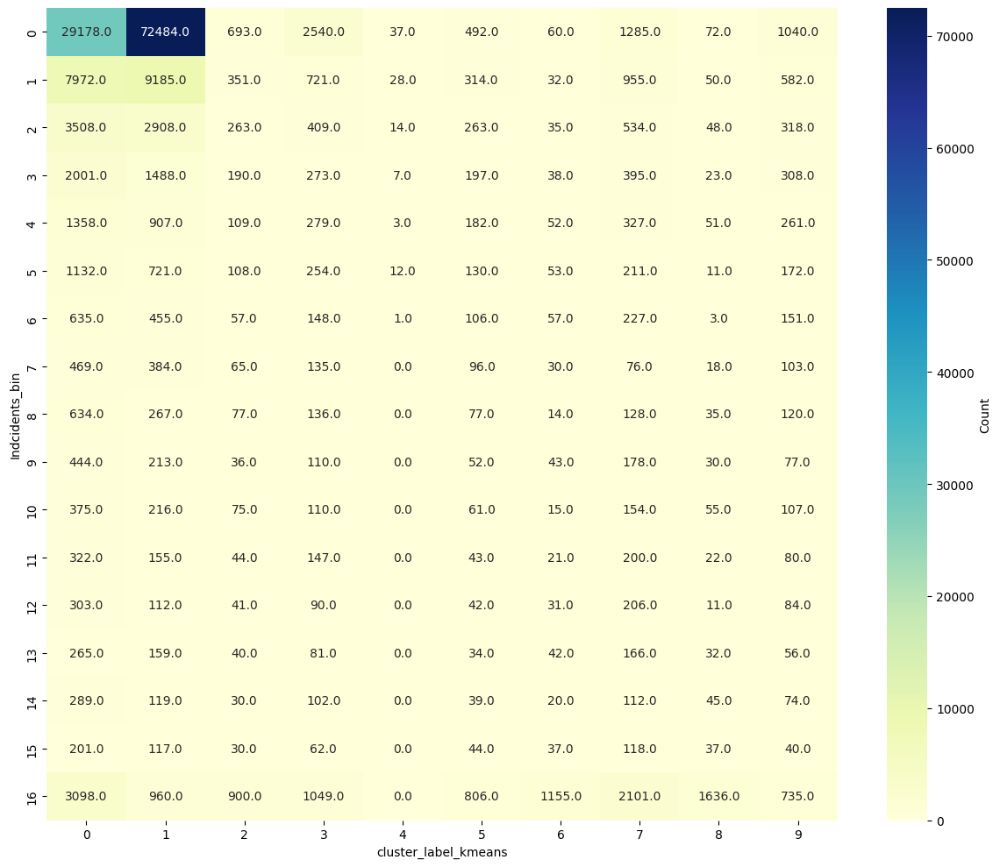

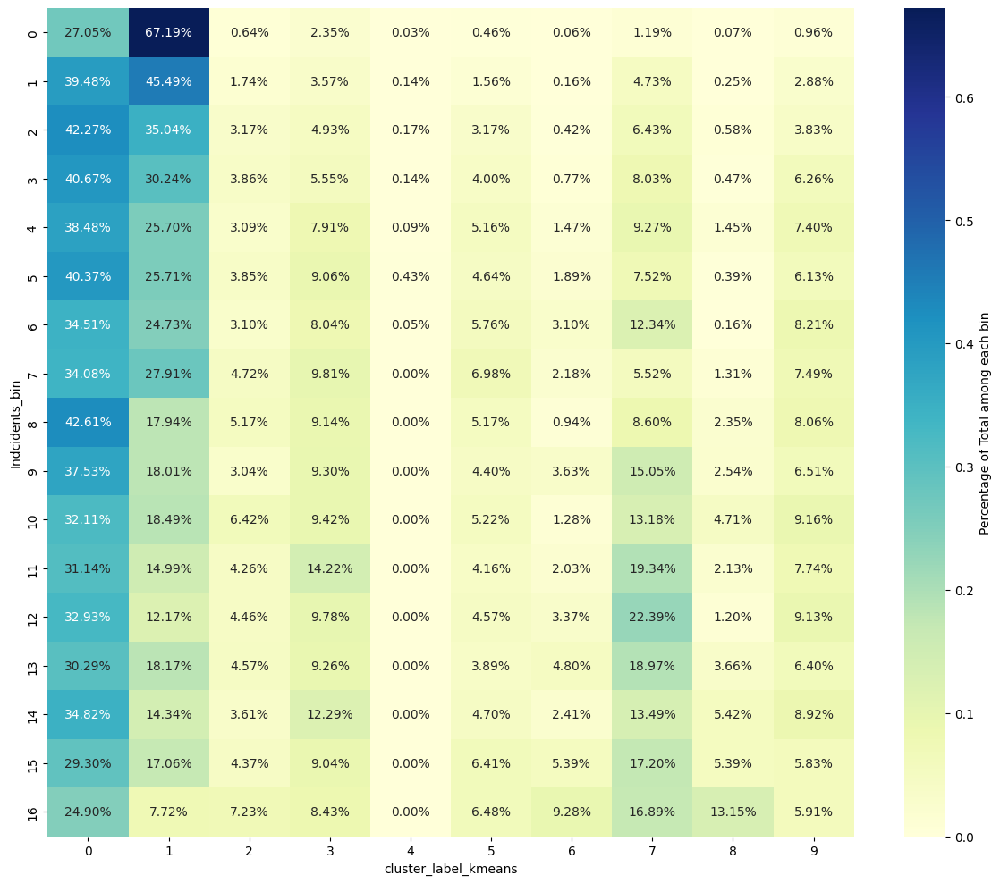

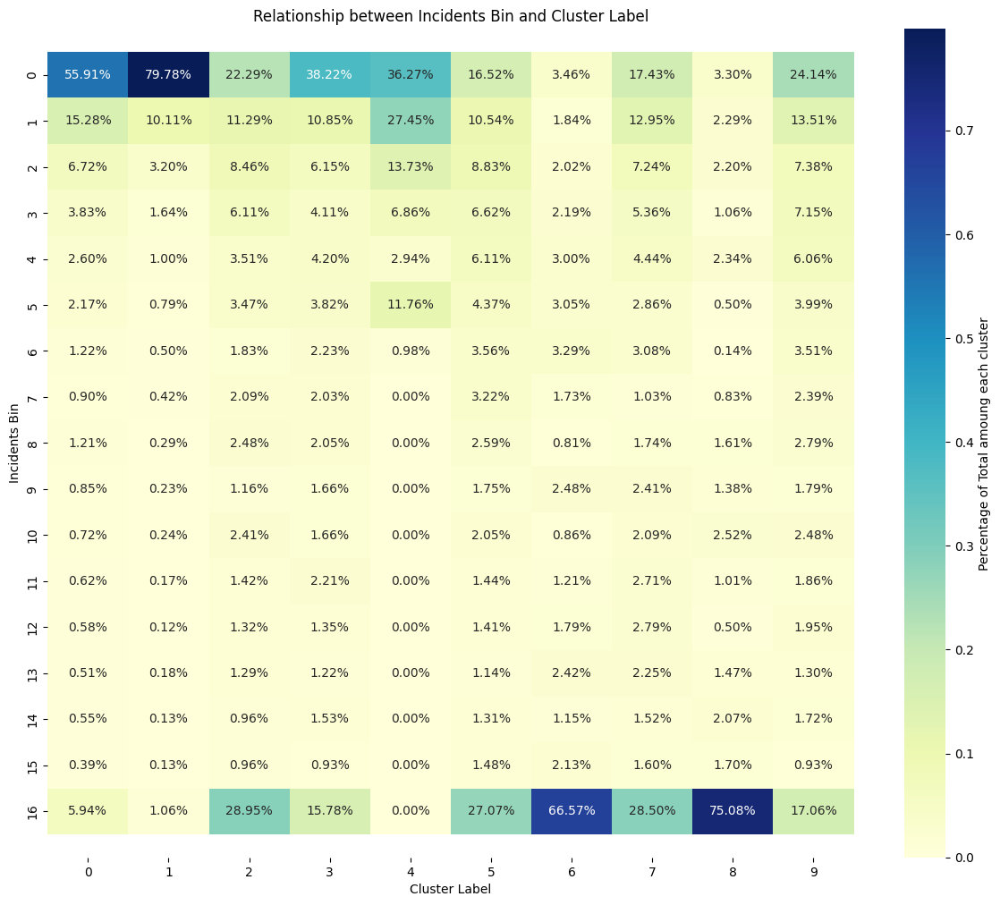

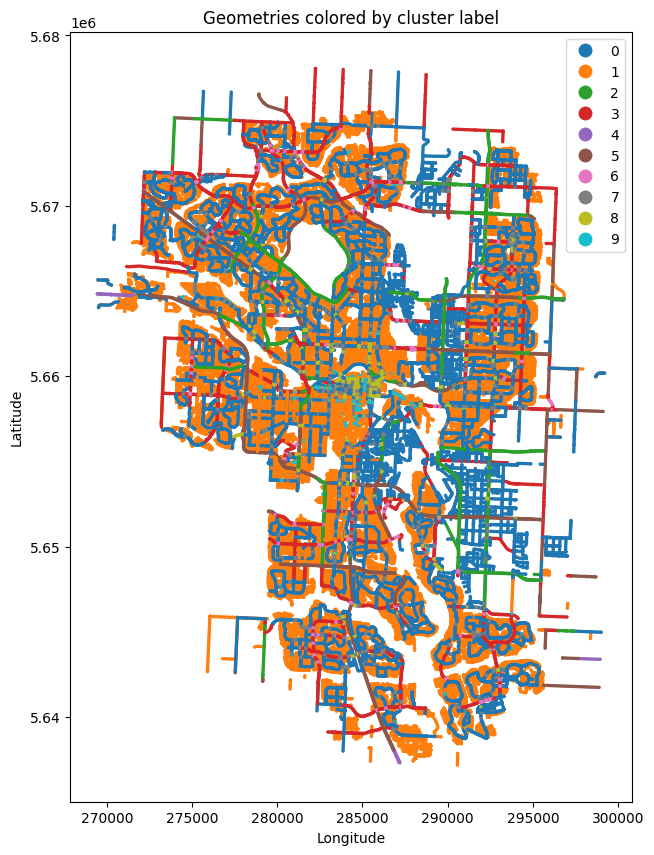


n_clusters 11



C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni


Most common attributes for Cluster:


C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni

,Cluster,SPEED_LIMIT_mode,SPEED_LIMIT_mean,SPEED_LIMIT_median,SIGN_TYPE_Flat_Sheet_mode,SIGN_TYPE_Flat_Sheet_mean,SIGN_TYPE_Flat_Sheet_median,Size_Category_Medium_mode,Size_Category_Medium_mean,Size_Category_Medium_median,CROSSWALK_TYPE_SIGNALIZED_mode,CROSSWALK_TYPE_SIGNALIZED_mean,CROSSWALK_TYPE_SIGNALIZED_median,Size_Category_Large_mode,Size_Category_Large_mean,Size_Category_Large_median
0,0,[50.0],50.000000,50.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
1,1,[40.0],39.980627,40.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
2,2,[80.0],80.708529,80.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
3,3,[60.0],60.000000,60.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
4,4,[50.0],50.000000,50.0,[4],4.615678,4.0,[4],4.340575,4.0,0,0.000000,0.0,0,0.000000,0.0
5,5,[70.0],70.000000,70.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
6,6,[110.0],108.235294,110.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
7,7,[40.0],39.939647,40.0,[2],3.456592,3.0,[2],2.668059,2.0,0,0.000000,0.0,0,0.000000,0.0
8,8,[60.0],60.028818,60.0,[4],5.062824,4.0,[2],2.733141,2.0,[1],0.836311,1.0,0,0.000000,0.0
9,9,[50.0],50.000000,50.0,[2],2.393376,2.0,[2],1.369457,2.0,[1],0.536523,1.0,[2],1.682245,2.0


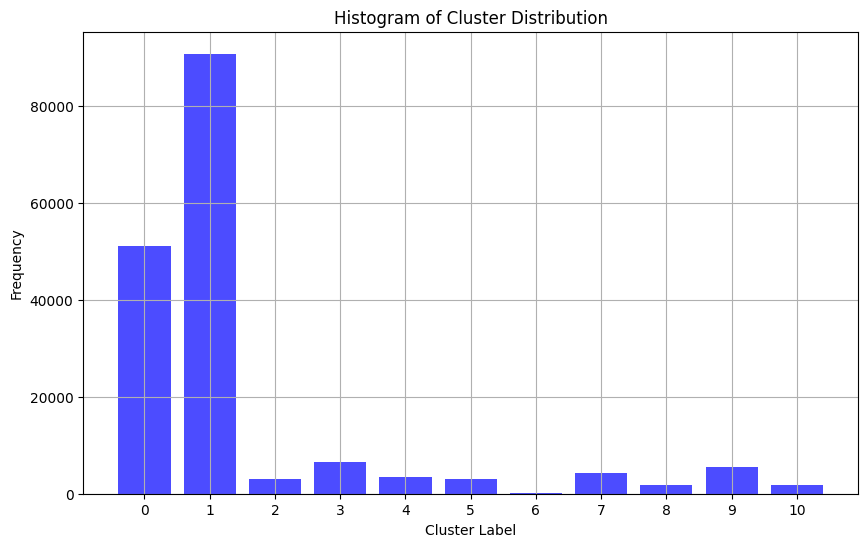

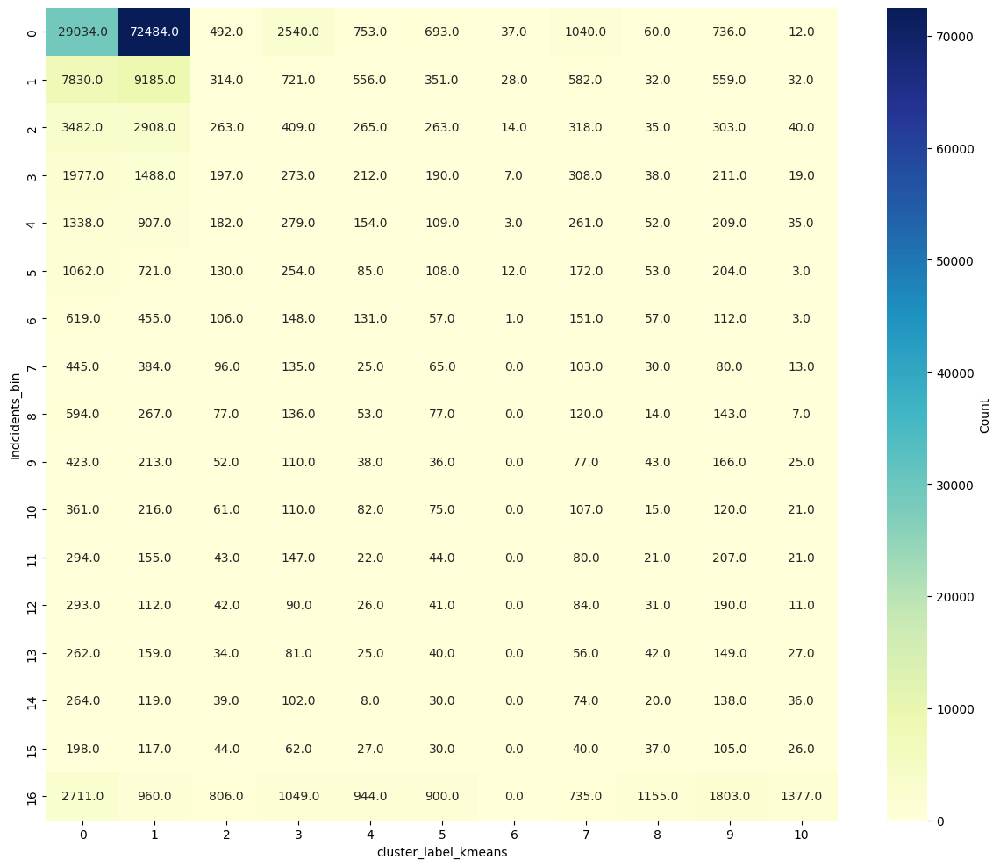

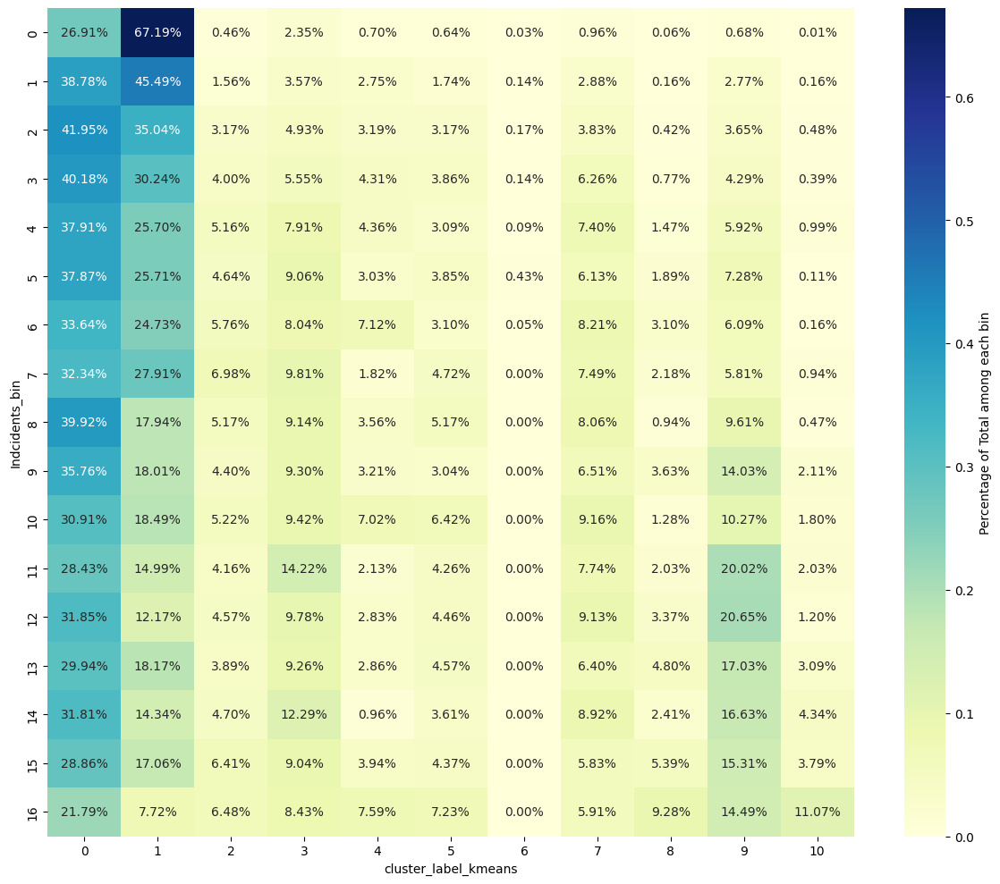

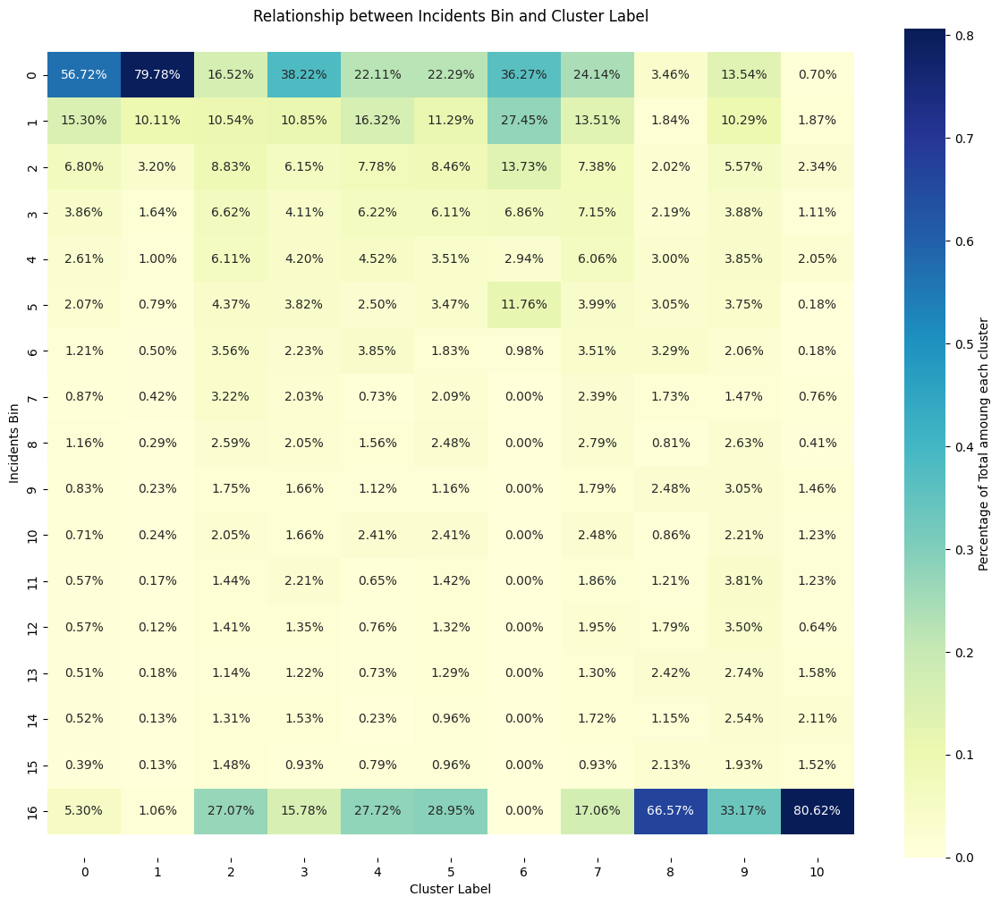

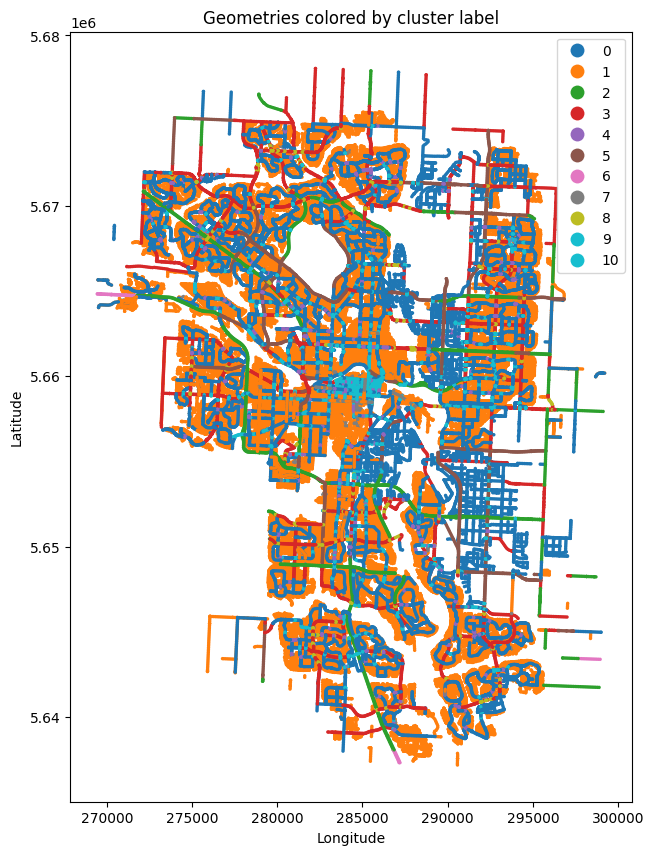


n_clusters 12



C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni


Most common attributes for Cluster:


C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni

,Cluster,SPEED_LIMIT_mode,SPEED_LIMIT_mean,SPEED_LIMIT_median,SIGN_TYPE_Flat_Sheet_mode,SIGN_TYPE_Flat_Sheet_mean,SIGN_TYPE_Flat_Sheet_median,Size_Category_Medium_mode,Size_Category_Medium_mean,Size_Category_Medium_median,Size_Category_Large_mode,Size_Category_Large_mean,Size_Category_Large_median,CROSSWALK_TYPE_SIGNALIZED_mode,CROSSWALK_TYPE_SIGNALIZED_mean,CROSSWALK_TYPE_SIGNALIZED_median
0,0,[50.0],50.000000,50.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
1,1,[40.0],39.980627,40.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
2,2,[80.0],80.000000,80.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
3,3,[60.0],60.000000,60.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
4,4,[50.0],49.917412,50.0,[7],7.393668,7.0,[2],2.556779,2.0,[5],5.061253,5.0,[1],0.984171,1.0
5,5,[70.0],70.000000,70.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
6,6,[40.0],39.939647,40.0,[2],3.456592,3.0,[2],2.668059,2.0,0,0.000000,0.0,0,0.000000,0.0
7,7,[50.0],50.000000,50.0,[2],2.512672,2.0,[2],1.398275,2.0,[2],1.741112,2.0,[1],0.548926,1.0
8,8,[110.0],108.235294,110.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
9,9,[90.0],90.000000,90.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0


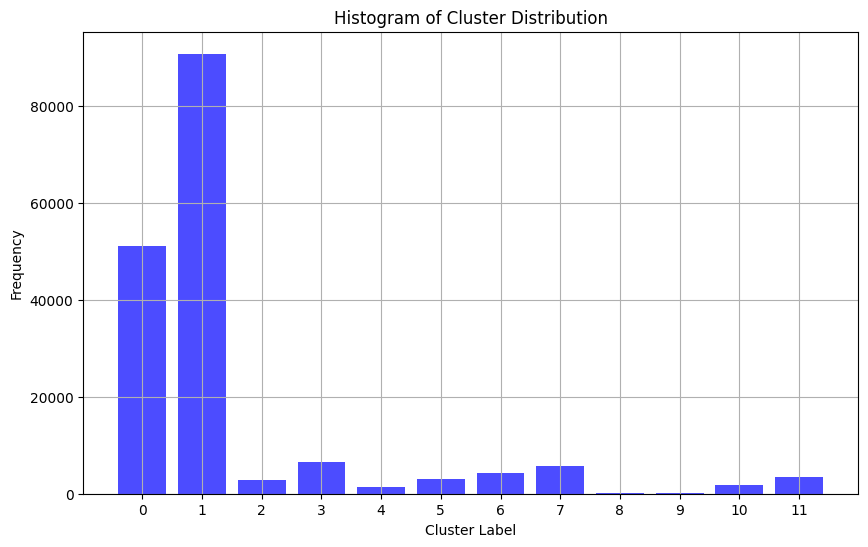

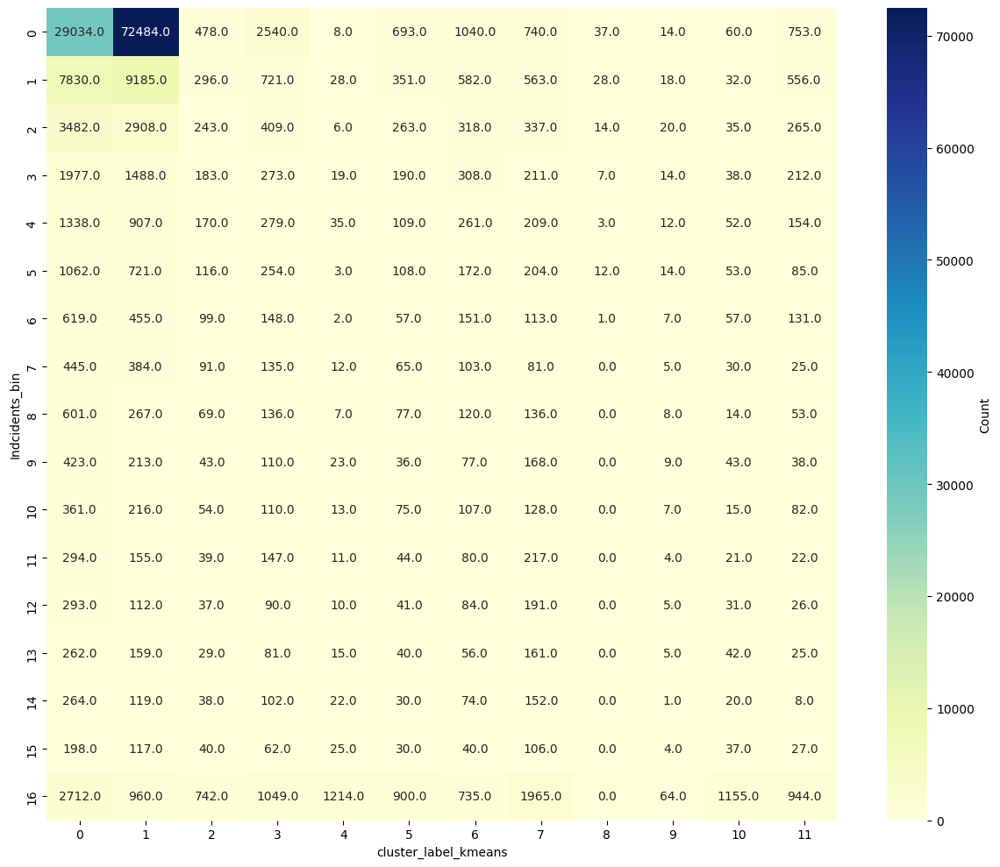

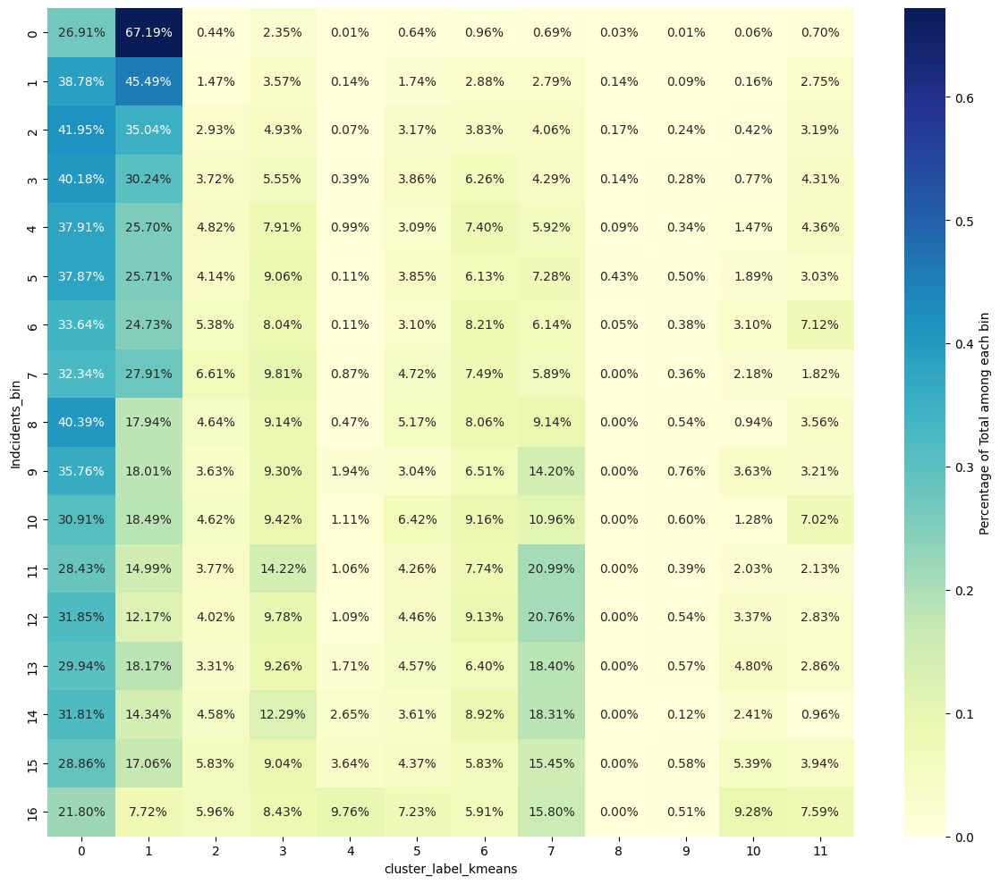

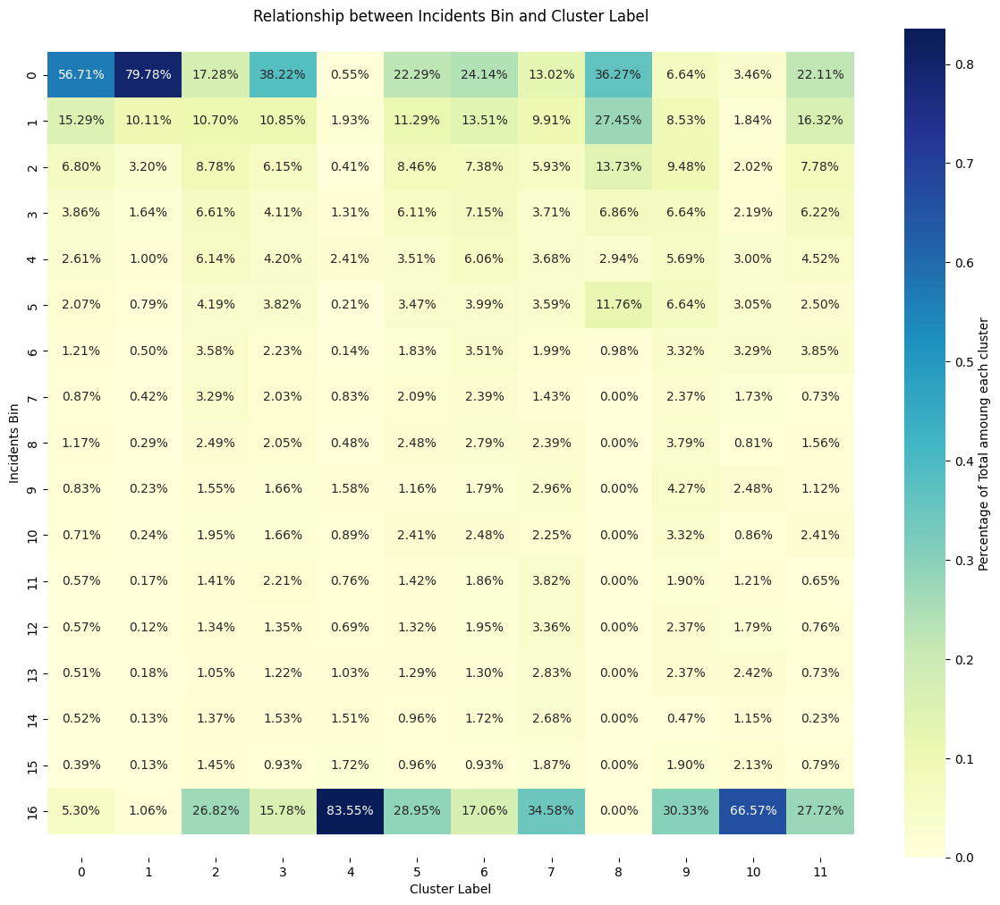

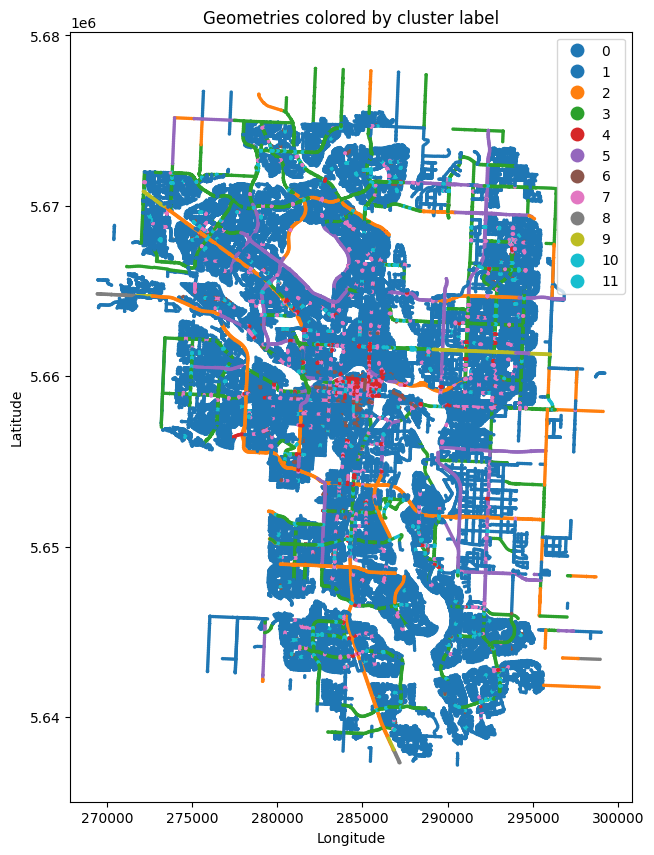


n_clusters 13



C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni


Most common attributes for Cluster:


C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni

,Cluster,SPEED_LIMIT_mode,SPEED_LIMIT_mean,SPEED_LIMIT_median,SIGN_TYPE_Flat_Sheet_mode,SIGN_TYPE_Flat_Sheet_mean,SIGN_TYPE_Flat_Sheet_median,Size_Category_Medium_mode,Size_Category_Medium_mean,Size_Category_Medium_median,Size_Category_Large_mode,Size_Category_Large_mean,Size_Category_Large_median,CROSSWALK_TYPE_SIGNALIZED_mode,CROSSWALK_TYPE_SIGNALIZED_mean,CROSSWALK_TYPE_SIGNALIZED_median
0,0,[80.0],80.720628,80.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
1,1,[40.0],39.980627,40.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
2,2,[50.0],50.000000,50.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
3,3,[60.0],60.000000,60.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
4,4,[70.0],70.000000,70.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
5,5,[50.0],49.929742,50.0,[7],6.949649,7.0,[2],2.381733,2.0,[5],4.771077,5.0,[1],0.953747,1.0
6,6,[110.0],108.235294,110.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
7,7,[60.0],60.000000,60.0,[2],2.787360,3.0,[2],1.660366,2.0,0,0.000000,0.0,[1],0.731837,1.0
8,8,[40.0],39.939647,40.0,[2],3.456592,3.0,[2],2.668059,2.0,0,0.000000,0.0,0,0.000000,0.0
9,9,[70.0],70.988142,70.0,[4],6.039526,5.0,[2],2.531621,2.0,[4],3.596838,4.0,[1],0.972332,1.0


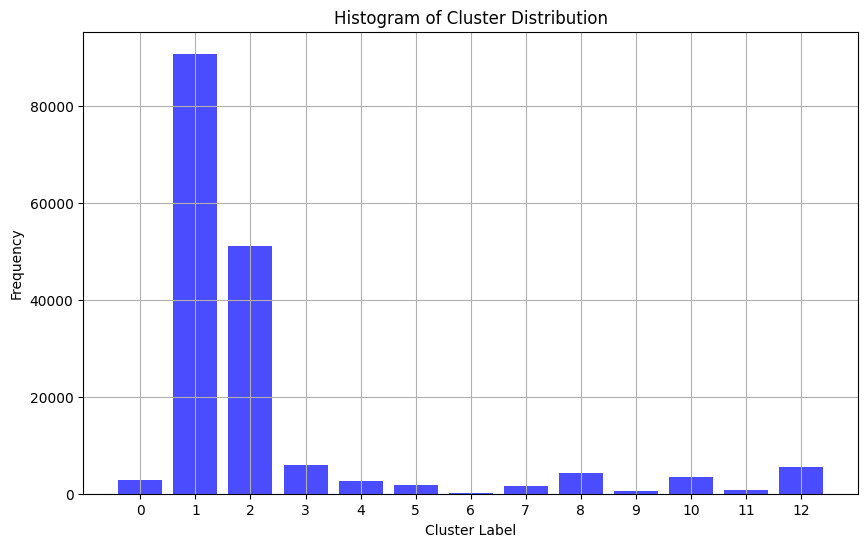

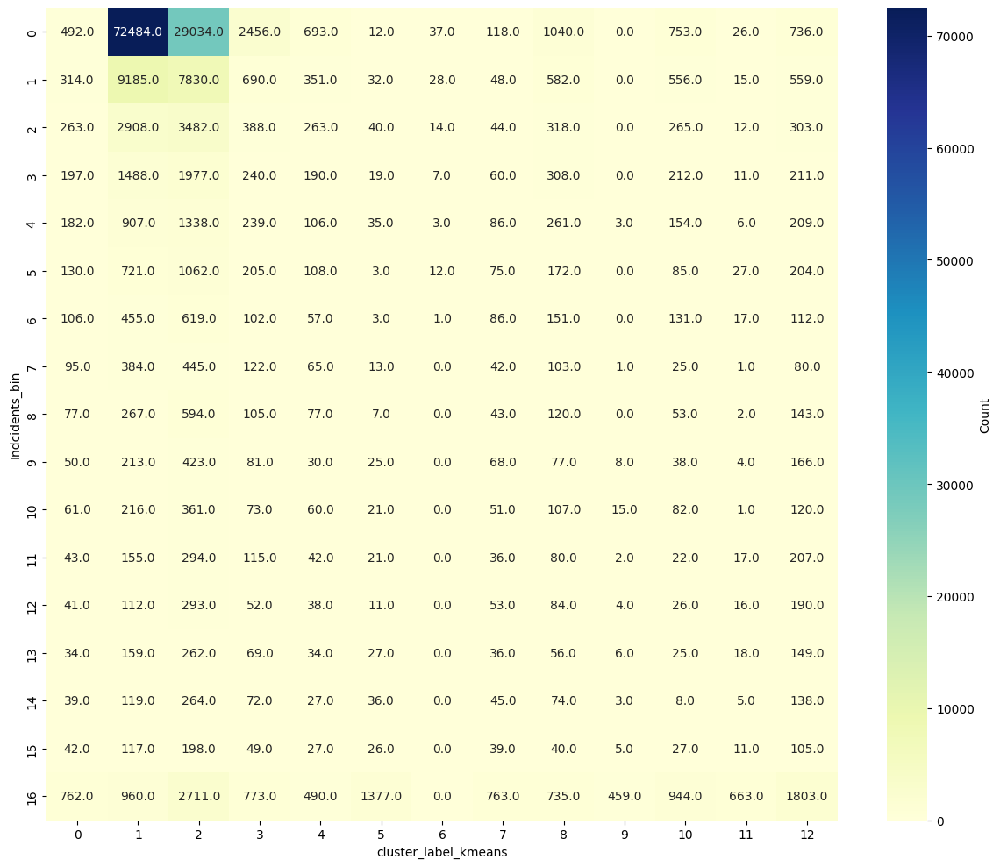

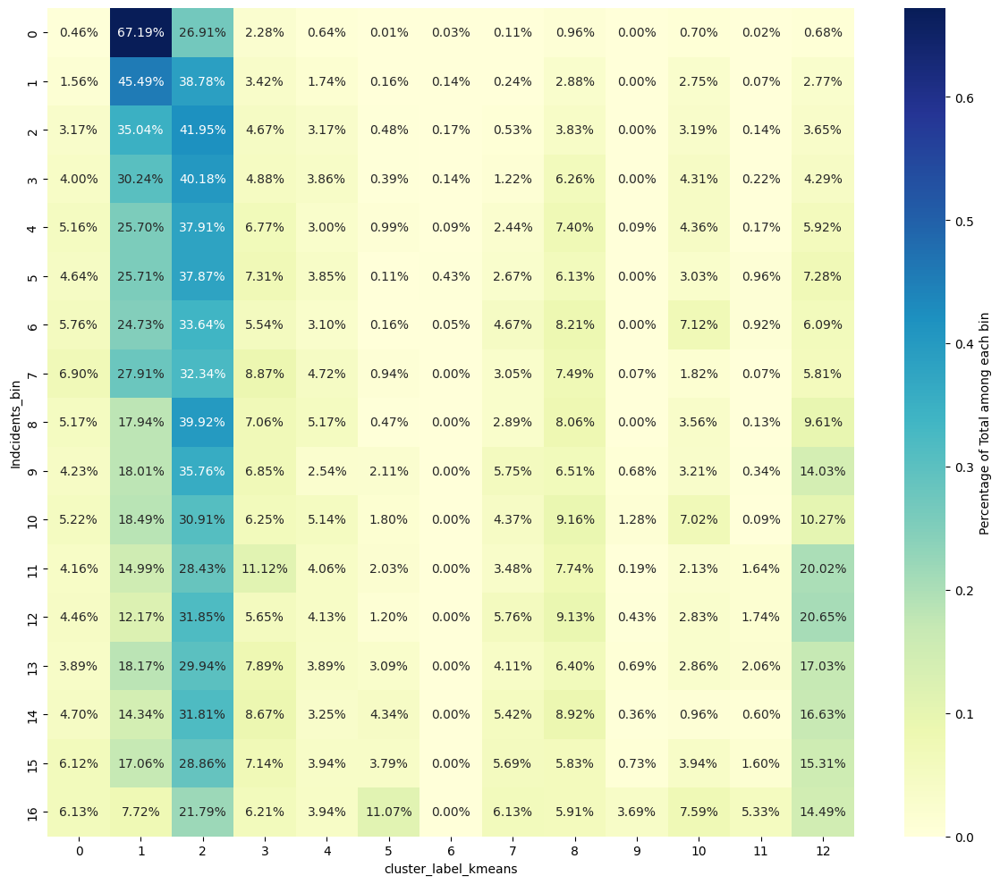

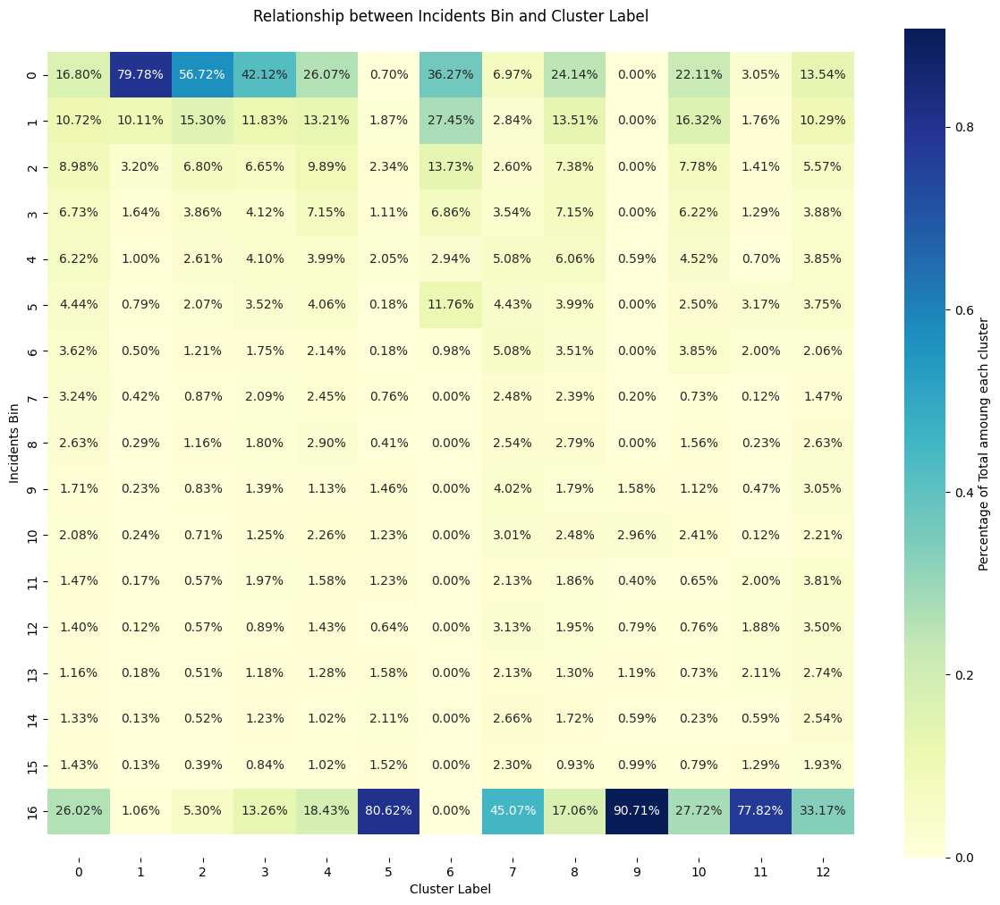

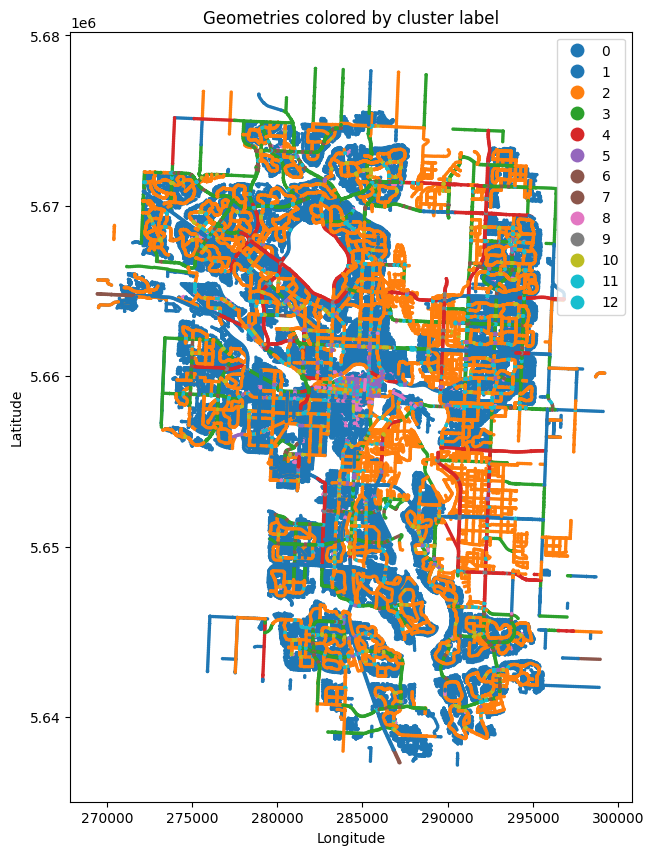


n_clusters 14



C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni


Most common attributes for Cluster:


C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni

,Cluster,SPEED_LIMIT_mode,SPEED_LIMIT_mean,SPEED_LIMIT_median,CROSSWALK_TYPE_RSM_mode,CROSSWALK_TYPE_RSM_mean,CROSSWALK_TYPE_RSM_median,SIGN_TYPE_Flat_Sheet_mode,SIGN_TYPE_Flat_Sheet_mean,SIGN_TYPE_Flat_Sheet_median,Size_Category_Medium_mode,Size_Category_Medium_mean,Size_Category_Medium_median,Size_Category_Large_mode,Size_Category_Large_mean,Size_Category_Large_median,CROSSWALK_TYPE_SIGNALIZED_mode,CROSSWALK_TYPE_SIGNALIZED_mean,CROSSWALK_TYPE_SIGNALIZED_median
0,0,[50.0],50.000000,50.0,[1],1.072295,1.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
1,1,[40.0],40.000000,40.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
2,2,[80.0],80.716225,80.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
3,3,[60.0],60.000000,60.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
4,4,[70.0],70.521173,70.0,0,0.000000,0.0,[4],5.355049,4.0,[2],2.301303,2.0,[4],3.122150,3.0,[1],0.956026,1.0
5,5,[110.0],108.235294,110.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
6,6,[50.0],50.000000,50.0,0,0.000000,0.0,[2],2.514986,2.0,[2],1.398977,2.0,[2],1.742419,2.0,[1],0.549542,1.0
7,7,[30.0],29.693878,30.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
8,8,[40.0],40.000000,40.0,0,0.000000,0.0,[2],3.453760,3.0,[2],2.665577,2.0,0,0.000000,0.0,0,0.000000,0.0
9,9,[50.0],50.000000,50.0,0,0.000000,0.0,[4],4.571638,4.0,[4],4.296536,4.0,0,0.000000,0.0,0,0.000000,0.0


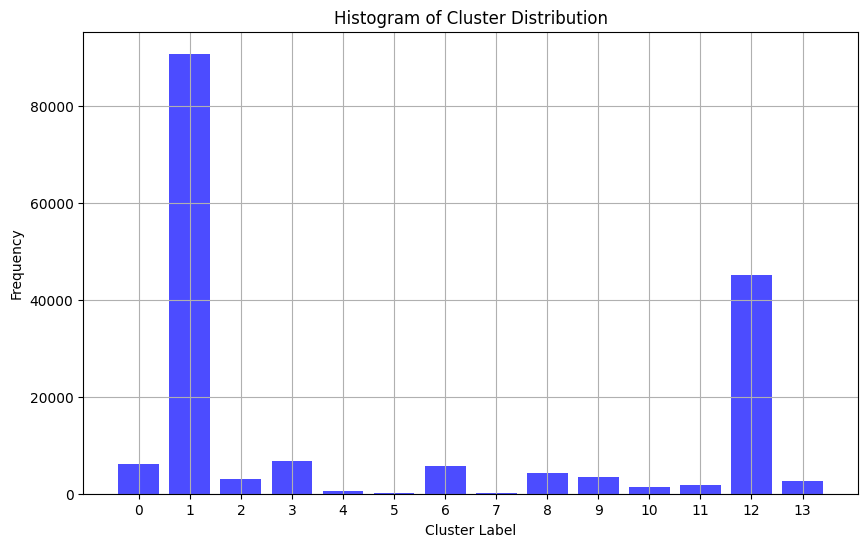

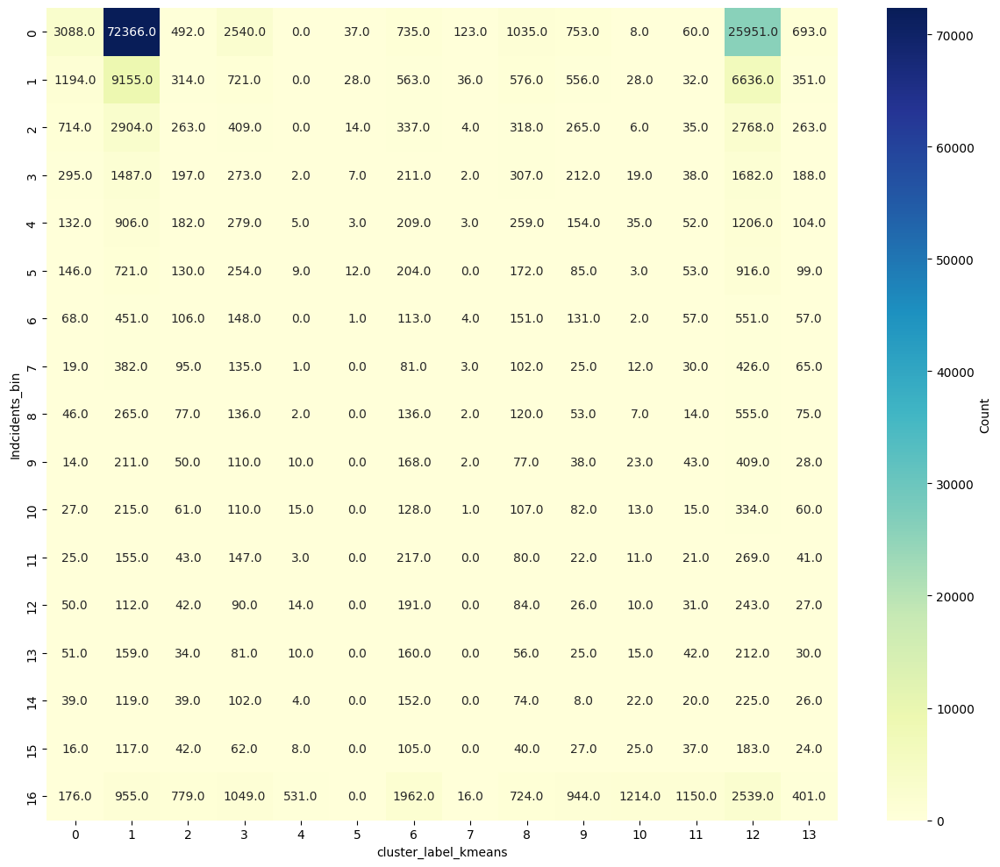

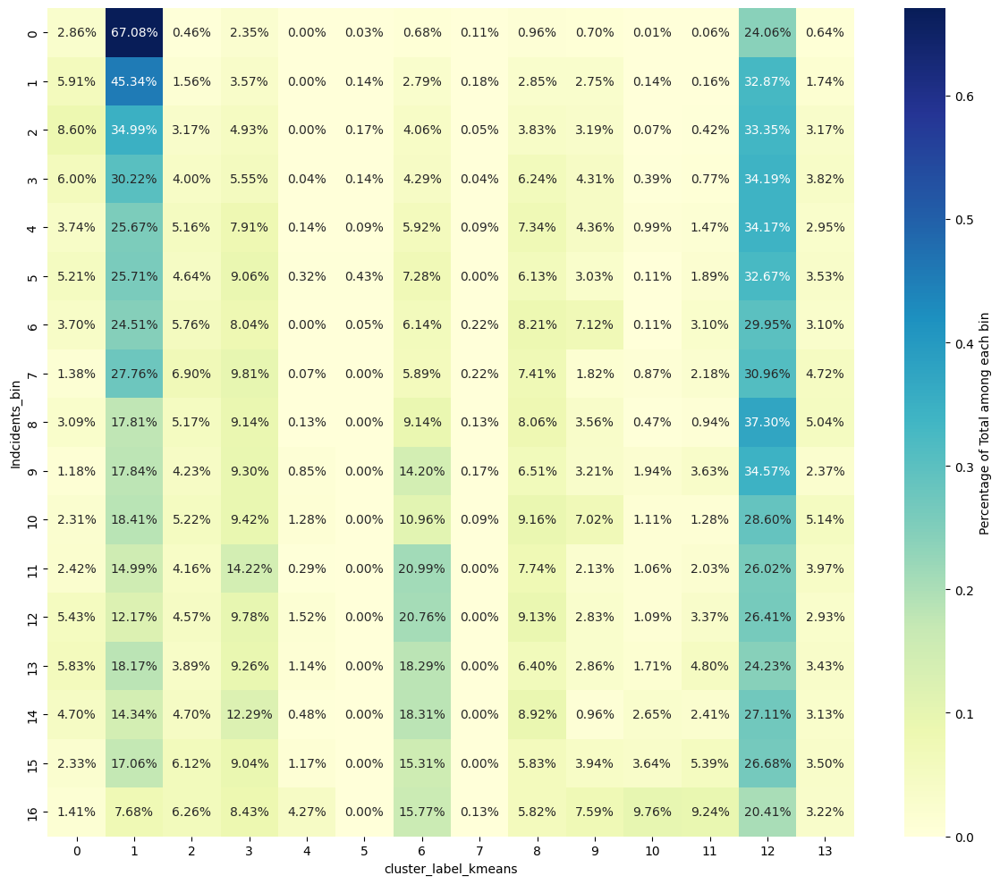

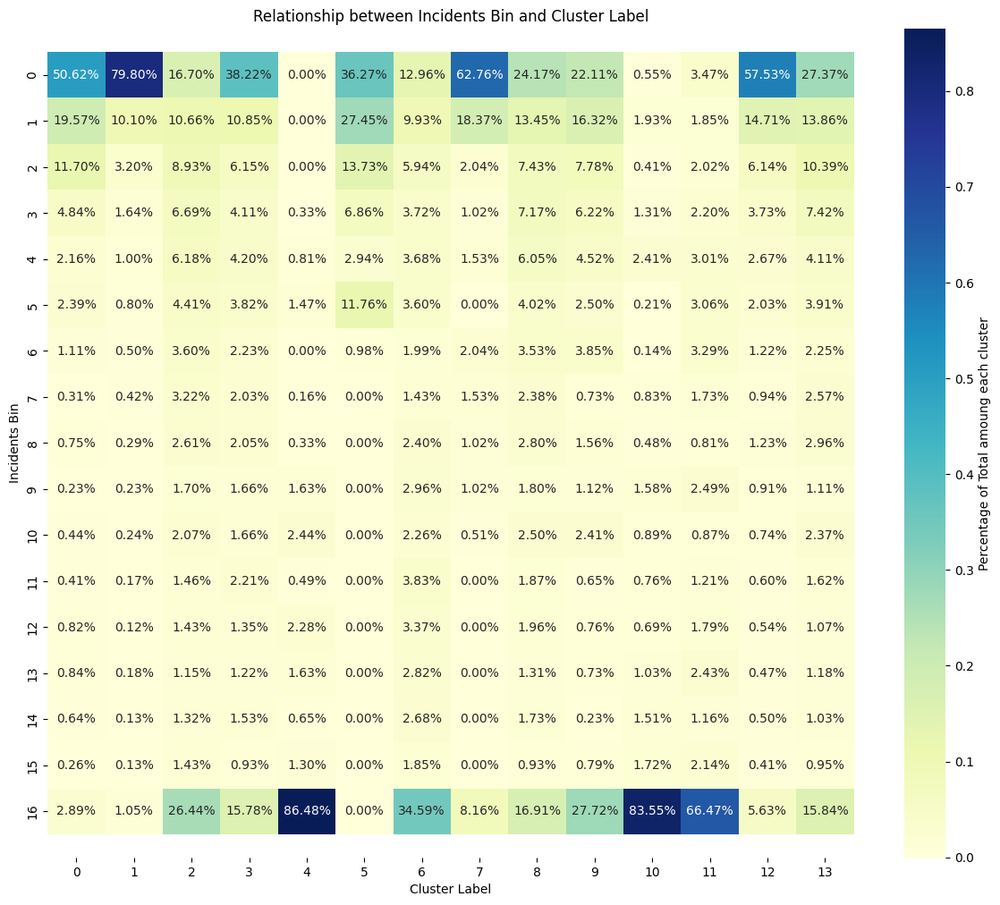

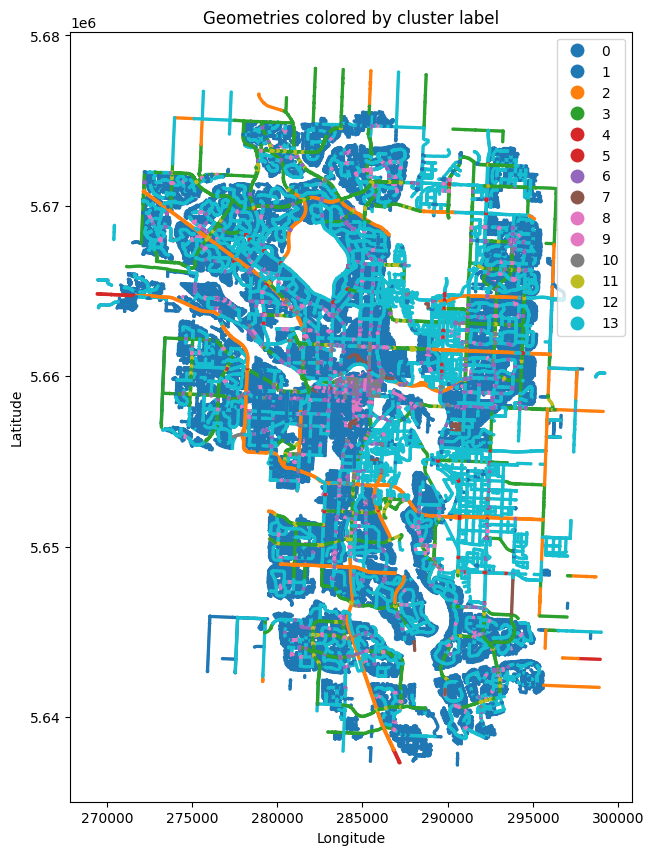


n_clusters 15



C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni


Most common attributes for Cluster:


C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni

,Cluster,SPEED_LIMIT_mode,SPEED_LIMIT_mean,SPEED_LIMIT_median,SIGN_TYPE_Flat_Sheet_mode,SIGN_TYPE_Flat_Sheet_mean,SIGN_TYPE_Flat_Sheet_median,Size_Category_Medium_mode,Size_Category_Medium_mean,Size_Category_Medium_median,Size_Category_Large_mode,Size_Category_Large_mean,Size_Category_Large_median,CROSSWALK_TYPE_SIGNALIZED_mode,CROSSWALK_TYPE_SIGNALIZED_mean,CROSSWALK_TYPE_SIGNALIZED_median
0,0,[40.0],40.000000,40.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
1,1,[70.0],70.521173,70.0,[4],5.355049,4.0,[2],2.301303,2.0,[4],3.122150,3.0,[1],0.956026,1.0
2,2,[50.0],50.000000,50.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
3,3,[50.0],50.000000,50.0,[4],4.571638,4.0,[4],4.296536,4.0,0,0.000000,0.0,0,0.000000,0.0
4,4,[60.0],60.000000,60.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
5,5,[80.0],80.000000,80.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
6,6,[110.0],108.235294,110.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
7,7,[40.0],40.000000,40.0,[2],3.453760,3.0,[2],2.665577,2.0,0,0.000000,0.0,0,0.000000,0.0
8,8,[70.0],70.000000,70.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
9,9,[60.0],60.000000,60.0,[6],6.946609,6.0,[2],3.316017,3.0,[3],3.695527,4.0,[1],0.959596,1.0


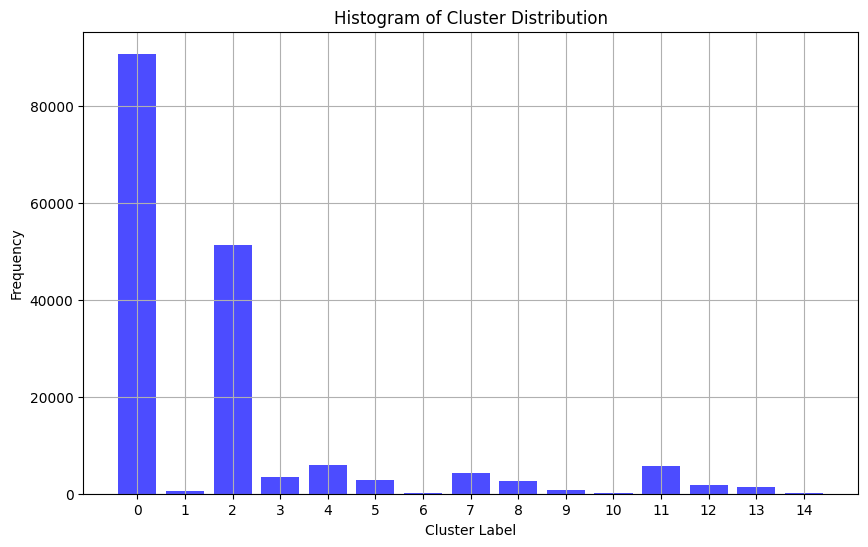

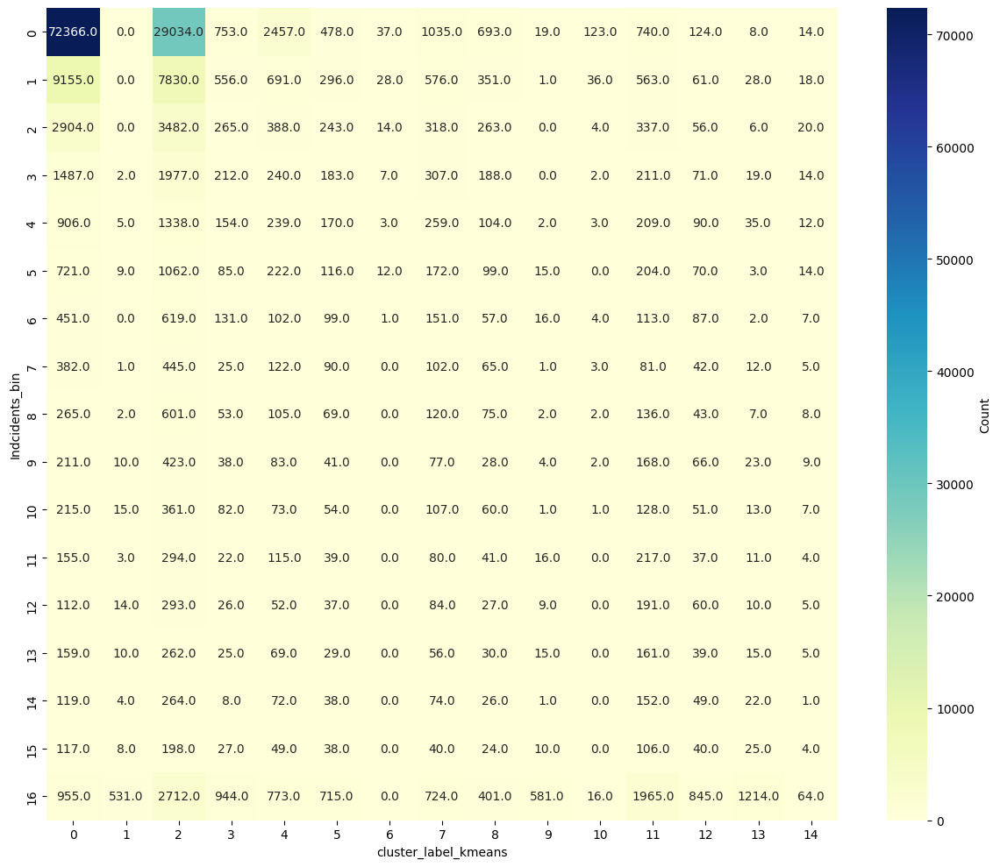

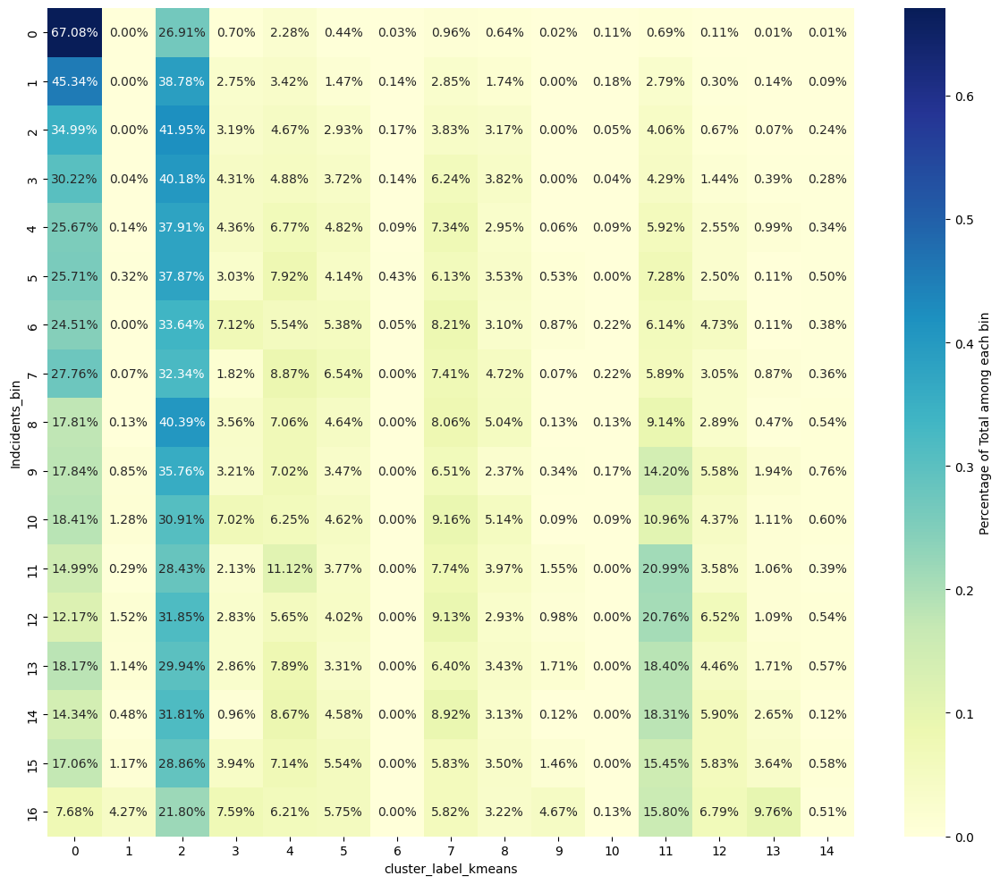

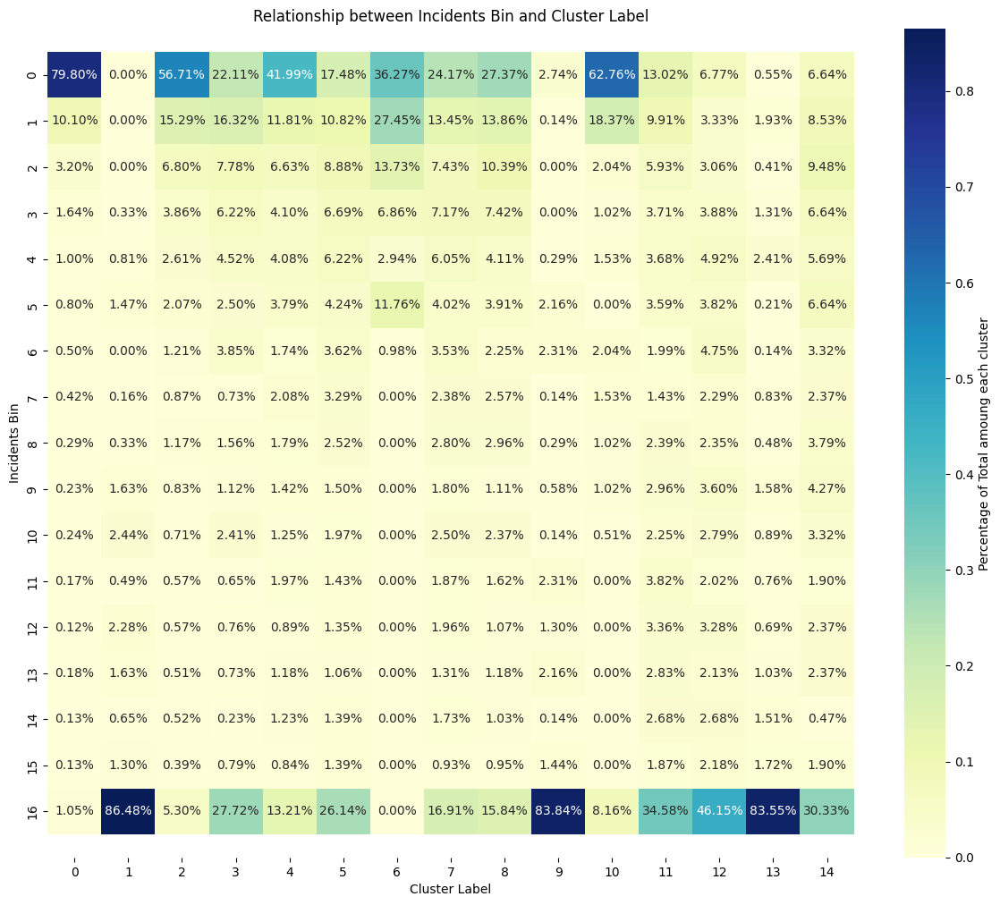

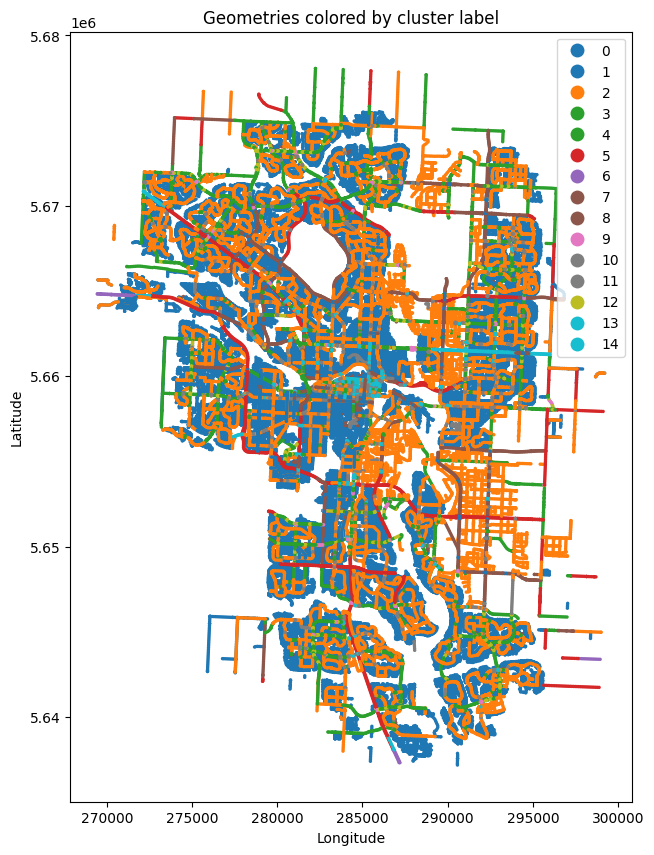

In [44]:
def show_label_if_above_threshold(val):
    if val > 0:  # Adjust the threshold as needed (e.g., 2 or 3)
        return f"{val:.1f}"  # Display with one decimal place
    else:
        return ""  # Empty string for values below threshold

def clustering(input, n_clusters, min_incident): 

    print("")
    print(f"n_clusters {n_clusters}")
    print("")
    cluster_df = input.copy()
    cluster_df = cluster_df[cluster_df['Indcidents'] >= min_incident]
    
    # n_clusters = 5
    init_method = 'k-means++'
    max_iter = 3000
    n_init = 10
    random_state = 0
    
    cluster_df.reset_index(drop=True, inplace=True)
    
    # Helper, you can use color from the color_list
    # create a list of colors for the clusters the length of the number of clusters
    # number of clusters
    color_list = sns.color_palette("hls", n_clusters).as_hex()
    
    # Initialize K-Means with the optimal number of clusters and fit it to the data
    kmeans_best = KMeans(n_clusters=n_clusters, init=init_method, max_iter=max_iter, n_init=n_init, random_state=random_state)
    categorical_cols = ['SPEED_LIMIT', 'SIGN_TYPE_Flat_Sheet', 'SIGN_TYPE_Other', 'SIGN_TYPE_Varicom', 'SIGN_TYPE_LED', 'SIGN_TYPE_Internally_illuminated', 'Size_Category_Medium', 'Size_Category_Large', 'Size_Category_Small', 'CROSSWALK_TYPE_RSM', 'CROSSWALK_TYPE_MULTIWAY_STOP', 'CROSSWALK_TYPE_SIGNALIZED', 'CROSSWALK_TYPE_REGULAR', 'CROSSWALK_TYPE_MID_BLOCK', 'CROSSWALK_TYPE_SCHOOL', 'CROSSWALK_TYPE_DOWNTOWN', 'CROSSWALK_TYPE_MULTIWAYS', 'CROSSWALK_TYPE_CORRIDOR', 'CROSSWALK_TYPE_RED_LIGHT_CAMERA', 'CROSSWALK_TYPE_ELDERLY_PEDESTRIAN', 'CROSSWALK_TYPE_ELDERLY', 'CROSSWALK_TYPE_RRXING', 'CROSSWALK_TYPE_PENDING_WO', 'CROSSWALK_TYPE_STOP', 'CROSSWALK_TYPE_SPEED_TABLE', 'CROSSWALK_TYPE_TRAFFIC_CIRCLE', 'CROSSWALK_TYPE_OSM', 'CROSSWALK_TYPE_CIRCLE', 'CROSSWALK_TYPE_SPECIAL']
    cluster_df['cluster_label_kmeans'] = kmeans_best.fit_predict(cluster_df[categorical_cols])
    
    # Calculate the cluster centroids
    centroids = kmeans_best.cluster_centers_
    # print(f"Cluster centroids for {n_clusters} clusters:")
    # print(centroids)
    
    modes_list = []
    count_list = []
    
    # silhouette_avg = silhouette_score(cluster_df[categorical_cols], cluster_df['cluster_label_kmeans'])
    # print(f"Silhouette score {silhouette_avg}")
    
    # Calculate mode for categorical features
    for i in range(n_clusters):
        cluster_data = cluster_df[cluster_df['cluster_label_kmeans'] == i]
        mode_row = {'Cluster': i}
        for col in categorical_cols:
            mode = 0
            count = 0
            mode_data = stats.mode(cluster_data[col])
            mean_val = cluster_data[col].mean()
            median_val = cluster_data[col].median()
            # Check if mode_data is not scalar
            if mode_data.mode.size > 1:
                mode = mode_data.mode[0]
                count = mode_data.count[0]                
                if count != 0 and mode == 1:  # If count is not zero and mode is 1, it's the most common attribute
                    print(f"{col}: {mode}")
                    cluster_mode_data = pd.DataFrame({'Cluster': i, 'Col': col, 'Mode': modes, 'Count': mode_counts})
                    mode_data_df = pd.concat([mode_data_df, cluster_mode_data], axis=1)
                else:
                    print(f"{col}: None or tie for mode")
            else:
                mode = mode_data.mode
                count = mode_data.count
                # print(f"{col}: scalar mode_data.mode {mode_data.mode}, mode_data.count {mode_data.count}")

            if mode != 0:
                mode_row[col + '_mode'] = mode
                mode_row[col + '_mean'] = mean_val
                mode_row[col + '_median'] = median_val
        modes_list.append(mode_row)
        # print("\n")

    mode_data_df = pd.DataFrame(modes_list).fillna(0)
    print(f"\nMost common attributes for Cluster:")
    display(mode_data_df)
    # cluster_df.head()
    # cluster_df.info()
    
    # Now plot the histogram with the optimized bin width
    plt.figure(figsize=(10, 6))
    plt.hist(cluster_df['cluster_label_kmeans'], bins=np.arange(n_clusters+1)-0.5, color='blue', alpha=0.7, rwidth=0.8)
    plt.title('Histogram of Cluster Distribution')
    plt.xlabel('Cluster Label')
    plt.ylabel('Frequency')
    plt.xticks(range(int(cluster_df['cluster_label_kmeans'].max()) + 1))  # To show each cluster ID on the x-axis
    plt.grid(True)
    plt.show()
    
    cross_tab = pd.crosstab(cluster_df['Indcidents_bin'], cluster_df['cluster_label_kmeans'])
    
    # Show the cross-tabulation
    # print(cross_tab)

    plt.figure(figsize=(12, 10))
    ax = sns.heatmap(cross_tab, annot=True, cmap="YlGnBu", fmt=".1f", cbar=True,
                      cbar_kws={'label': 'Count'})

    # Ensure the entire heatmap is displayed
    plt.tight_layout()
    
    # Calculate the percentages for the heatmap
    cross_tab_percentage = cross_tab.div(cross_tab.sum(axis=1), axis=0)
    
    # Plotting the heatmap with percentages
    plt.figure(figsize=(12, 10))
    ax = sns.heatmap(cross_tab_percentage, annot=True, fmt=".2%", cmap="YlGnBu", cbar=True,
                     cbar_kws={'label': 'Percentage of Total among each bin'})
    plt.tight_layout()

    # Calculate the percentages for the heatmap
    cross_tab_percentage2 = cross_tab.div(cross_tab.sum(axis=0), axis=1)
    
    # Plotting the heatmap with percentages
    plt.figure(figsize=(12, 10))
    ax = sns.heatmap(cross_tab_percentage2, annot=True, fmt=".2%", cmap="YlGnBu", cbar=True,
                     cbar_kws={'label': 'Percentage of Total amoung each cluster'})
    plt.tight_layout()

    # Improve the formatting to make sure all annotations are shown
    bottom, top = ax.get_ylim()  # discover the values for bottom and top
    ax.set_ylim(bottom + 0.5, top - 0.5)  # update the ylim(bottom, top) values
    
    plt.title("Relationship between Incidents Bin and Cluster Label")
    plt.ylabel("Incidents Bin")
    plt.xlabel("Cluster Label")
    plt.show()

    # Ensure that 'cluster_label_kmeans' is of type 'category' for better color handling
    cluster_df['cluster_label_kmeans'] = cluster_df['cluster_label_kmeans'].astype('category')
    
    # Plot using geopandas
    fig, ax = plt.subplots(1, 1, figsize=(10, 10))
    cluster_df.plot(column='cluster_label_kmeans', ax=ax, legend=True)
    
    # Add title and axis labels as needed
    plt.title('Geometries colored by cluster label')
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    
    # Show plot
    plt.show()

n_cluster_options = [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]
for n_clusters in n_cluster_options:
    clustering(df_with_speed_incidents_sign_crosswalk, n_clusters, 0)


n_clusters 2


Most common attributes for Cluster:


C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni

,Cluster,SPEED_LIMIT_mode,SPEED_LIMIT_mean,SPEED_LIMIT_median
0,0,[50.0],45.888521,50.0
1,1,[60.0],67.360439,60.0


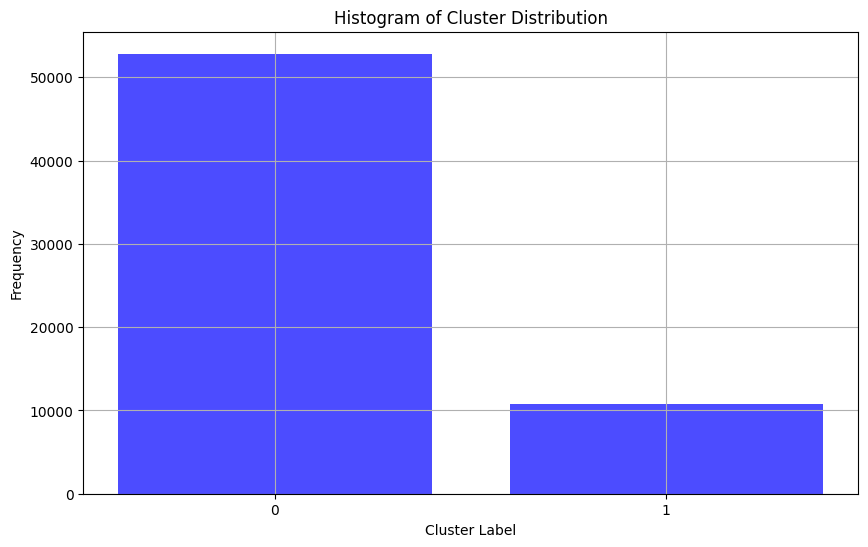

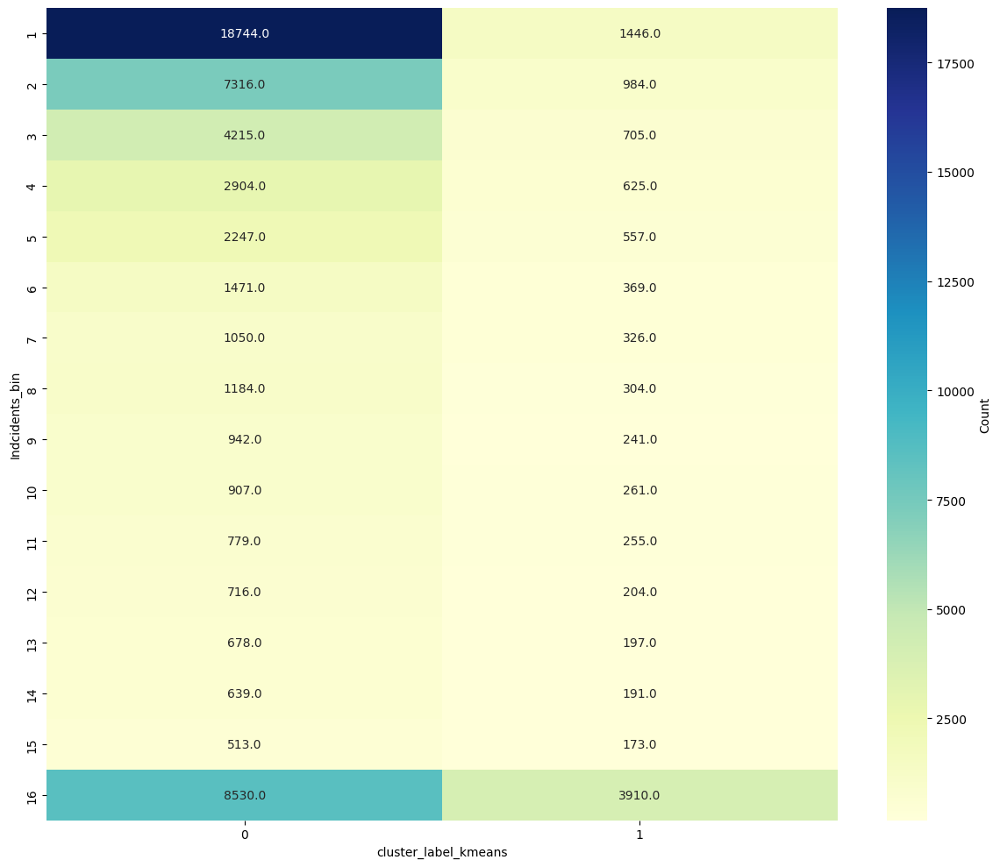

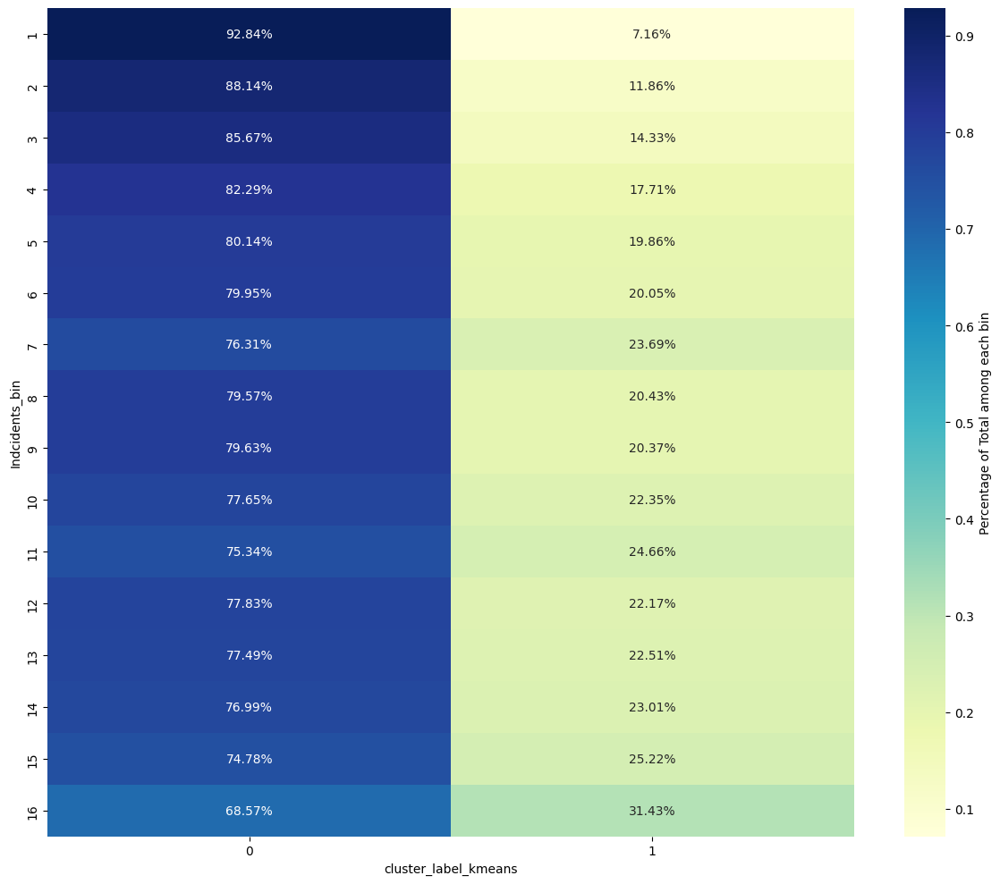

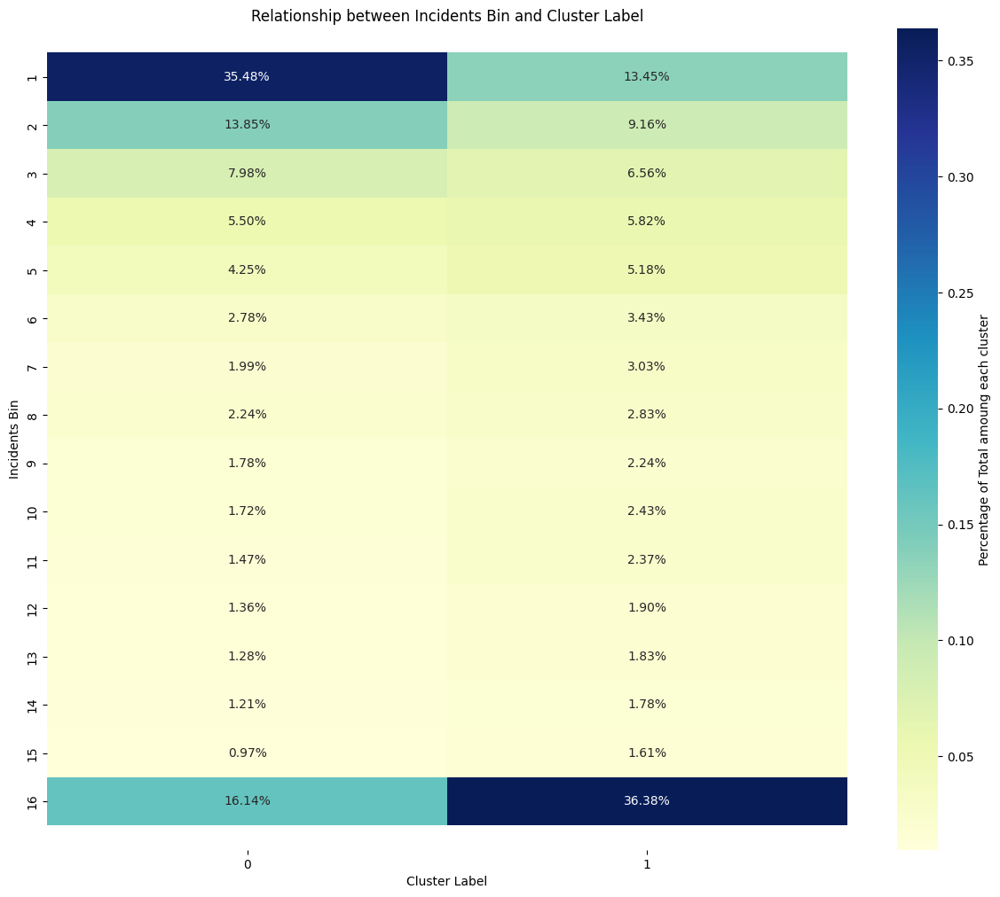

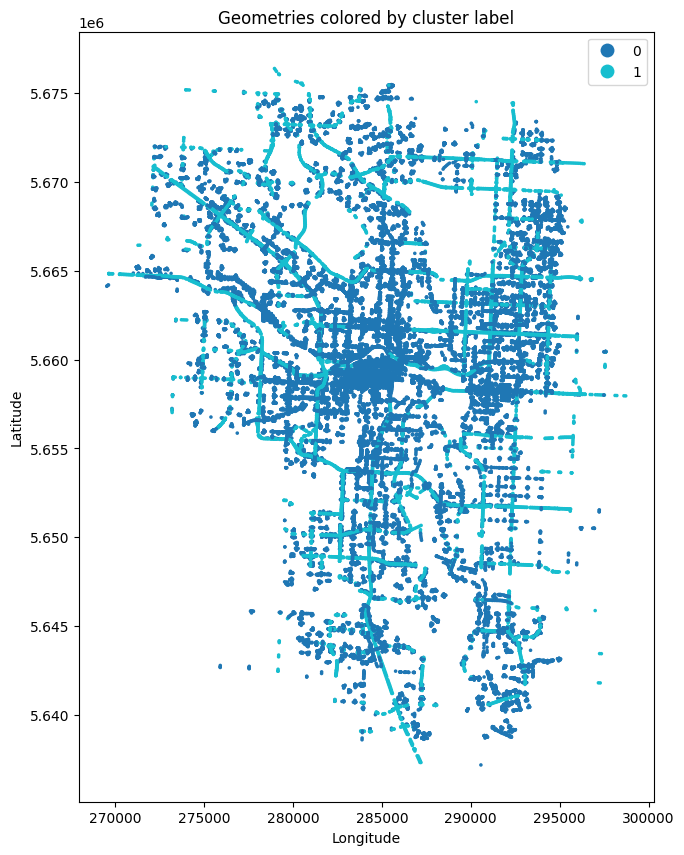


n_clusters 3


Most common attributes for Cluster:


C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni

,Cluster,SPEED_LIMIT_mode,SPEED_LIMIT_mean,SPEED_LIMIT_median
0,0,[40.0],39.964428,40.0
1,1,[50.0],51.562559,50.0
2,2,[70.0],75.911102,80.0


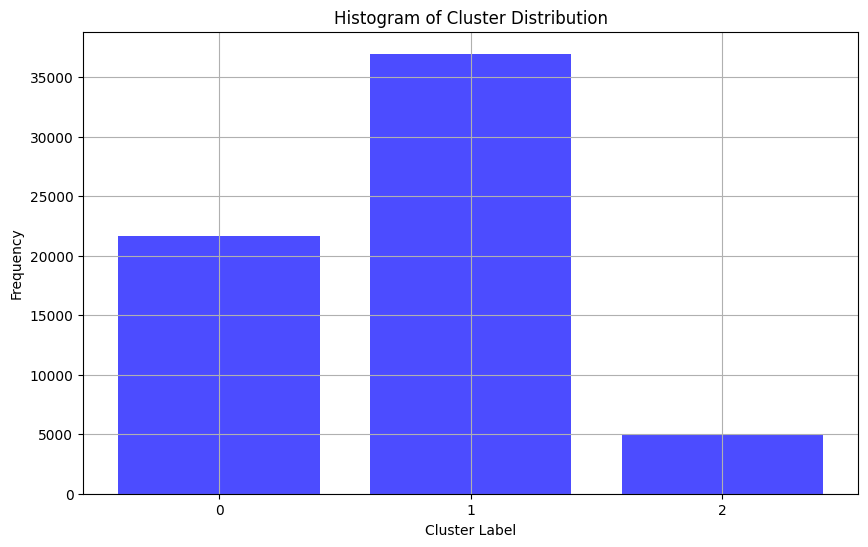

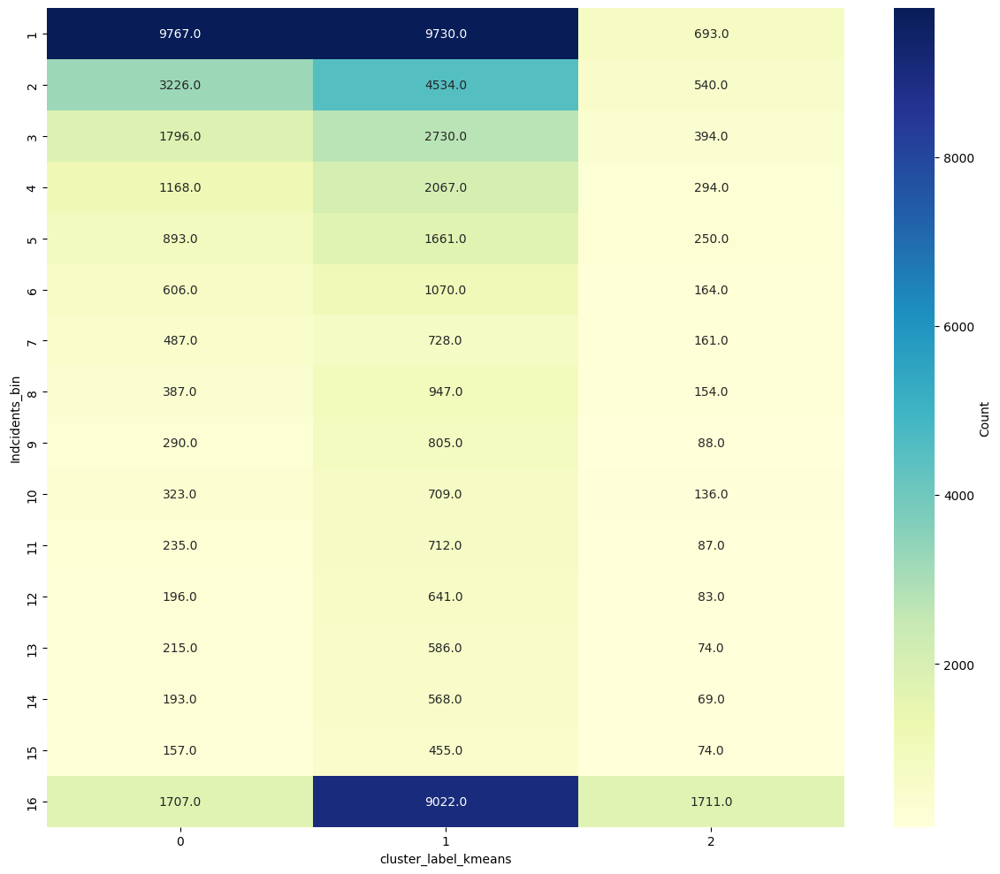

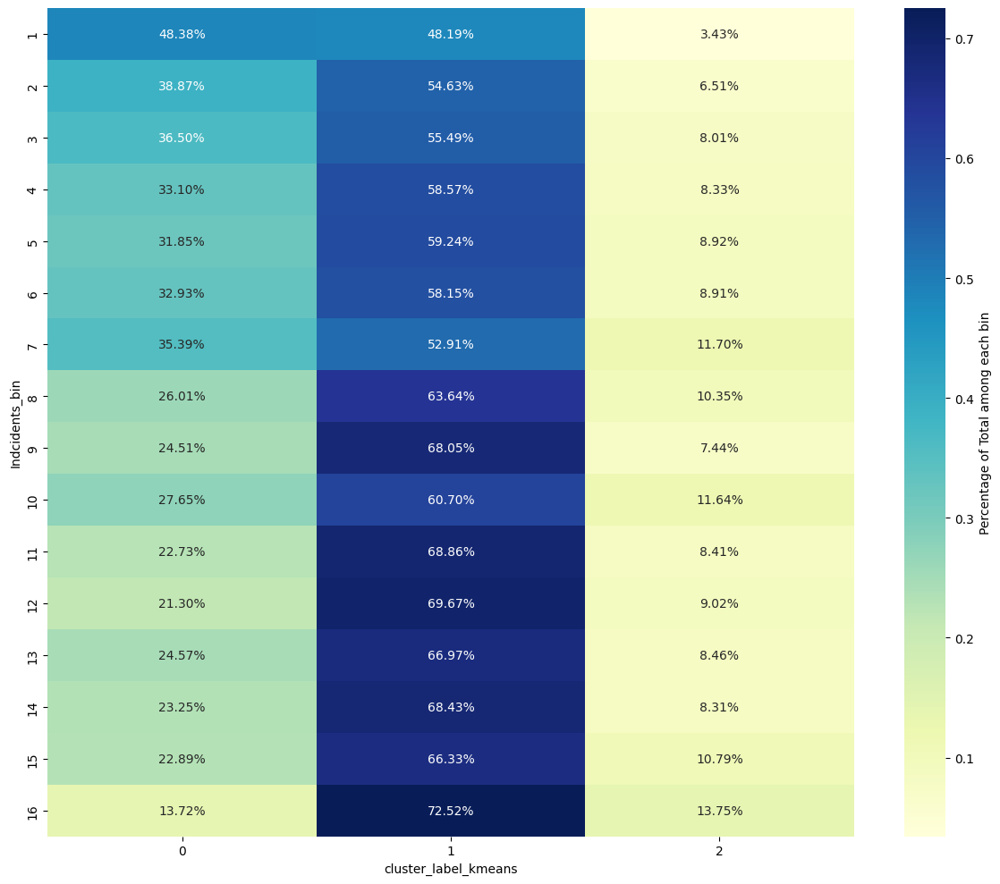

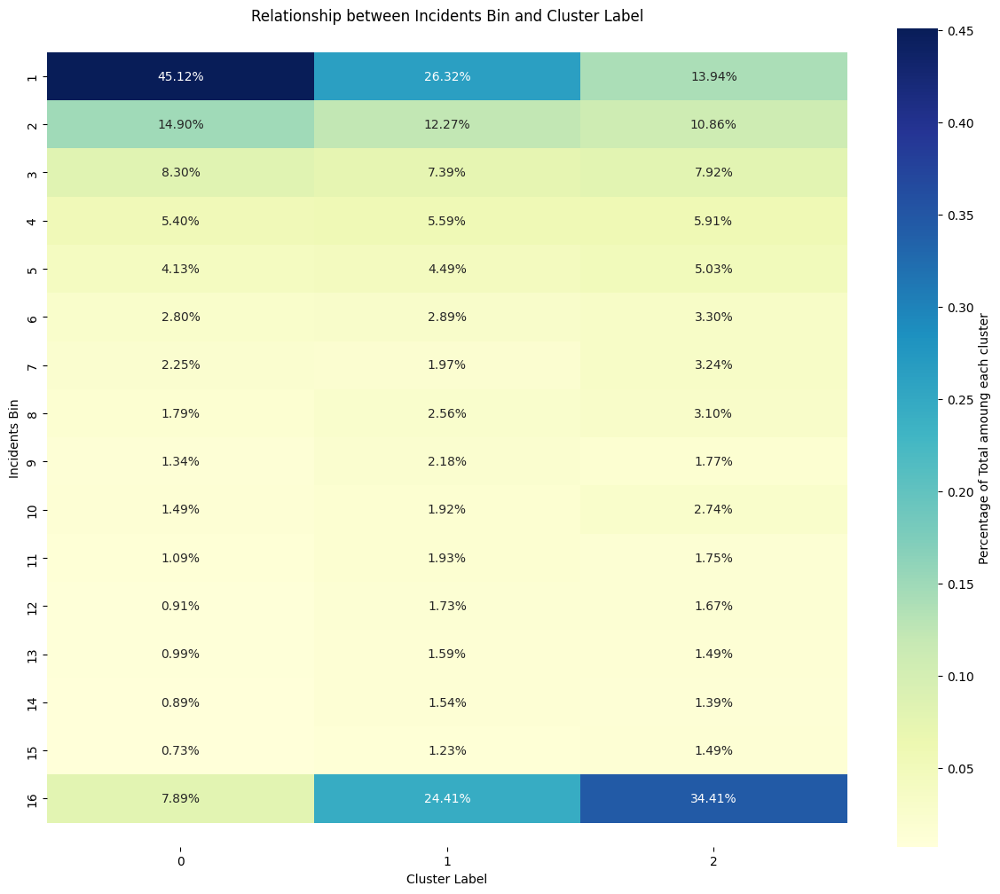

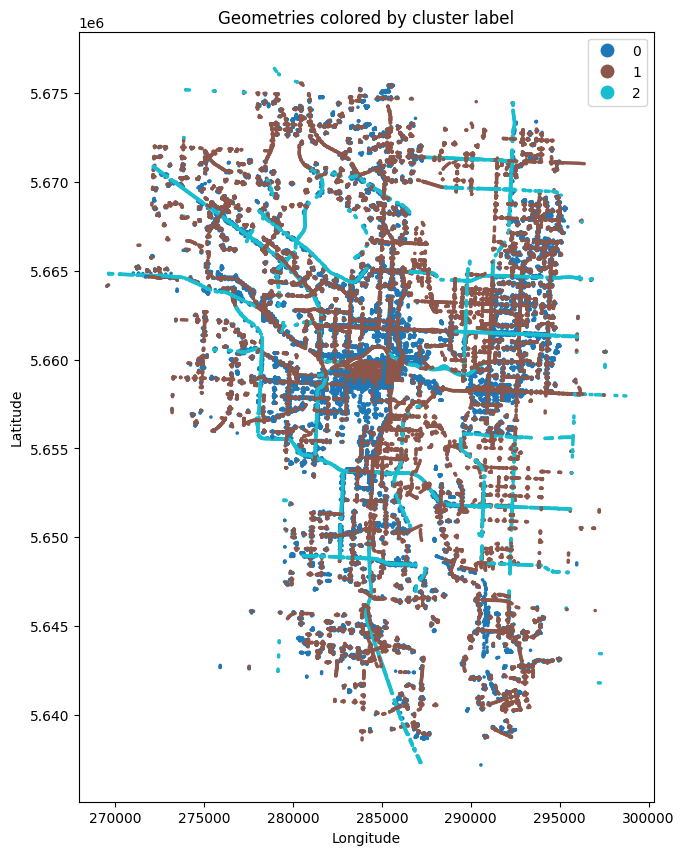


n_clusters 4


Most common attributes for Cluster:


C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni

,Cluster,SPEED_LIMIT_mode,SPEED_LIMIT_mean,SPEED_LIMIT_median,CROSSWALK_TYPE_SIGNALIZED_mode,CROSSWALK_TYPE_SIGNALIZED_mean,CROSSWALK_TYPE_SIGNALIZED_median
0,0,[40.0],39.964428,40.0,0,0.000000,0.0
1,1,[50.0],50.000000,50.0,0,0.000000,0.0
2,2,[70.0],75.911102,80.0,0,0.000000,0.0
3,3,[60.0],60.000000,60.0,[1],0.518871,1.0


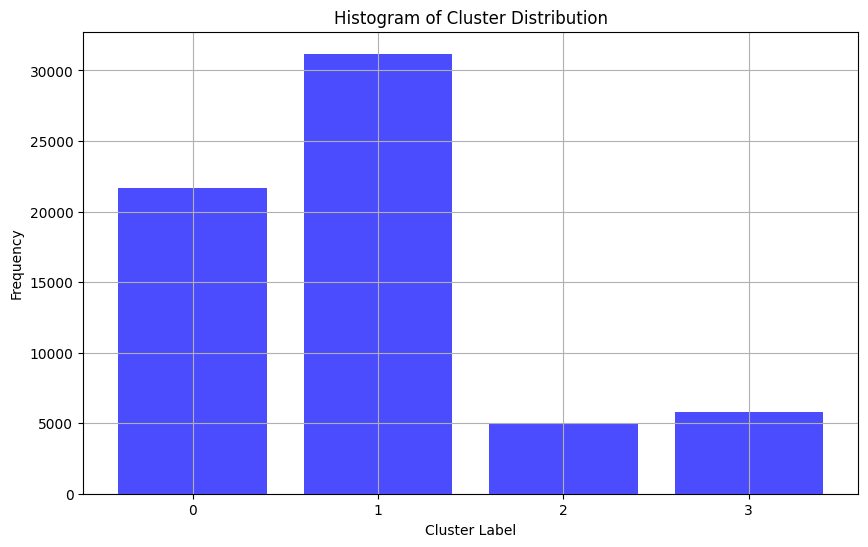

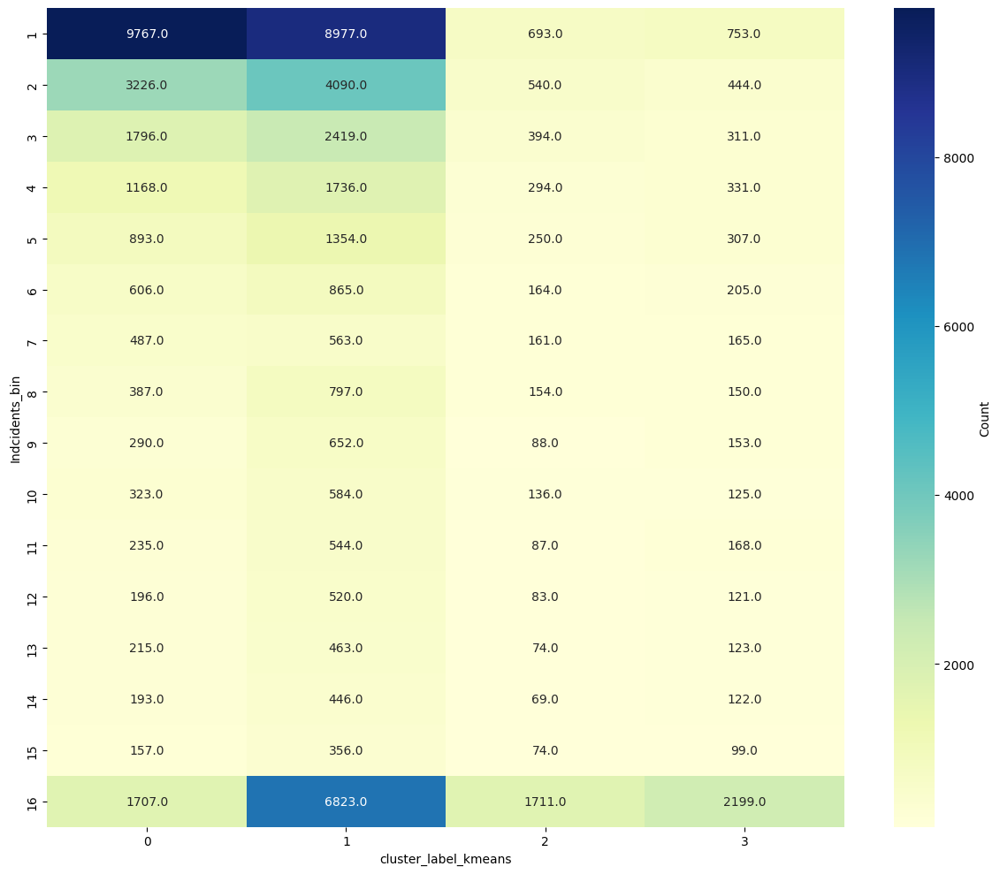

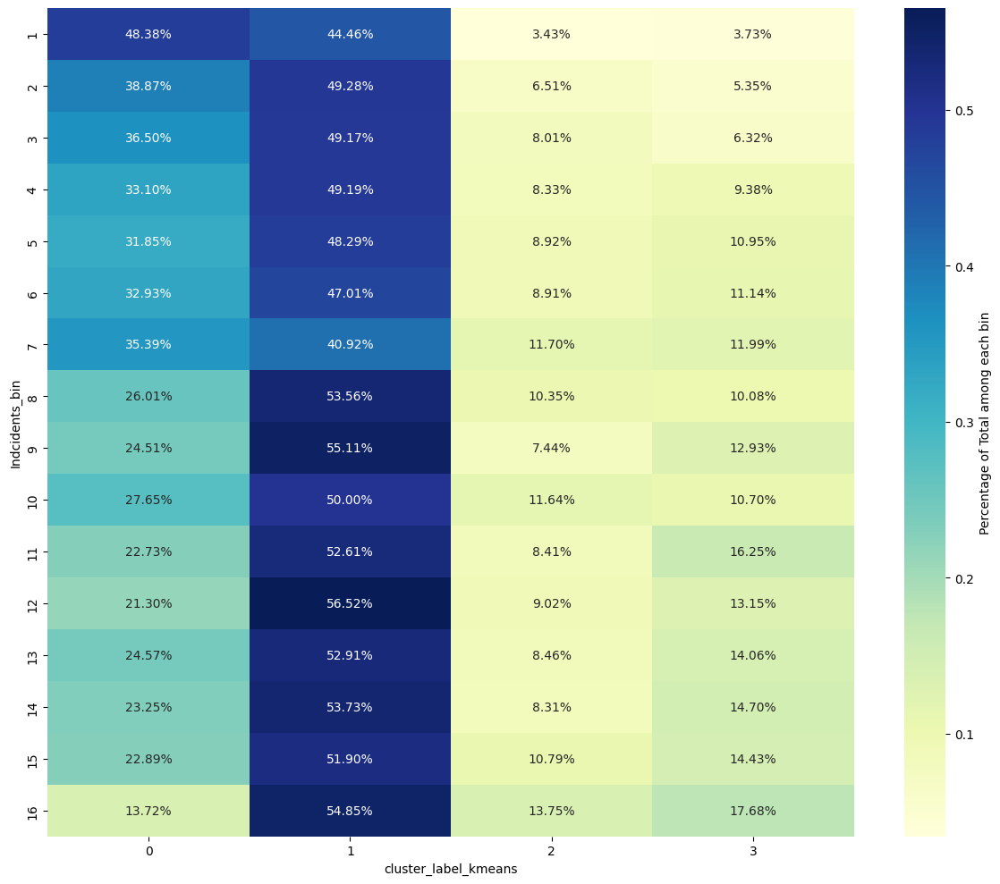

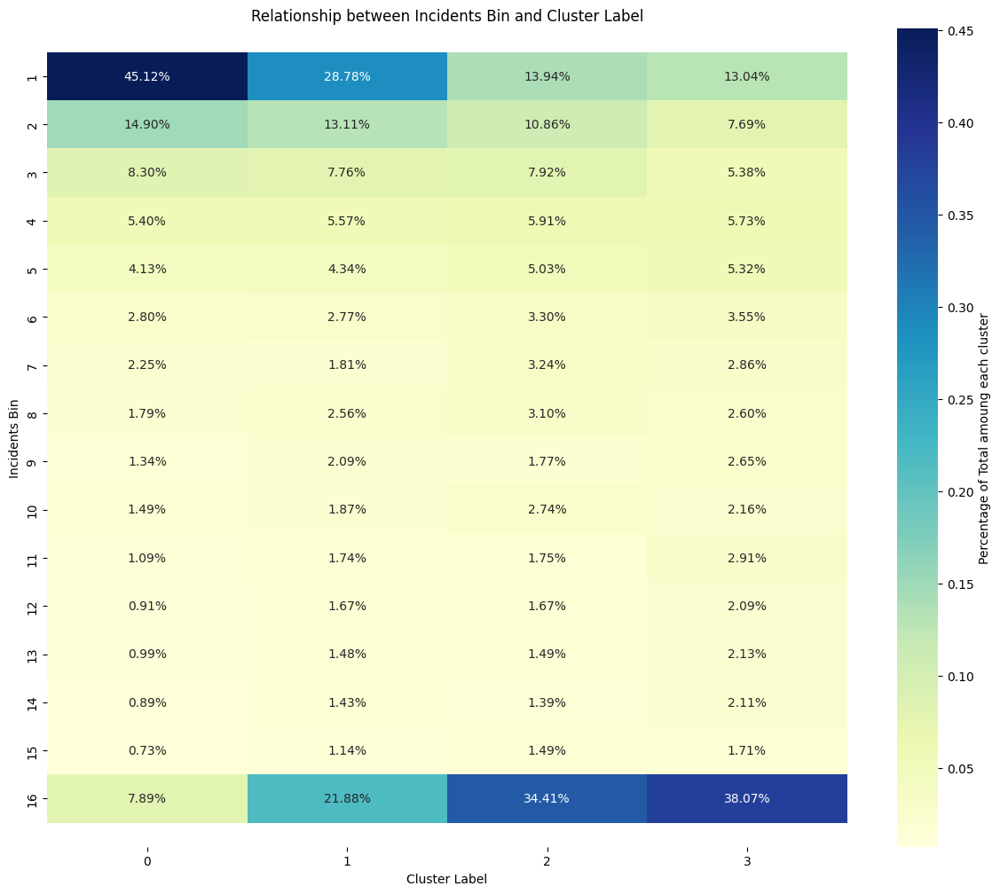

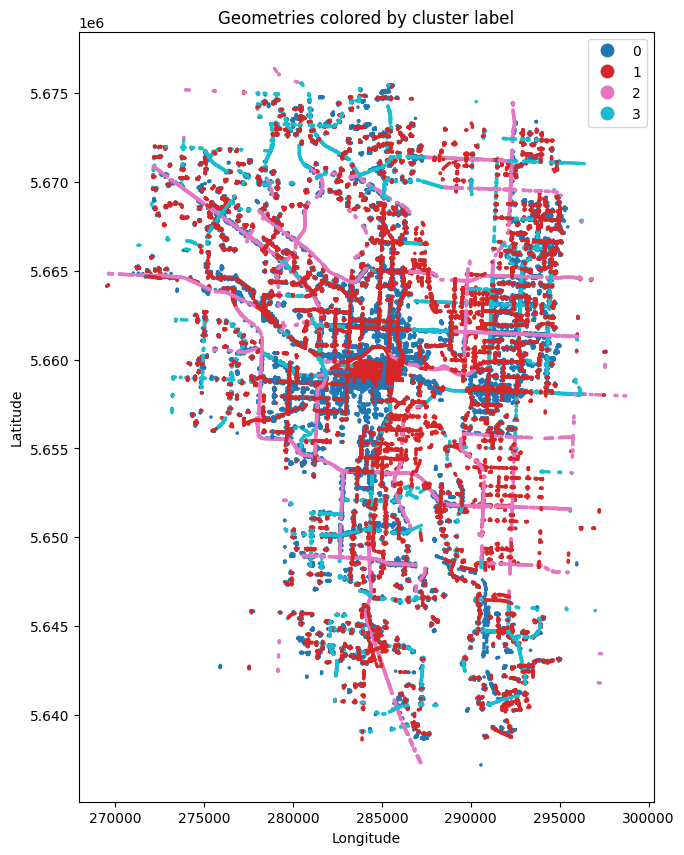


n_clusters 5


Most common attributes for Cluster:


C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni

,Cluster,SPEED_LIMIT_mode,SPEED_LIMIT_mean,SPEED_LIMIT_median,CROSSWALK_TYPE_SIGNALIZED_mode,CROSSWALK_TYPE_SIGNALIZED_mean,CROSSWALK_TYPE_SIGNALIZED_median
0,0,[40.0],39.964428,40.0,0,0.000000,0.0
1,1,[70.0],70.000000,70.0,0,0.000000,0.0
2,2,[50.0],50.000000,50.0,0,0.000000,0.0
3,3,[80.0],81.520972,80.0,0,0.000000,0.0
4,4,[60.0],60.000000,60.0,[1],0.518871,1.0


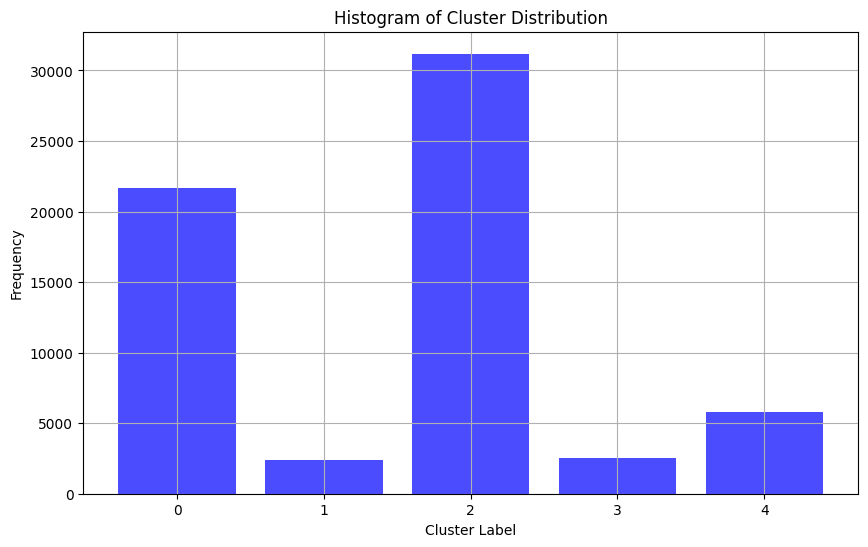

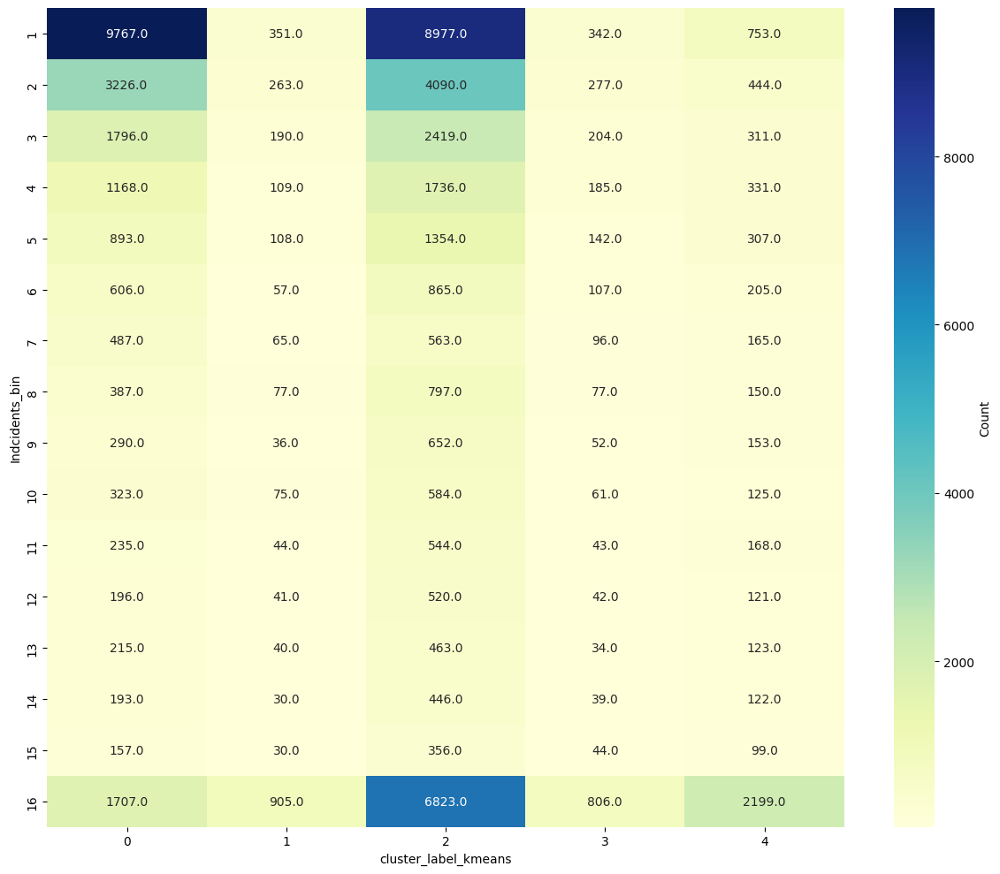

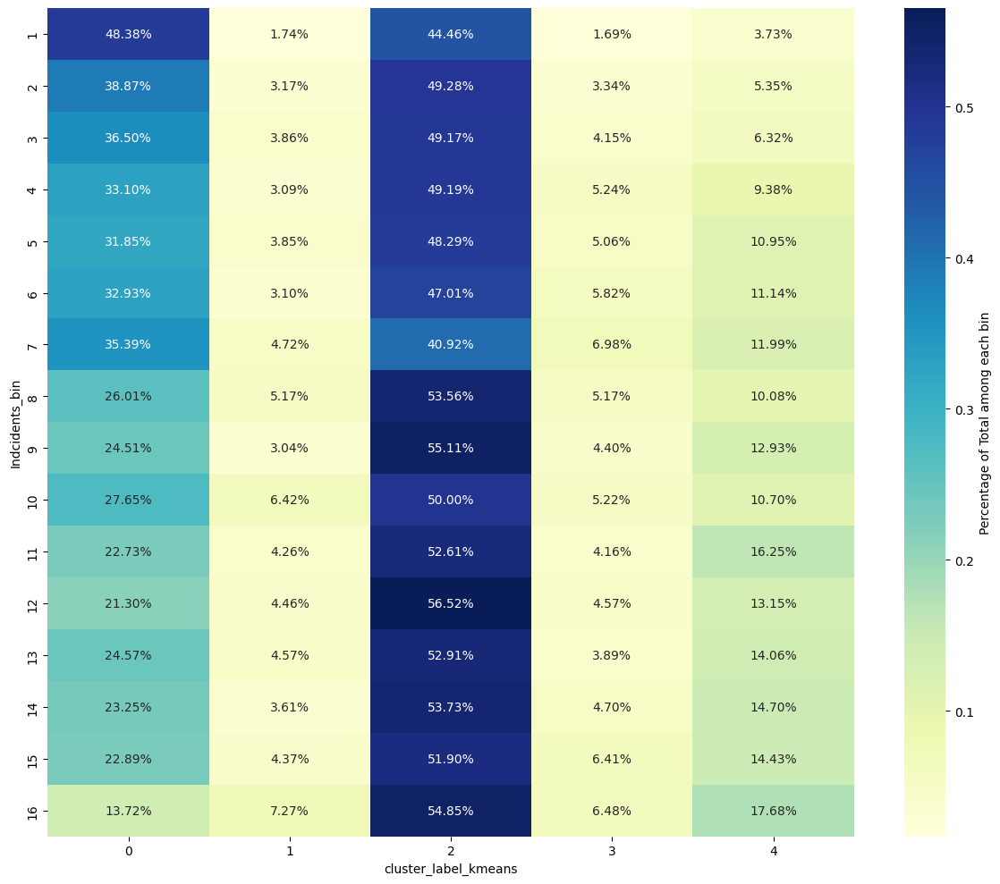

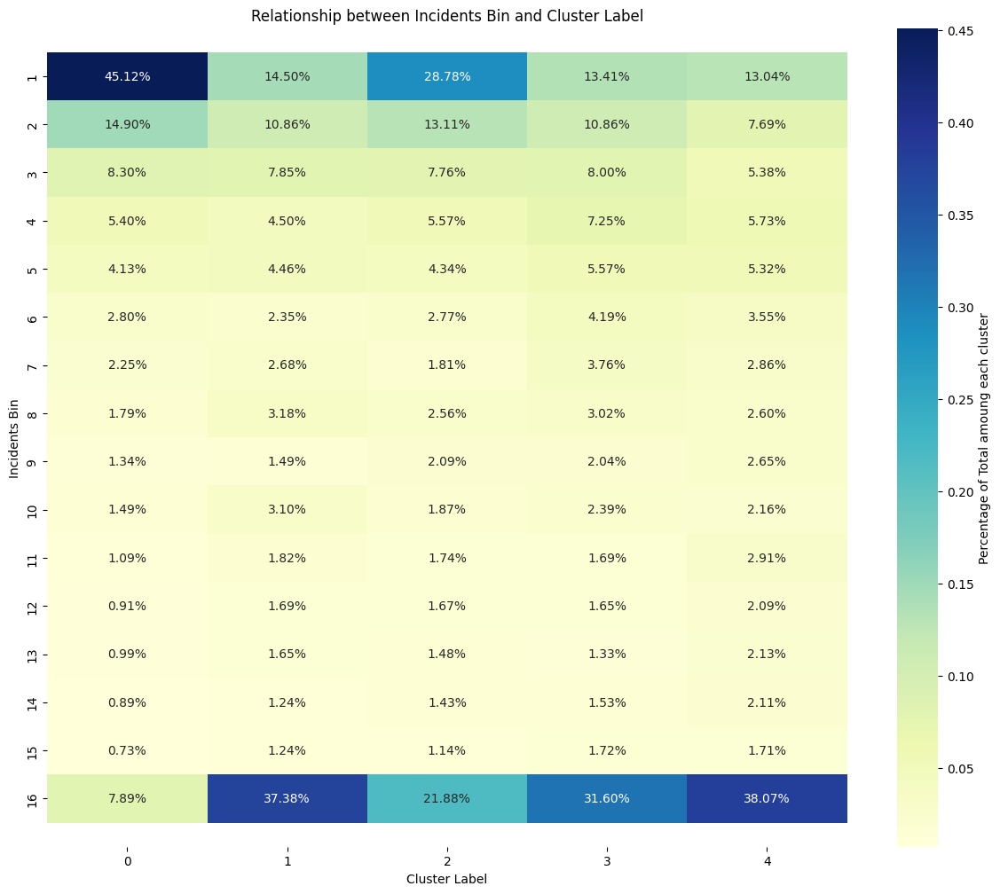

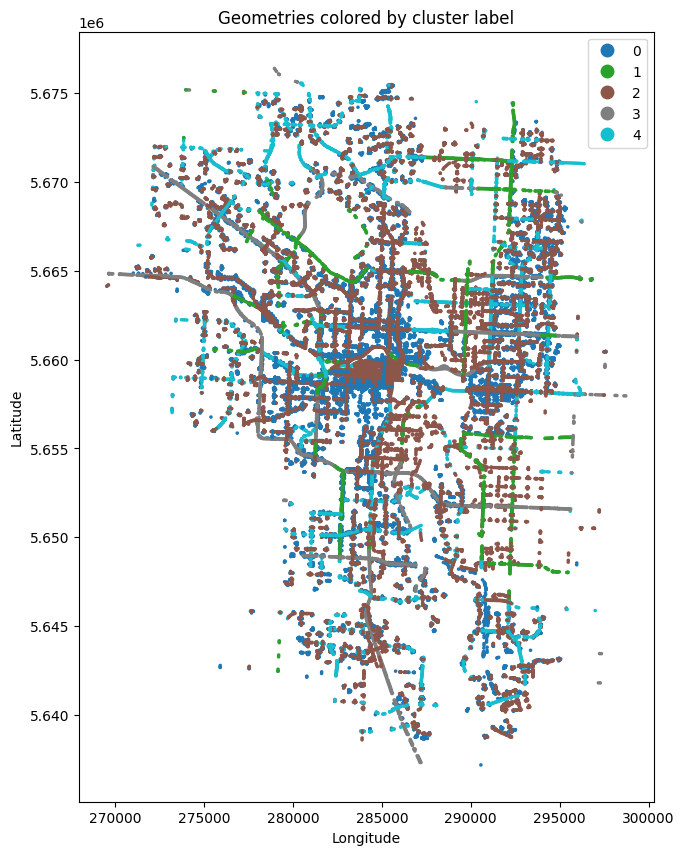


n_clusters 6


Most common attributes for Cluster:


C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni

,Cluster,SPEED_LIMIT_mode,SPEED_LIMIT_mean,SPEED_LIMIT_median,CROSSWALK_TYPE_SIGNALIZED_mode,CROSSWALK_TYPE_SIGNALIZED_mean,CROSSWALK_TYPE_SIGNALIZED_median,SIGN_TYPE_Flat_Sheet_mode,SIGN_TYPE_Flat_Sheet_mean,SIGN_TYPE_Flat_Sheet_median,Size_Category_Medium_mode,Size_Category_Medium_mean,Size_Category_Medium_median
0,0,[50.0],50.000000,50.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
1,1,[80.0],81.520972,80.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
2,2,[40.0],39.964403,40.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
3,3,[60.0],60.000000,60.0,[1],0.518871,1.0,0,0.000000,0.0,0,0.000000,0.0
4,4,[50.0],49.978112,50.0,[1],0.636364,1.0,[4],4.603969,4.0,[2],2.797607,2.0
5,5,[70.0],70.000000,70.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0


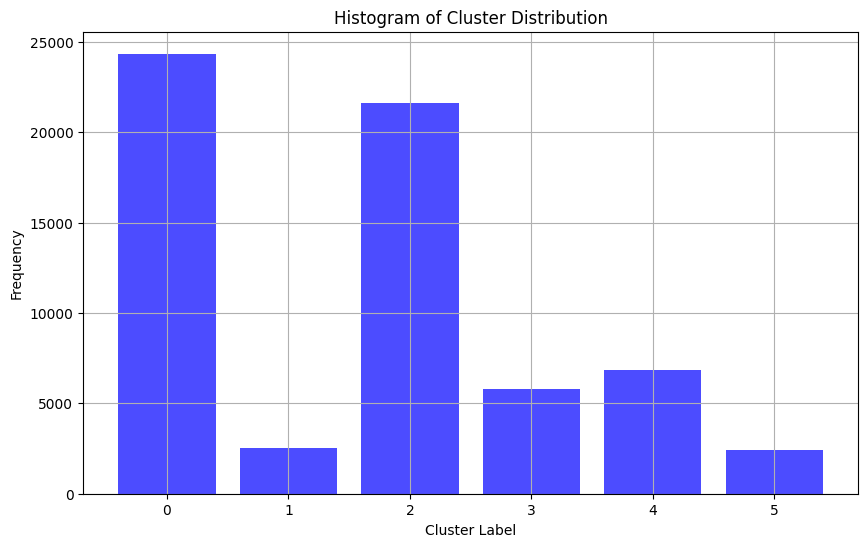

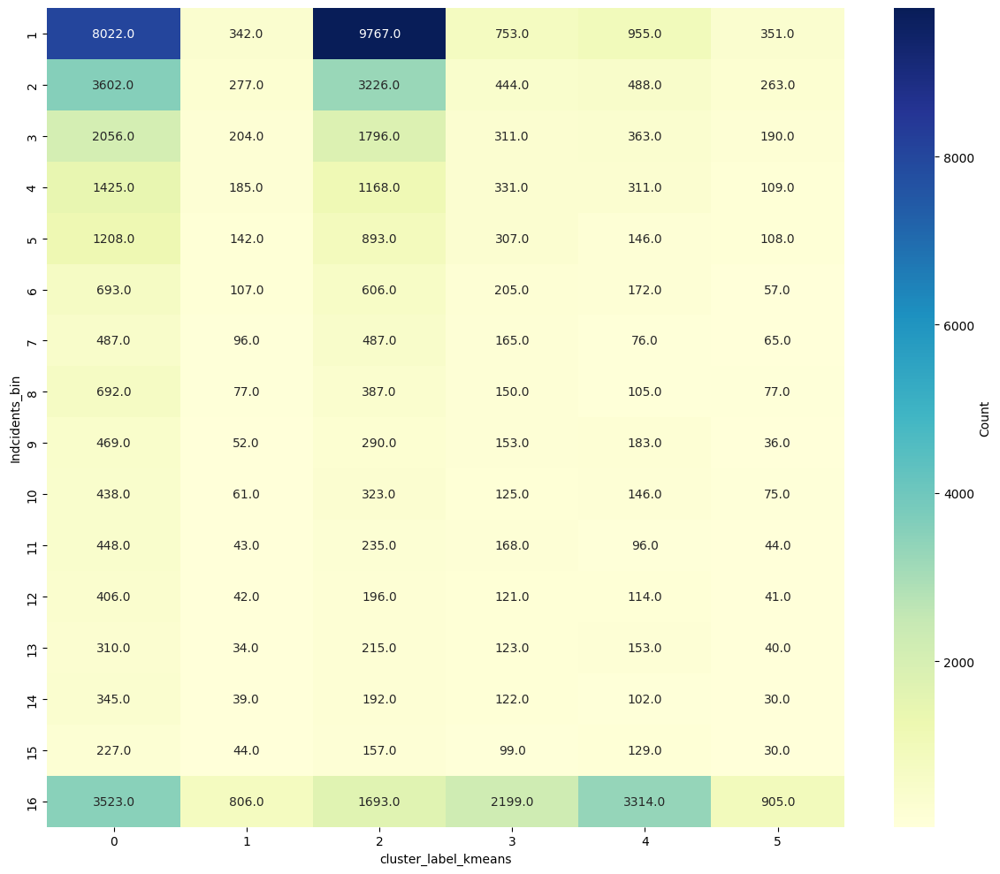

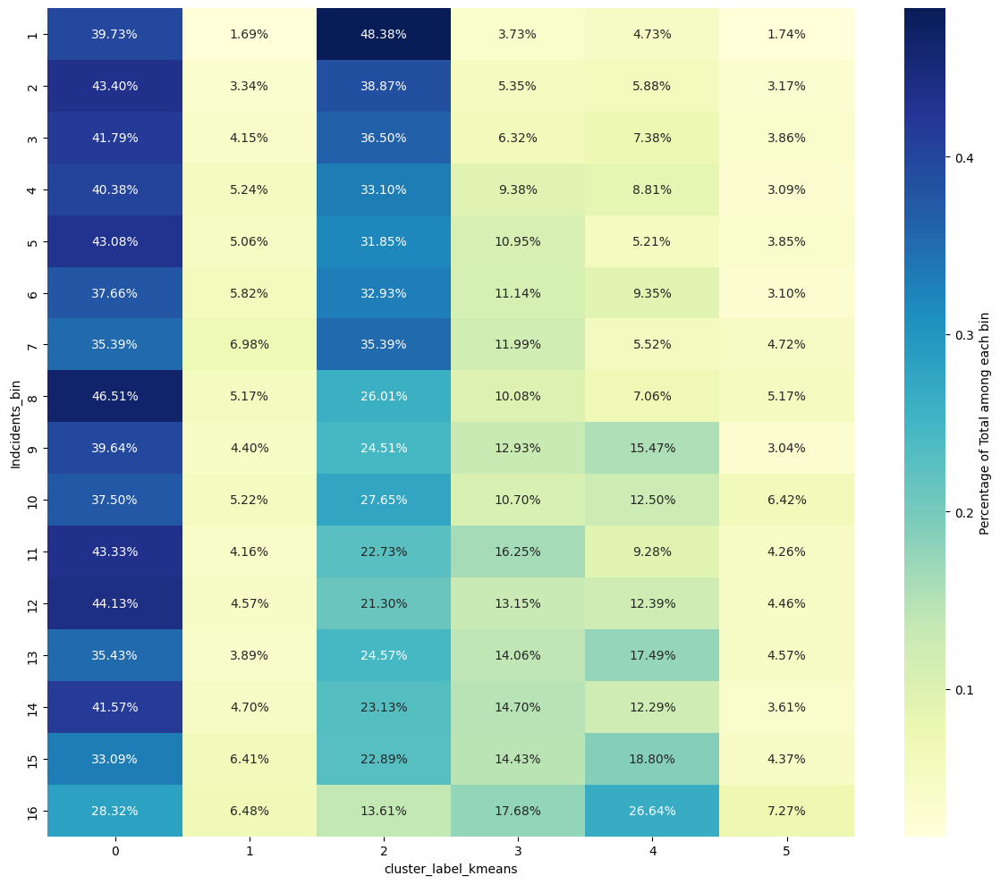

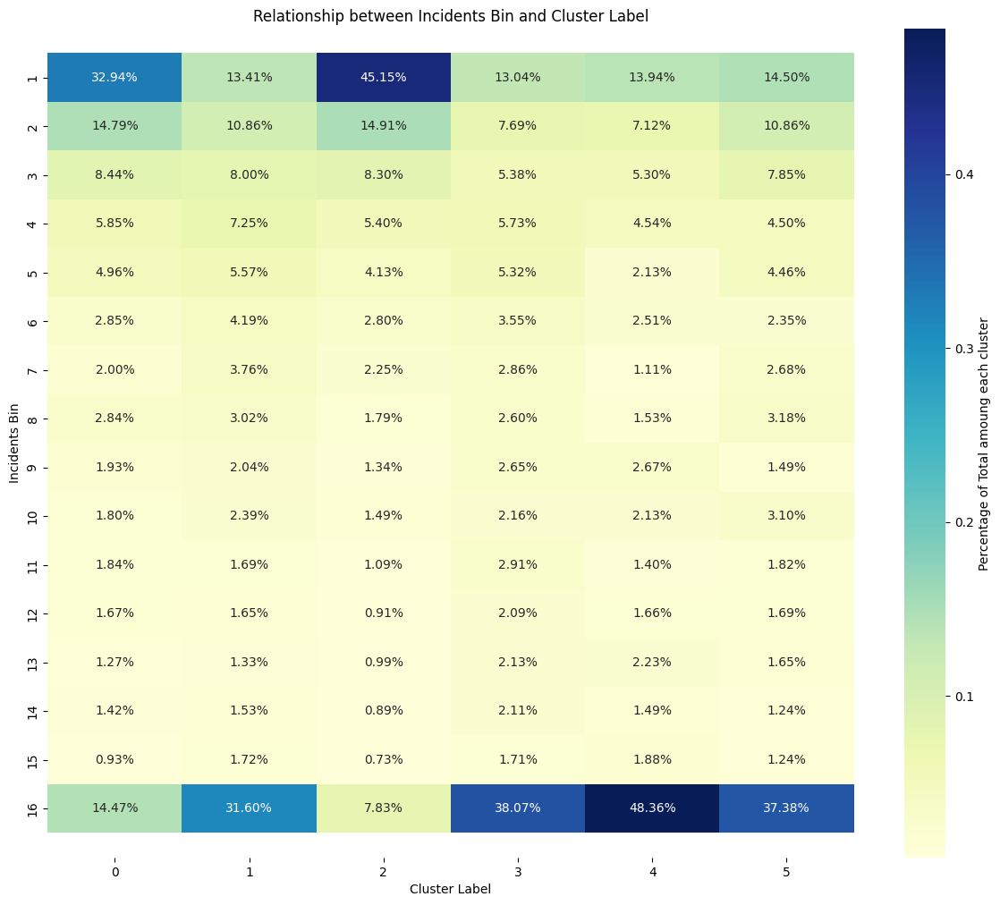

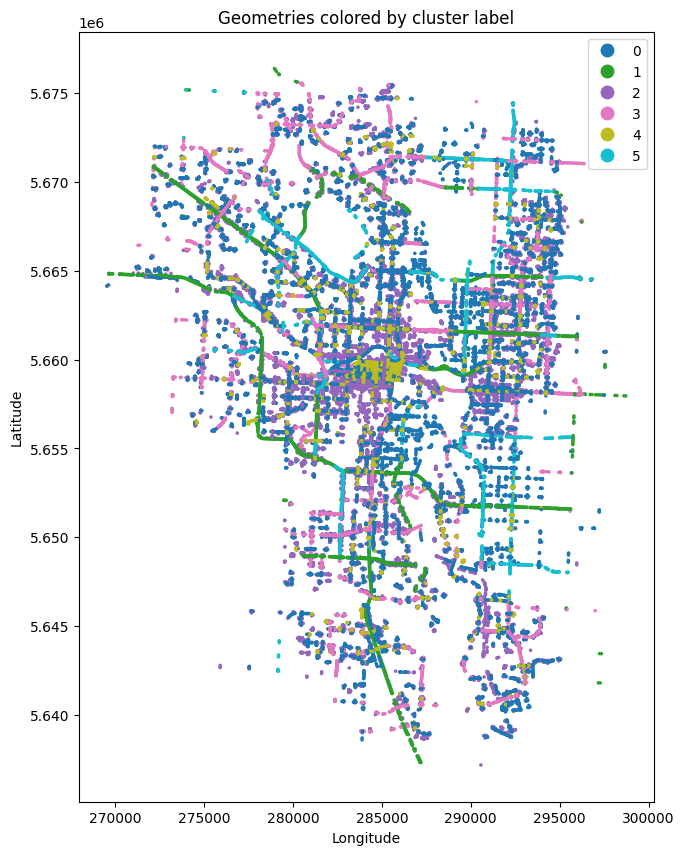


n_clusters 7


Most common attributes for Cluster:


C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni

,Cluster,SPEED_LIMIT_mode,SPEED_LIMIT_mean,SPEED_LIMIT_median,SIGN_TYPE_Flat_Sheet_mode,SIGN_TYPE_Flat_Sheet_mean,SIGN_TYPE_Flat_Sheet_median,Size_Category_Medium_mode,Size_Category_Medium_mean,Size_Category_Medium_median,CROSSWALK_TYPE_SIGNALIZED_mode,CROSSWALK_TYPE_SIGNALIZED_mean,CROSSWALK_TYPE_SIGNALIZED_median
0,0,[50.0],50.000000,50.0,[4],4.938456,4.0,[2],2.941949,3.0,[1],0.707585,1.0
1,1,[50.0],50.000000,50.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
2,2,[80.0],81.520972,80.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
3,3,[40.0],39.931193,40.0,[2],3.659895,4.0,[2],2.659567,2.0,0,0.000000,0.0
4,4,[70.0],70.000000,70.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
5,5,[60.0],60.000000,60.0,0,0.000000,0.0,0,0.000000,0.0,[1],0.518871,1.0
6,6,[40.0],39.969883,40.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0


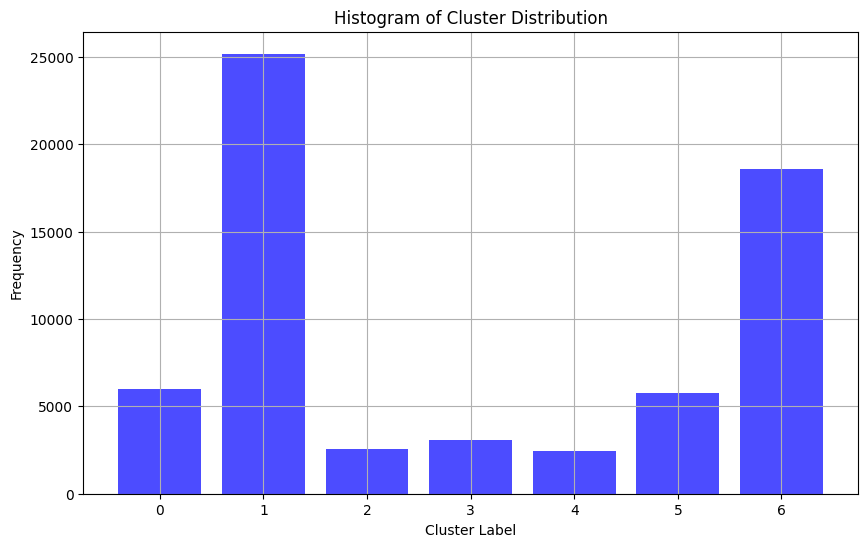

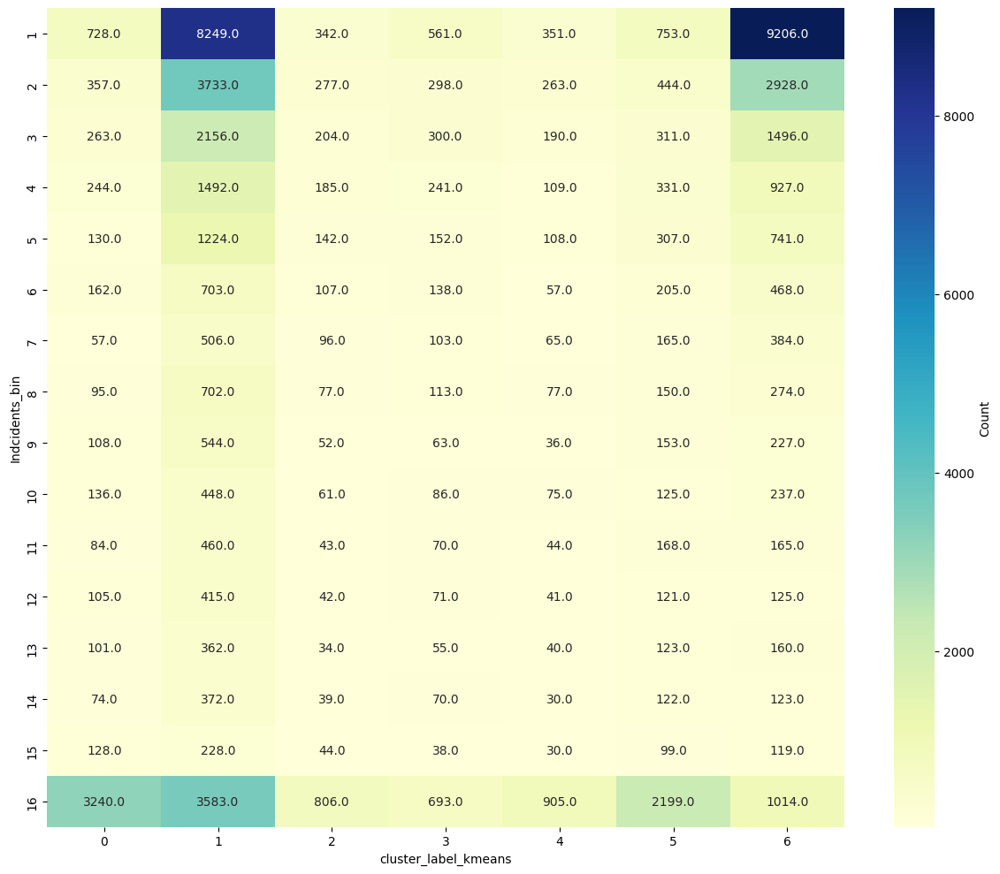

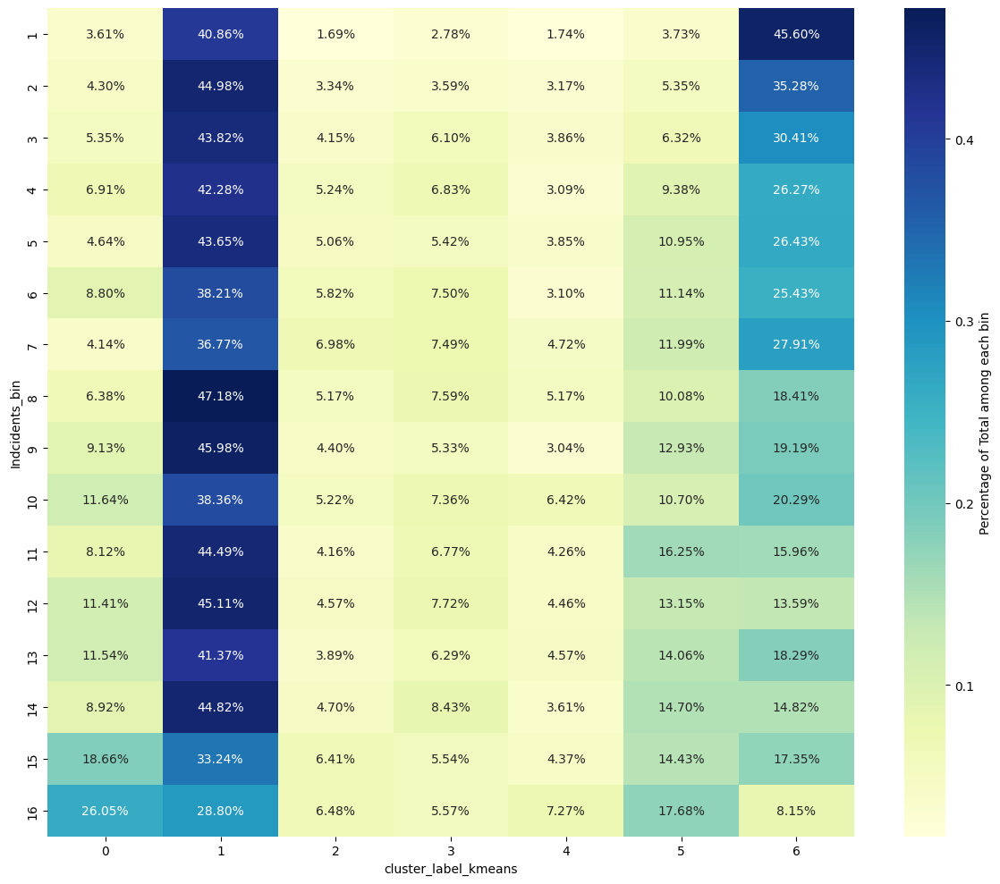

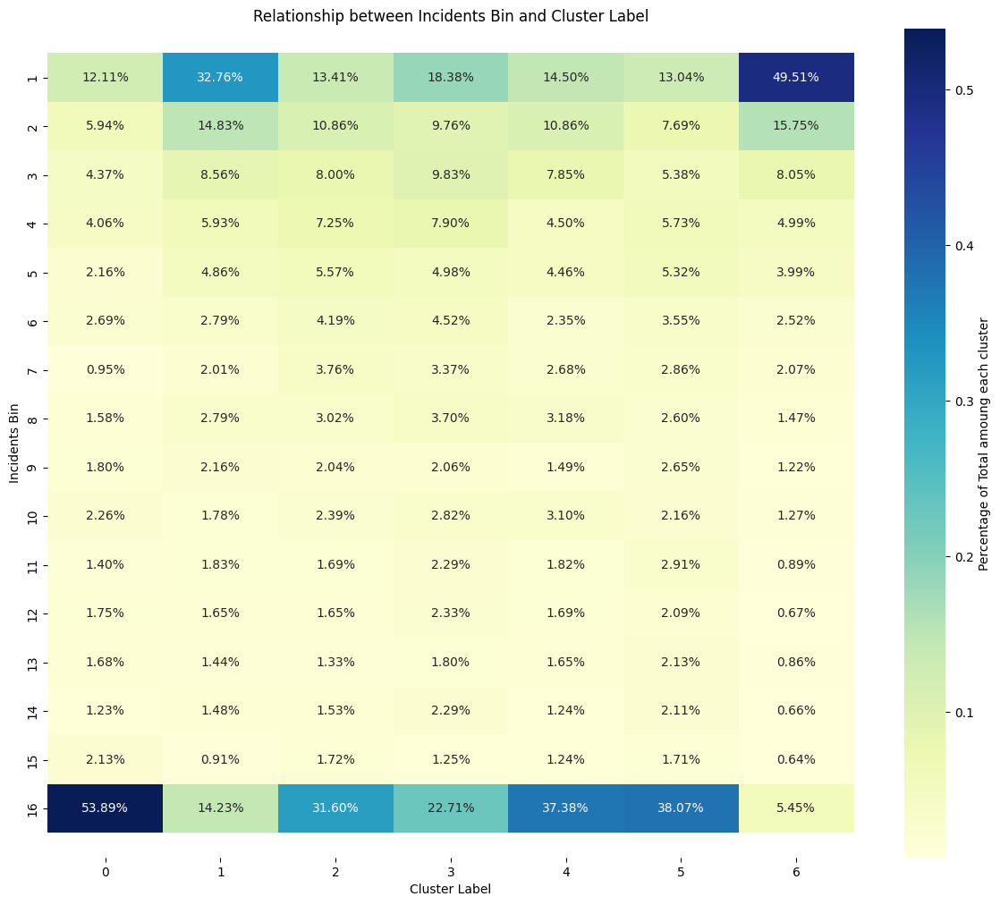

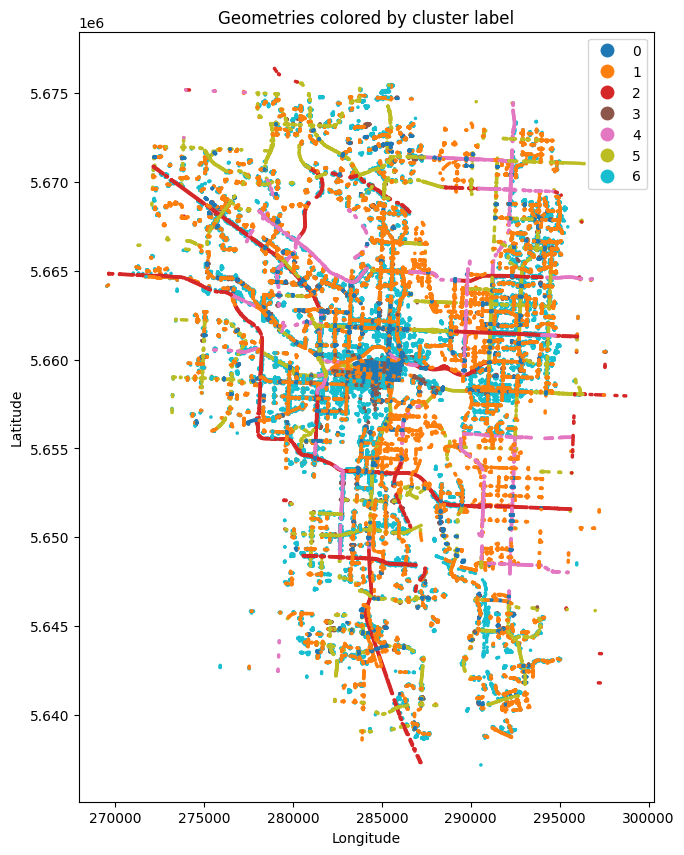


n_clusters 8


Most common attributes for Cluster:


C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni

,Cluster,SPEED_LIMIT_mode,SPEED_LIMIT_mean,SPEED_LIMIT_median,SIGN_TYPE_Flat_Sheet_mode,SIGN_TYPE_Flat_Sheet_mean,SIGN_TYPE_Flat_Sheet_median,Size_Category_Medium_mode,Size_Category_Medium_mean,Size_Category_Medium_median,Size_Category_Large_mode,Size_Category_Large_mean,Size_Category_Large_median,CROSSWALK_TYPE_SIGNALIZED_mode,CROSSWALK_TYPE_SIGNALIZED_mean,CROSSWALK_TYPE_SIGNALIZED_median
0,0,[40.0],39.969976,40.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
1,1,[70.0],70.000000,70.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
2,2,[50.0],50.000000,50.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
3,3,[60.0],60.029851,60.0,[4],5.068060,5.0,[2],2.695522,2.0,[3],2.430448,2.0,[1],0.851940,1.0
4,4,[50.0],50.000000,50.0,[4],4.586429,4.0,[2],2.796870,2.0,0,0.000000,0.0,[1],0.633665,1.0
5,5,[80.0],81.520972,80.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
6,6,[40.0],39.924840,40.0,[4],3.902292,4.0,[2],2.759865,2.0,[2],1.832018,2.0,0,0.000000,0.0
7,7,[60.0],60.000000,60.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0


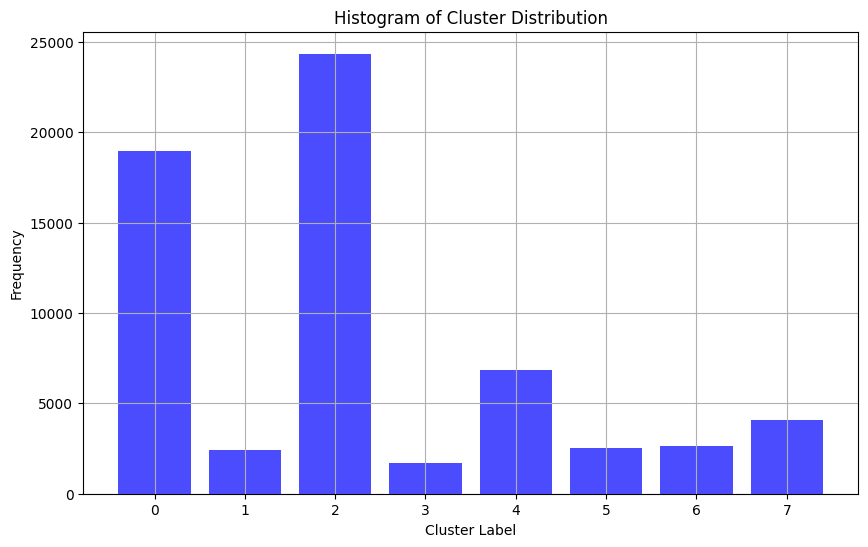

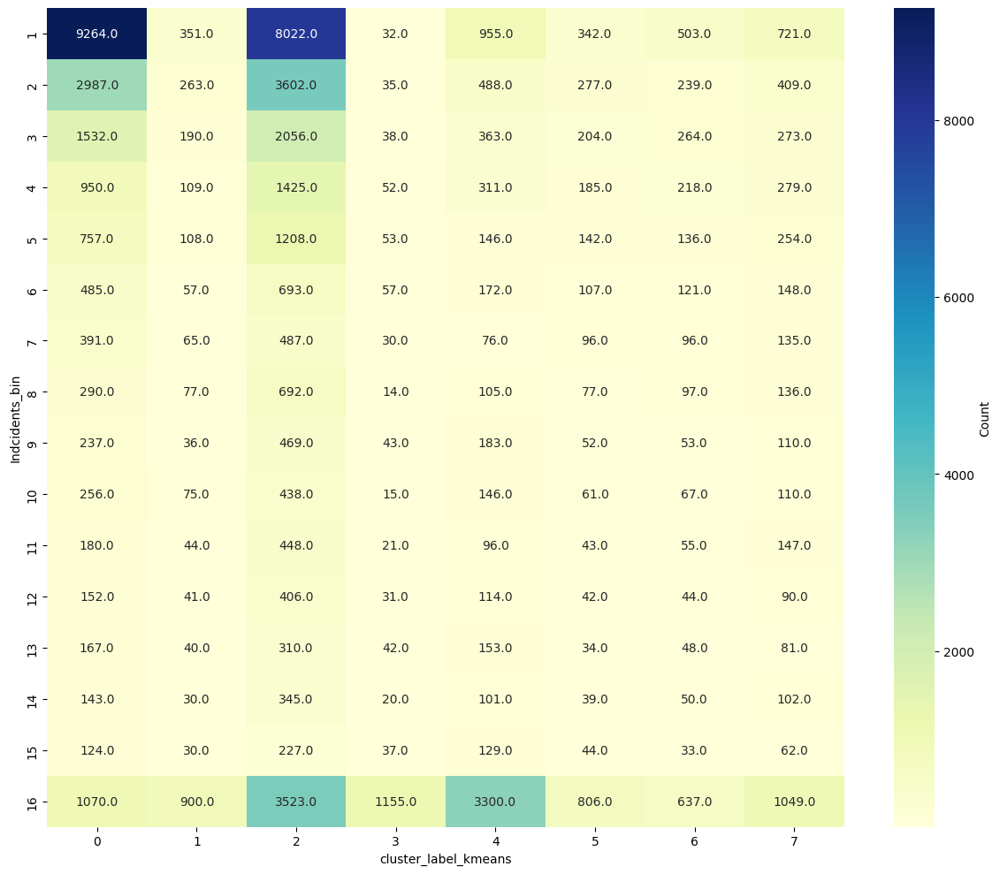

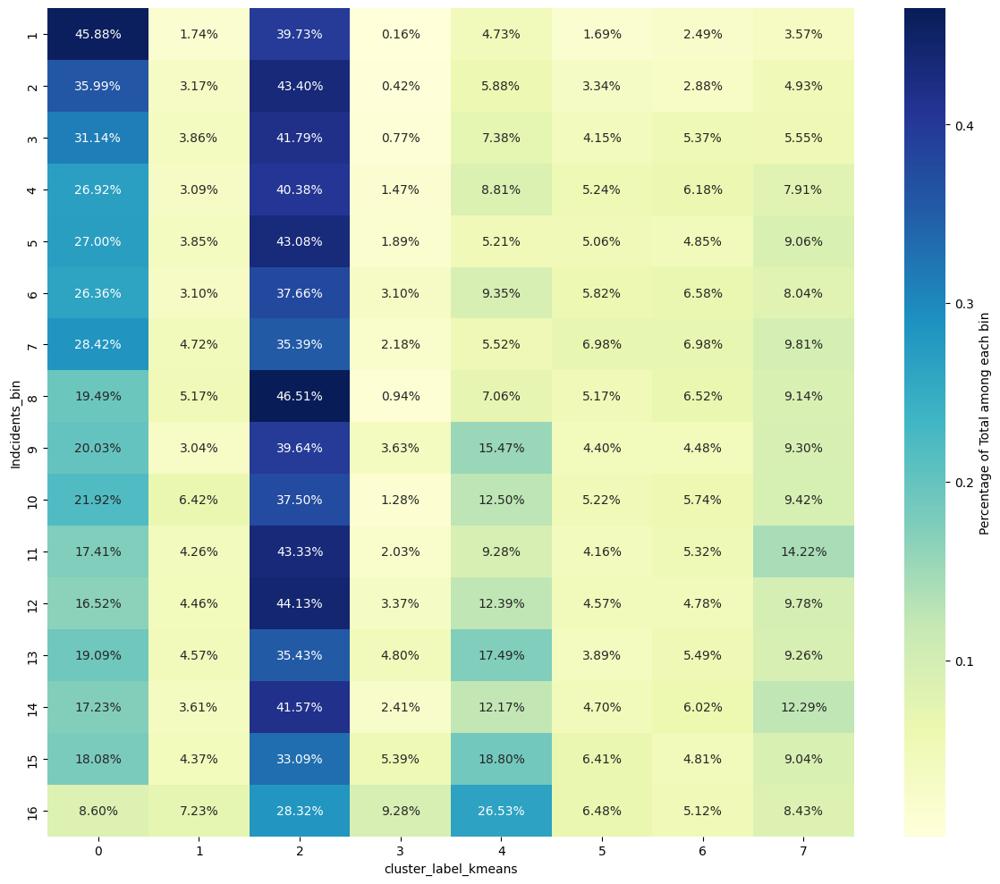

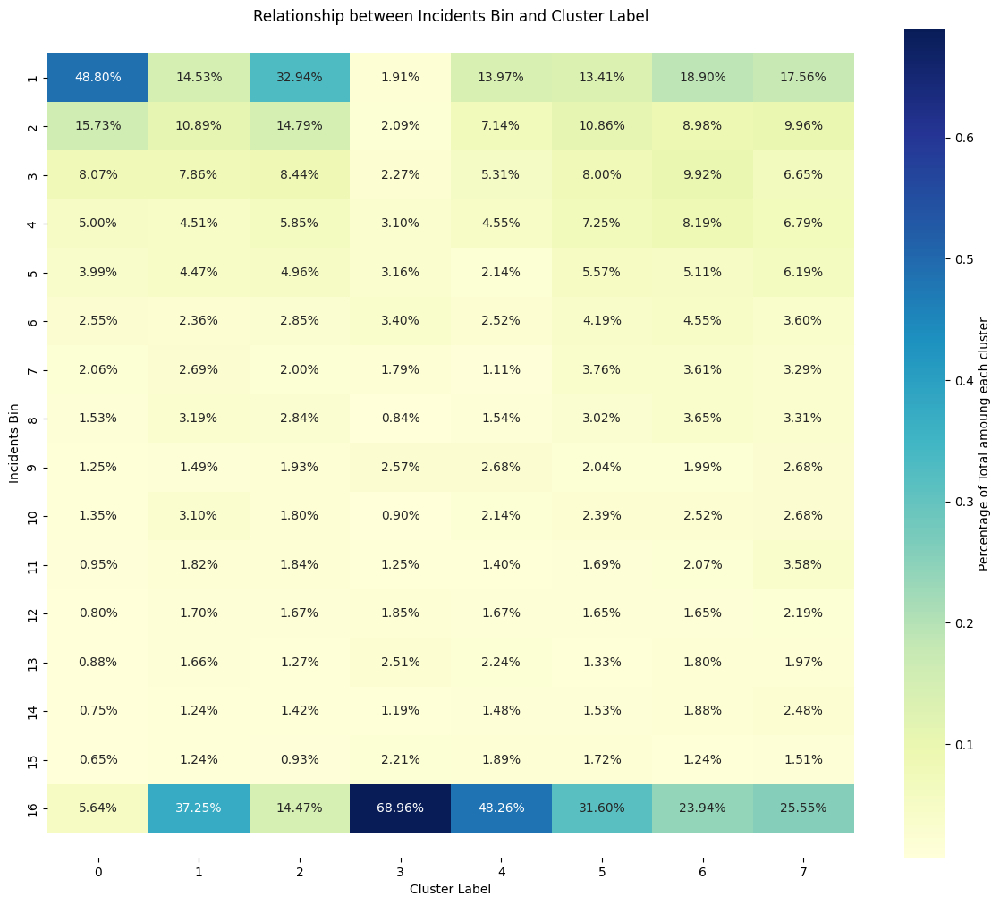

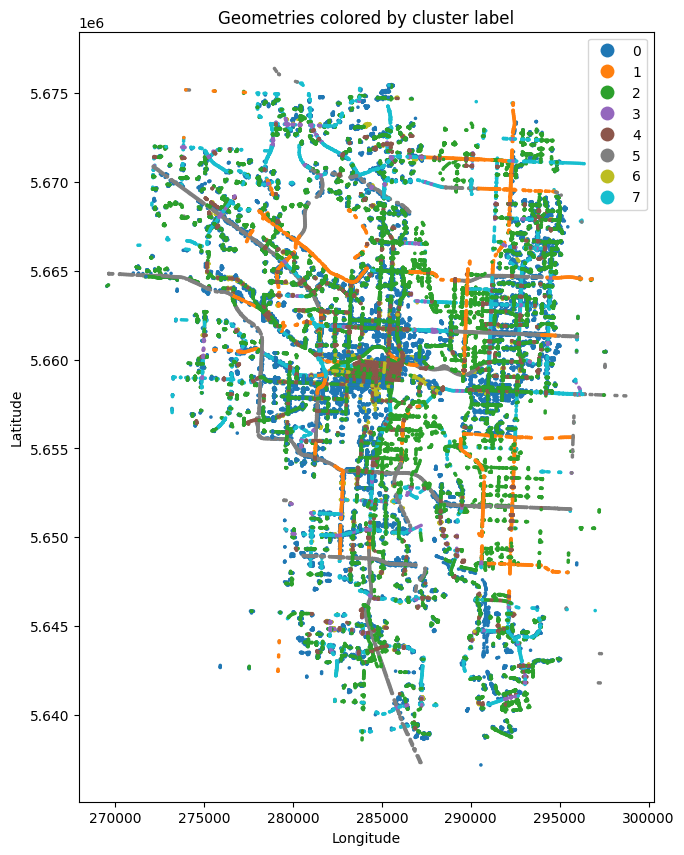


n_clusters 9



C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni


Most common attributes for Cluster:


,Cluster,SPEED_LIMIT_mode,SPEED_LIMIT_mean,SPEED_LIMIT_median,SIGN_TYPE_Flat_Sheet_mode,SIGN_TYPE_Flat_Sheet_mean,SIGN_TYPE_Flat_Sheet_median,Size_Category_Medium_mode,Size_Category_Medium_mean,Size_Category_Medium_median,CROSSWALK_TYPE_SIGNALIZED_mode,CROSSWALK_TYPE_SIGNALIZED_mean,CROSSWALK_TYPE_SIGNALIZED_median
0,0,[60.0],60.000000,60.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
1,1,[50.0],50.000000,50.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
2,2,[40.0],39.969883,40.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
3,3,[80.0],80.792438,80.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
4,4,[70.0],70.000000,70.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
5,5,[50.0],50.000000,50.0,[4],4.586429,4.0,[2],2.796870,2.0,[1],0.633665,1.0
6,6,[60.0],60.038700,60.0,[4],5.681115,5.0,[2],3.076625,3.0,[1],0.857585,1.0
7,7,[110.0],109.384615,110.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
8,8,[40.0],39.931193,40.0,[2],3.659895,4.0,[2],2.659567,2.0,0,0.000000,0.0


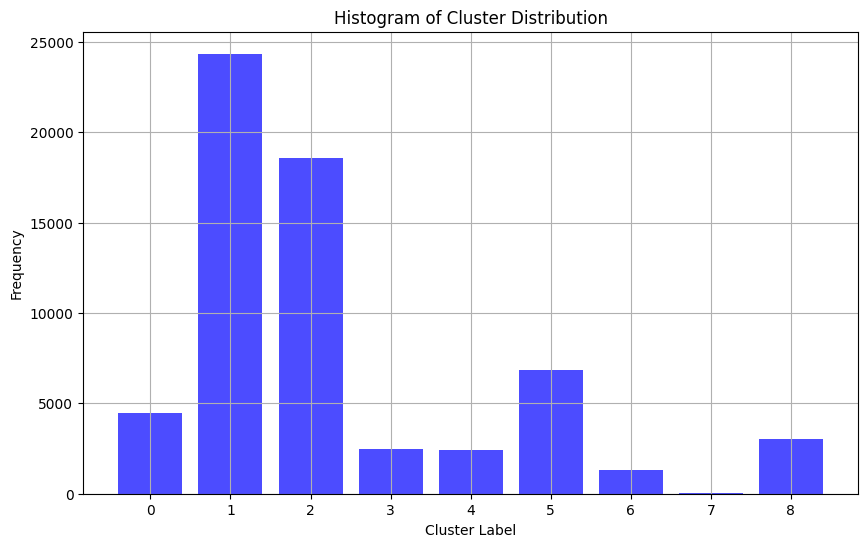

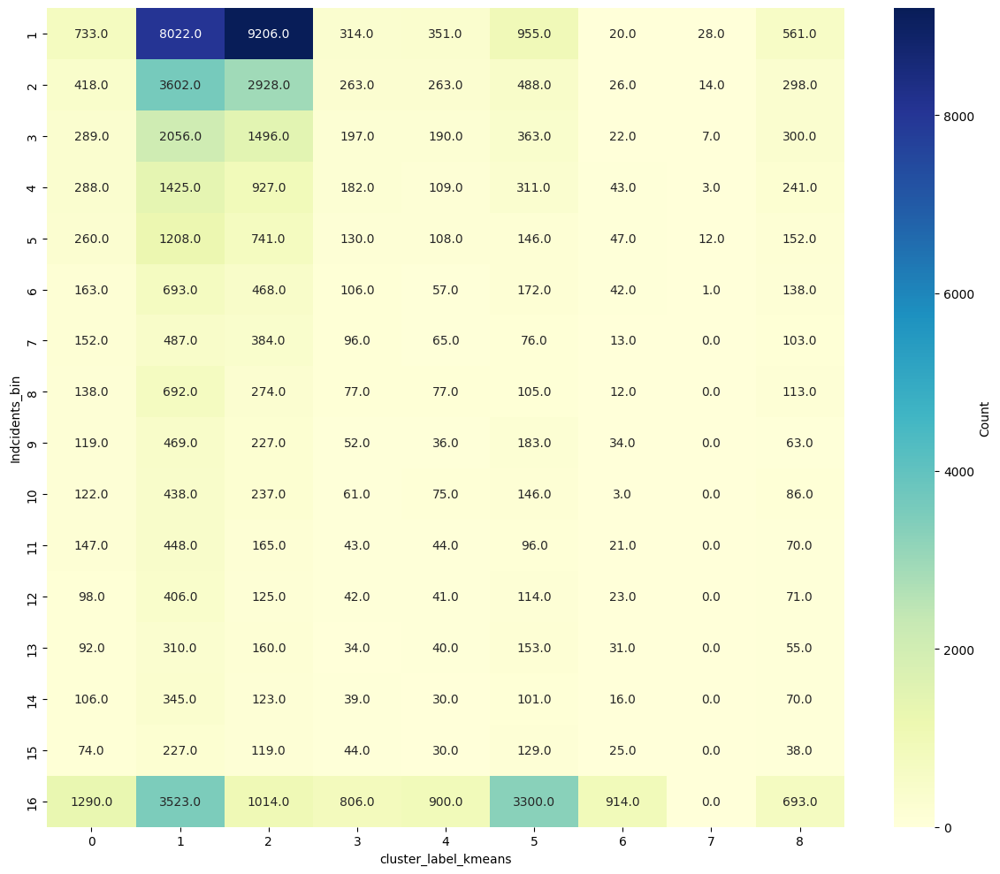

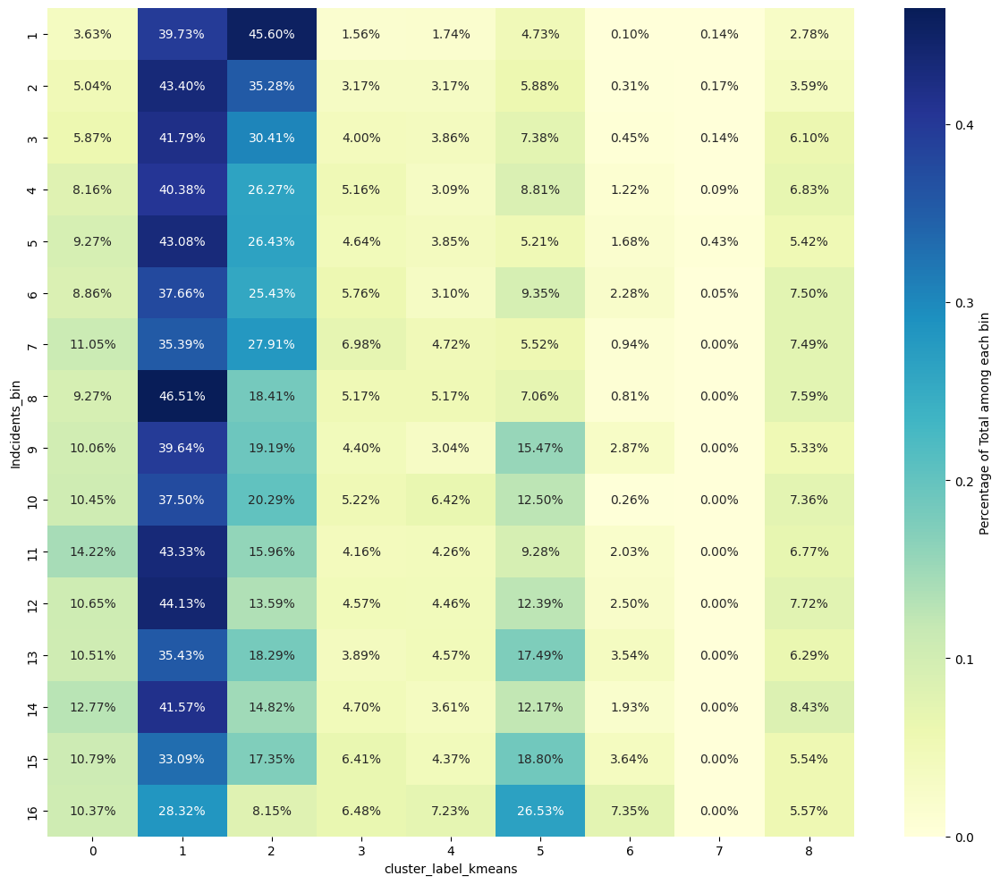

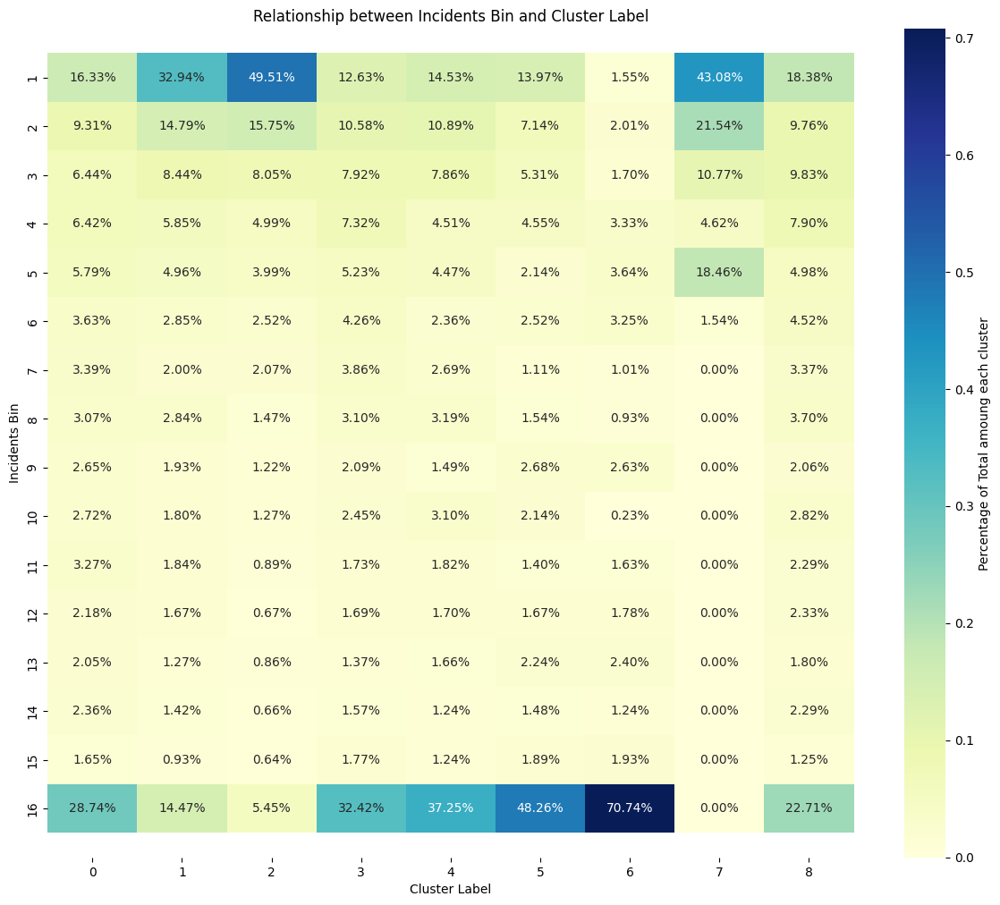

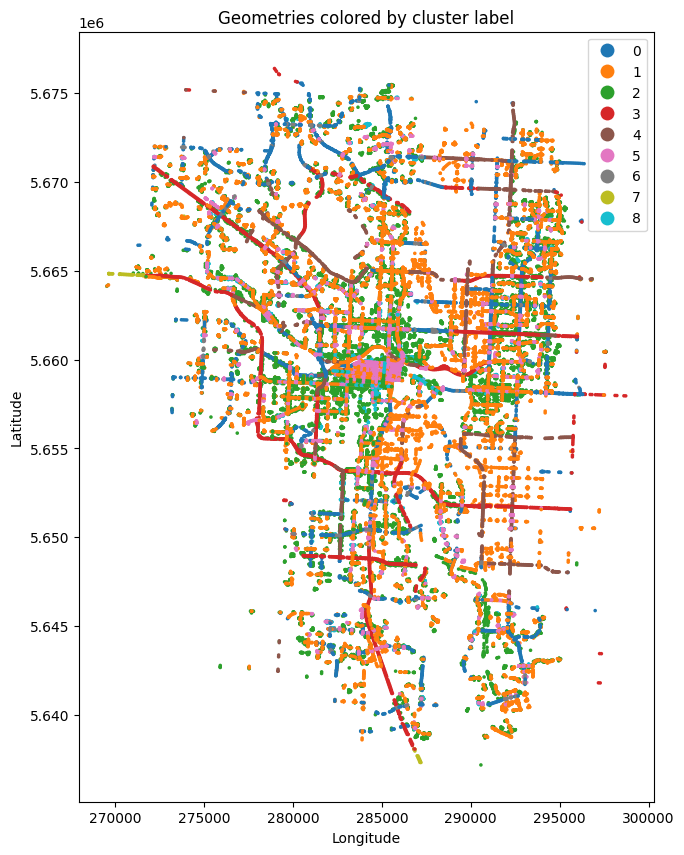


n_clusters 10


Most common attributes for Cluster:


C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni

,Cluster,SPEED_LIMIT_mode,SPEED_LIMIT_mean,SPEED_LIMIT_median,SIGN_TYPE_Flat_Sheet_mode,SIGN_TYPE_Flat_Sheet_mean,SIGN_TYPE_Flat_Sheet_median,Size_Category_Medium_mode,Size_Category_Medium_mean,Size_Category_Medium_median,Size_Category_Large_mode,Size_Category_Large_mean,Size_Category_Large_median,CROSSWALK_TYPE_SIGNALIZED_mode,CROSSWALK_TYPE_SIGNALIZED_mean,CROSSWALK_TYPE_SIGNALIZED_median
0,0,[50.0],50.000000,50.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
1,1,[40.0],39.969883,40.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
2,2,[80.0],80.792438,80.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
3,3,[60.0],60.029851,60.0,[4],5.068060,5.0,[2],2.695522,2.0,[3],2.430448,2.0,[1],0.851940,1.0
4,4,[70.0],70.000000,70.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
5,5,[50.0],50.000000,50.0,[7],6.761814,7.0,[2],2.649165,2.0,[4],4.308353,4.0,[1],0.938425,1.0
6,6,[50.0],50.000000,50.0,[2],3.266097,3.0,[2],2.620729,2.0,0,0.000000,0.0,[1],0.544514,1.0
7,7,[60.0],60.000000,60.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
8,8,[110.0],109.384615,110.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
9,9,[40.0],39.931193,40.0,[2],3.659895,4.0,[2],2.659567,2.0,0,0.000000,0.0,0,0.000000,0.0


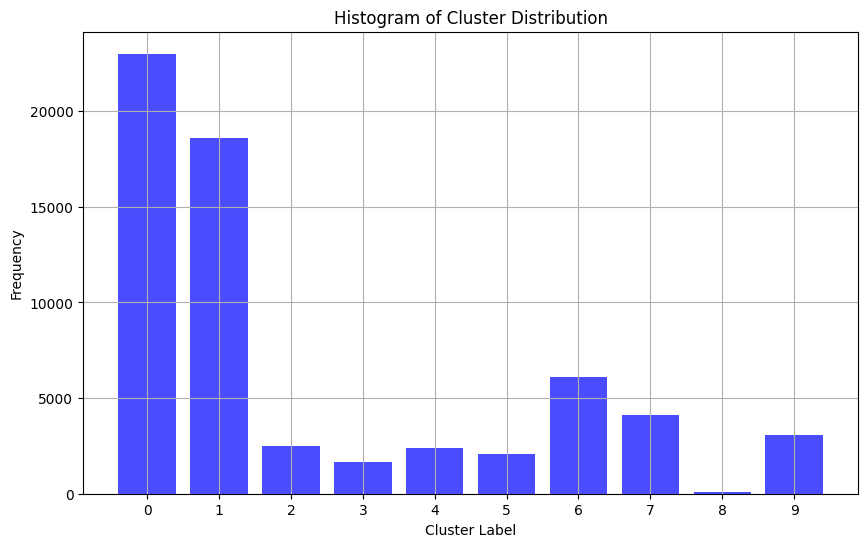

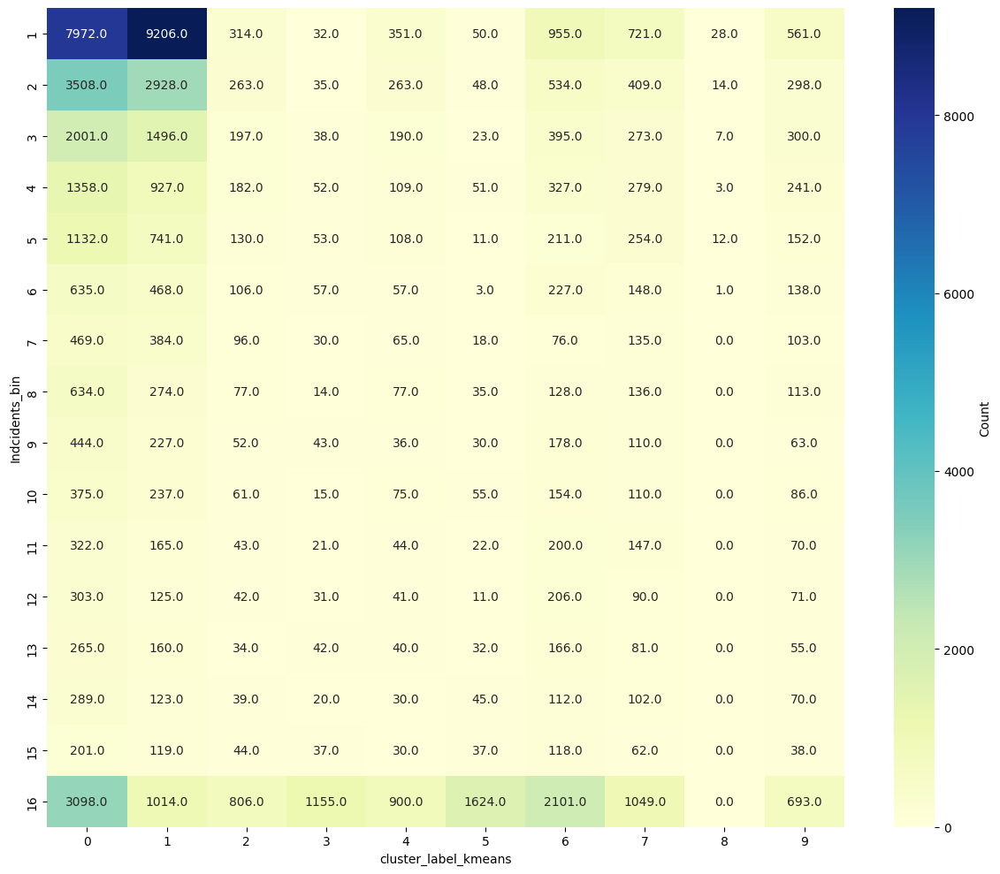

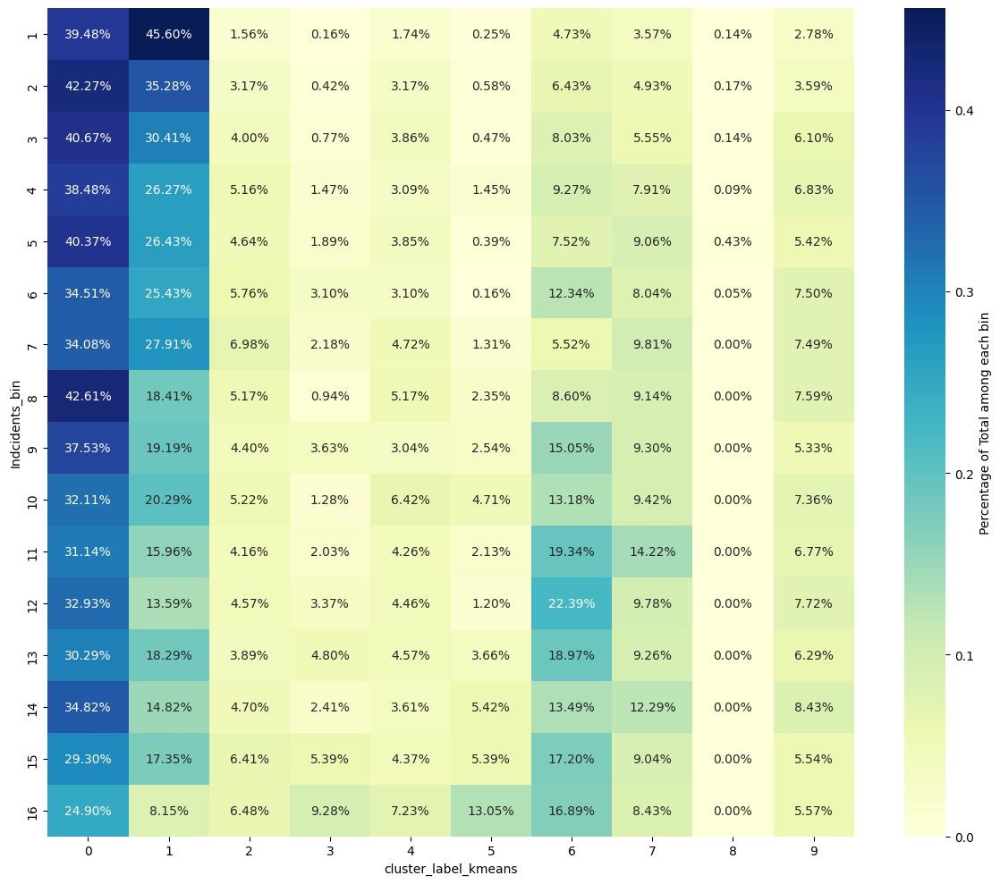

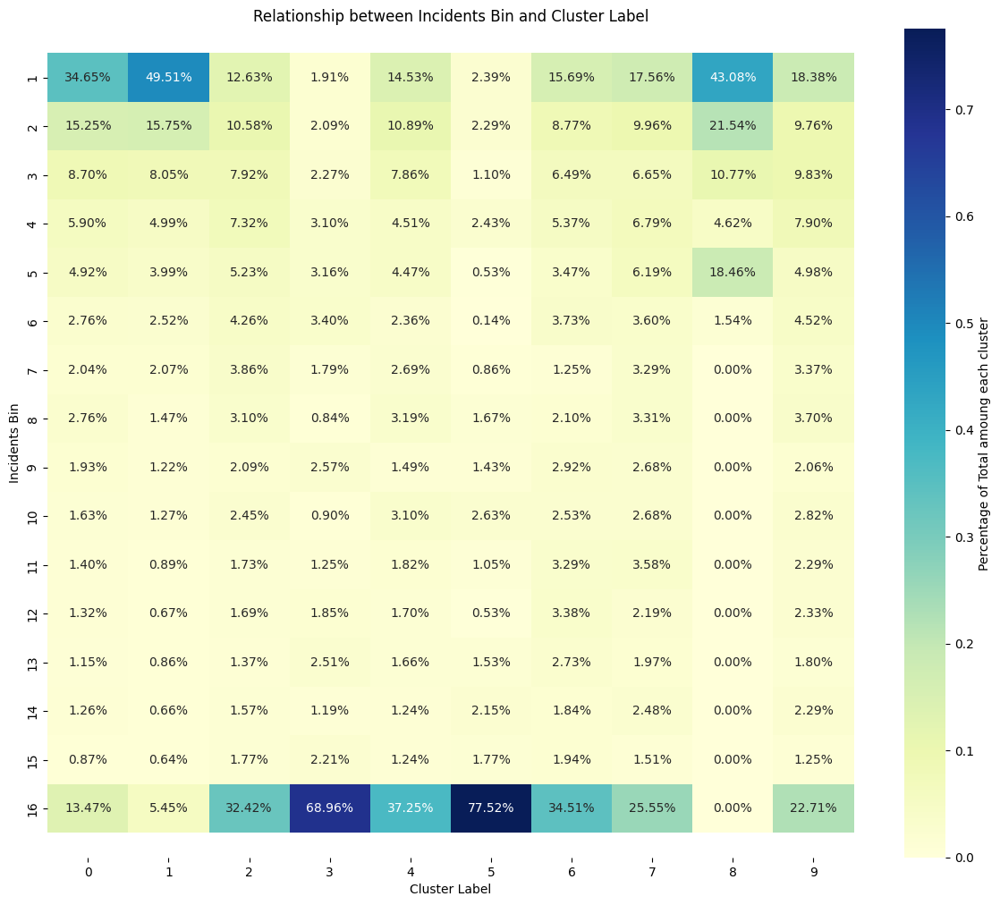

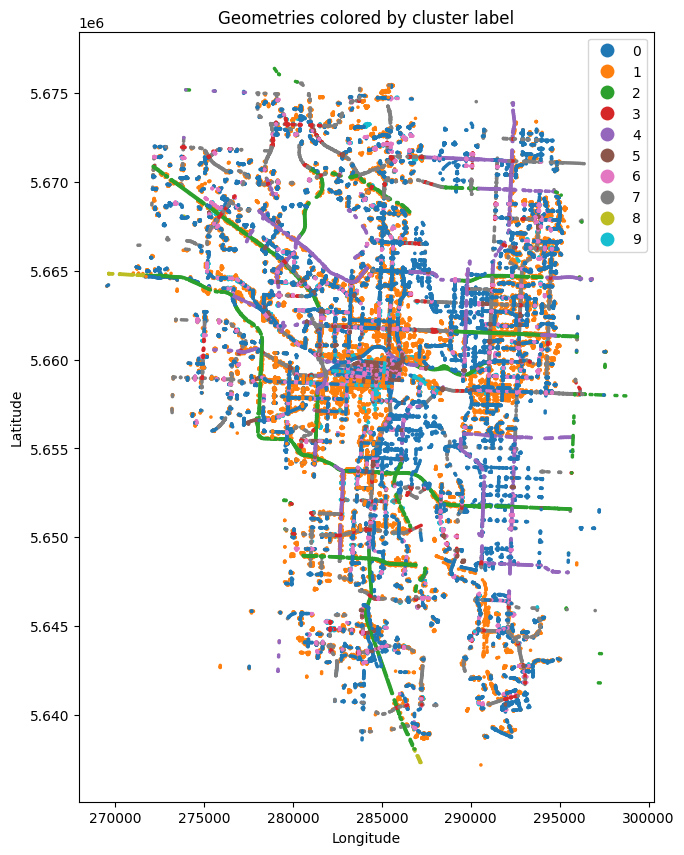


n_clusters 11


Most common attributes for Cluster:


C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni

,Cluster,SPEED_LIMIT_mode,SPEED_LIMIT_mean,SPEED_LIMIT_median,SIGN_TYPE_Flat_Sheet_mode,SIGN_TYPE_Flat_Sheet_mean,SIGN_TYPE_Flat_Sheet_median,Size_Category_Medium_mode,Size_Category_Medium_mean,Size_Category_Medium_median,Size_Category_Large_mode,Size_Category_Large_mean,Size_Category_Large_median,CROSSWALK_TYPE_SIGNALIZED_mode,CROSSWALK_TYPE_SIGNALIZED_mean,CROSSWALK_TYPE_SIGNALIZED_median
0,0,[50.0],50.000000,50.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
1,1,[80.0],80.792438,80.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
2,2,[40.0],39.933418,40.0,[2],3.564363,3.0,[2],2.597654,2.0,0,0.000000,0.0,0,0.000000,0.0
3,3,[60.0],60.029851,60.0,[4],5.068060,5.0,[2],2.695522,2.0,[3],2.430448,2.0,[1],0.851940,1.0
4,4,[70.0],70.000000,70.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
5,5,[50.0],50.000000,50.0,[4],4.667923,4.0,[4],4.320769,4.0,0,0.000000,0.0,0,0.000000,0.0
6,6,[60.0],60.000000,60.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
7,7,[50.0],50.000000,50.0,[2],2.445722,2.0,[2],1.330566,2.0,[2],1.654534,2.0,[1],0.602597,1.0
8,8,[40.0],39.969697,40.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
9,9,[50.0],49.929245,50.0,[7],6.955189,7.0,[2],2.379127,2.0,[5],4.777123,5.0,[1],0.955189,1.0


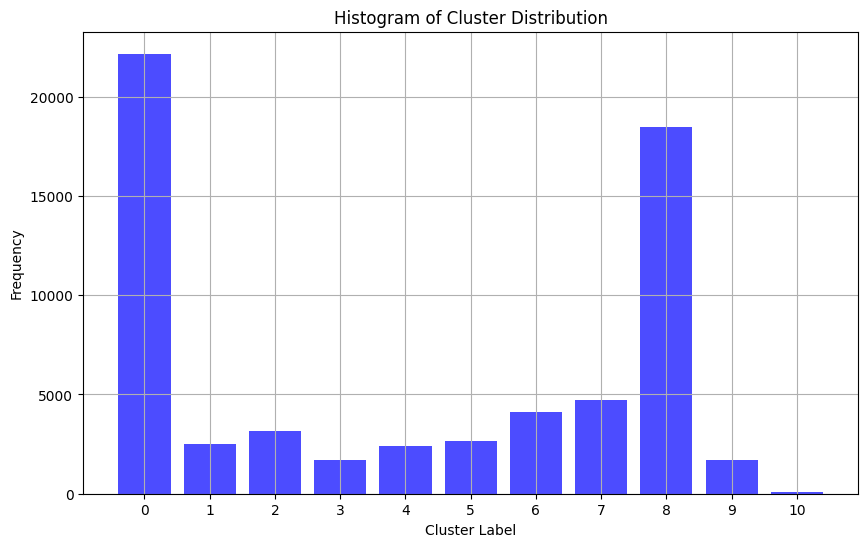

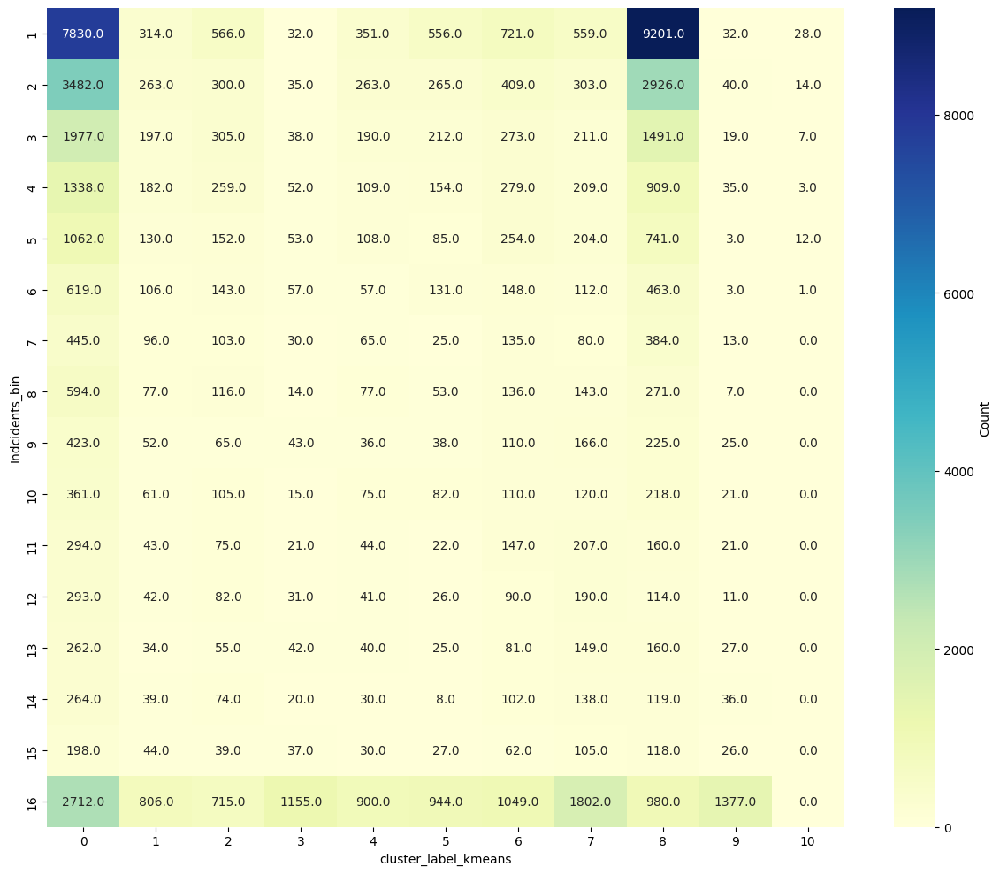

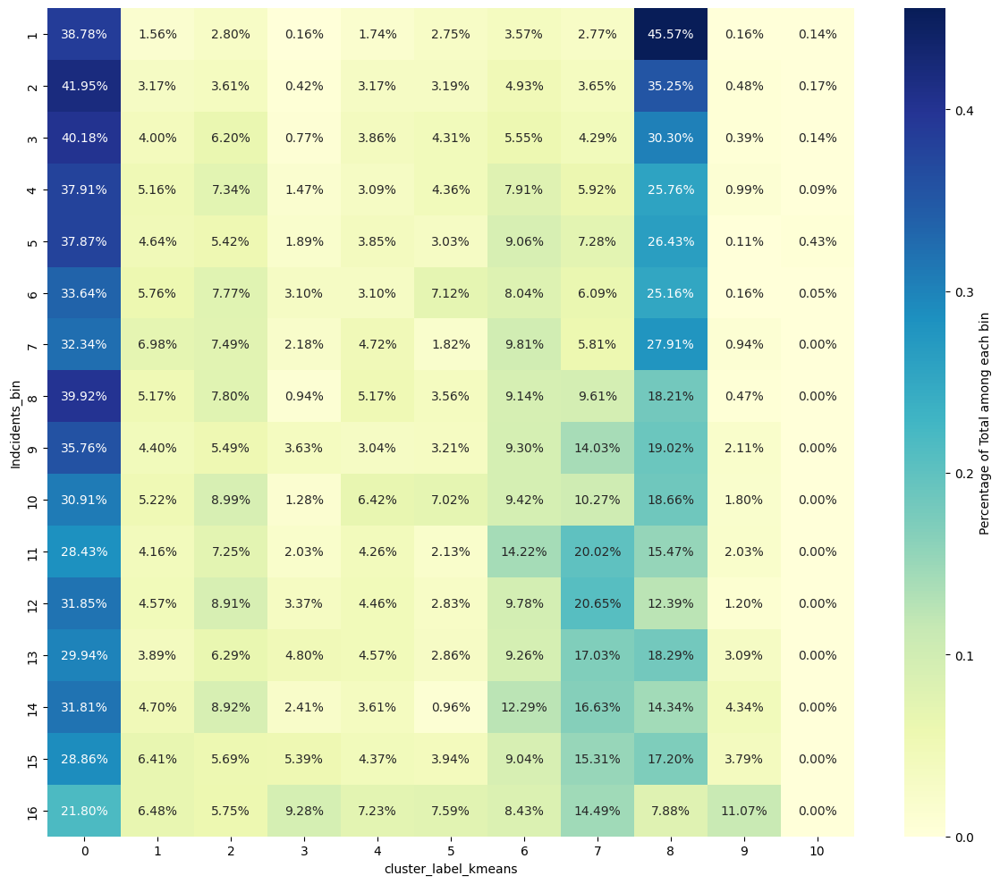

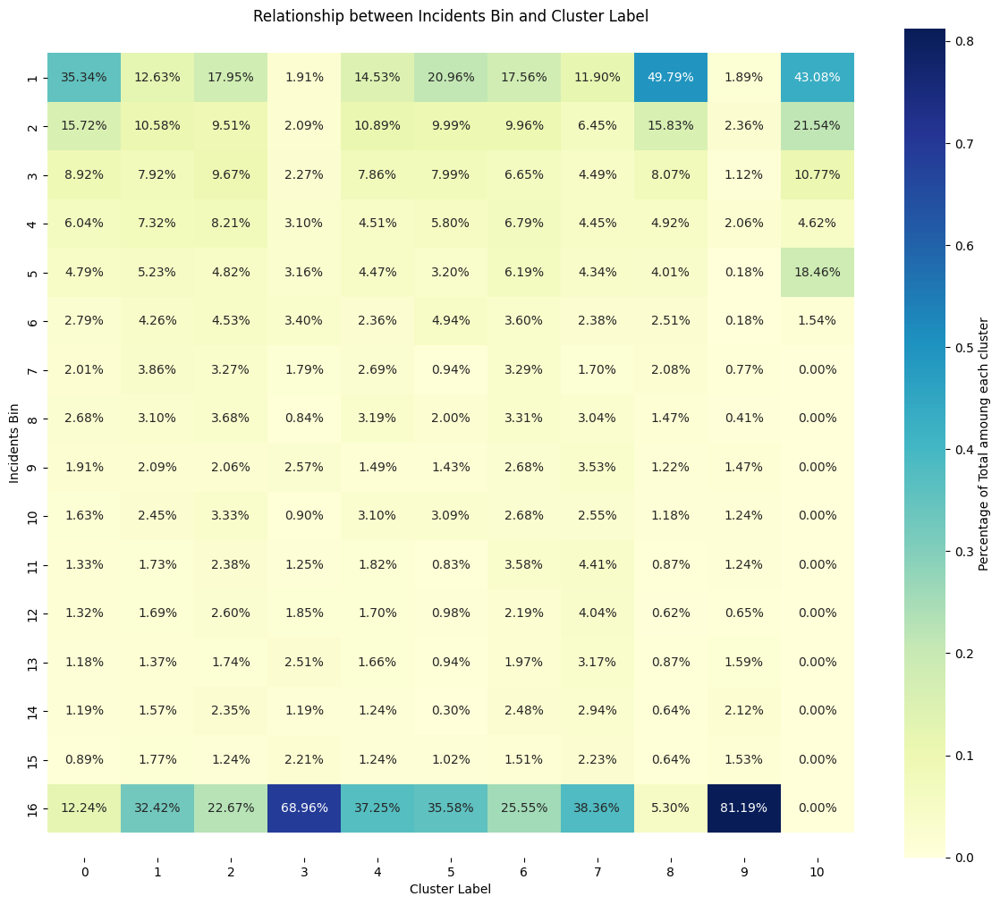

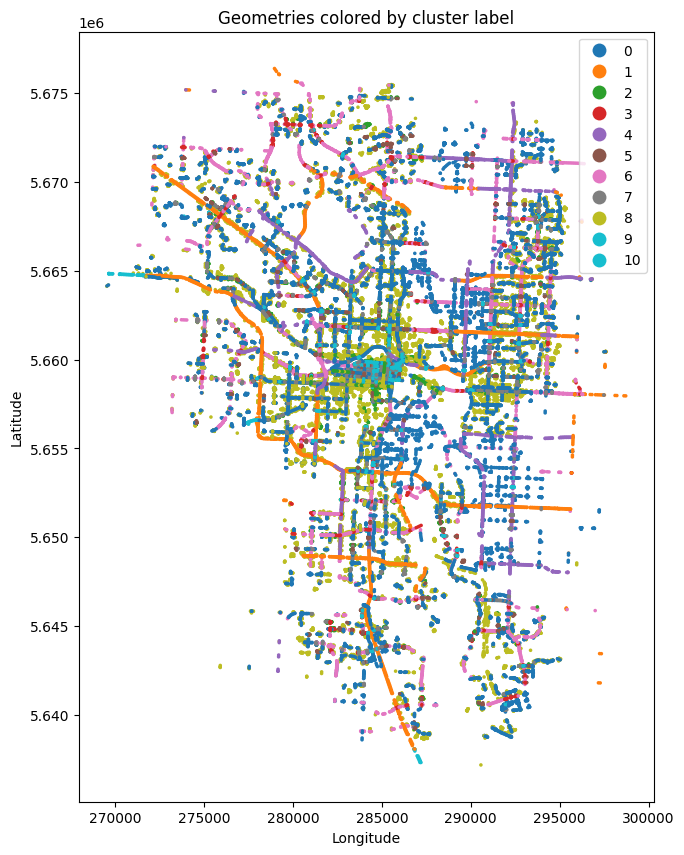


n_clusters 12



C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni


Most common attributes for Cluster:


C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni

,Cluster,SPEED_LIMIT_mode,SPEED_LIMIT_mean,SPEED_LIMIT_median,SIGN_TYPE_Flat_Sheet_mode,SIGN_TYPE_Flat_Sheet_mean,SIGN_TYPE_Flat_Sheet_median,Size_Category_Medium_mode,Size_Category_Medium_mean,Size_Category_Medium_median,Size_Category_Large_mode,Size_Category_Large_mean,Size_Category_Large_median,CROSSWALK_TYPE_SIGNALIZED_mode,CROSSWALK_TYPE_SIGNALIZED_mean,CROSSWALK_TYPE_SIGNALIZED_median
0,0,[70.0],70.000000,70.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
1,1,[50.0],50.000000,50.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
2,2,[60.0],60.000000,60.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
3,3,[40.0],39.931034,40.0,[2],3.620361,4.0,[2],2.655501,2.0,0,0.000000,0.0,0,0.000000,0.0
4,4,[40.0],39.969875,40.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
5,5,[80.0],80.000000,80.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
6,6,[50.0],49.929245,50.0,[7],6.955189,7.0,[2],2.379127,2.0,[5],4.777123,5.0,[1],0.955189,1.0
7,7,[50.0],50.000000,50.0,[4],4.667923,4.0,[4],4.320769,4.0,0,0.000000,0.0,0,0.000000,0.0
8,8,[90.0],90.000000,90.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
9,9,[60.0],60.038700,60.0,[4],5.681115,5.0,[2],3.076625,3.0,0,0.000000,0.0,[1],0.857585,1.0


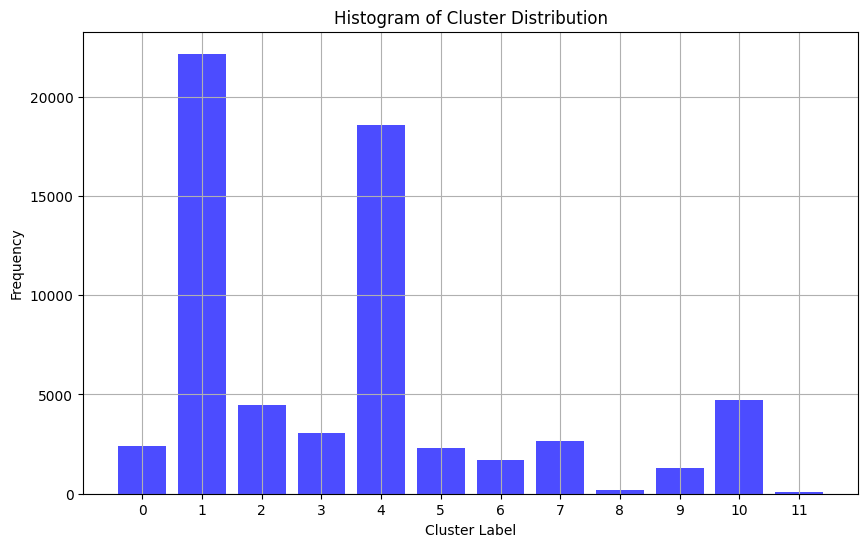

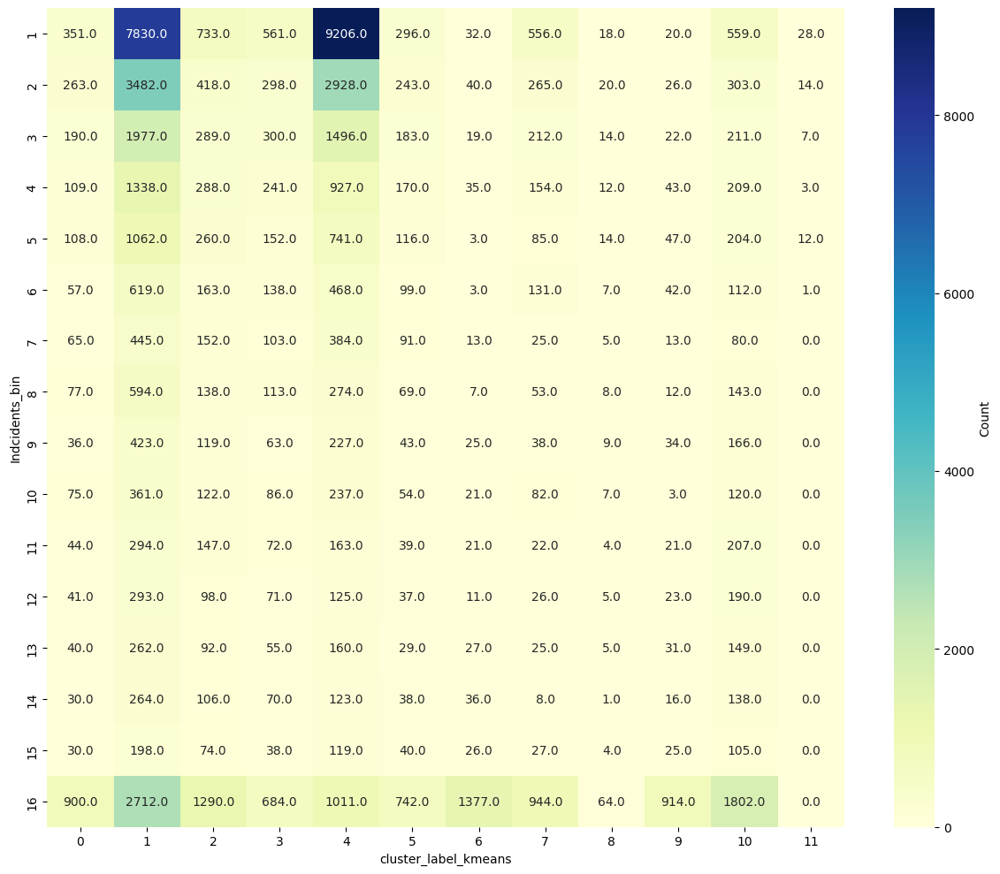

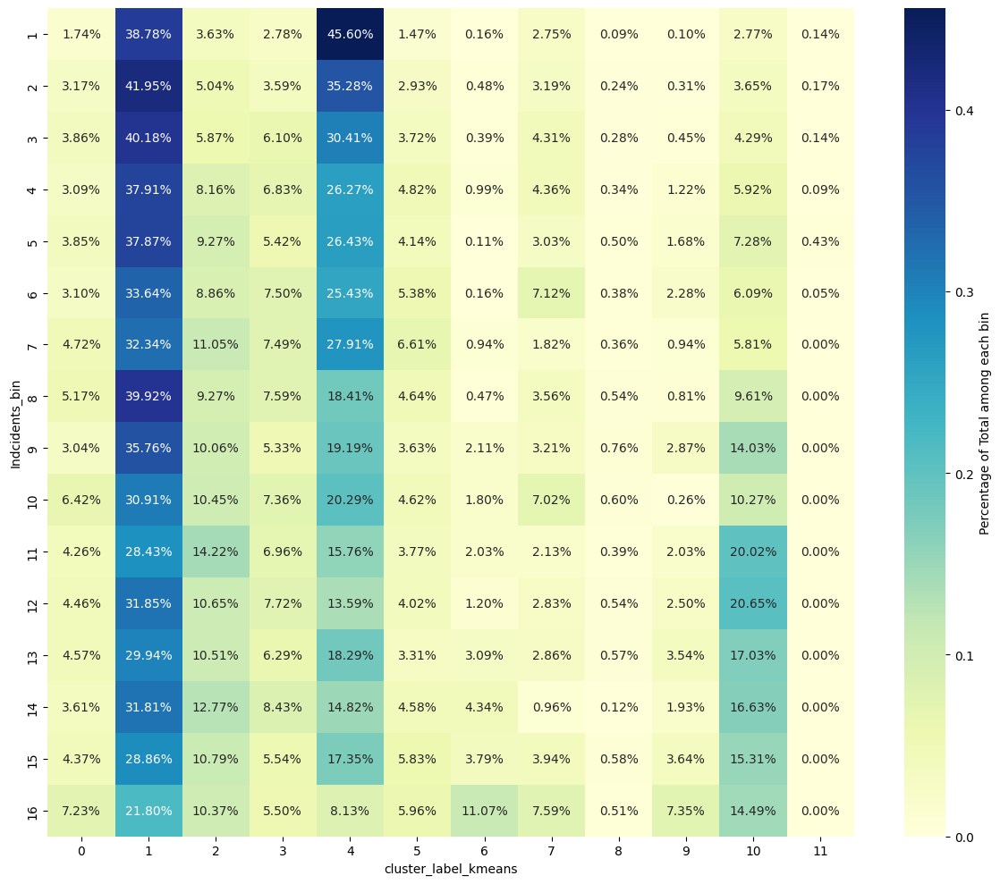

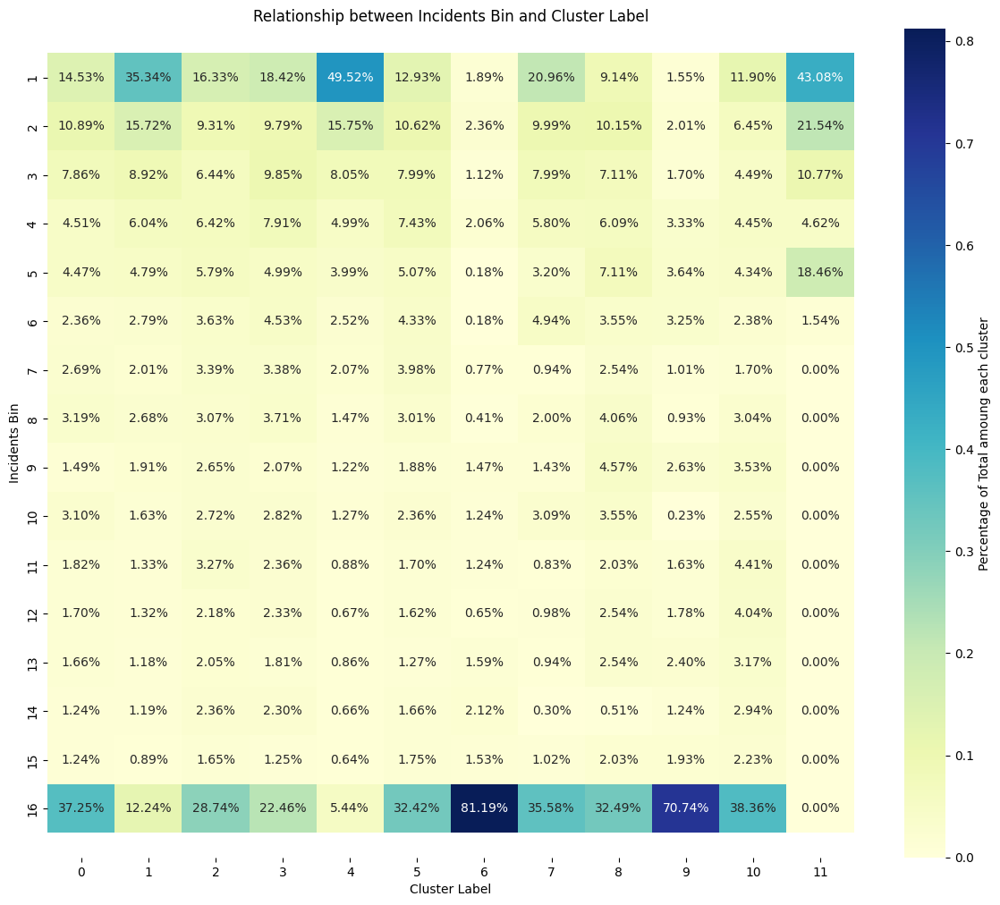

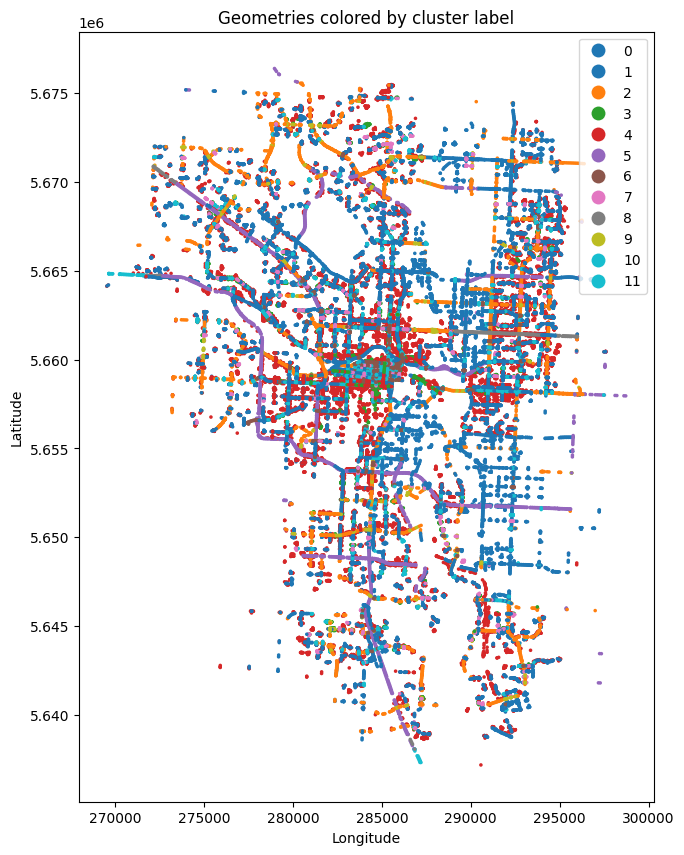


n_clusters 13



C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni


Most common attributes for Cluster:


,Cluster,SPEED_LIMIT_mode,SPEED_LIMIT_mean,SPEED_LIMIT_median,SIGN_TYPE_Flat_Sheet_mode,SIGN_TYPE_Flat_Sheet_mean,SIGN_TYPE_Flat_Sheet_median,Size_Category_Medium_mode,Size_Category_Medium_mean,Size_Category_Medium_median,CROSSWALK_TYPE_SIGNALIZED_mode,CROSSWALK_TYPE_SIGNALIZED_mean,CROSSWALK_TYPE_SIGNALIZED_median,Size_Category_Large_mode,Size_Category_Large_mean,Size_Category_Large_median
0,0,[50.0],50.000000,50.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
1,1,[80.0],80.000000,80.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
2,2,[40.0],39.969875,40.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
3,3,[60.0],60.000000,60.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
4,4,[70.0],70.000000,70.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
5,5,[50.0],50.000000,50.0,[2],3.377494,3.0,[2],2.559007,2.0,[1],0.564641,1.0,0,0.000000,0.0
6,6,[60.0],60.000000,60.0,[4],5.044311,5.0,[2],2.688623,2.0,[1],0.849701,1.0,[3],2.411976,2.0
7,7,[50.0],49.926290,50.0,[7],7.386978,7.0,[2],2.909091,2.0,[1],0.980958,1.0,[5],4.681818,5.0
8,8,[110.0],109.384615,110.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
9,9,[70.0],70.000000,70.0,[4],5.048027,4.0,[2],2.130360,2.0,[1],0.948542,1.0,[4],2.972556,3.0


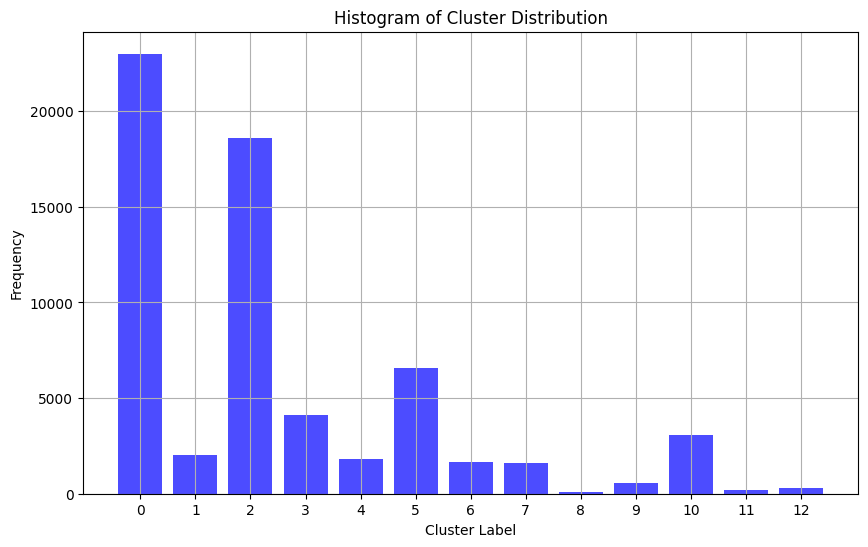

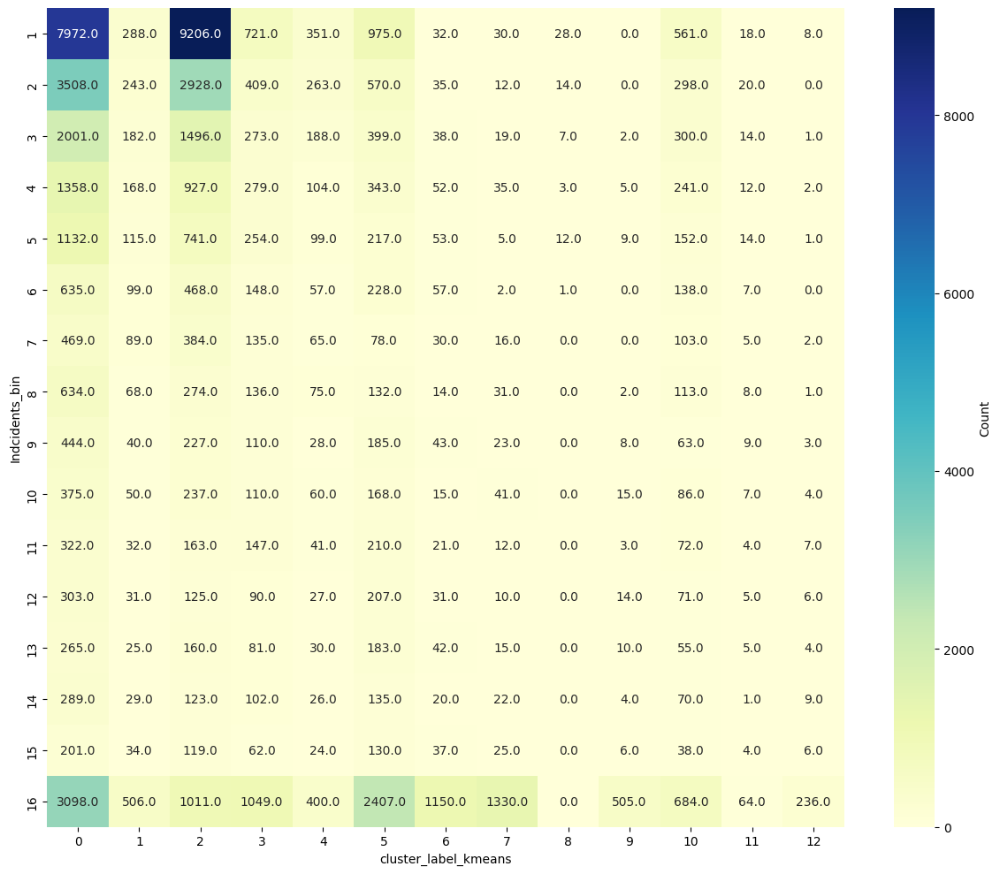

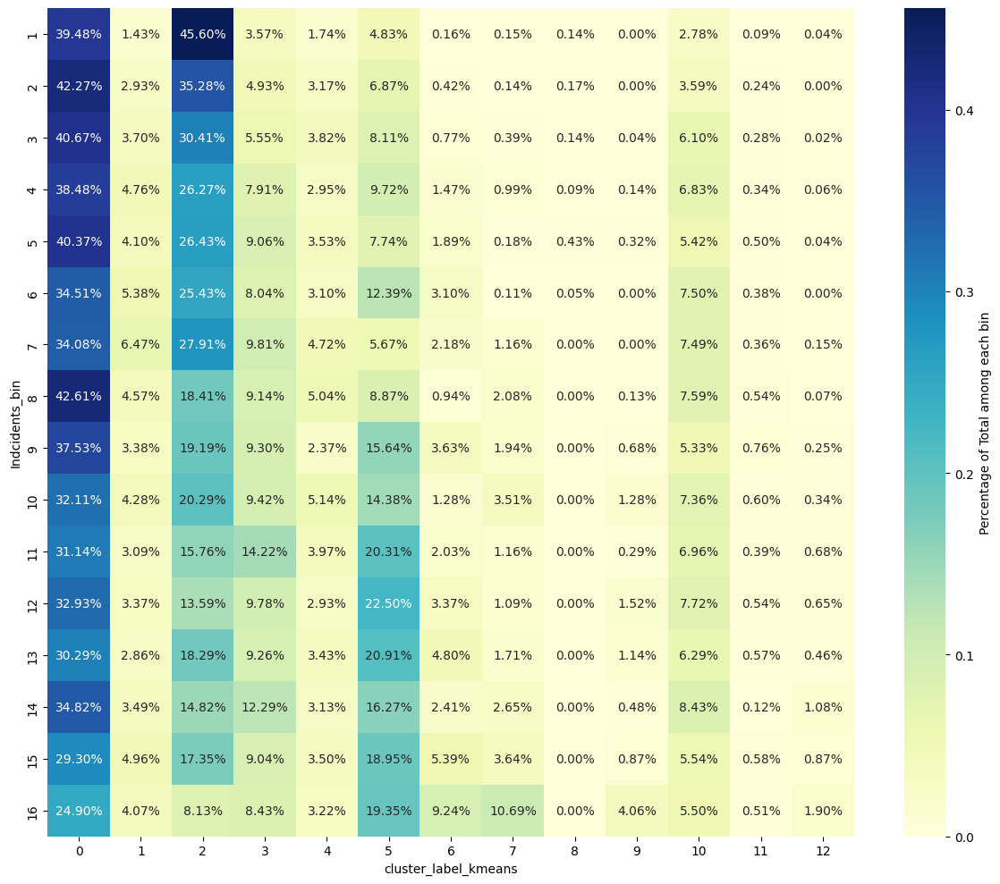

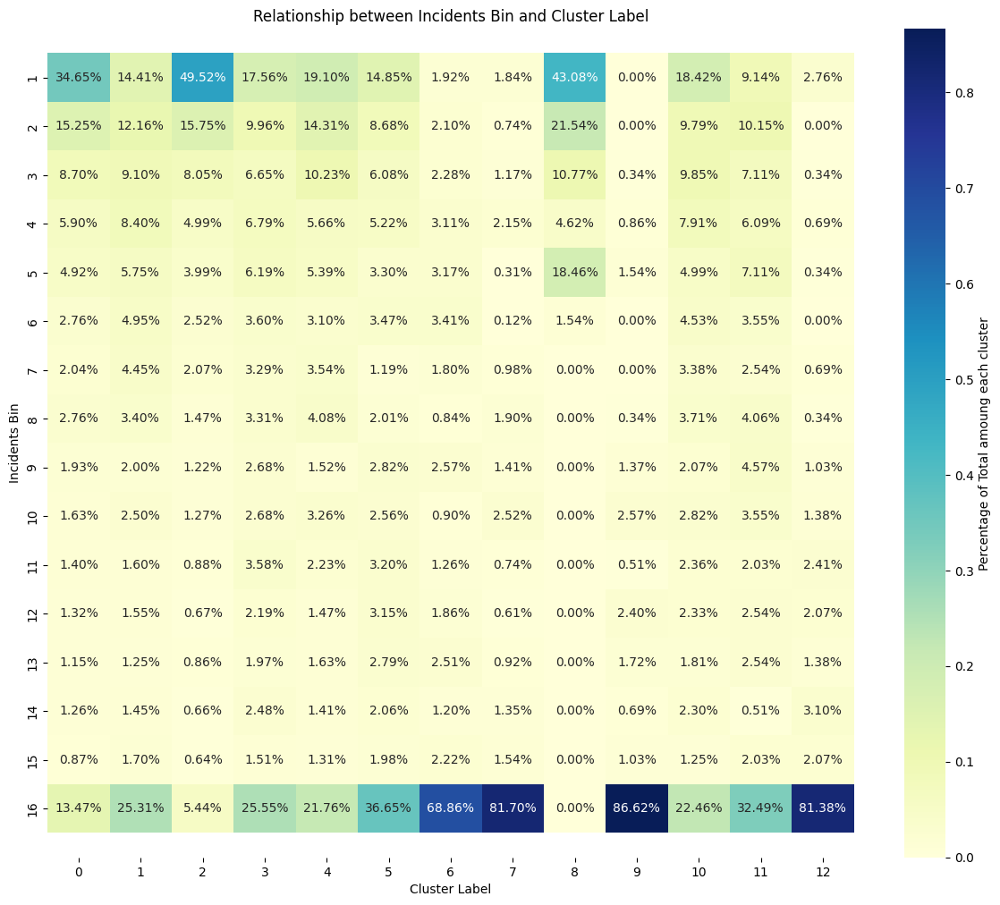

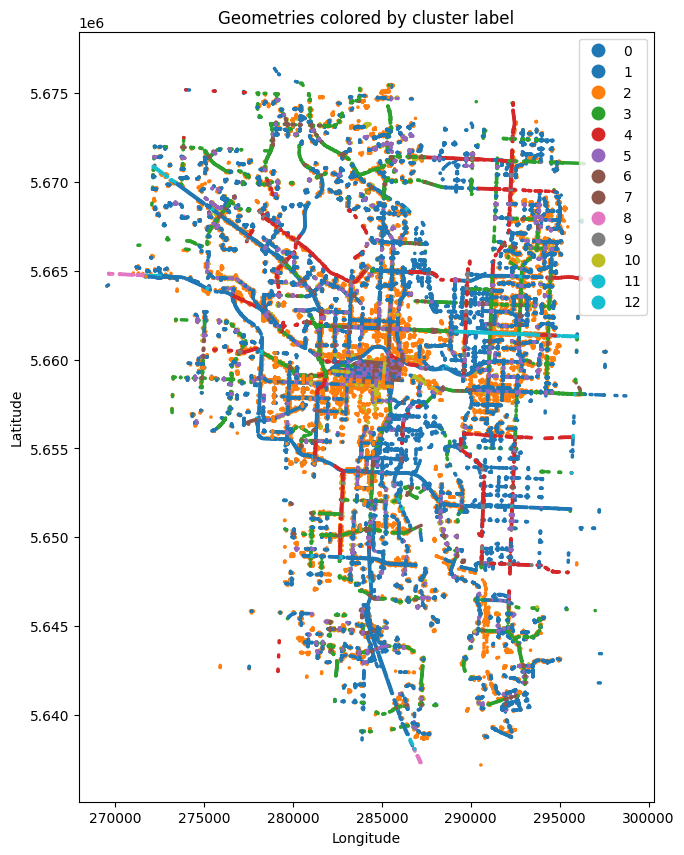


n_clusters 14



C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni


Most common attributes for Cluster:


,Cluster,SPEED_LIMIT_mode,SPEED_LIMIT_mean,SPEED_LIMIT_median,SIGN_TYPE_Flat_Sheet_mode,SIGN_TYPE_Flat_Sheet_mean,SIGN_TYPE_Flat_Sheet_median,Size_Category_Medium_mode,Size_Category_Medium_mean,Size_Category_Medium_median,CROSSWALK_TYPE_SIGNALIZED_mode,CROSSWALK_TYPE_SIGNALIZED_mean,CROSSWALK_TYPE_SIGNALIZED_median,Size_Category_Large_mode,Size_Category_Large_mean,Size_Category_Large_median
0,0,[60.0],60.000000,60.0,[4],5.650621,5.0,[2],3.066770,3.0,[1],0.854037,1.0,0,0.000000,0.0
1,1,[50.0],50.000000,50.0,[2],2.580254,2.0,[2],1.370684,2.0,[1],0.616798,1.0,[2],1.715728,2.0
2,2,[40.0],39.969968,40.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
3,3,[80.0],80.000000,80.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
4,4,[60.0],60.000000,60.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
5,5,[70.0],70.000000,70.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
6,6,[50.0],50.000000,50.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
7,7,[90.0],90.000000,90.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
8,8,[50.0],50.000000,50.0,[4],4.684506,4.0,[4],4.312500,4.0,0,0.000000,0.0,0,0.000000,0.0
9,9,[40.0],39.924642,40.0,[4],3.857573,4.0,[2],2.757347,2.0,0,0.000000,0.0,[2],1.787114,2.0


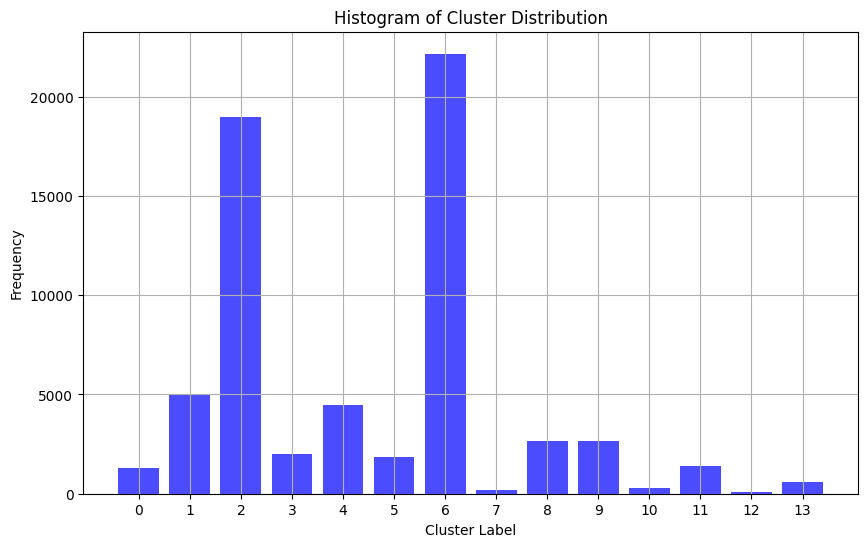

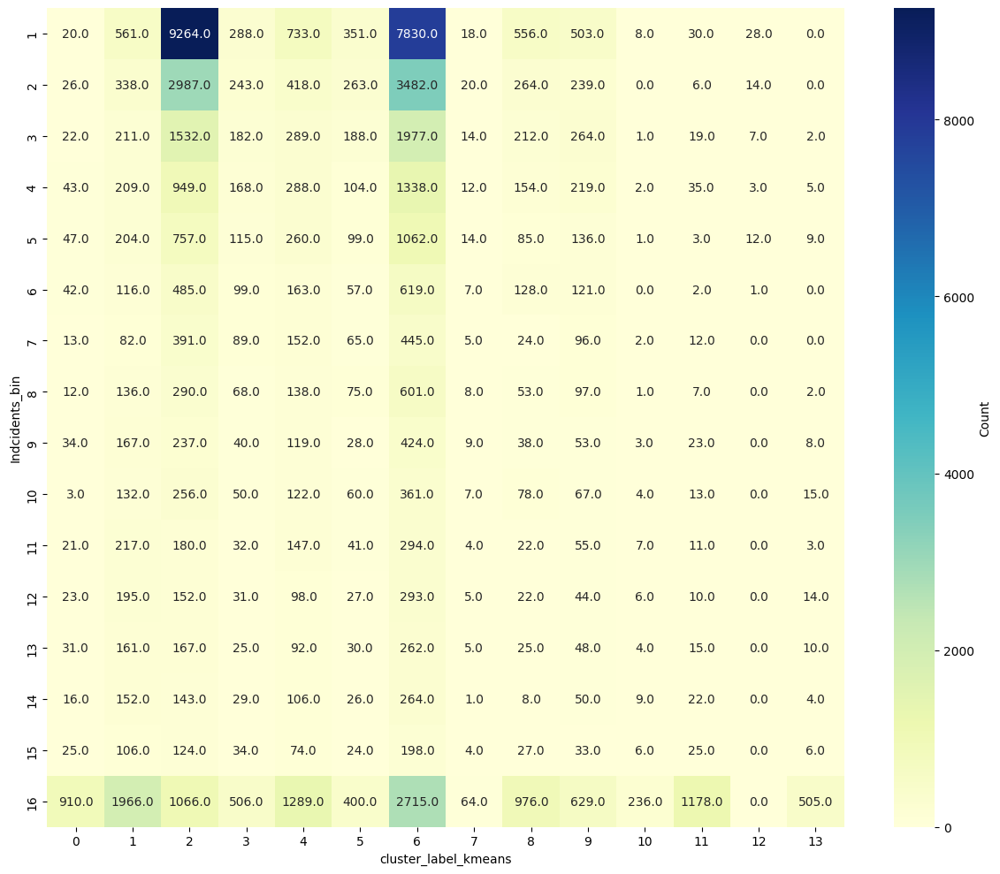

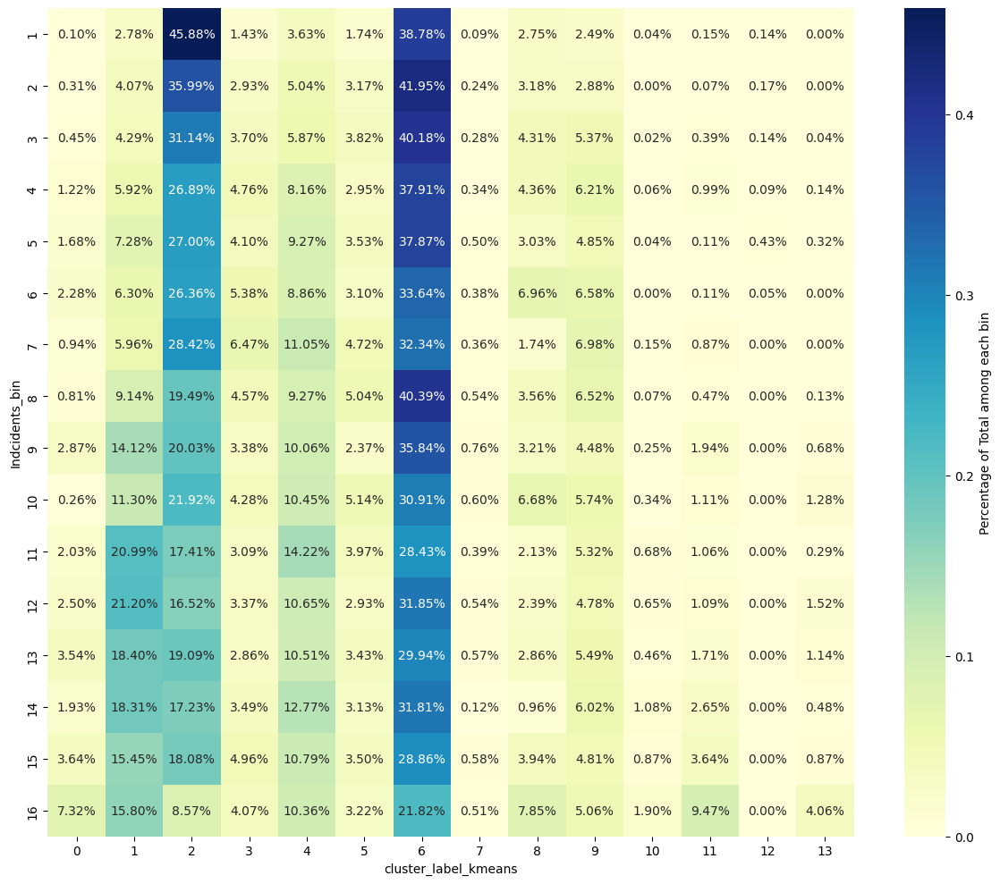

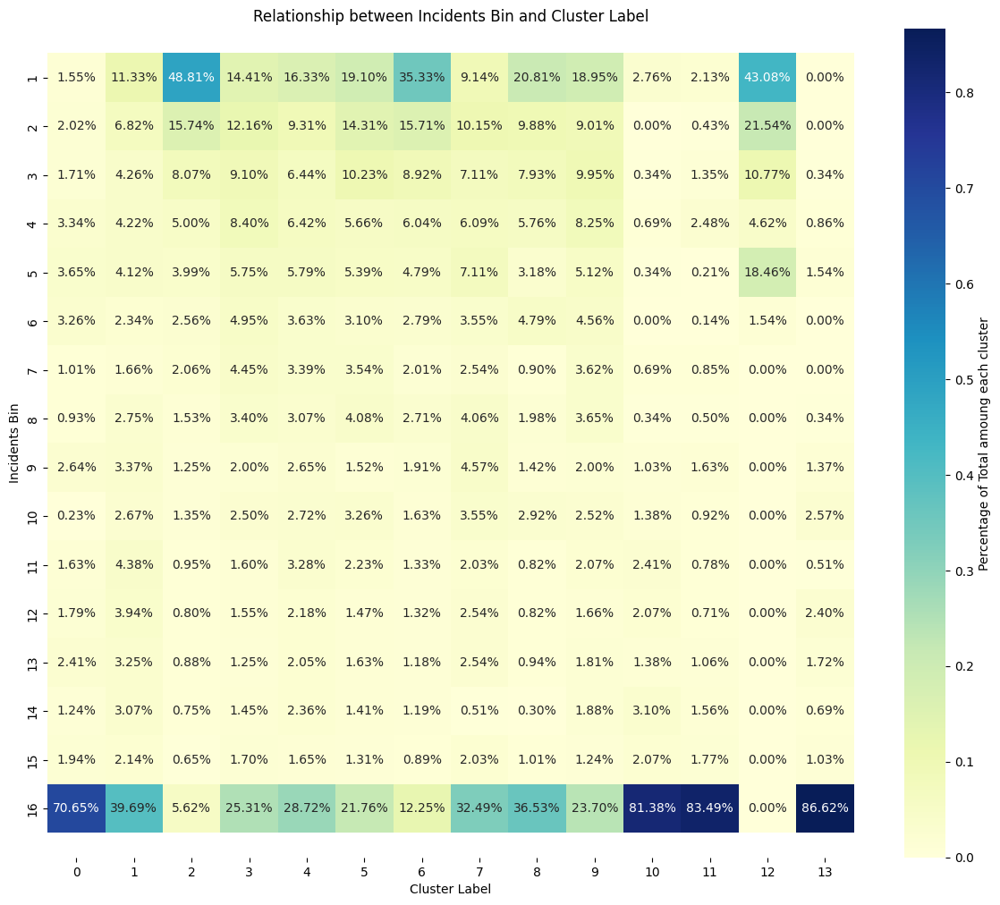

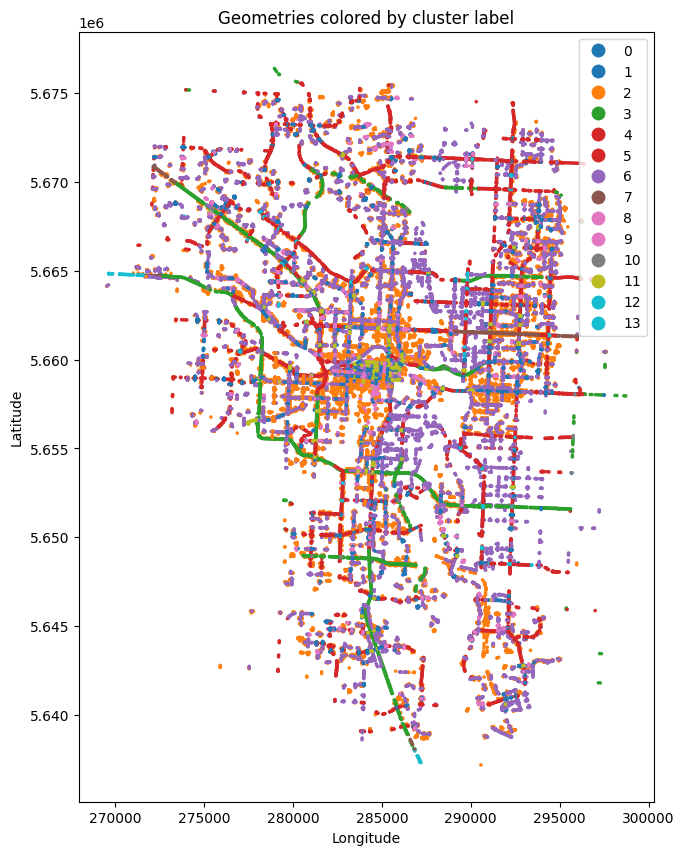


n_clusters 15



C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode_data = stats.mode(cluster_data[col])
C:\Users\lidou\AppData\Local\Temp\ipykernel_16752\4059036523.py:51: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warni


Most common attributes for Cluster:


,Cluster,SPEED_LIMIT_mode,SPEED_LIMIT_mean,SPEED_LIMIT_median,SIGN_TYPE_Flat_Sheet_mode,SIGN_TYPE_Flat_Sheet_mean,SIGN_TYPE_Flat_Sheet_median,Size_Category_Medium_mode,Size_Category_Medium_mean,Size_Category_Medium_median,Size_Category_Large_mode,Size_Category_Large_mean,Size_Category_Large_median,CROSSWALK_TYPE_SIGNALIZED_mode,CROSSWALK_TYPE_SIGNALIZED_mean,CROSSWALK_TYPE_SIGNALIZED_median
0,0,[40.0],39.969387,40.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
1,1,[70.0],70.000000,70.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
2,2,[50.0],50.000000,50.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
3,3,[60.0],60.000000,60.0,[4],4.941818,4.0,[2],2.684848,2.0,[3],2.312121,2.0,[1],0.853333,1.0
4,4,[80.0],80.000000,80.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
5,5,[50.0],50.000000,50.0,[2],2.377246,2.0,[2],1.358173,2.0,[2],1.566866,2.0,[1],0.591705,1.0
6,6,[60.0],60.000000,60.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
7,7,[110.0],109.384615,110.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0,0,0.000000,0.0
8,8,[40.0],39.923729,40.0,[4],4.800000,4.0,[4],4.149153,4.0,0,0.000000,0.0,0,0.000000,0.0
9,9,[50.0],50.111857,50.0,[10],10.085011,10.0,[4],4.284116,4.0,[5],6.286353,6.0,[1],0.941834,1.0


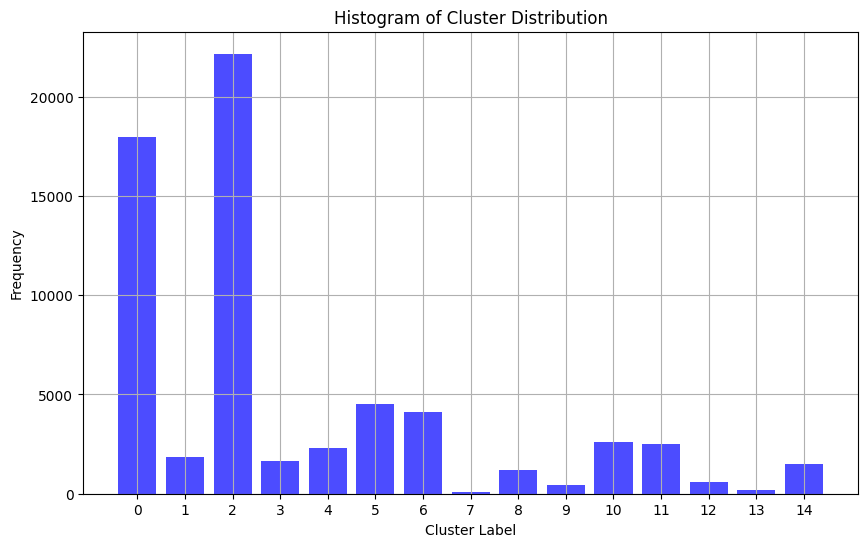

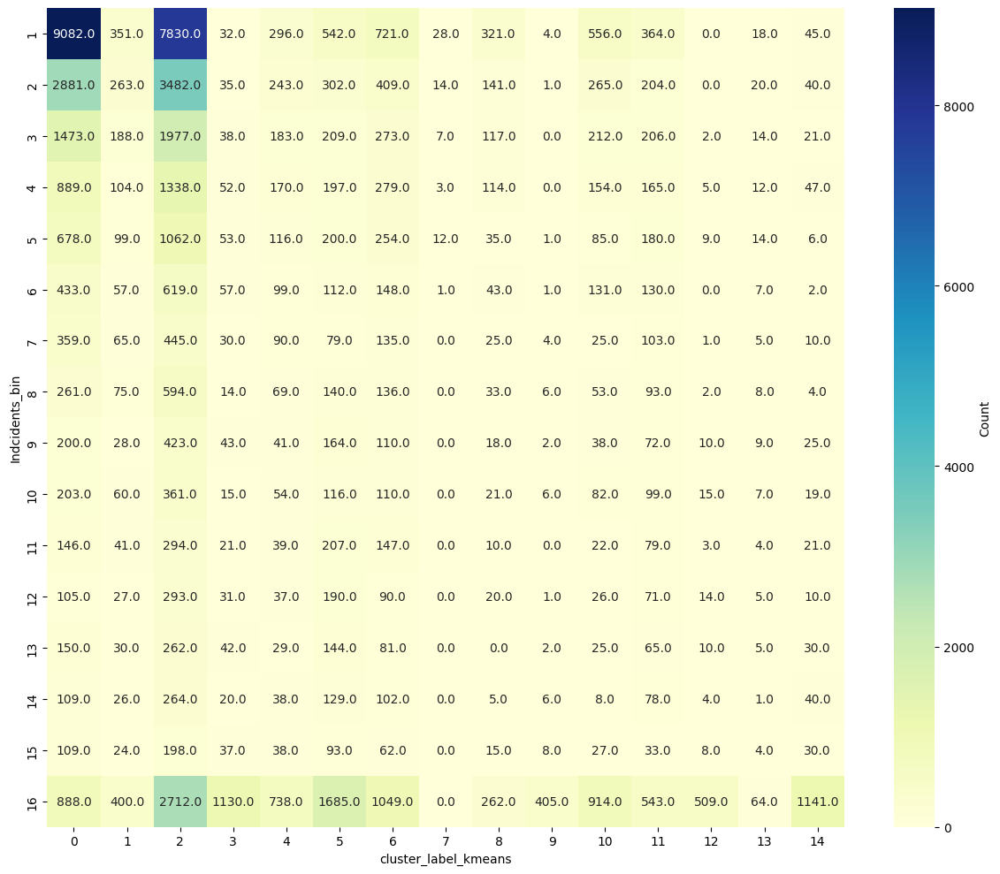

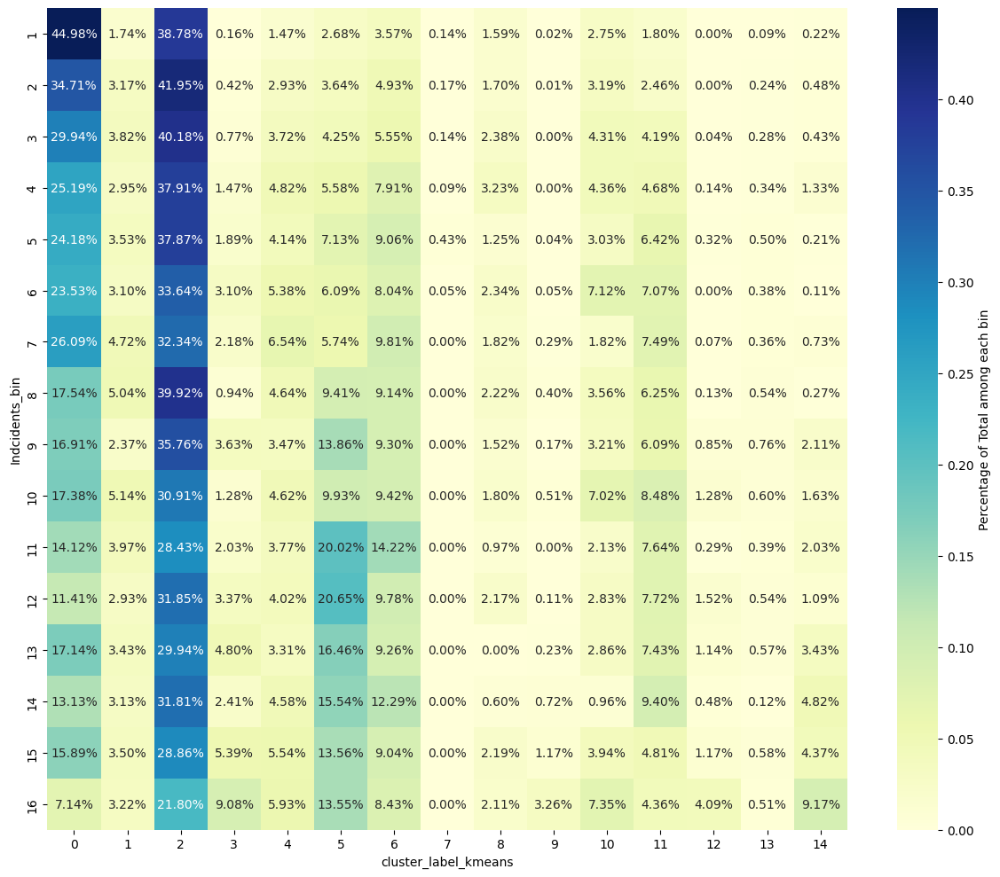

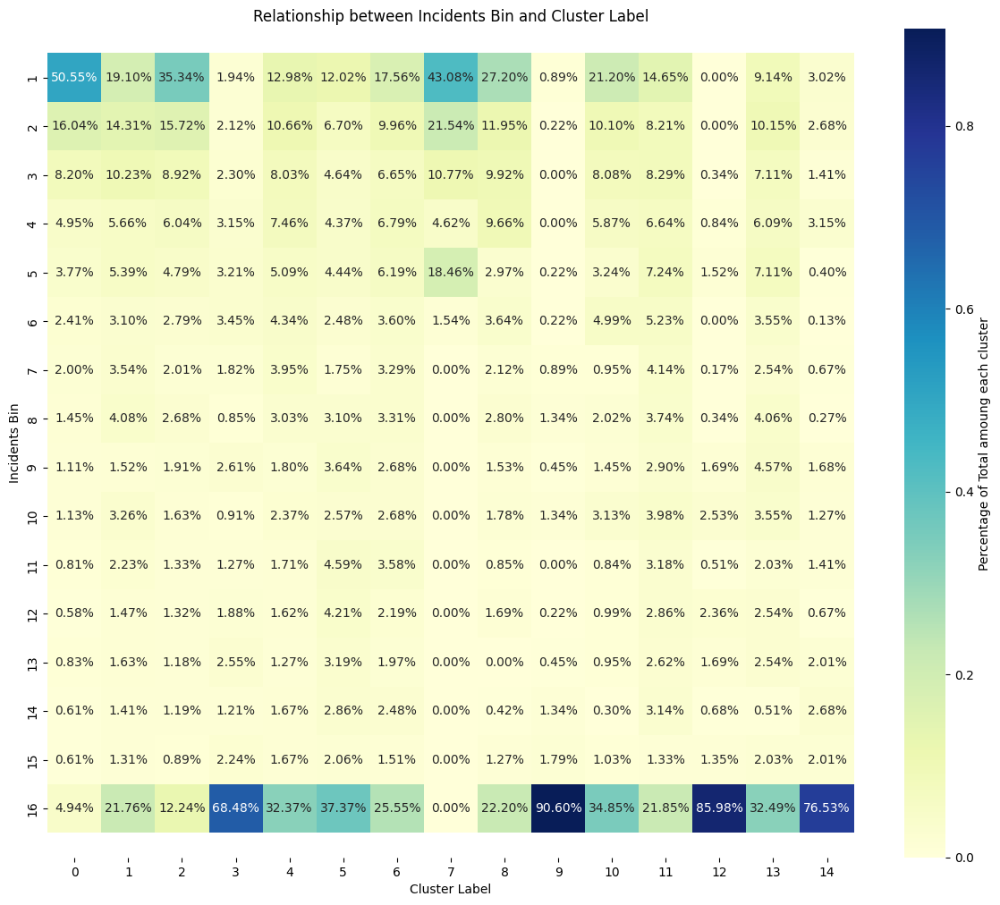

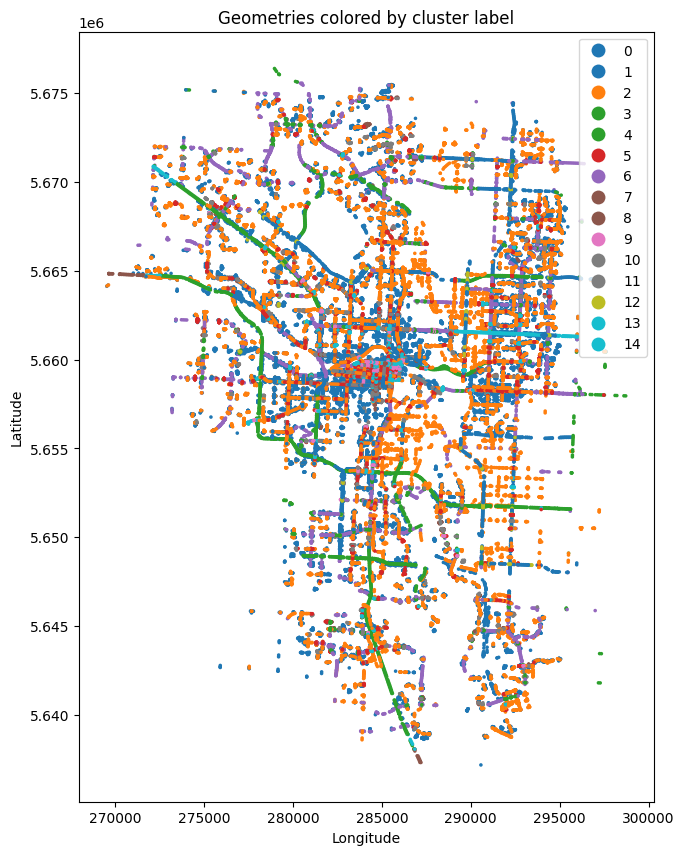

In [45]:

for n_clusters in n_cluster_options:
    clustering(df_with_speed_incidents_sign_crosswalk, n_clusters, 1)

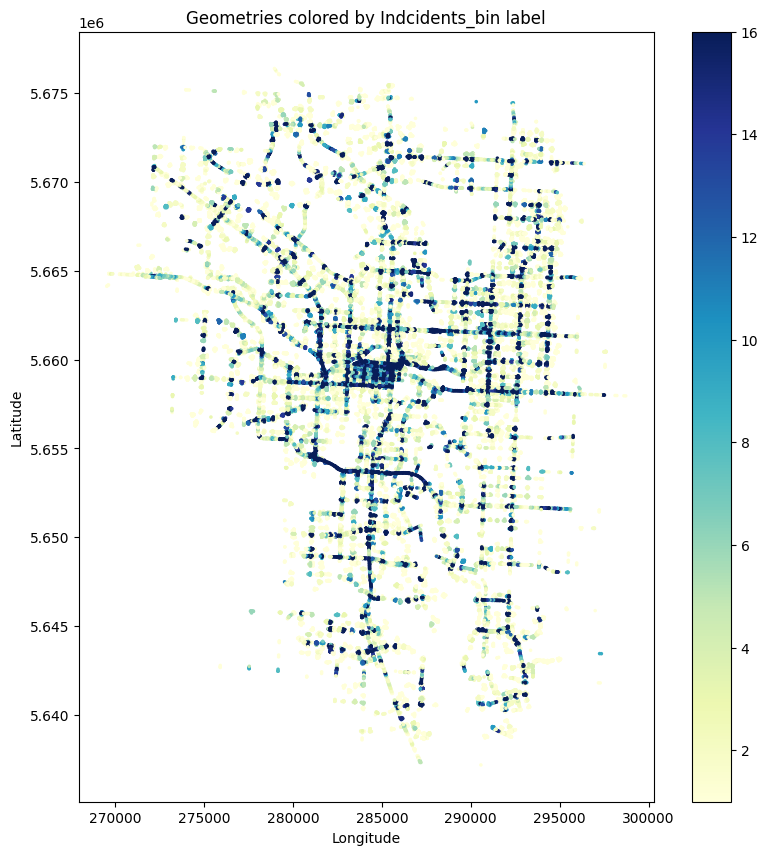

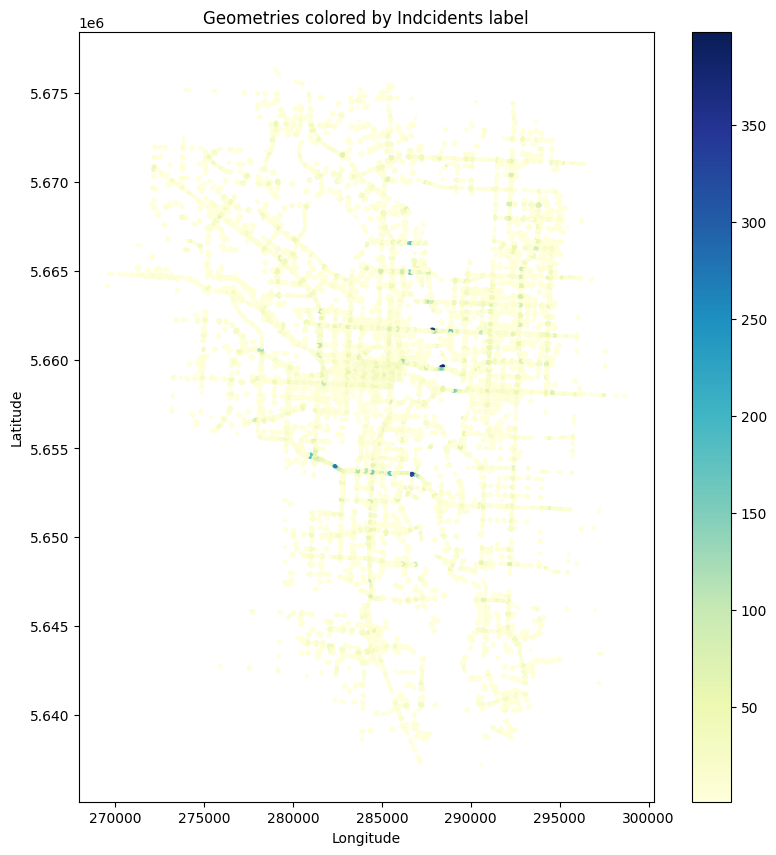

In [41]:
gdf = df_with_speed_incidents_sign_crosswalk[df_with_speed_incidents_sign_crosswalk['Indcidents'] > 0]
# Plot using geopandas
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
gdf.plot(column='Indcidents_bin', ax=ax, legend=True, cmap="YlGnBu")

# Add title and axis labels as needed
plt.title('Geometries colored by Indcidents_bin label')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

# Show plot
plt.show()

gdf = df_with_speed_incidents_sign_crosswalk[df_with_speed_incidents_sign_crosswalk['Indcidents'] > 0]
# Plot using geopandas
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
gdf.plot(column='Indcidents', ax=ax, legend=True, cmap="YlGnBu")

# Add title and axis labels as needed
plt.title('Geometries colored by Indcidents label')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

# Show plot
plt.show()

In [42]:
# Cluster	Silhouette score 
# 3	0.802692512
# 4	0.84089365
# 5	0.825106301
# 6	0.833924028
# 8	0.812125354
# 10	0.799316407

# Assume 
# speed limit doest change


# Suggestion for improvement
# 1. use speed for dynmaic interval
# 2. incident level, serious, minor injury, but cant find related information online

# decision tree colour defination from chatgpt
# Darker Colors for Lower Impurity: Nodes with lower impurity (higher homogeneity) are colored darker. This typically means that most of the samples in that node belong to the same class.
# Lighter Colors for Higher Impurity: Nodes that are less pure (higher impurity) are lighter in color, indicating a more equal distribution of different classes within the node.
# Color Gradient: A gradient of colors is used across different nodes to indicate varying levels of class purity. The exact color may depend on the colormap used in the plot_tree function (in your case, it's probably the default colormap).
# Leaf Nodes: The leaf nodes (the final nodes at the bottom of the tree) might have distinct colors if they are pure, meaning they perfectly classify all samples in the node as belonging to one class.